# All NASDAQ ANALYSIS

In [1]:
#libraries
import pandas as pd
import numpy as np
import mplfinance as mpf
import matplotlib.pyplot as plt
import talib as ta
import seaborn as sns
from datetime import datetime
sns.set_theme()

pd.set_option('display.max_columns', None);pd.set_option('display.max_rows', None)

In [2]:
def plot_with_mpl(root,tick,day=60,sty='classic',typ='candle'):
    "returns the candle stick of a stock tick for the given root file."

    df=pd.read_csv(root+'/'+tick+'.csv').tail(day)
    df['Date']=df['Date'].apply(lambda x:x.split()[0])

    df['rsi']=ta.RSI(df['Close']);df['sma-5']=ta.SMA(df['Close'],5);df['sma-10']=ta.SMA(df['Close'],10)
    #df.fillna(0,inplace=True)
    apds = [ 
         mpf.make_addplot((df['rsi']),panel=1,color='r',secondary_y=True,type='line',width=0.5),
         #mpf.make_addplot((df['sma-5']),color='g',type='line',width=0.2),
         #mpf.make_addplot((df['sma-10']),color='r',type='line',width=0.2)
       ]
    df.Volume=df.Volume/10**6              #100k volume
    df.Date=pd.to_datetime(df.Date)
    df.set_index('Date',inplace=True)
    fig,axes=mpf.plot(df,type=typ,mav=(5,21),volume=True,tight_layout=False,figratio=(90,36),figscale=1,
                    style=sty,returnfig=True,addplot=apds,scale_width_adjustment=dict(volume=0.5,candle=0.8,lines=0.4))
    axes[0].legend([" "," ","5-SMA","21-SMA"],loc='upper center')
    #axes[0].legend(loc='upper left')
    axes[0].set_title(tick)
    mpf.show()

def make_clickable(url, name):
    return '{}" rel="noopener noreferrer" target="_blank">{}'.format(url,name)

#df['link'] = df.apply(lambda x: make_clickable(x['url'], x['name']), axis=1)

In [3]:


def compare_bars(temp_df,rows=30,title=""):
    choose=['TICKER','VOL','%CHG','%ATR','CP']
    plot_df=temp_df[choose].sort_values(by='VOL',ascending=False).reset_index(drop=True,).head(rows)
    columns=plot_df.columns.to_list()
    x=columns[0];y=columns[1:]
    today=datetime.now().strftime("%m/%d/%Y")
    f, axs = plt.subplots(2, 2, figsize=(16, 10), gridspec_kw=dict(width_ratios=[4, 4]))
    cols=axs.flat
    for i,j in enumerate(y):
        g=sns.barplot(data=plot_df,x=x,y=y[i],ax=cols[i])
        for item in g.get_xticklabels():
            item.set_rotation(90)
            item.set_fontsize(10)
            item.set_fontweight('bold')
        for i in g.containers:
            g.bar_label(i,rotation=90,fontsize=10,fontweight='bold',color='b',padding=5)
    f.suptitle(f"{title.upper()} {today}")   
    f.tight_layout()
    f.savefig(title+'.pdf')
    #f.show()

In [4]:
#re-set index
def reset_index(df):
    df.index=np.arange(1,df.shape[0]+1)
    return df

def highlight_max(s):
    '''
    highlight the maximum in a Series yellow.
    '''
    is_max = s == s.max()
    return ['background-color: yellow' if v else '' for v in is_max]


def highlight_min(s):
    '''
    highlight the minimum in a Series yellow.
    '''
    is_min = s == s.min()
    return ['background-color: red' if v else '' for v in is_min]

def color_negative_red(val):
    """
    Takes a scalar and returns a string with
    the css property `'color: red'` for negative
    strings, black otherwise.
    """
    color = 'red' if val < 0 else 'black'
    return 'color: %s' % color

In [5]:
dff=pd.read_csv('/home/thakur/test/sector/XLF.csv')#,index_col='Date')
dff.tail()


,Date,Open,High,Low,Close,Adj Close,Volume
246,2022-11-07 00:00:00-05:00,34.16,34.27,33.94,34.25,34.25,30060300
247,2022-11-08 00:00:00-05:00,34.26,34.62,34.09,34.45,34.45,34839600
248,2022-11-09 00:00:00-05:00,34.22,34.35,33.80,33.87,33.87,42126200
249,2022-11-10 00:00:00-05:00,34.90,35.63,34.81,35.58,35.58,67677700
250,2022-11-11 00:00:00-05:00,35.76,36.03,35.63,35.87,35.87,45274071


In [6]:
sectors=['Technology', 'Health Care', 'Consumer Discretionary', 'Finance',
'Energy', 'Consumer Staples', 'Industrials', 'Utilities',
       'Real Estate', 'Telecommunications', 'Miscellaneous',
       'Basic Materials']

In [7]:
#all sectors
#df.style.highlight_max(color = 'lightgreen', axis = 0)

df_sector=pd.read_csv('/home/thakur/test/combined/all_sectors.csv')
st_df=pd.read_csv("/home/thakur/stock_information/sectors.csv")  #11 sectors
st_list=st_df["TICKER"].to_list()
df_sector['SECTOR']=st_df.SECTOR.to_list()
df_sector['SECTOR'] = df_sector['SECTOR'].apply(lambda x:x.replace(' ', '_'))
df_sector['%ATR']=round(100*df_sector['AVG10ATR']/df_sector['CP'],2)
df_sector=df_sector.sort_values(by='RSI',ascending=False)
df_sector=reset_index(df_sector)

#df_sector.style.apply(highlight_max)

# df_sector.style.\
#     applymap(color_negative_red).\
#     format("{:.2}")
df_sector

,TICKER,CP,HH,HL,LH,LL,HC,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,AVG10ATR,SECTOR,%ATR
1,XLB,81.25,True,True,False,False,True,70.22,78.19,73.83,72.71,79.50,6.45,72.57,1.21,1.96,Materials,2.41
2,XLI,99.53,True,True,False,False,False,70.20,97.54,92.38,90.03,94.38,9.94,125.96,-0.06,2.11,Industrials,2.12
3,XLF,35.87,True,True,False,False,True,68.63,34.80,33.31,32.59,34.72,45.27,516.93,0.82,0.80,Financials,2.23
4,XLE,93.13,False,True,False,False,True,64.80,91.65,88.12,82.13,77.78,24.42,283.94,2.91,2.48,Energy,2.66
5,XLRE,38.74,True,True,False,False,False,64.71,37.22,35.93,37.27,42.77,7.29,90.08,-0.05,0.98,Real_Estate,2.53
6,XLP,73.52,True,False,False,False,False,62.20,72.84,71.03,70.43,73.71,14.27,143.41,-0.11,1.28,Consumer_Staples,1.74
7,XLK,133.14,True,True,False,False,True,60.85,126.44,124.19,125.60,139.41,7.83,92.60,1.71,3.85,Technology,2.89
8,XLV,133.13,False,False,False,False,False,59.38,132.89,129.85,127.02,130.12,10.49,106.22,-1.22,2.51,Healthcare,1.89
9,XLC,50.02,True,True,False,False,True,55.74,47.57,48.46,49.85,58.66,9.25,81.95,2.63,1.40,Communication_Serives,2.80
10,XLU,68.08,True,True,False,False,False,55.41,66.95,65.49,68.55,70.96,15.31,153.71,-1.12,1.68,Utilities,2.47


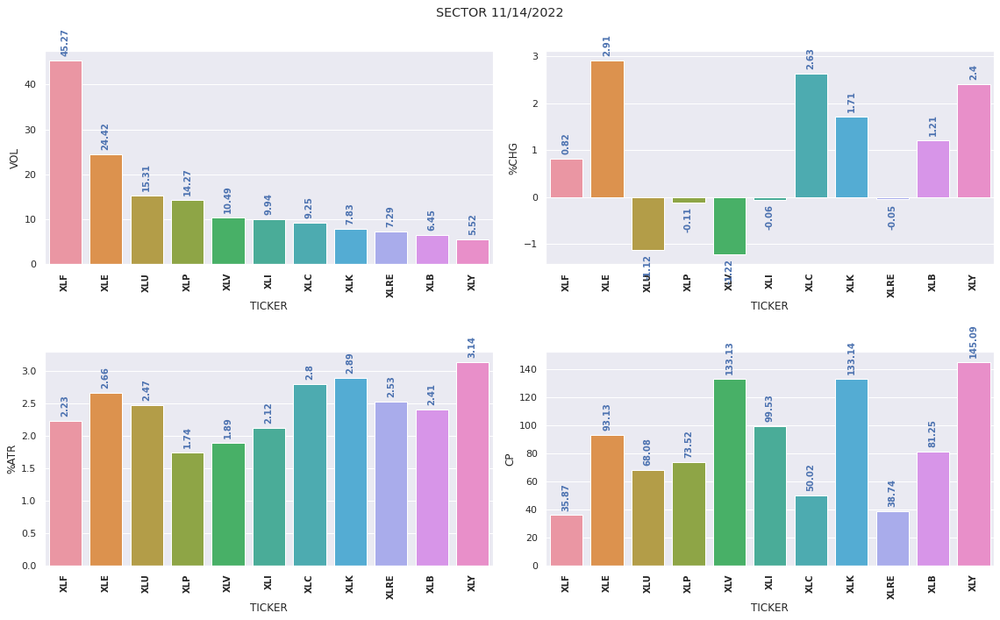

In [8]:
compare_bars(df_sector,title='sector')

In [9]:
# df_sector.style.\
#     applymap(color_negative_red).\
#     format("{:.2}")

df_sector.style.apply(highlight_max, subset=['RSI', 'CP', 'VOL','%CHG','%ATR'])\
.apply(highlight_min, subset=['RSI', 'CP', 'VOL','%CHG','%ATR'])\
#.format({'VOL':"{:.2f}",'CP':"{:.2f}",'RSI':"{:.2f}"})

#.style.format({'VOL':'{:.2f}'})
#df_sector.style.apply(highlight_min, subset=['RSI', 'CP', 'VOL','%CHG','%ATR'])
#df_sector.style.format({'VOL':"{:.2f}",'CP':"{:.2f}",'RSI':"{:.2f}"})
#cols=['CP']#,'RSI','SMA5','SMA21','SMA50','SMA50','SMA200','VOL','AVGVOL','%CHG','AVG10ATR','%ATR']
#df_sector[cols]=df_sector[cols].applymap('{0:.2f}'.format)
#df_sector
#df_sector['CP'].style.format('{:,.3f}')

,TICKER,CP,HH,HL,LH,LL,HC,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,AVG10ATR,SECTOR,%ATR
1,XLB,81.250000,True,True,False,False,True,70.220000,78.190000,73.830000,72.710000,79.500000,6.450000,72.570000,1.210000,1.960000,Materials,2.410000
2,XLI,99.530000,True,True,False,False,False,70.200000,97.540000,92.380000,90.030000,94.380000,9.940000,125.960000,-0.060000,2.110000,Industrials,2.120000
3,XLF,35.870000,True,True,False,False,True,68.630000,34.800000,33.310000,32.590000,34.720000,45.270000,516.930000,0.820000,0.800000,Financials,2.230000
4,XLE,93.130000,False,True,False,False,True,64.800000,91.650000,88.120000,82.130000,77.780000,24.420000,283.940000,2.910000,2.480000,Energy,2.660000
5,XLRE,38.740000,True,True,False,False,False,64.710000,37.220000,35.930000,37.270000,42.770000,7.290000,90.080000,-0.050000,0.980000,Real_Estate,2.530000
6,XLP,73.520000,True,False,False,False,False,62.200000,72.840000,71.030000,70.430000,73.710000,14.270000,143.410000,-0.110000,1.280000,Consumer_Staples,1.740000
7,XLK,133.140000,True,True,False,False,True,60.850000,126.440000,124.190000,125.600000,139.410000,7.830000,92.600000,1.710000,3.850000,Technology,2.890000
8,XLV,133.130000,False,False,False,False,False,59.380000,132.890000,129.850000,127.020000,130.120000,10.490000,106.220000,-1.220000,2.510000,Healthcare,1.890000
9,XLC,50.020000,True,True,False,False,True,55.740000,47.570000,48.460000,49.850000,58.660000,9.250000,81.950000,2.630000,1.400000,Communication_Serives,2.800000
10,XLU,68.080000,True,True,False,False,False,55.410000,66.950000,65.490000,68.550000,70.960000,15.310000,153.710000,-1.120000,1.680000,Utilities,2.470000




  TICKER     CP    HH    HL     LH     LL    HC    RSI   SMA5  SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR     SECTOR  %ATR
1    XLB  81.25  True  True  False  False  True  70.22  78.19  73.83  72.71    79.5  6.45   72.57  1.21      1.96  Materials  2.41


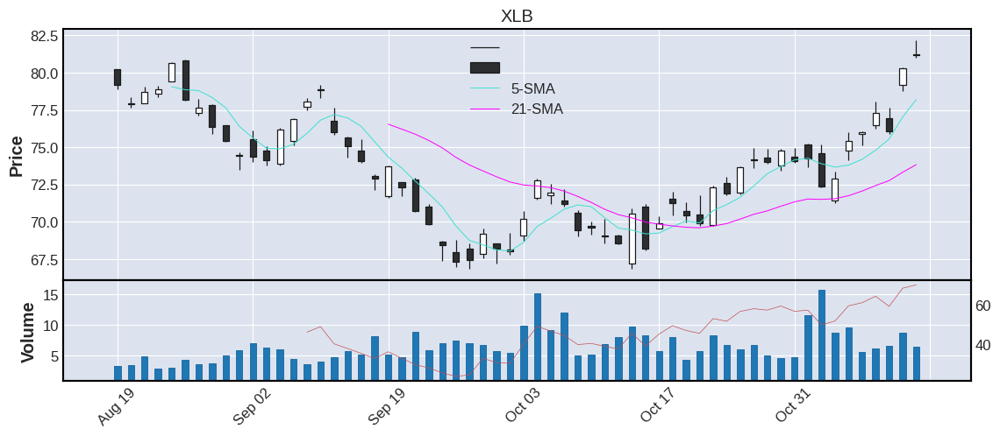



  TICKER     CP    HH    HL     LH     LL     HC   RSI   SMA5  SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR       SECTOR  %ATR
2    XLI  99.53  True  True  False  False  False  70.2  97.54  92.38  90.03   94.38  9.94  125.96 -0.06      2.11  Industrials  2.12


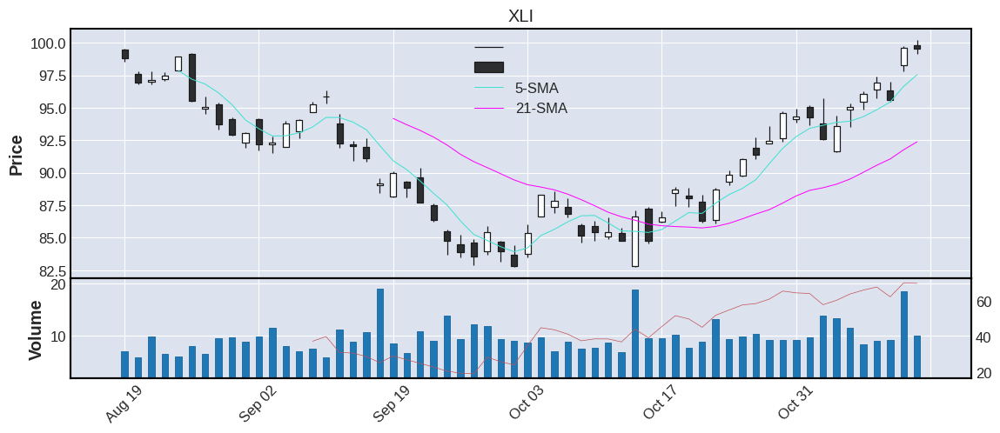



  TICKER     CP    HH    HL     LH     LL    HC    RSI  SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR      SECTOR  %ATR
3    XLF  35.87  True  True  False  False  True  68.63  34.8  33.31  32.59   34.72  45.27  516.93  0.82       0.8  Financials  2.23


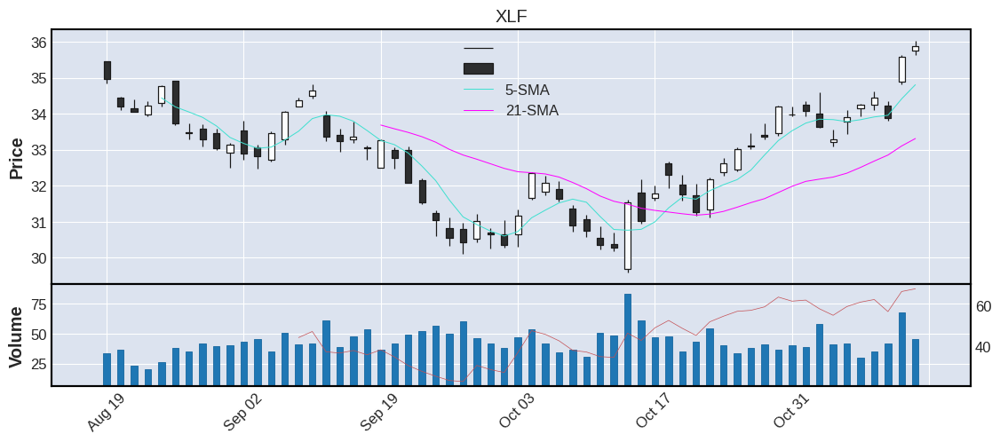



  TICKER     CP     HH    HL     LH     LL    HC   RSI   SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR  SECTOR  %ATR
4    XLE  93.13  False  True  False  False  True  64.8  91.65  88.12  82.13   77.78  24.42  283.94  2.91      2.48  Energy  2.66


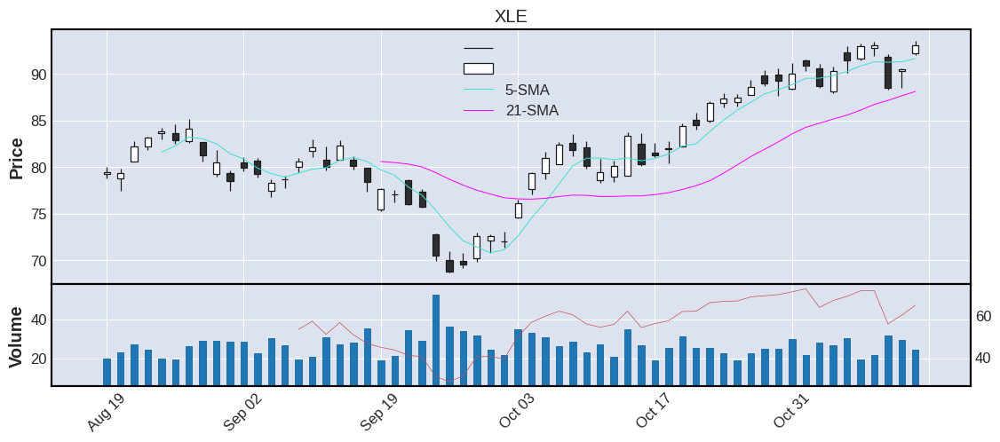



  TICKER     CP    HH    HL     LH     LL     HC    RSI   SMA5  SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR       SECTOR  %ATR
5   XLRE  38.74  True  True  False  False  False  64.71  37.22  35.93  37.27   42.77  7.29   90.08 -0.05      0.98  Real_Estate  2.53


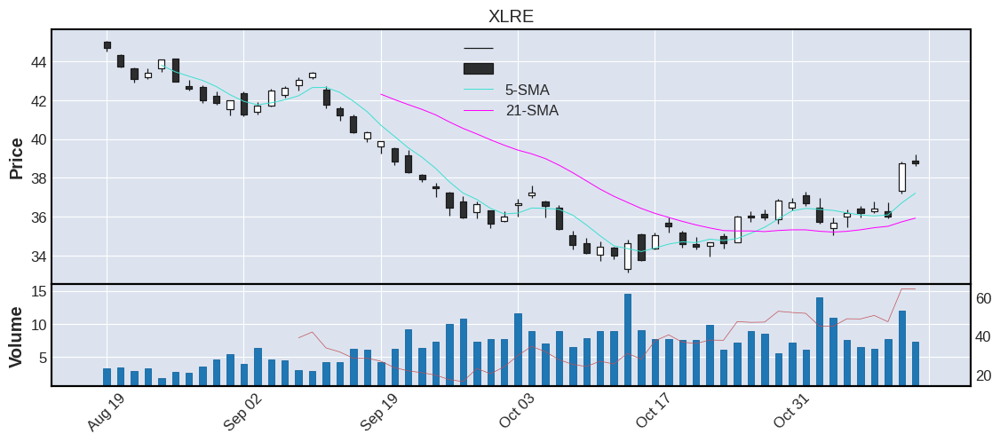



  TICKER     CP    HH     HL     LH     LL     HC   RSI   SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR            SECTOR  %ATR
6    XLP  73.52  True  False  False  False  False  62.2  72.84  71.03  70.43   73.71  14.27  143.41 -0.11      1.28  Consumer_Staples  1.74


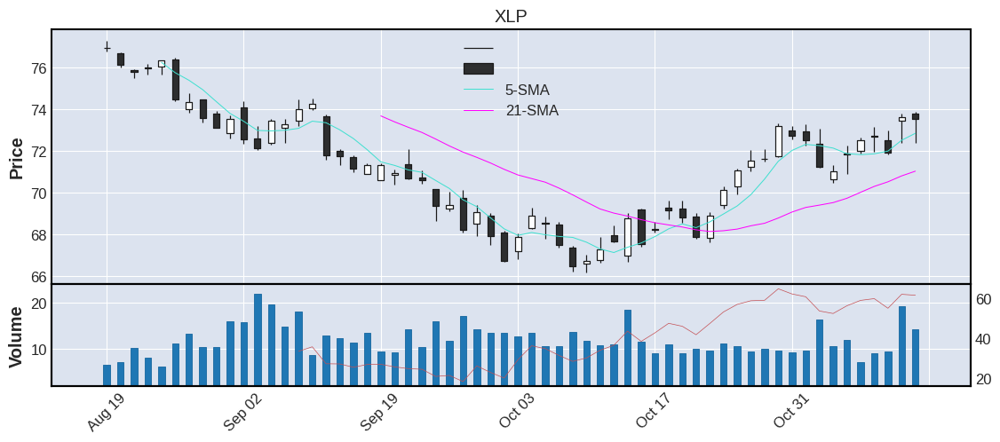



  TICKER      CP    HH    HL     LH     LL    HC    RSI    SMA5   SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR      SECTOR  %ATR
7    XLK  133.14  True  True  False  False  True  60.85  126.44  124.19  125.6  139.41  7.83    92.6  1.71      3.85  Technology  2.89


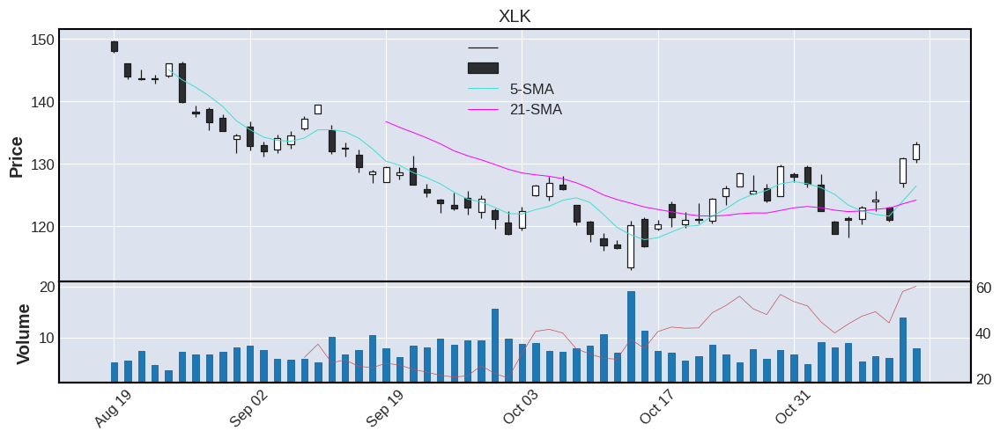



  TICKER      CP     HH     HL     LH     LL     HC    RSI    SMA5   SMA21   SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR      SECTOR  %ATR
8    XLV  133.13  False  False  False  False  False  59.38  132.89  129.85  127.02  130.12  10.49  106.22 -1.22      2.51  Healthcare  1.89


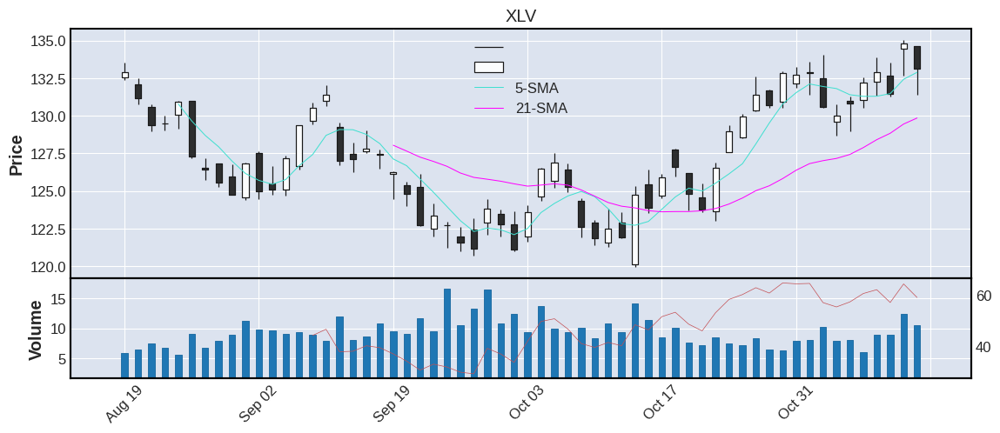



  TICKER     CP    HH    HL     LH     LL    HC    RSI   SMA5  SMA21  SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR                 SECTOR  %ATR
9    XLC  50.02  True  True  False  False  True  55.74  47.57  48.46  49.85   58.66  9.25   81.95  2.63       1.4  Communication_Serives   2.8


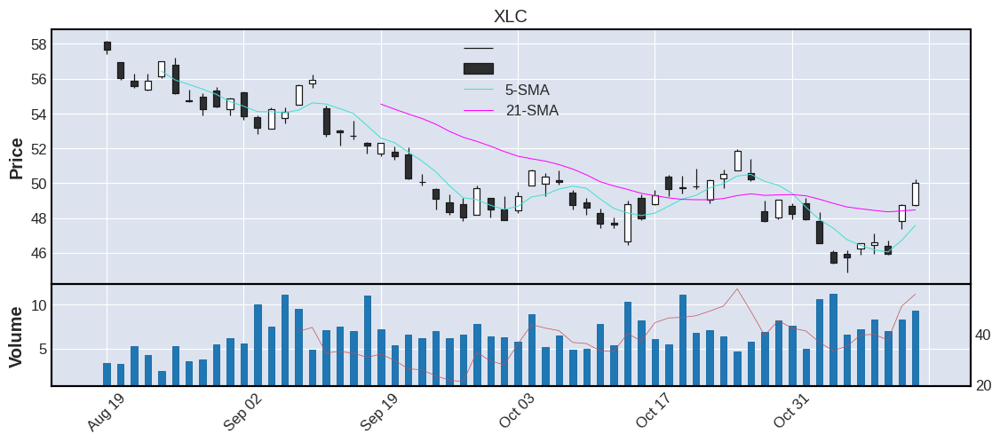



   TICKER     CP    HH    HL     LH     LL     HC    RSI   SMA5  SMA21  SMA50  SMA200    VOL  AVGVOL  %CHG  AVG10ATR     SECTOR  %ATR
10    XLU  68.08  True  True  False  False  False  55.41  66.95  65.49  68.55   70.96  15.31  153.71 -1.12      1.68  Utilities  2.47


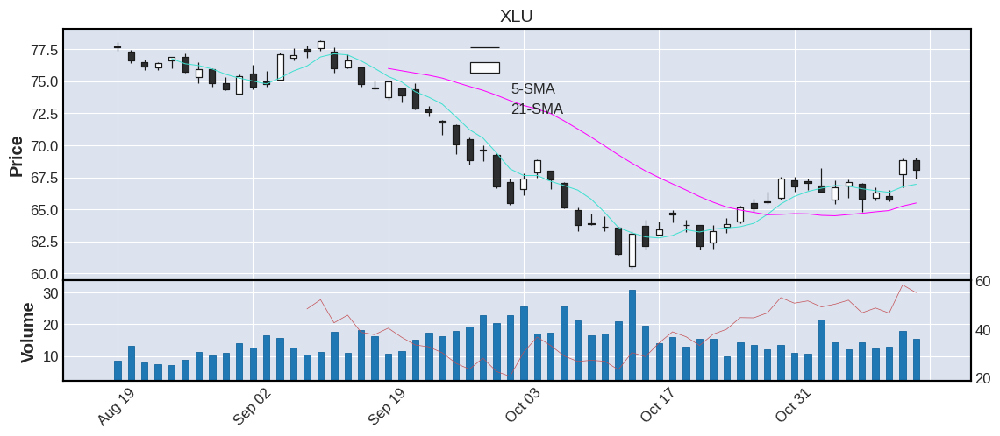



   TICKER      CP    HH    HL     LH     LL    HC    RSI    SMA5   SMA21   SMA50  SMA200   VOL  AVGVOL  %CHG  AVG10ATR                  SECTOR  %ATR
11    XLY  145.09  True  True  False  False  True  54.56  138.31  140.69  146.63  159.47  5.52   61.18   2.4      4.56  Consumer_Discretionary  3.14


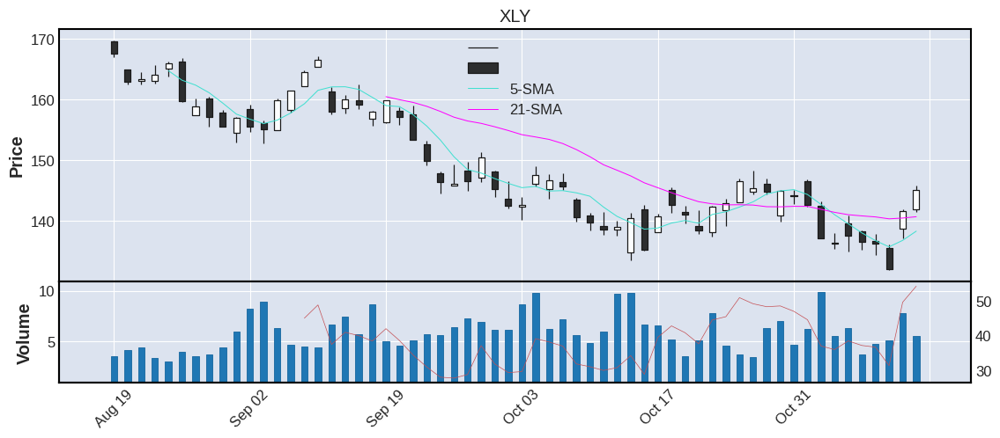

In [10]:
#plotting the sectors

tick=df_sector['TICKER'].to_list()
sec=df_sector['SECTOR'].to_list()
root='/home/thakur/test/sector'
for c,i in enumerate(tick):
    #file=root.format(cat[c],i)
    #print(f"file: {file}")
    print(f"\n\n{df_sector[df_sector['TICKER']==i].to_string()}")
    plot_with_mpl(root,i,sty='default')

In [11]:
#dataframe which includes the information about the performance
df=pd.read_csv('/home/thakur/test/combined/all_nasdaq.csv')
df['IPO'].fillna(0,inplace=True);df['IPO'].astype(float)
df.fillna('N-A',inplace=True)
df=df[(df['%CHG']!=np.inf) & (df['%CHG']!='N/A') & (df['CP']>0)]
df['%ATR']=round(100*df['ATR']/df['CP'],2)
df['SECTOR'] = df['SECTOR'].apply(lambda x:x.replace(' ', '_'))

df.head()

,TICKER,CP,EMA8,HH,HL,LH,LL,HC,HV,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,COUNTRY,CATEGORY,%ATR
0,AAPL,149.70,143.88,True,True,False,False,True,False,54.56,141.97,145.09,147.66,155.68,93.63,92.14,1.93,5.83,Technology,Computer Manufacturing,1980.0,United States,mega,3.89
1,ABBV,150.16,148.29,False,False,False,False,True,False,59.10,148.83,147.19,143.46,147.96,5.59,4.94,0.29,3.74,Health_Care,Other Pharmaceuticals,2012.0,United States,mega,2.49
2,AMZN,100.79,95.52,True,True,False,False,True,False,45.87,92.81,104.42,113.93,129.24,109.31,107.94,4.31,5.59,Consumer_Discretionary,Catalog/Specialty Distribution,1997.0,United States,mega,5.55
3,BAC,38.41,37.15,True,True,False,False,True,False,71.96,37.44,35.67,33.80,36.75,30.40,35.29,0.73,0.94,Finance,Major Banks,0.0,United States,mega,2.45
4,BRK-A,469047.00,447730.38,True,True,False,False,True,True,68.31,448666.40,435633.43,422999.54,455451.86,0.00,0.00,2.49,13623.32,N-A,N-A,0.0,United States,mega,2.90


# NASDAQ BEST

In [12]:
# HH, HL, HC
temp_df=df.copy()\
.query('HH & HL & HC & HV & (CP>SMA50) & (CP>SMA200) & (`%CHG`>0) & VOL>0.5') \
.sort_values(by='CP',ascending=True)\
.replace(['micro','nano','mega','large'],np.nan,inplace=False)\
.pipe(lambda x:x.loc[(x.COUNTRY=='United States')])\
.dropna()\
.drop(['LL','LH','SMA21','HL','HH','HC','HV','COUNTRY'],axis=1)\
.reset_index(drop=True)\


temp_df

,TICKER,CP,EMA8,RSI,SMA5,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,CATEGORY,%ATR
0,LXRX,2.37,2.17,57.67,2.15,2.33,2.35,0.62,0.49,5.80,0.15,Health_Care,Biotechnology: Biological Products (No Diagnos...,0.0,small,6.33
1,BNGO,2.66,2.36,62.20,2.34,2.17,2.04,20.96,10.13,10.37,0.24,Industrials,Biotechnology: Laboratory Analytical Instruments,2018.0,small,9.02
2,TTI,4.02,3.62,50.35,3.32,4.01,3.95,1.64,0.97,0.75,0.78,Energy,Oil & Gas Production,0.0,small,19.40
3,FINV,4.79,4.58,57.44,4.60,4.53,4.27,0.87,0.71,5.27,0.29,Finance,Finance: Consumer Services,2017.0,small,6.05
4,COTY,7.76,7.09,63.53,7.15,7.00,7.69,12.12,8.88,6.01,0.39,Consumer_Discretionary,Package Goods/Cosmetics,2013.0,medium,5.03
5,PAYA,8.84,8.43,70.92,8.67,6.76,6.24,0.80,0.72,0.23,0.47,Technology,Computer Software: Prepackaged Software,0.0,small,5.32
6,PNT,9.14,8.84,57.48,8.84,8.43,7.77,0.92,0.52,0.55,0.54,Health_Care,Medicinal Chemicals and Botanical Products,2020.0,small,5.91
7,INDI,9.16,8.02,69.07,8.03,7.79,7.35,5.37,1.93,13.09,0.48,Technology,Semiconductors,0.0,small,5.24
8,GGMC,10.00,9.93,80.34,9.93,9.85,9.79,4.93,1.02,0.91,0.02,Industrials,Consumer Electronics/Appliances,2021.0,small,0.20
9,AM,11.18,10.93,64.81,11.02,10.10,10.16,3.85,3.13,0.18,0.32,Utilities,Natural Gas Distribution,2017.0,medium,2.86


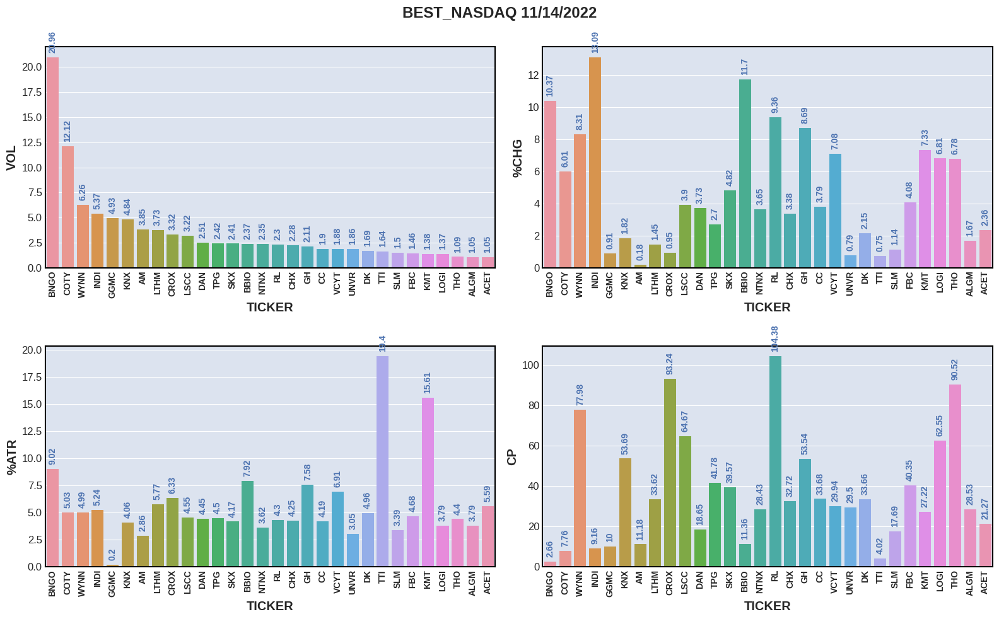

In [13]:
compare_bars(temp_df,title='best_nasdaq')

In [14]:
ticker='LXRX'
root=temp_df.loc[temp_df.TICKER==ticker,]['CATEGORY'].values[0]
root

'small'



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                                                       INDUSTRY  IPO CATEGORY  %ATR
0   LXRX  2.37  2.17  57.67  2.15   2.33    2.35  0.62    0.49   5.8  0.15  Health_Care  Biotechnology: Biological Products (No Diagnostic Substances)  0.0    small  6.33


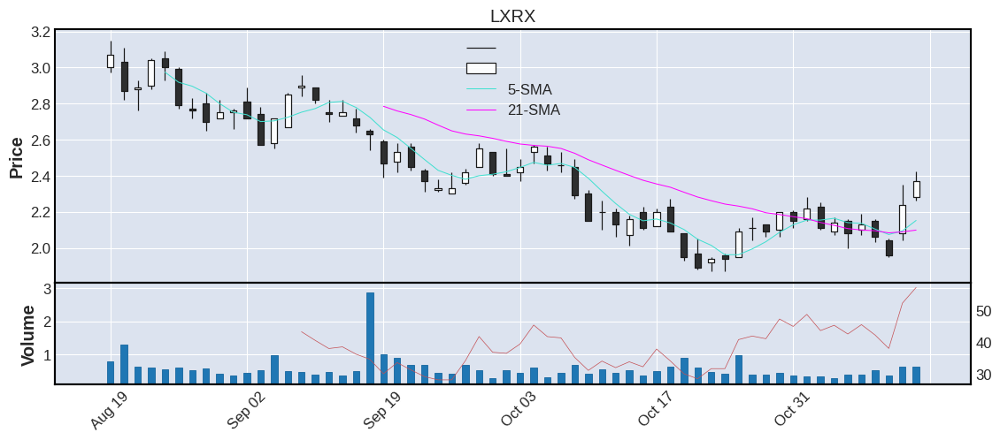



  TICKER    CP  EMA8   RSI  SMA5  SMA50  SMA200    VOL  AVGVOL   %CHG   ATR       SECTOR                                          INDUSTRY     IPO CATEGORY  %ATR
1   BNGO  2.66  2.36  62.2  2.34   2.17    2.04  20.96   10.13  10.37  0.24  Industrials  Biotechnology: Laboratory Analytical Instruments  2018.0    small  9.02


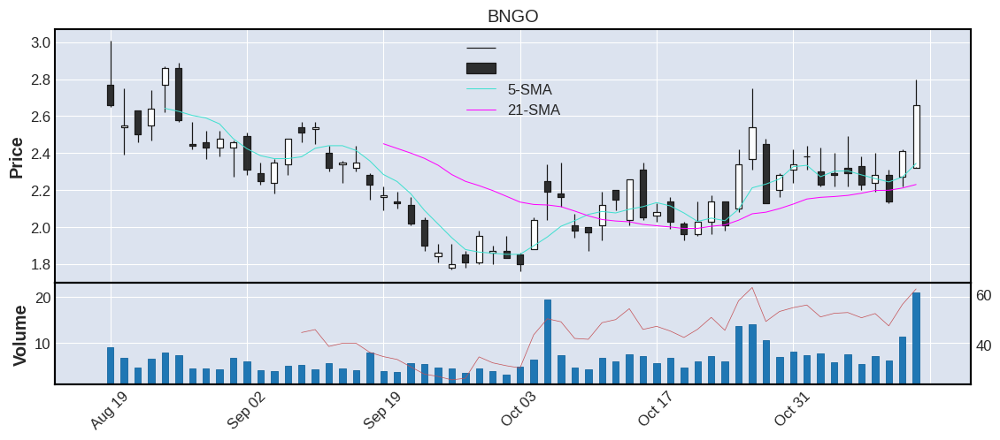



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR  SECTOR              INDUSTRY  IPO CATEGORY  %ATR
2    TTI  4.02  3.62  50.35  3.32   4.01    3.95  1.64    0.97  0.75  0.78  Energy  Oil & Gas Production  0.0    small  19.4


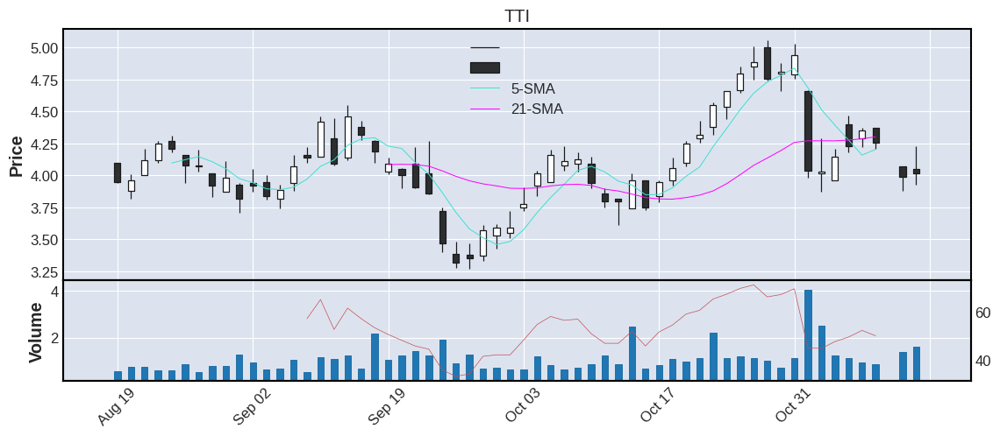



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR   SECTOR                    INDUSTRY     IPO CATEGORY  %ATR
3   FINV  4.79  4.58  57.44   4.6   4.53    4.27  0.87    0.71  5.27  0.29  Finance  Finance: Consumer Services  2017.0    small  6.05


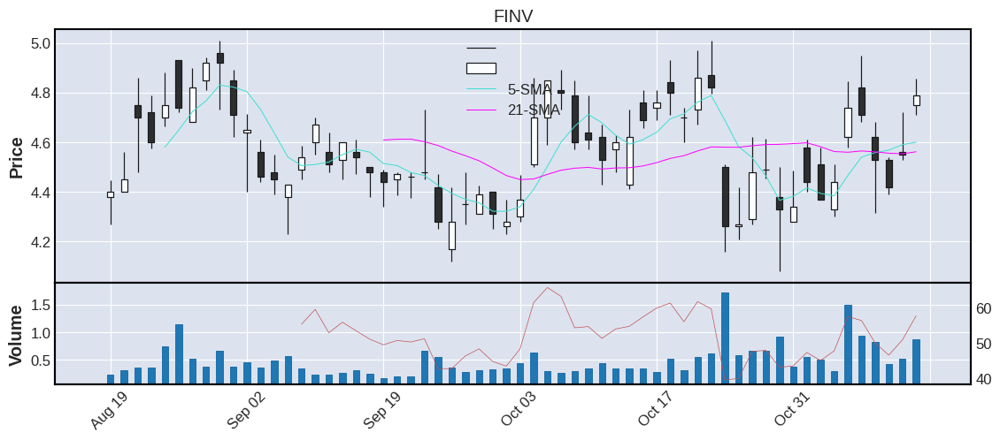



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200    VOL  AVGVOL  %CHG   ATR                  SECTOR                 INDUSTRY     IPO CATEGORY  %ATR
4   COTY  7.76  7.09  63.53  7.15    7.0    7.69  12.12    8.88  6.01  0.39  Consumer_Discretionary  Package Goods/Cosmetics  2013.0   medium  5.03


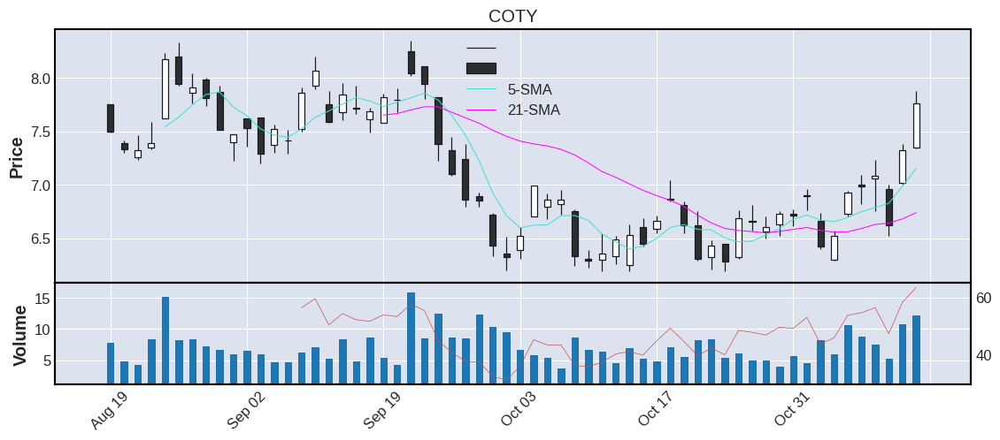



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200  VOL  AVGVOL  %CHG   ATR      SECTOR                                 INDUSTRY  IPO CATEGORY  %ATR
5   PAYA  8.84  8.43  70.92  8.67   6.76    6.24  0.8    0.72  0.23  0.47  Technology  Computer Software: Prepackaged Software  0.0    small  5.32


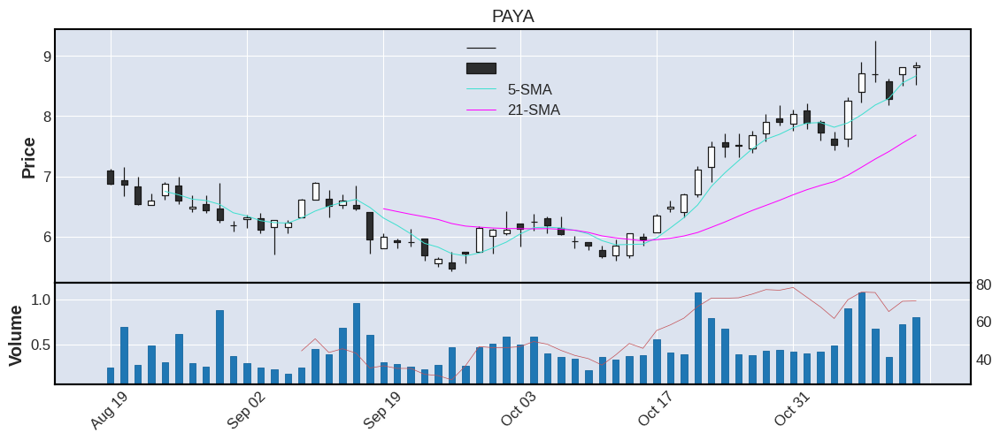



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                                      INDUSTRY     IPO CATEGORY  %ATR
6    PNT  9.14  8.84  57.48  8.84   8.43    7.77  0.92    0.52  0.55  0.54  Health_Care   Medicinal Chemicals and Botanical Products   2020.0    small  5.91


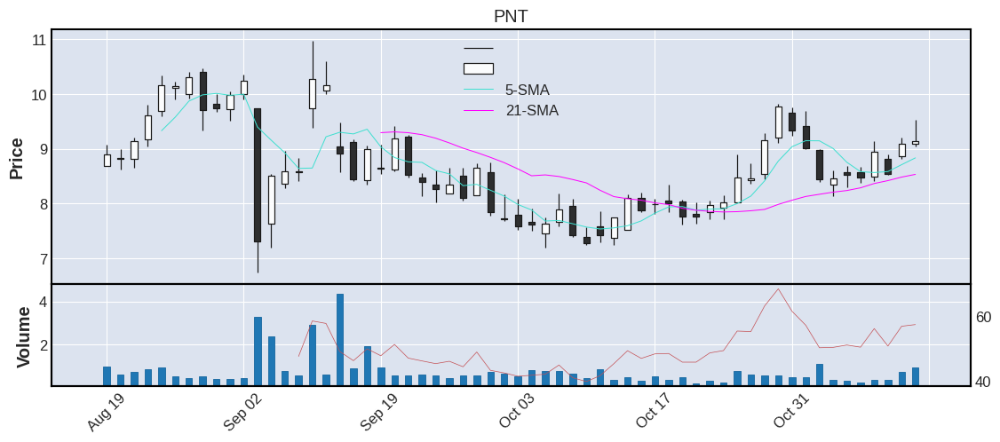



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL   %CHG   ATR      SECTOR        INDUSTRY  IPO CATEGORY  %ATR
7   INDI  9.16  8.02  69.07  8.03   7.79    7.35  5.37    1.93  13.09  0.48  Technology  Semiconductors  0.0    small  5.24


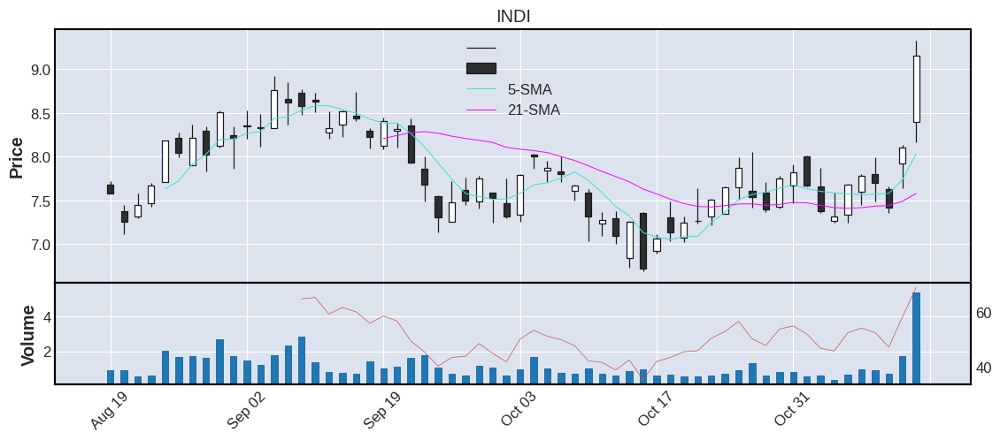



  TICKER    CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                         INDUSTRY     IPO CATEGORY  %ATR
8   GGMC  10.0  9.93  80.34  9.93   9.85    9.79  4.93    1.02  0.91  0.02  Industrials  Consumer Electronics/Appliances  2021.0    small   0.2


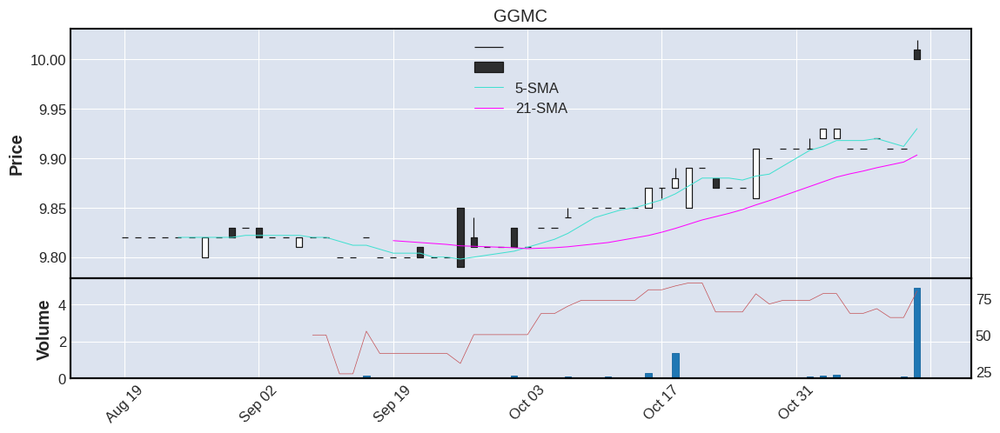



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR     SECTOR                  INDUSTRY     IPO CATEGORY  %ATR
9     AM  11.18  10.93  64.81  11.02   10.1   10.16  3.85    3.13  0.18  0.32  Utilities  Natural Gas Distribution  2017.0   medium  2.86


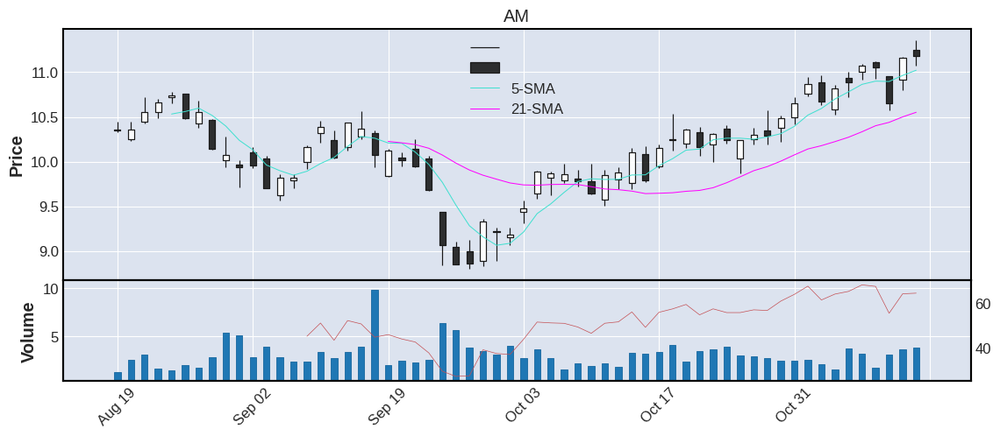



   TICKER     CP  EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL   %CHG   ATR       SECTOR              INDUSTRY     IPO CATEGORY  %ATR
10   SGHT  11.28  8.55  76.28  8.49   7.06    9.89  1.03     0.3  34.93  1.03  Health_Care  Medical Specialities  2021.0    small  9.13


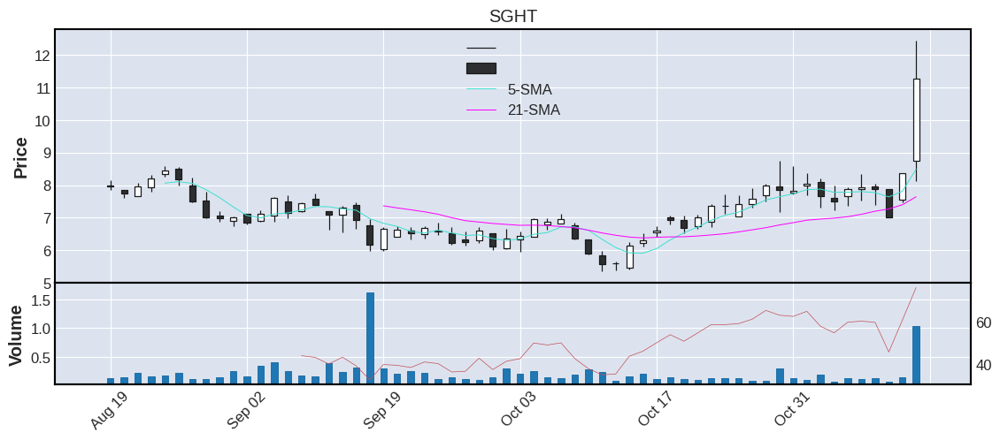



   TICKER     CP   EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG  ATR       SECTOR                                    INDUSTRY     IPO CATEGORY  %ATR
11   BBIO  11.36  10.03  57.81  9.68  10.53     9.5  2.37    1.71  11.7  0.9  Health_Care  Biotechnology: Pharmaceutical Preparations  2019.0    small  7.92


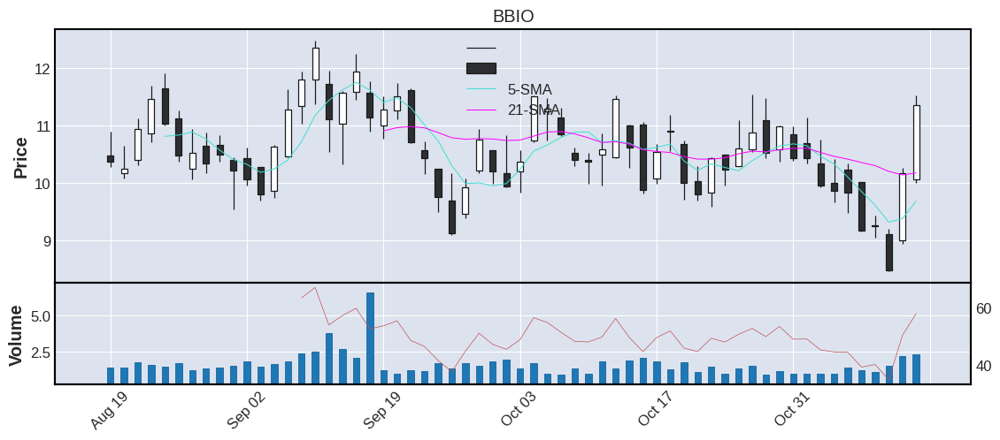



   TICKER     CP   EMA8   RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR        INDUSTRY     IPO CATEGORY  %ATR
12   CRDO  14.91  14.01  67.2  14.03  12.27   12.89  1.04    0.84  3.83  0.68  Technology  Semiconductors  2022.0   medium  4.56


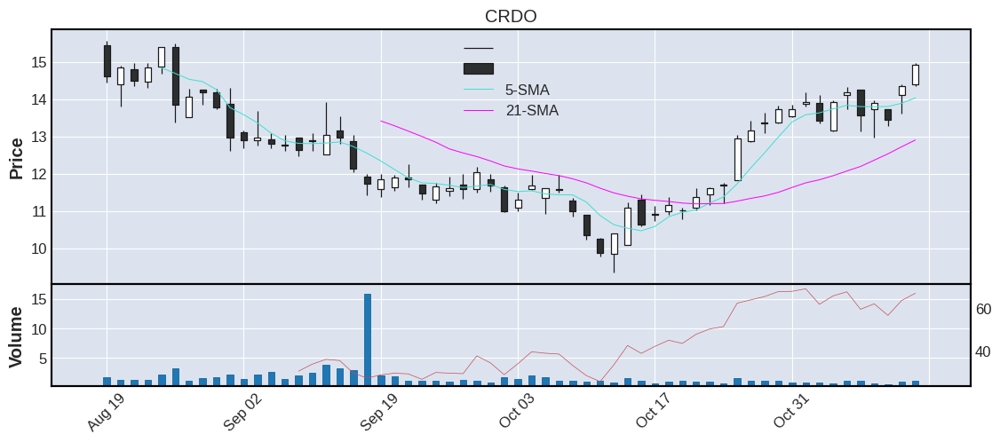



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200  VOL  AVGVOL  %CHG  ATR   SECTOR                    INDUSTRY  IPO CATEGORY  %ATR
13    SLM  17.69  16.91  66.52  17.02  15.54   16.85  1.5    1.19  1.14  0.6  Finance  Finance: Consumer Services  0.0   medium  3.39


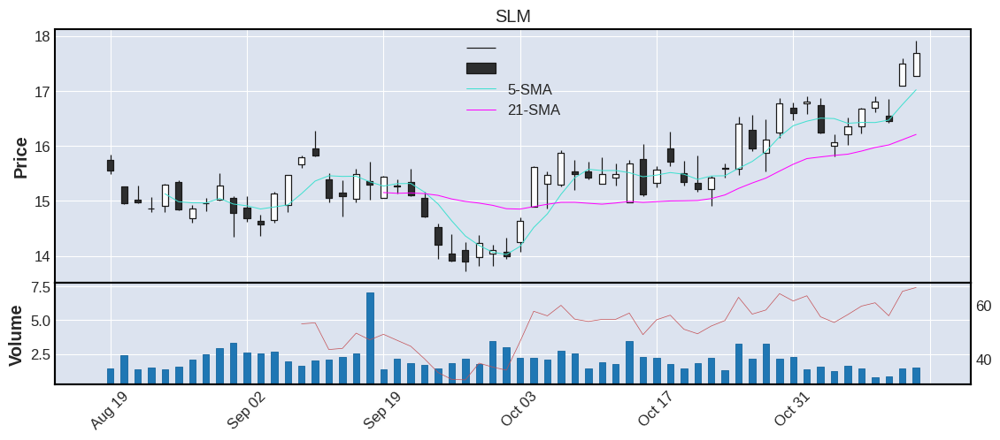



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR           INDUSTRY  IPO CATEGORY  %ATR
14    DAN  18.65  17.08  74.65  17.43  14.09   16.03  2.51    1.45  3.73  0.83  Consumer_Discretionary  Auto Parts:O.E.M.  0.0   medium  4.45


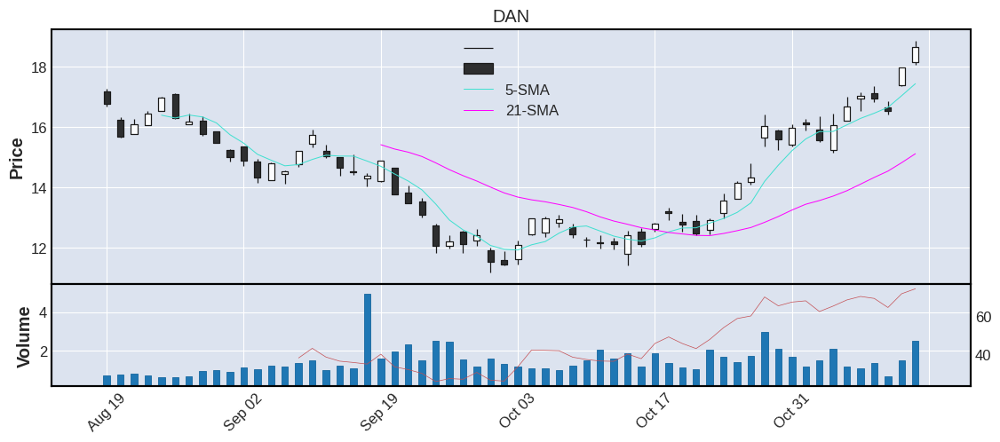



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR        INDUSTRY     IPO CATEGORY  %ATR
15   PLAB  18.69  17.44  71.14  17.67  15.72   18.06  0.77    0.54  1.58  0.68  Technology  Semiconductors  1987.0    small  3.64


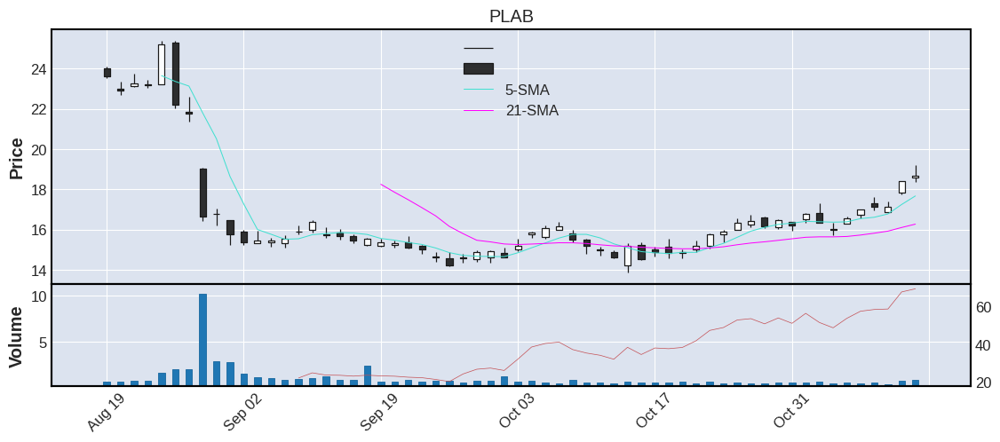



   TICKER    CP   EMA8   RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR        INDUSTRY     IPO CATEGORY  %ATR
16   TMST  19.6  18.43  63.3  18.79  16.35    18.5  0.67    0.47  2.73  1.12  Industrials  Steel/Iron Ore  2014.0    small  5.71


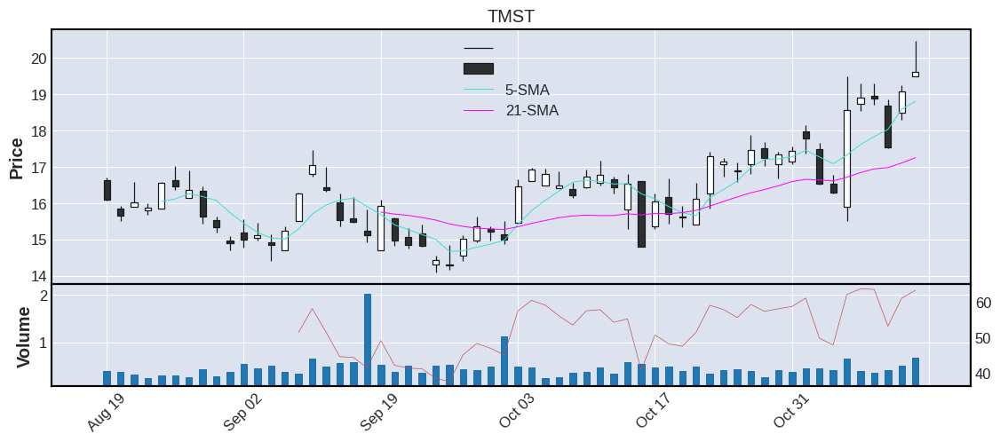



   TICKER     CP   EMA8    RSI  SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                                    INDUSTRY     IPO CATEGORY  %ATR
17   ACET  21.27  19.43  72.92  20.0  16.19   15.04  1.05    0.69  2.36  1.19  Health_Care  Biotechnology: Pharmaceutical Preparations  2018.0    small  5.59


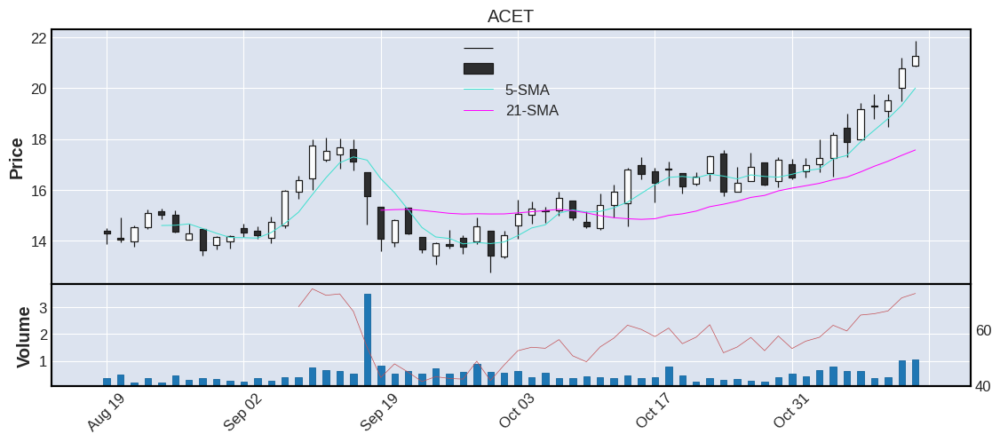



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                           INDUSTRY     IPO CATEGORY  %ATR
18   SNDR  24.04  22.78  67.67  22.89  21.76   23.57  0.97    0.59  2.34  0.72  Industrials  Trucking Freight/Courier Services  2017.0   medium   3.0


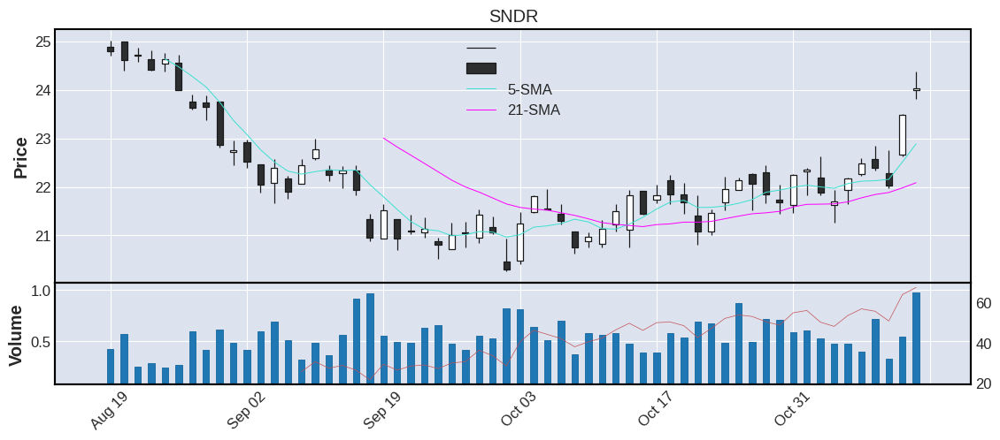



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR            INDUSTRY     IPO CATEGORY  %ATR
19   ACDC  24.99  23.78  68.65  24.42  19.47   12.07  0.85    0.61  1.88  1.51  Industrials  Metal Fabrications  2022.0    small  6.04


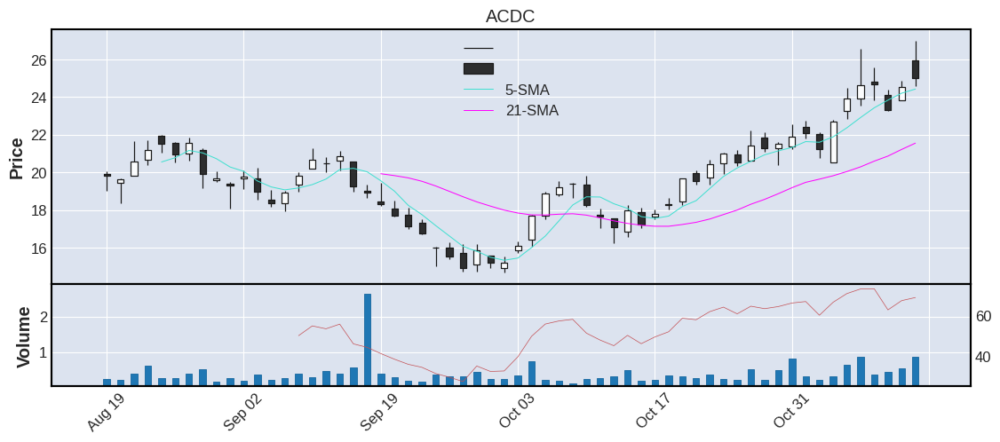



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR        INDUSTRY     IPO CATEGORY  %ATR
20   AMKR  25.24  22.64  81.32  23.09  19.04   19.91  1.02    0.95   4.9  0.96  Technology  Semiconductors  1998.0   medium   3.8


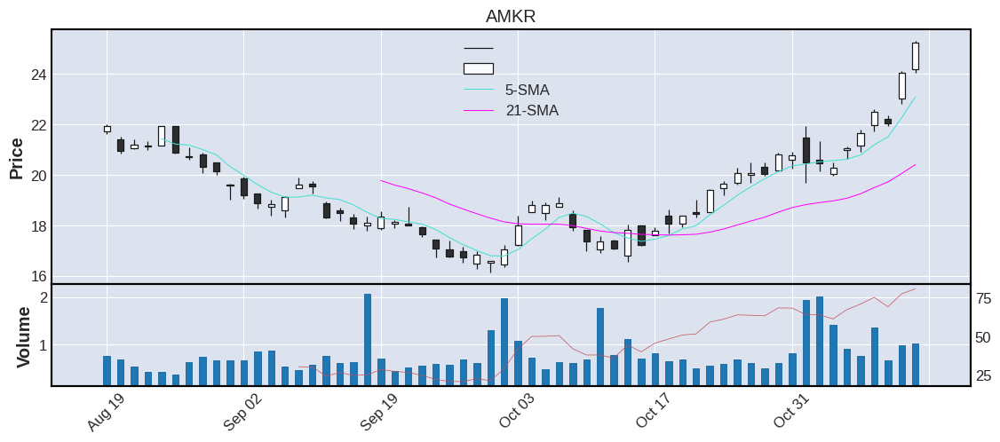



   TICKER     CP  EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL   %CHG   ATR       SECTOR                                    INDUSTRY     IPO CATEGORY  %ATR
21   IGMS  25.38  19.8  67.43  19.33  20.19   18.76  0.77    0.42  21.26  1.99  Health_Care  Biotechnology: Pharmaceutical Preparations  2019.0    small  7.84


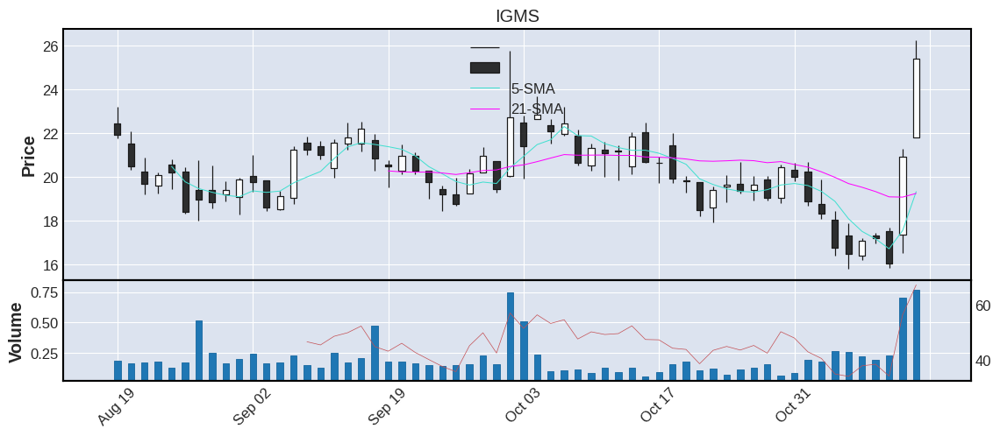



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                         INDUSTRY  IPO CATEGORY   %ATR
22    KMT  27.22  21.96  54.34  20.38  22.81   26.34  1.38    0.71  7.33  4.25  Industrials  Industrial Machinery/Components  0.0    small  15.61


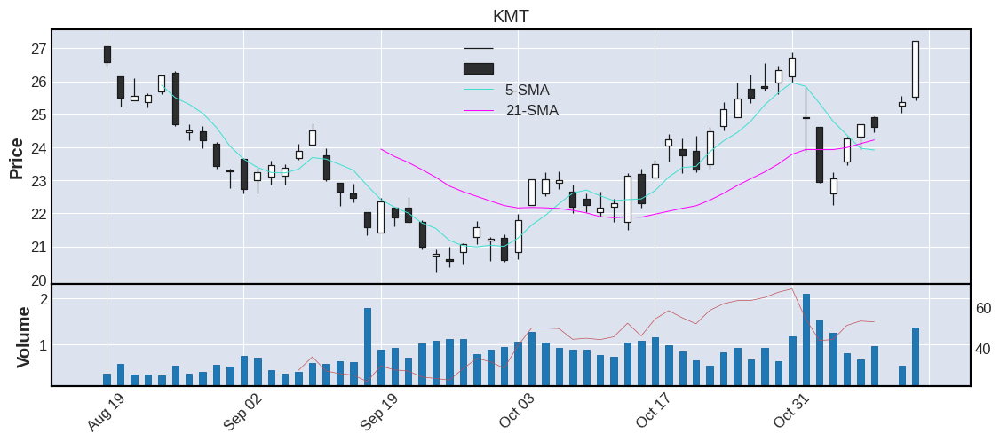



   TICKER     CP   EMA8   RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR      INDUSTRY     IPO CATEGORY  %ATR
23   NTNX  28.43  27.21  67.4  27.04  24.02    21.8  2.35    1.87  3.65  1.03  Technology  EDP Services  2016.0   medium  3.62


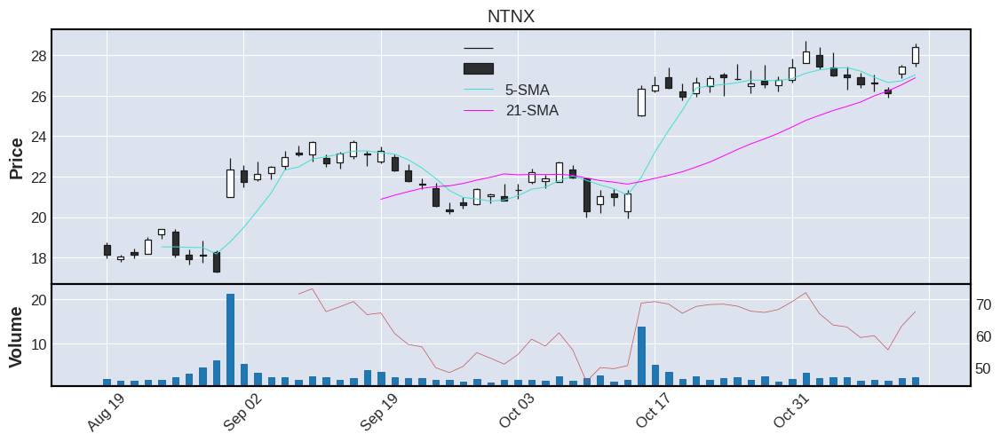



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR        INDUSTRY     IPO CATEGORY  %ATR
24   ALGM  28.53  26.72  77.78  27.11  23.17   24.51  1.05    0.83  1.67  1.08  Technology  Semiconductors  2020.0   medium  3.79


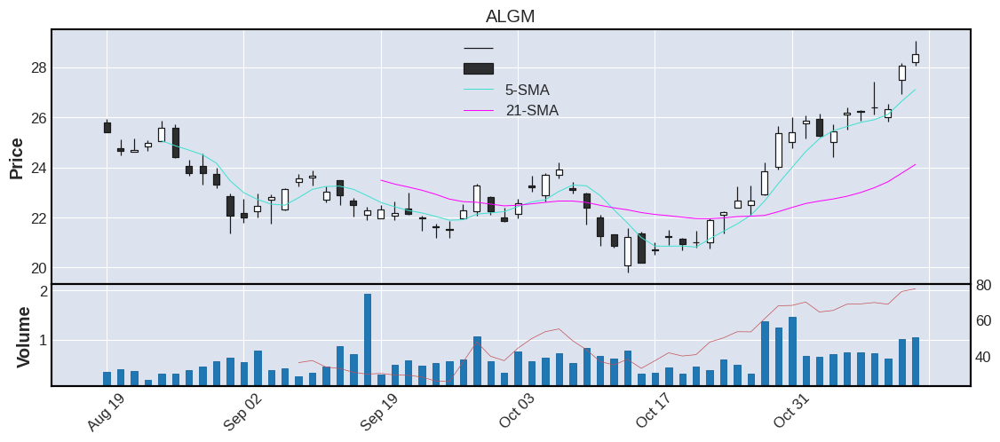



   TICKER    CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG  ATR       SECTOR             INDUSTRY     IPO CATEGORY  %ATR
25   UNVR  29.5  28.17  73.73  28.73  24.89    27.6  1.86    1.57  0.79  0.9  Industrials  Specialty Chemicals  2015.0   medium  3.05


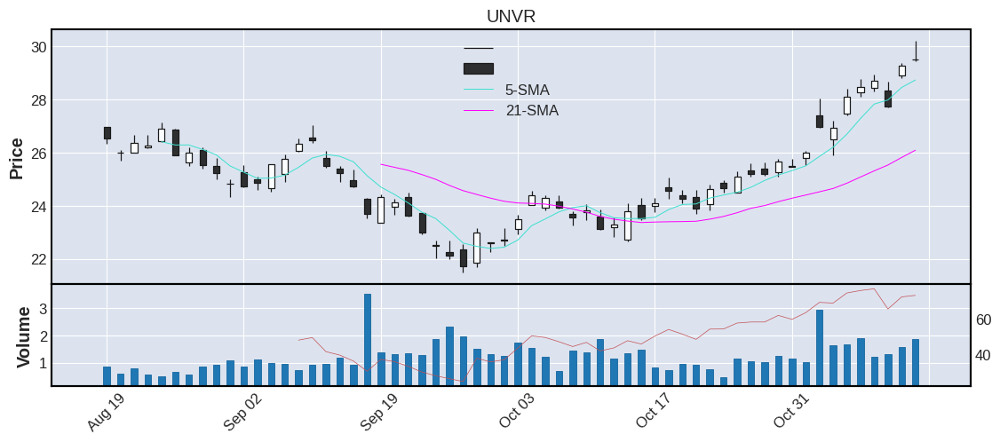



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL   %CHG   ATR      SECTOR      INDUSTRY     IPO CATEGORY  %ATR
26   PDFS  29.79  25.11  74.82  25.07  24.25   24.95  0.51     0.2  18.73  1.29  Technology  EDP Services  2001.0    small  4.33


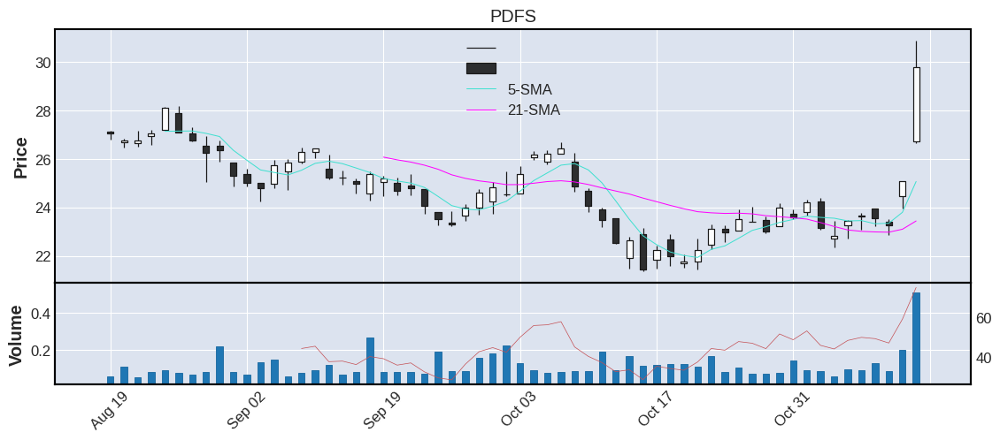



   TICKER     CP  EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR   INDUSTRY  IPO CATEGORY  %ATR
27    TRN  29.87  28.9  67.31  29.26  24.59   26.88  0.66    0.47  0.67  1.13  Industrials  Railroads  0.0   medium  3.78


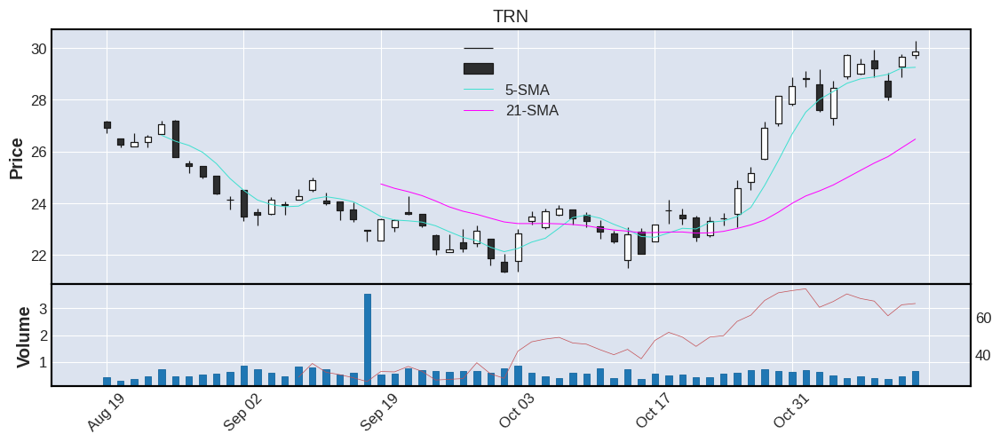



   TICKER     CP  EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                                    INDUSTRY     IPO CATEGORY  %ATR
28   VCYT  29.94  25.2  77.01  26.14  18.91   22.42  1.88    1.32  7.08  2.07  Health_Care  Biotechnology: Pharmaceutical Preparations  2013.0    small  6.91


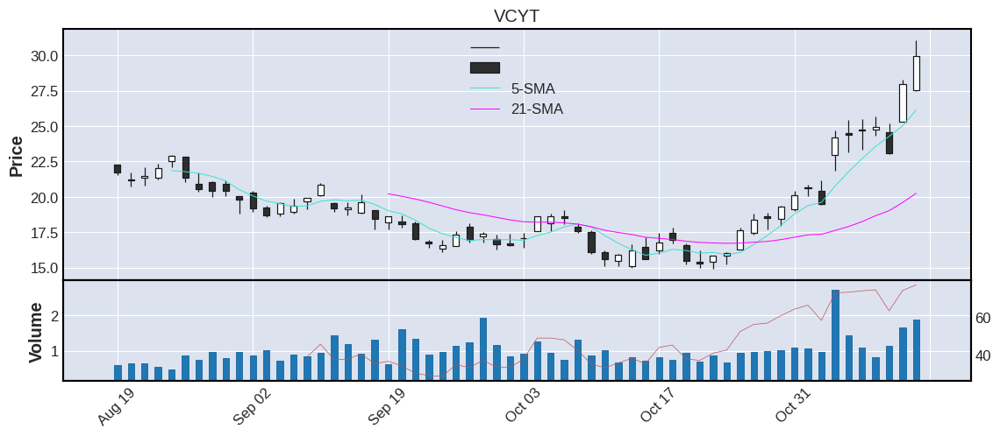



   TICKER     CP   EMA8   RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                          INDUSTRY  IPO CATEGORY  %ATR
29    CHX  32.72  30.88  76.1  31.73   23.6   22.52  2.28    2.35  3.38  1.39  Industrials  Construction/Ag Equipment/Trucks  0.0   medium  4.25


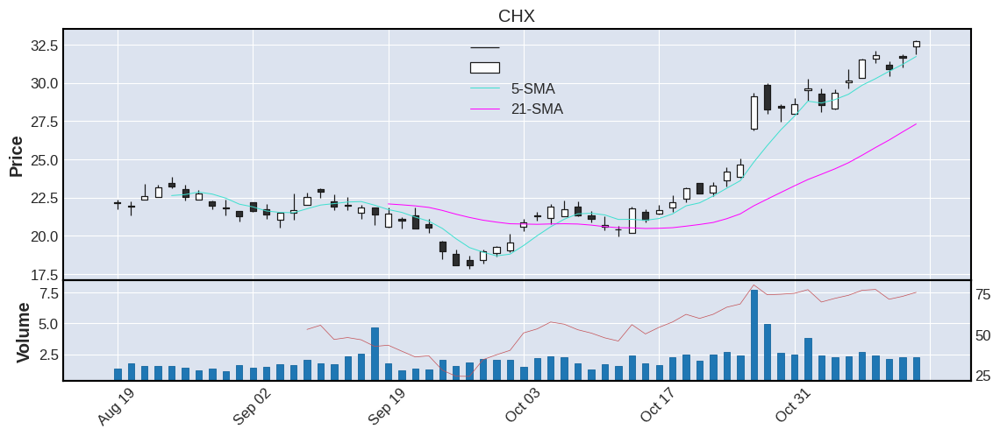



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                INDUSTRY     IPO CATEGORY  %ATR
30   LTHM  33.62  31.71  60.78  31.97  31.06   26.55  3.73    2.87  1.45  1.94  Industrials  Industrial Specialties  2018.0   medium  5.77


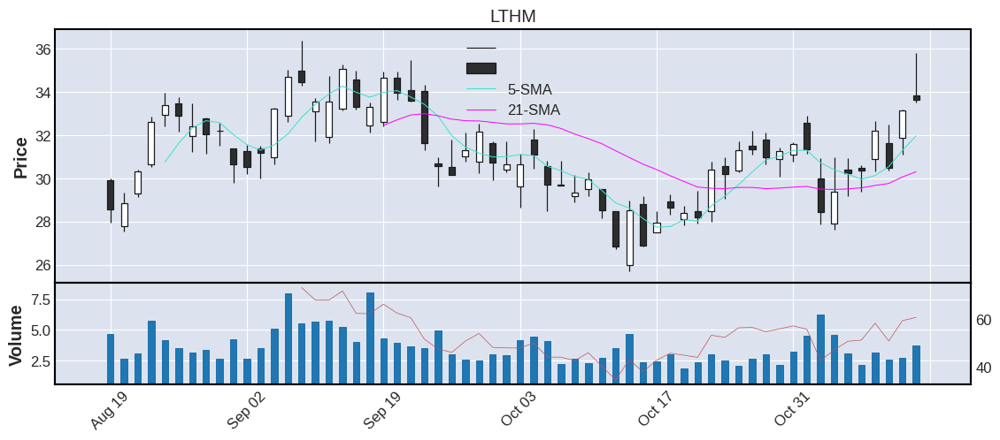



   TICKER     CP  EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR  SECTOR                  INDUSTRY     IPO CATEGORY  %ATR
31     DK  33.66  32.3  66.01  33.19  28.77   25.39  1.69    1.68  2.15  1.67  Energy  Integrated oil Companies  2017.0   medium  4.96


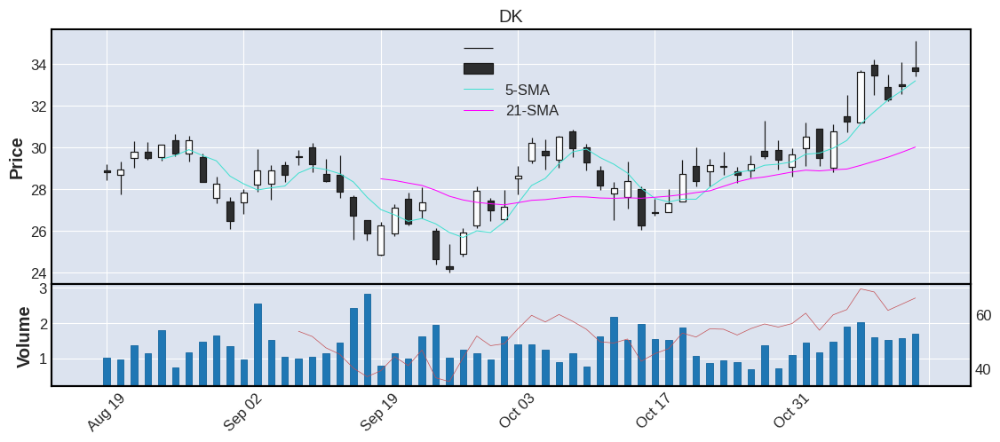



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200  VOL  AVGVOL  %CHG   ATR       SECTOR                INDUSTRY     IPO CATEGORY  %ATR
32     CC  33.68  30.92  70.23  31.29  29.27   32.81  1.9    1.15  3.79  1.41  Industrials  Industrial Specialties  2015.0   medium  4.19


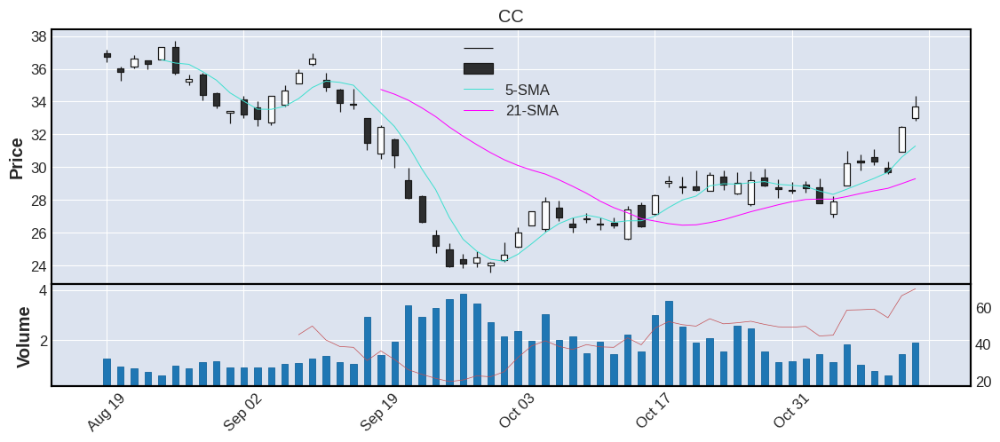



   TICKER     CP  EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR            INDUSTRY     IPO CATEGORY  %ATR
33    SKX  39.57  36.7  66.69  36.89  35.26   38.44  2.41    1.49  4.82  1.65  Consumer_Discretionary  Shoe Manufacturing  1999.0   medium  4.17


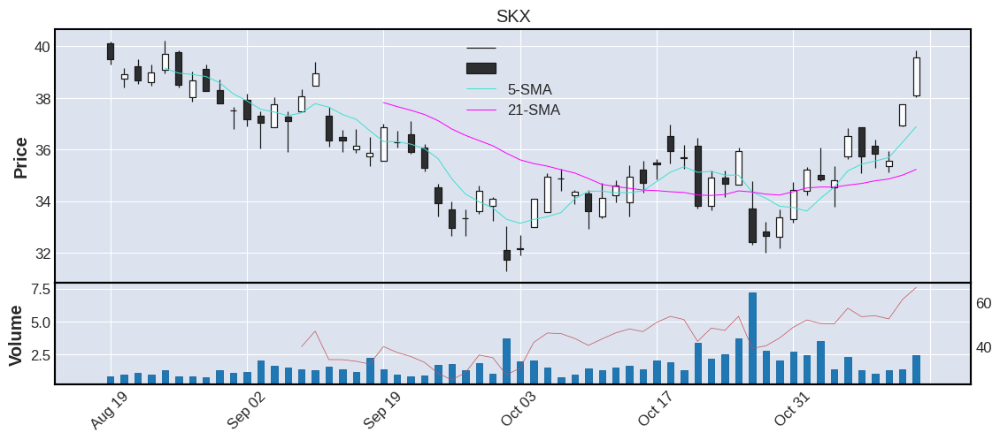



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR   SECTOR              INDUSTRY  IPO CATEGORY  %ATR
34    FBC  40.35  37.35  66.82  37.12  35.36   38.71  1.46    1.03  4.08  1.89  Finance  Savings Institutions  0.0    small  4.68


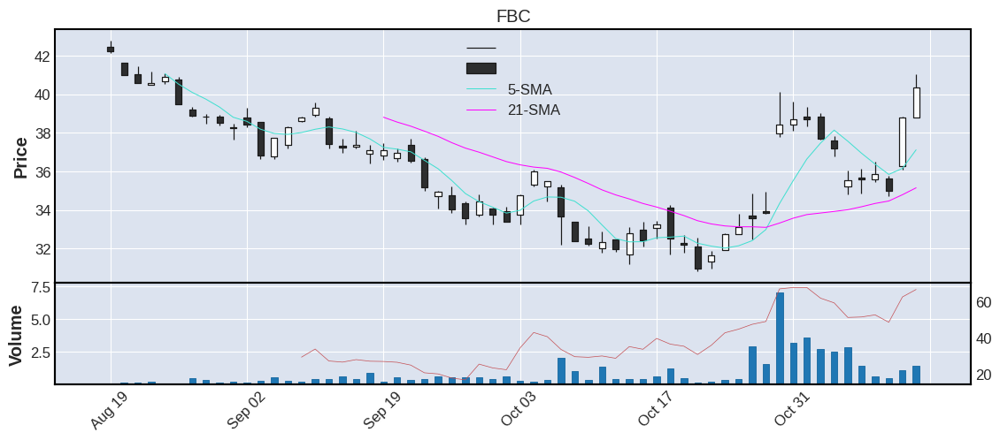



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                                    INDUSTRY     IPO CATEGORY  %ATR
35   AKRO  40.64  39.84  58.42  39.05  33.24   17.74  0.67    0.54  2.91  2.41  Health_Care  Biotechnology: Pharmaceutical Preparations  2019.0    small  5.93


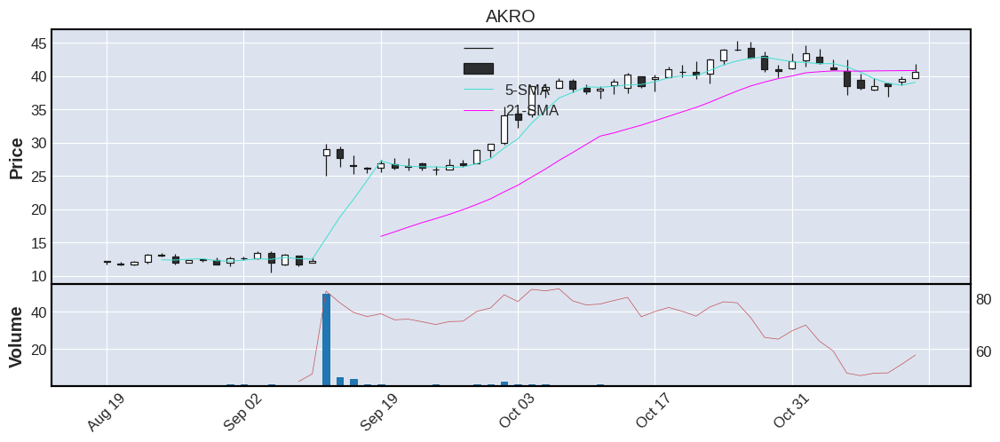



   TICKER     CP  EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                           INDUSTRY     IPO CATEGORY  %ATR
36   WERN  41.12  39.6  59.26  39.83  38.96    40.6  0.87    0.72  1.41  1.47  Industrials  Trucking Freight/Courier Services  1986.0   medium  3.57


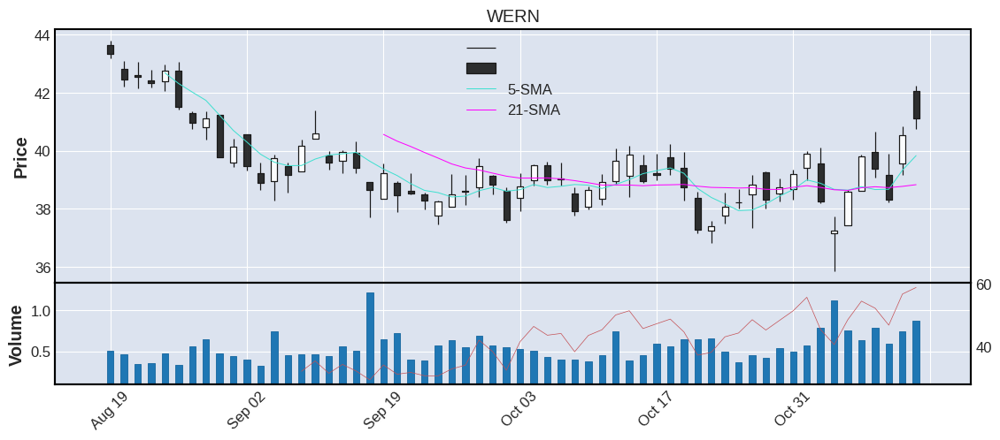



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR   SECTOR                                            INDUSTRY     IPO CATEGORY  %ATR
37    TPG  41.78  35.89  81.14  36.64  30.33   28.91  2.42    1.39   2.7  1.88  Finance  Trusts Except Educational Religious and Charitable  2022.0   medium   4.5


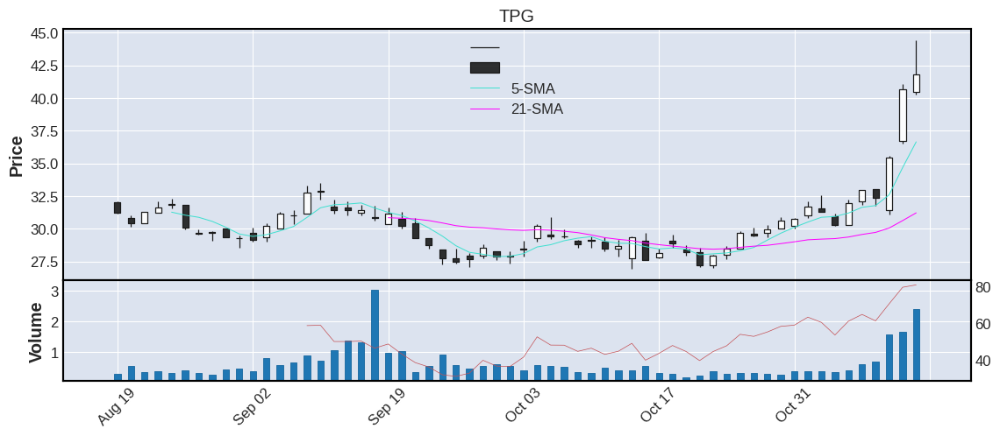



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR   SECTOR     INDUSTRY  IPO CATEGORY  %ATR
38    OZK  46.99  44.95  67.82  45.35  41.96   41.57  0.83    0.63  0.97  1.44  Finance  Major Banks  0.0   medium  3.06


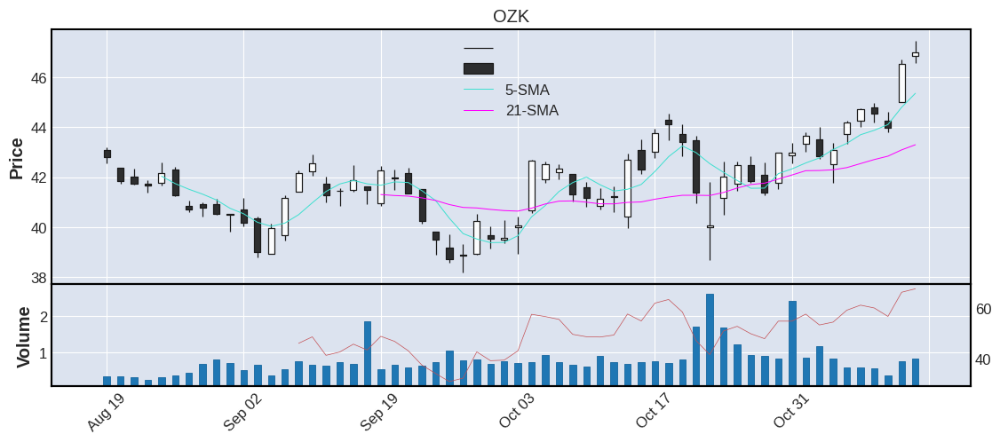



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR              INDUSTRY     IPO CATEGORY  %ATR
39     GH  53.54  47.86  58.19  47.15  51.49   53.19  2.11    1.44  8.69  4.06  Health_Care  Medical Specialities  2018.0   medium  7.58


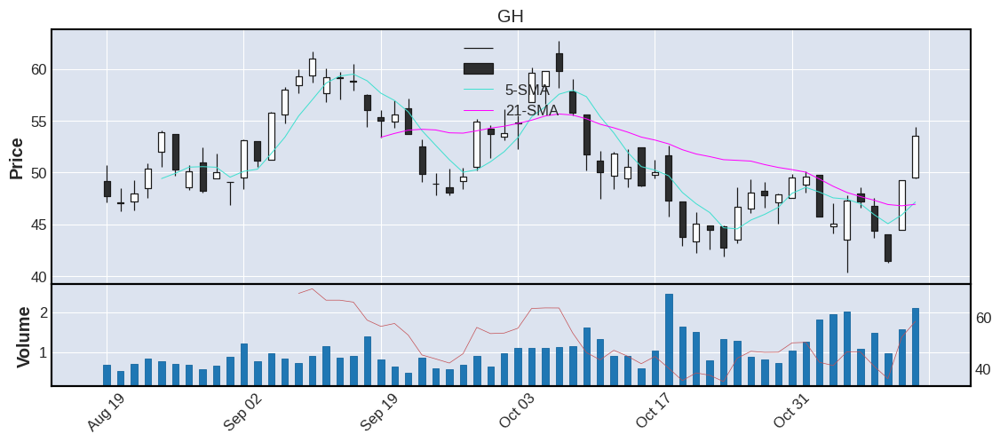



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                           INDUSTRY     IPO CATEGORY  %ATR
40    KNX  53.69  50.22  65.47  50.43  49.01   50.29  4.84    2.71  1.82  2.18  Industrials  Trucking Freight/Courier Services  2017.0   medium  4.06


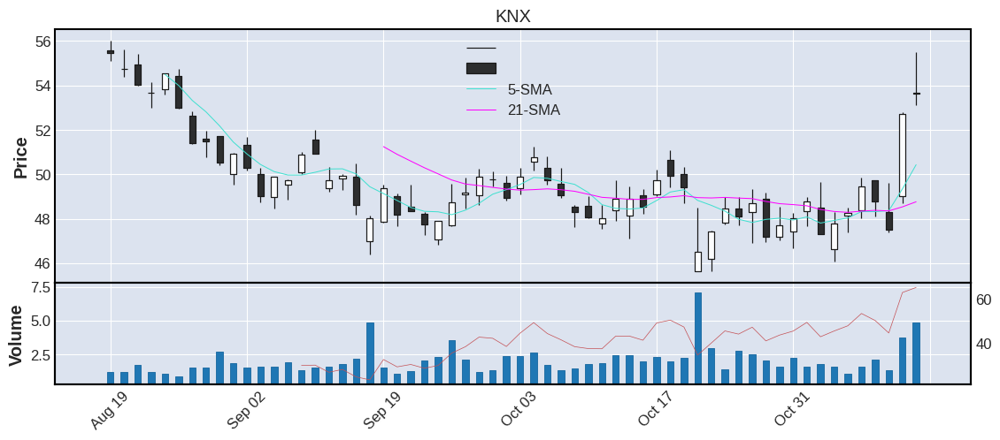



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                                                      INDUSTRY     IPO CATEGORY  %ATR
41   TMDX  56.26  53.45  63.93  55.35   47.1    33.2  0.64    0.59  0.09  3.89  Health_Care  Biotechnology: Electromedical & Electrotherapeutic Apparatus  2019.0    small  6.91


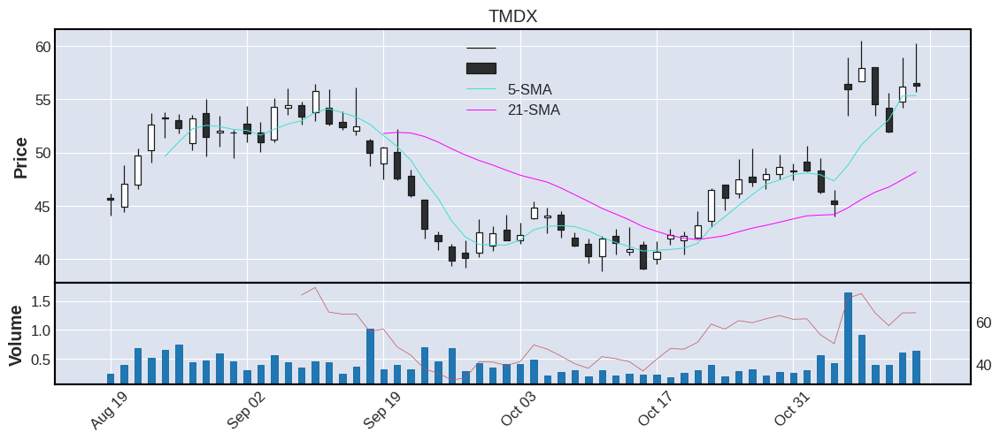



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR   SECTOR                            INDUSTRY     IPO CATEGORY  %ATR
42   SEIC  61.57  57.07  79.37  57.78  52.34   55.62  0.61    0.54  2.77  1.67  Finance  Investment Bankers/Brokers/Service  1981.0   medium  2.71


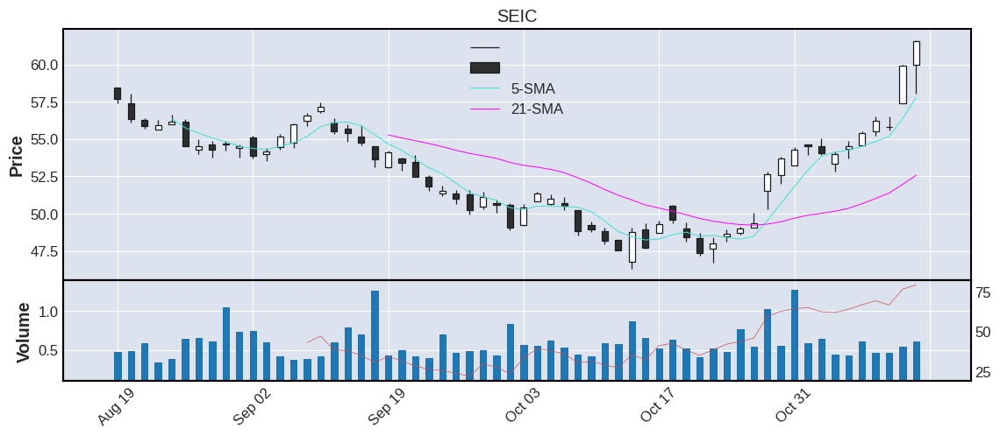



   TICKER     CP  EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR                       INDUSTRY     IPO CATEGORY  %ATR
43   LOGI  62.55  55.4  77.83  56.58   48.3   59.91  1.37    0.96  6.81  2.37  Technology  Computer peripheral equipment  1997.0   medium  3.79


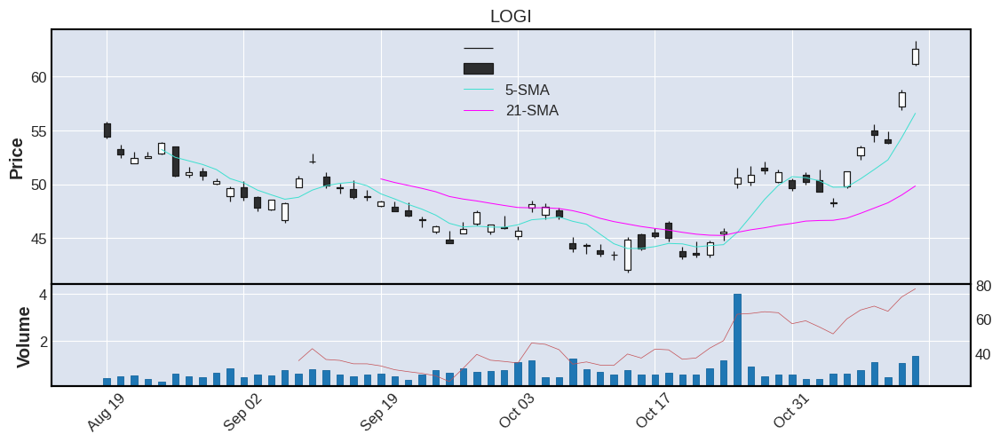



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR      SECTOR        INDUSTRY  IPO CATEGORY  %ATR
44   LSCC  64.67  57.01  74.42  57.95  51.32   53.82  3.22    2.16   3.9  2.94  Technology  Semiconductors  0.0   medium  4.55


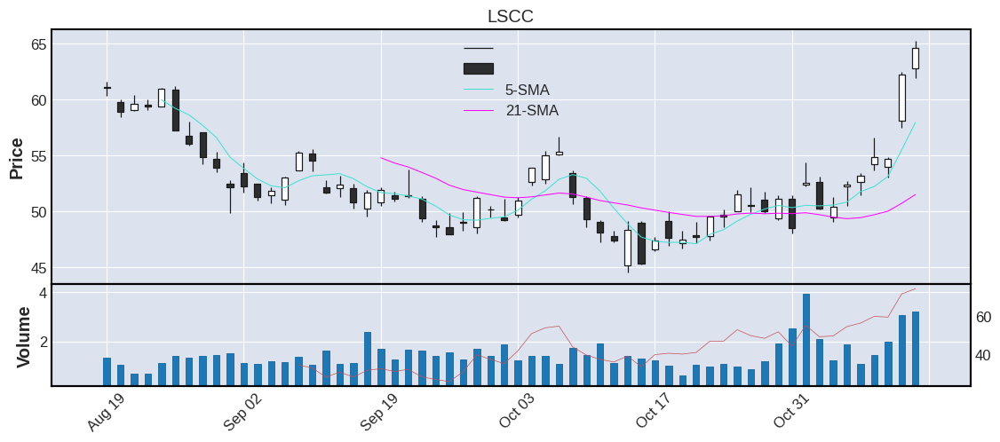



   TICKER     CP  EMA8   RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR            INDUSTRY  IPO CATEGORY  %ATR
45    TKR  73.71  71.7  64.3  72.22  65.74   62.26  0.75    0.69   1.8  2.31  Industrials  Metal Fabrications  0.0   medium  3.13


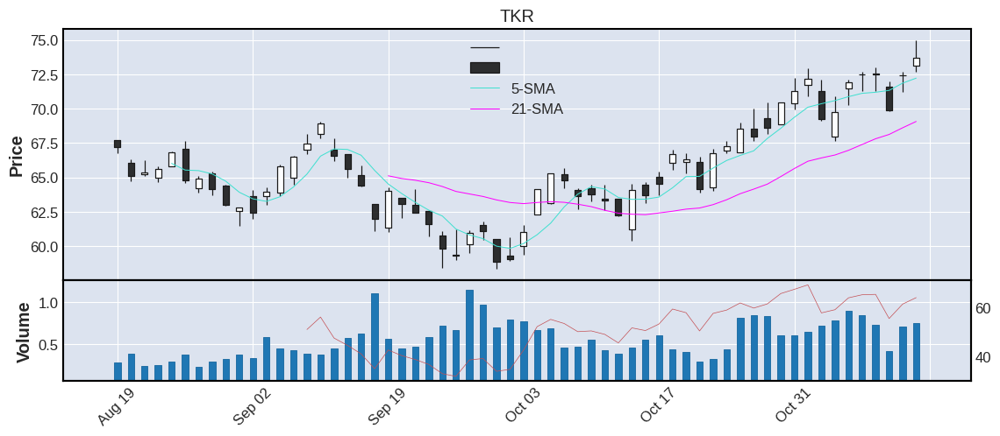



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR        INDUSTRY     IPO CATEGORY  %ATR
46   WYNN  77.98  70.66  68.82  72.19  63.64   68.38  6.26     4.5  8.31  3.89  Consumer_Discretionary  Hotels/Resorts  2002.0   medium  4.99


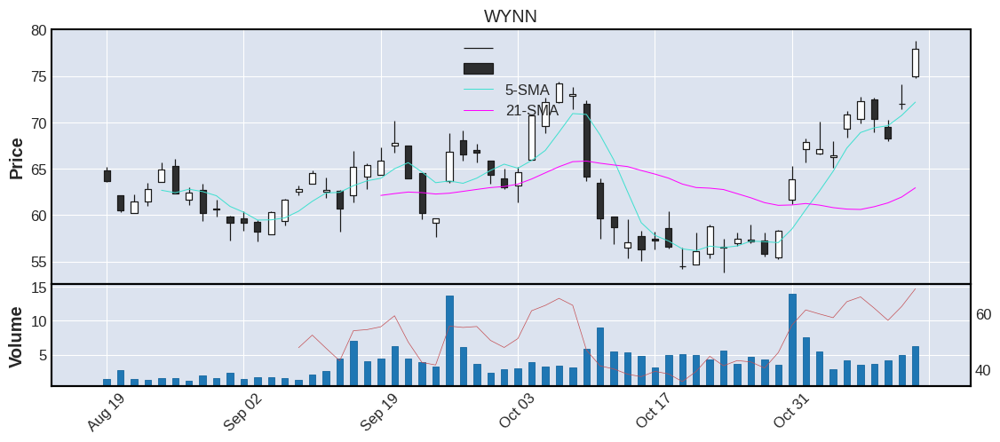



   TICKER    CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                                                      INDUSTRY     IPO CATEGORY  %ATR
47   NARI  78.2  73.46  59.46  72.43  73.04   75.39  0.63    0.53  1.76  4.14  Health_Care  Biotechnology: Electromedical & Electrotherapeutic Apparatus  2020.0   medium  5.29


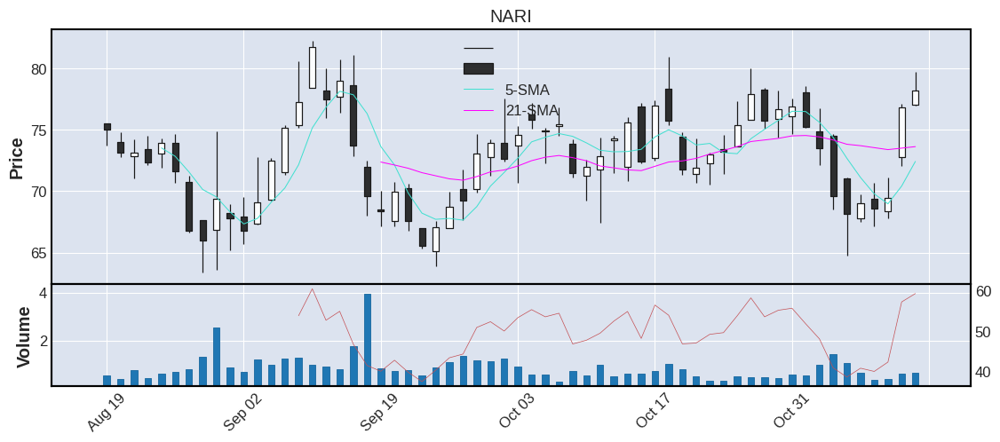



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR      INDUSTRY  IPO CATEGORY  %ATR
48     BC  79.62  72.47  66.53  72.54  70.04   77.28  0.79    0.55  5.26  3.25  Consumer_Discretionary  Homebuilding  0.0   medium  4.08


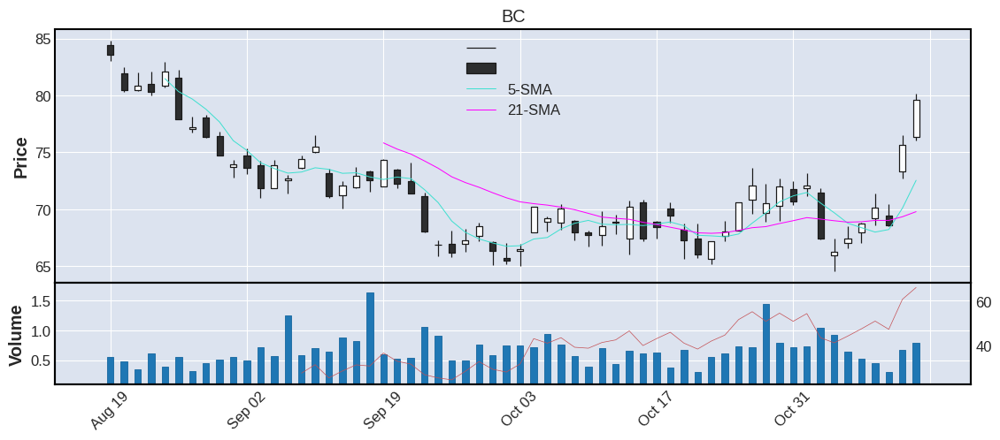



   TICKER     CP  EMA8   RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR INDUSTRY     IPO CATEGORY  %ATR
49   COLM  81.61  76.3  65.7  76.07  72.62   79.67  0.52    0.36   5.7  2.91  Consumer_Discretionary  Apparel  1998.0   medium  3.57


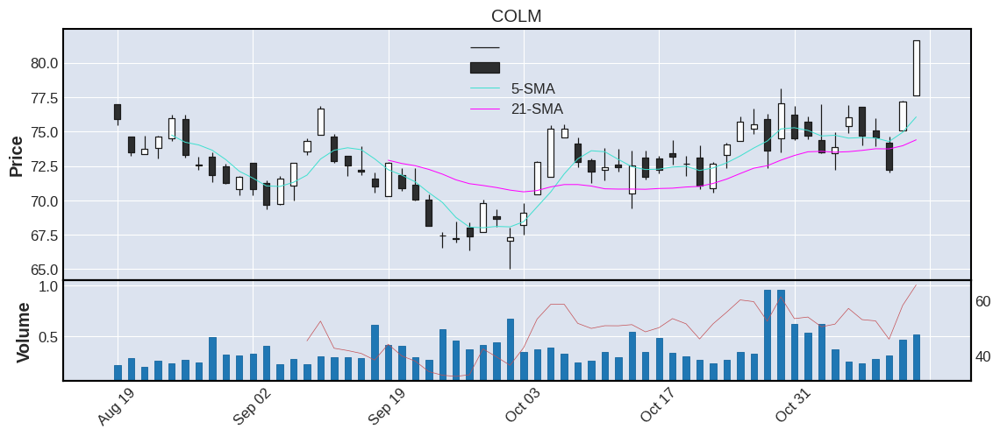



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR      INDUSTRY  IPO CATEGORY  %ATR
50    THO  90.52  82.74  67.63  83.06   77.0   81.53  1.09    0.66  6.78  3.98  Industrials  Homebuilding  0.0   medium   4.4


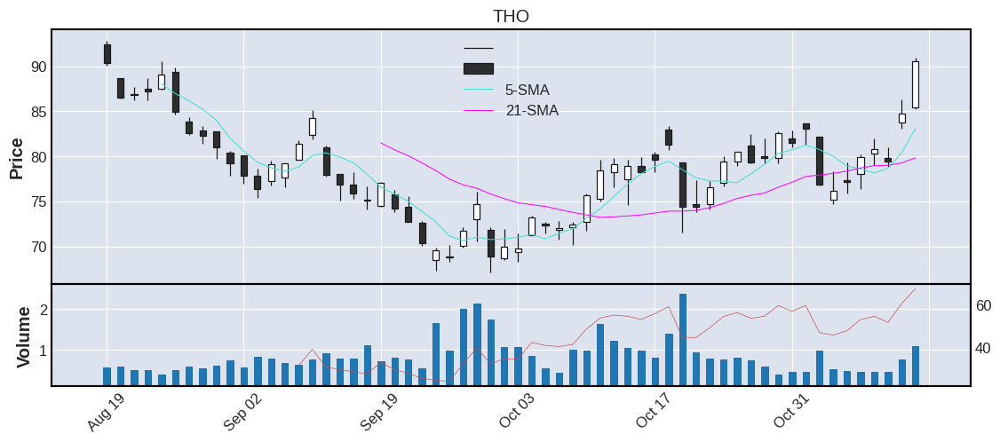



   TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG  ATR                  SECTOR            INDUSTRY     IPO CATEGORY  %ATR
51   CROX  93.24  84.41  65.43  86.01  76.24   71.45  3.32    2.61  0.95  5.9  Consumer_Discretionary  Shoe Manufacturing  2006.0   medium  6.33


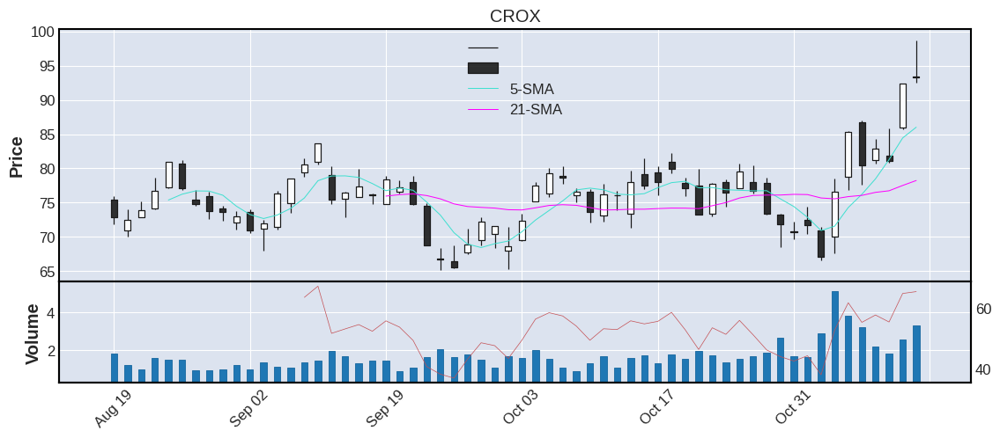



   TICKER      CP  EMA8    RSI   SMA5  SMA50  SMA200  VOL  AVGVOL  %CHG   ATR                  SECTOR INDUSTRY     IPO CATEGORY  %ATR
52     RL  104.38  95.8  65.71  95.96  92.08  101.55  2.3    1.43  9.36  4.49  Consumer_Discretionary  Apparel  1997.0   medium   4.3


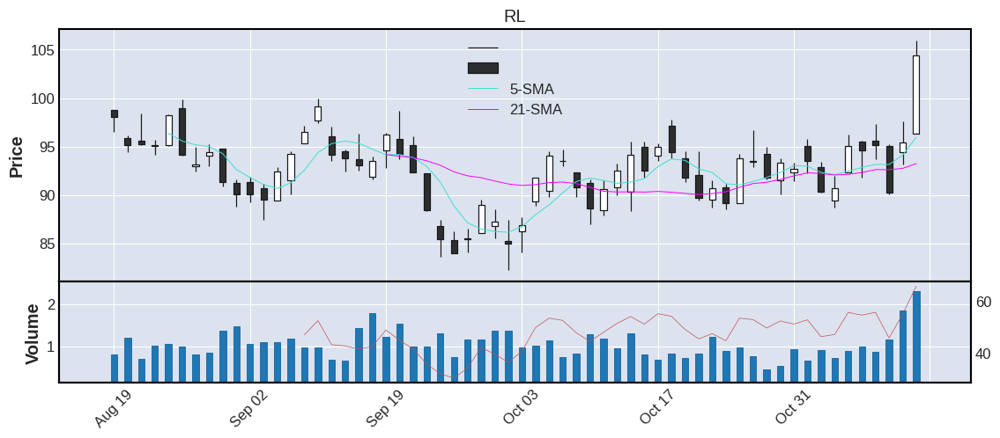



   TICKER      CP   EMA8    RSI   SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR                      INDUSTRY     IPO CATEGORY  %ATR
53    WCC  132.13  126.6  54.88  124.3  127.56  124.62  0.81    0.58  4.32  6.32  Consumer_Discretionary  Telecommunications Equipment  1999.0   medium  4.78


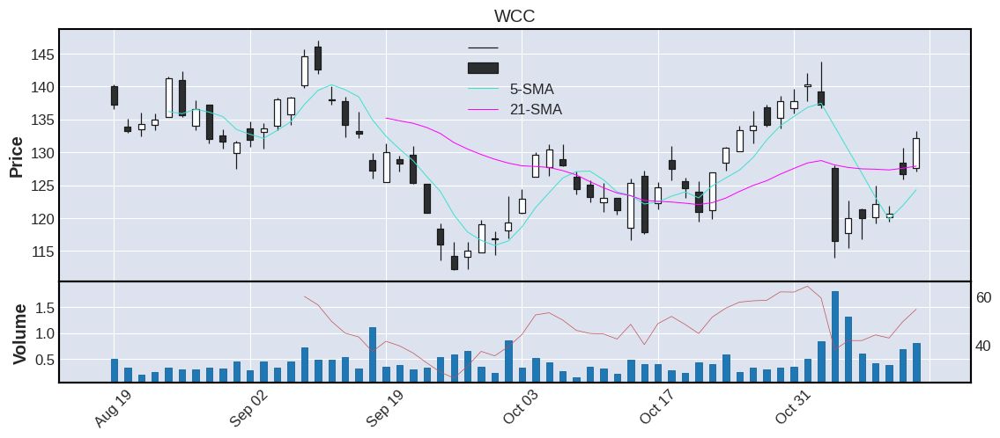



   TICKER      CP    EMA8    RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG  ATR      SECTOR        INDUSTRY     IPO CATEGORY  %ATR
54   SLAB  141.24  128.94  65.12  131.38  123.99   138.0  0.59    0.54   2.0  6.9  Technology  Semiconductors  2000.0   medium  4.89


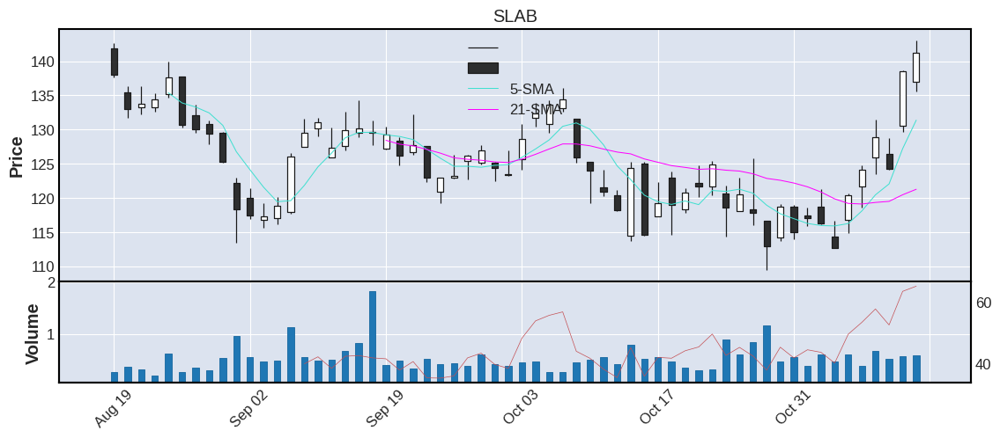



   TICKER      CP    EMA8    RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR                       INDUSTRY     IPO CATEGORY  %ATR
55   TTEK  162.53  148.25  76.97  148.82  134.52  141.99  0.58    0.34  1.26  5.25  Consumer_Discretionary  Military/Government/Technical  1991.0   medium  3.23


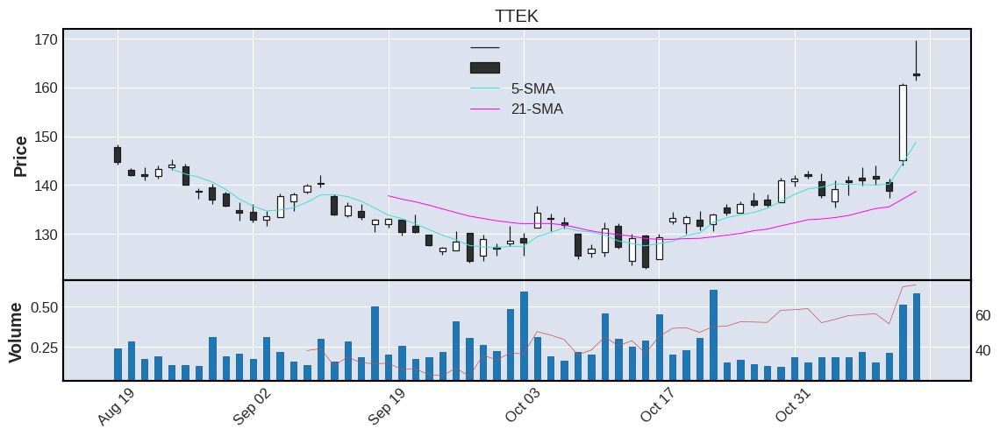



   TICKER      CP    EMA8    RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                    INDUSTRY     IPO CATEGORY  %ATR
56   RGEN  199.29  183.29  58.65  181.99  197.24  185.64  1.03    0.56  5.36  12.0  Health_Care  Medical/Dental Instruments  1986.0   medium  6.02


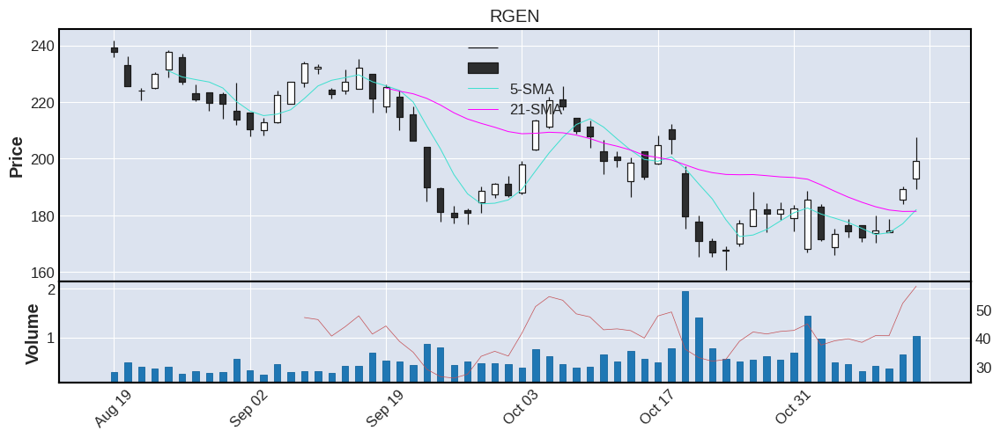



   TICKER      CP    EMA8    RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR              INDUSTRY     IPO CATEGORY  %ATR
57    MTN  240.46  224.19  67.99  224.47  219.57  239.08  0.61    0.38  4.43  8.07  Consumer_Discretionary  Movies/Entertainment  1997.0   medium  3.36


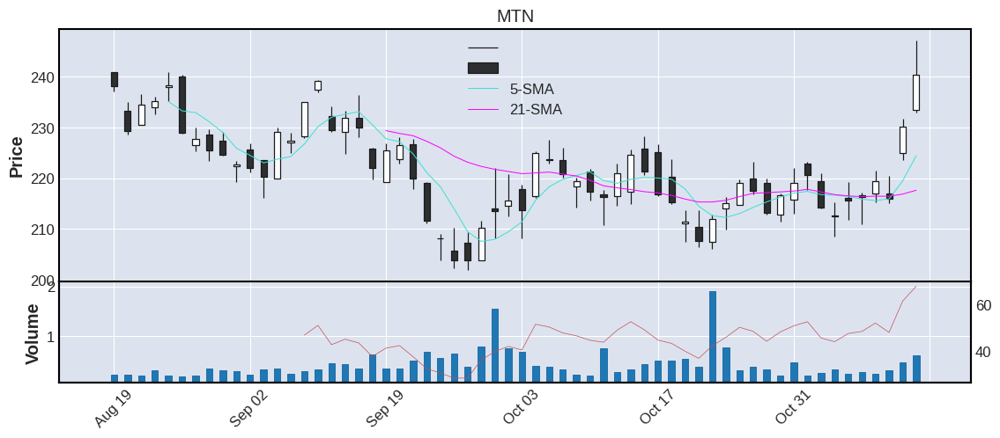



   TICKER     CP    EMA8   RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG    ATR       SECTOR                           INDUSTRY  IPO CATEGORY  %ATR
58   SAIA  247.5  224.34  69.6  229.79  200.15  220.89  0.54    0.51  1.02  12.96  Industrials  Trucking Freight/Courier Services  0.0   medium  5.24


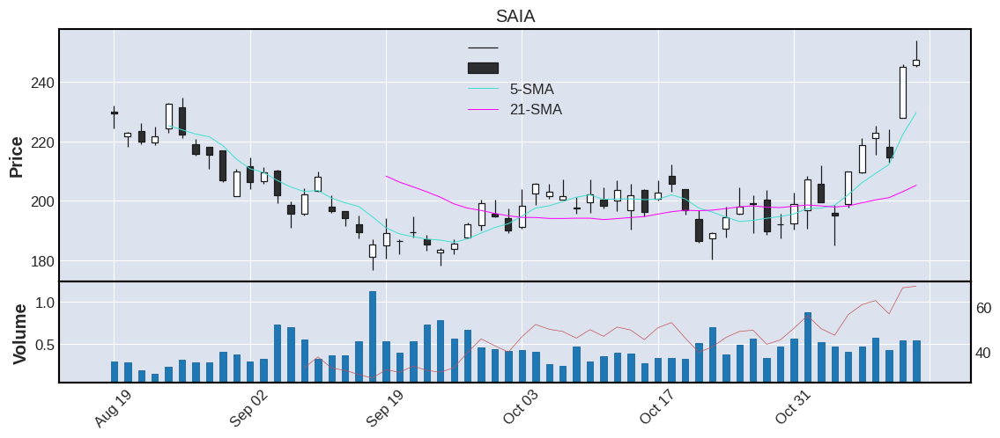

In [15]:
root='/home/thakur/test/{}'
plot=True

tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
if plot:
    for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')

In [16]:
df.SECTOR.unique()
# df_test=df.sort_values(by='%CHG')
# df_test

array(['Technology', 'Health_Care', 'Consumer_Discretionary', 'Finance',
       'N-A', 'Energy', 'Consumer_Staples', 'Industrials', 'Utilities',
       'Real_Estate', 'Telecommunications', 'Miscellaneous',
       'Basic_Materials'], dtype=object)

In [17]:
df.SECTOR.value_counts()
# #column names
# df.dtypes

Finance                   1521
Health_Care               1249
Consumer_Discretionary    1037
Technology                 814
Industrials                807
N-A                        406
Real_Estate                289
Energy                     193
Utilities                  175
Consumer_Staples           142
Telecommunications          67
Basic_Materials             53
Miscellaneous               36
Name: SECTOR, dtype: int64

In [18]:
countries=df['COUNTRY'].value_counts()
countries


United States           4975
N-A                      717
Canada                   216
China                    196
Israel                   112
United Kingdom            76
Bermuda                   42
Hong Kong                 32
Brazil                    31
Cayman Islands            28
Switzerland               27
Singapore                 25
Netherlands               23
Ireland                   22
Greece                    22
Germany                   21
Mexico                    18
Australia                 18
France                    16
Argentina                 14
Luxembourg                14
Japan                     12
India                     12
Taiwan                    12
South Korea               10
Sweden                     8
Denmark                    8
South Africa               7
Belgium                    6
Malaysia                   5
Colombia                   5
Chile                      5
Monaco                     5
United Arab Emirates       4
Spain         

In [19]:
countries=list(df['COUNTRY'].unique())
countries

['United States',
 'Denmark',
 'Netherlands',
 'Taiwan',
 'Switzerland',
 'N-A',
 'Bermuda',
 'Ireland',
 'Canada',
 'Mexico',
 'United Kingdom',
 'China',
 'Peru',
 'Brazil',
 'Spain',
 'Cayman Islands',
 'Australia',
 'Germany',
 'Belgium',
 'Japan',
 'Israel',
 'Italy',
 'Colombia',
 'Norway',
 'Sweden',
 'Singapore',
 'India',
 'South Korea',
 'Argentina',
 'Luxembourg',
 'Finland',
 'France',
 'Chile',
 'South Africa',
 'Indonesia',
 'Panama',
 'Hong Kong',
 'Uruguay',
 'Guernsey',
 'Puerto Rico',
 'Kazakhstan',
 'Jersey',
 'Philippines',
 'Monaco',
 'Turkey',
 'Greece',
 'Costa Rica',
 'Jordan',
 'Malta',
 'Isle of Man',
 'Curacao',
 'Bahamas',
 'United Arab Emirates',
 'Gibraltar',
 'New Zealand',
 'Cyprus',
 'Macau',
 'Malaysia']

# DOW JONES & SNP-500


In [20]:
dow=pd.read_csv('/home/thakur/stock_information/dow.csv')['Symbol'].to_list()
snp=pd.read_csv('/home/thakur/stock_information/snp500finalwvol.csv')['SYMBOL'].to_list()

In [21]:
temp_df=df[df['TICKER'].isin(snp)].copy()
#temp_df


# DOW JONES

In [22]:
#%%script false --no-raise-error
yahoo='https://finance.yahoo.com/quote/{}?p={}&.tsrc=fin-srch'
fmt=33*'=='
fmt1=35*'**'
choose=['%CHG','VOL','%ATR','RSI']
how=False
plot=False #False
show_number=10

temp_df=df[df['TICKER'].isin(dow)].copy()

temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))

root='/home/thakur/test/{}'
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'CATEGORY']
temp_df=temp_df[columns_selected]
for ch in choose:
    temp_df=temp_df.sort_values(by=ch,ascending=how).head(30)
    #temp_df['yahoo']=temp_df['TICKER'].apply(lambda x:yahoo.format(x,x))
    #temp_df['link'] = temp_df['TICKER'].apply(lambda x: make_clickable(yahoo.format(x,x),x))
    temp_df=reset_index(temp_df)

    print(f"\n\n{fmt} [ { ch } ] {fmt} \n\n {temp_df.to_string()}\n\n")#{fmt}{fmt}")
    
    tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
    if plot and ch==choose[-1]:
        for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')



================================================================== [ %CHG ] ================================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR                                    INDUSTRY     IPO CATEGORY
1     WBA   41.26  73.35  12.85    9.84   7.2   1.26  3.05        Consumer_Staples         -Drug Stores and Proprietary Stores     0.0    large
2     NKE  106.09  67.45  12.59    8.92  6.63   3.98  3.75  Consumer_Discretionary                          Shoe Manufacturing     0.0    large
3     DOW   53.14  69.46   9.01    6.26  6.37   1.70  3.20             Industrials                      Industrial Specialties  2019.0    large
4     DIS   95.01  43.39  22.01   31.90  5.03   4.01  4.22  Consumer_Discretionary                        Movies/Entertainment     0.0    large
5     MMM  132.98  71.77   3.43    2.42  2.97   3.24  2.44             Industrials             Consumer Electronics/Appliances     0

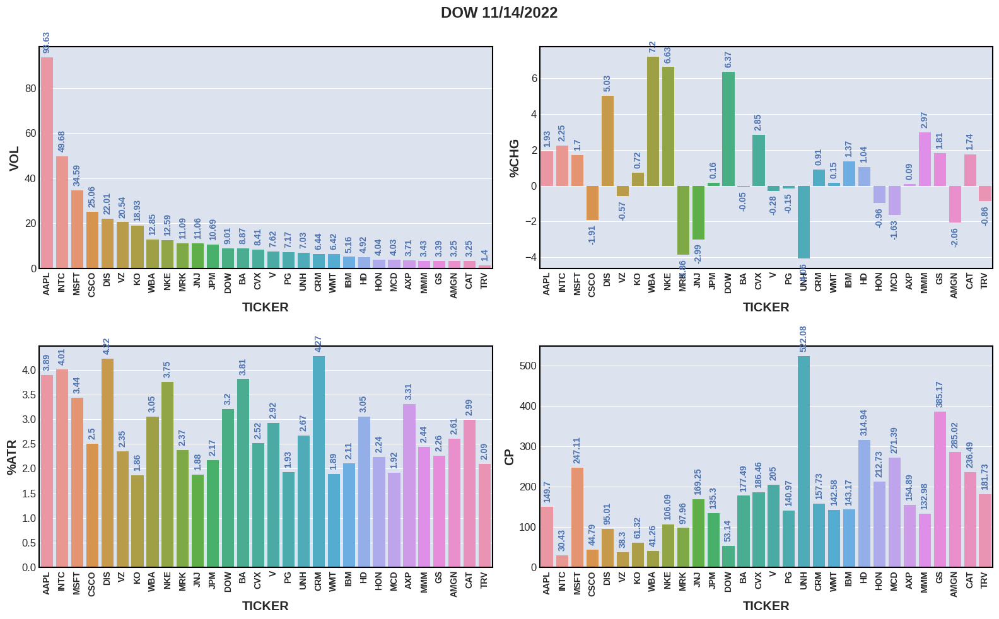

In [23]:
compare_bars(temp_df,title='dow')

/tmp/ipykernel_10045/2843022622.py:55: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(choose)


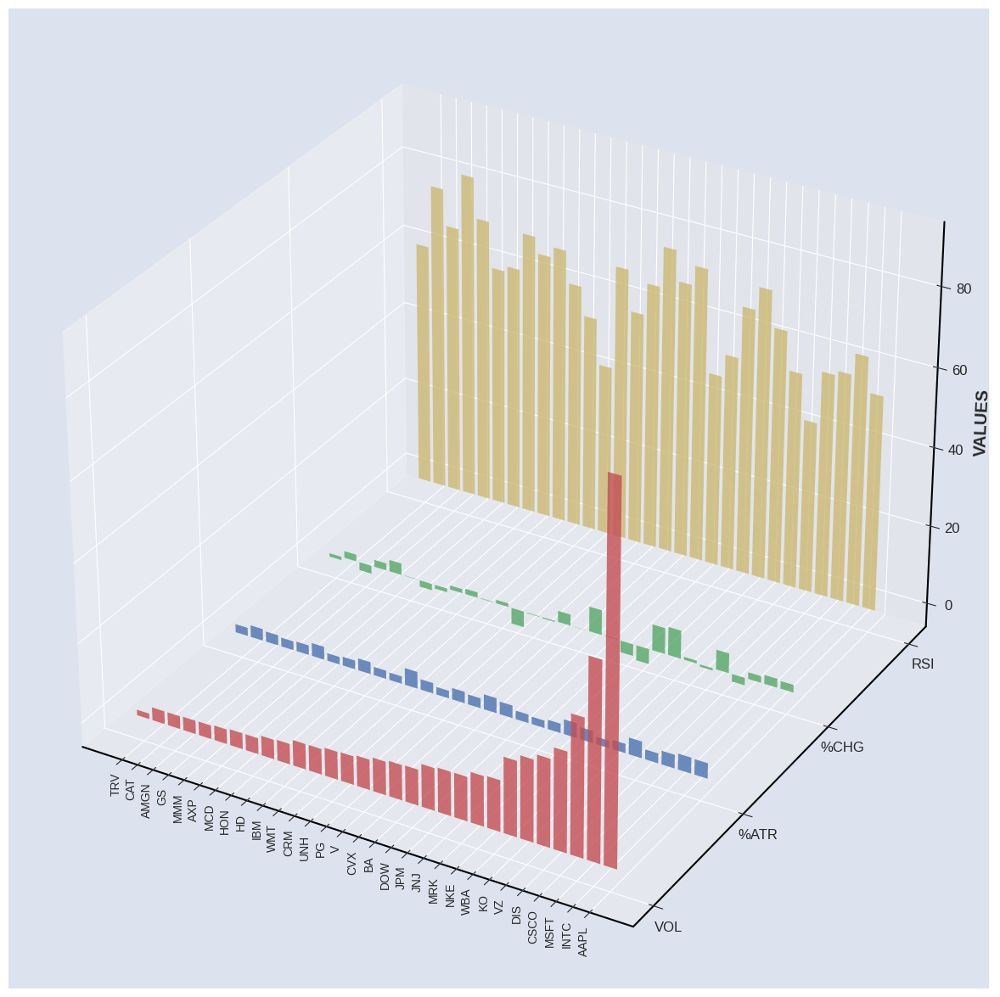

In [24]:
import matplotlib.pyplot as plt
import numpy as np
#from random import randint
#from mpl_toolkits.mplot3d import Axes3D

# Fixing random state for reproducibility
#np.random.seed(19680801)


fig = plt.figure(figsize=(25,15))
ax = fig.add_subplot(projection='3d')

n=30 #30 different colors

#colors_ = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))

# def get_cmap(n, name='hsv'):
#     '''Returns a function that maps each index in 0, 1, ..., n-1 to a distinct 
#     RGB color; the keyword argument name must be a standard mpl colormap name.'''
#     return plt.cm.get_cmap(name, n)

temp_df=temp_df.sort_values(by='VOL')

col = []
dx = .10 * np.ones(n)
dy = .10 * np.ones(n)
z=np.zeros(n)

# for i in range(n):
#    col.append('#%06X' % randint(0, 0xFFFFFF))

colors = ['r', 'g', 'b', 'y']
yticks = [0,2,1,3]
choose=['VOL','%CHG','%ATR','RSI']
for i, (c, k) in enumerate(zip(colors, yticks)):
    # Generate the random data for the y=k 'layer'.
    #xs = np.arange(20)
    xs=temp_df['TICKER'].to_list()
    #ys = np.random.rand(30)
    ys = temp_df[choose[i]].to_list()

    # You can provide either a single color or an array with the same length as
    # xs and ys. To demonstrate this, we color the first bar of each set cyan.
    cs = [c] * len(xs)
    #cs[0] = 'c'

    # Plot the bar graph given by xs and ys on the plane y=k with 80% opacity.
    ax.bar(xs, ys, zs=k, zdir='y', color=cs, alpha=0.8)
    #ax.set_xlabel('TICKERS',labelpad=0)
    #ax.bar3d(x=np.arange(30),y=k,z=z,dx=dx,dy=dy,dz=ys)

#ax.set_xlabel('TICKERS',labelpad=10)
ax.set_zlabel('VALUES')
ax.tick_params(axis='x', rotation=90,labelsize='small',pad=0)
ax.set_yticklabels(choose)
# ax.set_xticklabels(xs)
fig.align_xlabels()

# labelx = -0.5  # axes coords

# ax.xaxis.set_label_coords(labelx, 0.5)

# On the y axis let's only label the discrete values that we have data for.
ax.set_yticks(yticks)

plt.show()

# SNP-500

In [25]:
#%%script false --no-raise-error
fmt=30*'=='
fmt1=35*'**'
choose=['%CHG','%CHG','VOL','RSI','RSI','%ATR','CP','CP']
how=False
plot=False
show_number=30

temp_df=df[df['TICKER'].isin(snp)].copy()

temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))

root='/home/thakur/test/{}'
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR',  'IPO', 'COUNTRY','CATEGORY']#,'INDUSTRY',]
temp_df=temp_df[columns_selected]
ch_count=0
for c,ch in enumerate(choose,start=0):
    how=False
    if c in [1,4,7]:how=True
    temp_dff=temp_df.copy().sort_values(by=ch,ascending=how).head(show_number)
    #if ch=='%CHG':how=~how
    #if ch_count==1:how=True
    temp_dff=reset_index(temp_dff)

    print(f"\n\n{fmt} [ { ch } ] {fmt} \n\n {temp_dff.to_string()}\n\n")#{fmt}{fmt}")
    tick=temp_dff['TICKER'].to_list();cat=temp_dff['CATEGORY'].to_list()
    if plot and c==2:
        for c,i in enumerate(tick):print(f"\n\n{temp_dff[temp_dff['TICKER']==i].to_string()}");print(yahoo.format(i,i));plot_with_mpl(root.format(cat[c]),i,sty='default')



============================================================ [ %CHG ] ============================================================ 

    TICKER      CP    RSI     VOL  AVGVOL   %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
1    PARA   18.81  52.59   29.49   18.24  13.52   1.15  6.11  Consumer_Discretionary     0.0  United States    large
2    ALGN  218.98  58.15    1.91    1.41  11.45  13.60  6.21             Health_Care  2001.0  United States    large
3     VFC   33.34  62.91   10.06    6.18  11.39   1.53  4.59  Consumer_Discretionary     0.0  United States    large
4     WBD   11.84  49.32   47.46   41.79   9.63   0.84  7.09      Telecommunications     0.0  United States    large
5      RL  104.38  65.71    2.30    1.43   9.36   4.49  4.30  Consumer_Discretionary  1997.0  United States   medium
6     TPR   35.37  64.56    4.67    4.62    8.7   1.65  4.66  Consumer_Discretionary     0.0  United States   medium
7    WYNN   77.98  68.82    6.26    4.50   8.

In [26]:
snp_df=df[df['TICKER'].isin(snp)].copy()
snp_df.head()

,TICKER,CP,EMA8,HH,HL,LH,LL,HC,HV,RSI,SMA5,SMA21,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,COUNTRY,CATEGORY,%ATR
0,AAPL,149.70,143.88,True,True,False,False,True,False,54.56,141.97,145.09,147.66,155.68,93.63,92.14,1.93,5.83,Technology,Computer Manufacturing,1980.0,United States,mega,3.89
1,ABBV,150.16,148.29,False,False,False,False,True,False,59.10,148.83,147.19,143.46,147.96,5.59,4.94,0.29,3.74,Health_Care,Other Pharmaceuticals,2012.0,United States,mega,2.49
2,AMZN,100.79,95.52,True,True,False,False,True,False,45.87,92.81,104.42,113.93,129.24,109.31,107.94,4.31,5.59,Consumer_Discretionary,Catalog/Specialty Distribution,1997.0,United States,mega,5.55
3,BAC,38.41,37.15,True,True,False,False,True,False,71.96,37.44,35.67,33.80,36.75,30.40,35.29,0.73,0.94,Finance,Major Banks,0.0,United States,mega,2.45
5,BRK-B,309.72,296.35,True,True,False,False,True,True,67.59,296.87,288.33,280.19,302.94,6.56,4.42,2.15,6.97,N-A,N-A,0.0,United States,mega,2.25


# SNP500 Best

In [27]:
# HH, HL, HC
temp_df=snp_df.copy()\
.query('HH & HL & (CP>SMA50) & (CP>SMA200) & (`%CHG`>0) & VOL>0.5') \
.sort_values(by='CP',ascending=True)\
.replace(['micro','nano','mega','large'],np.nan,inplace=False)\
.pipe(lambda x:x.loc[(x.COUNTRY=='United States')])\
.dropna()\
.drop(['LL','LH','SMA21','HL','HH','HC','HV','COUNTRY'],axis=1)\
.reset_index(drop=True)\


temp_df

,TICKER,CP,EMA8,RSI,SMA5,SMA50,SMA200,VOL,AVGVOL,%CHG,ATR,SECTOR,INDUSTRY,IPO,CATEGORY,%ATR
0,NCLH,17.86,16.88,64.75,16.94,14.60,16.03,21.12,24.96,4.51,1.05,Consumer_Discretionary,Hotels/Resorts,0.0,medium,5.88
1,IVZ,19.77,17.18,77.10,17.43,15.57,18.33,11.23,7.68,5.44,0.76,Finance,Investment Managers,0.0,medium,3.84
2,BWA,42.42,39.34,77.28,39.81,35.77,37.63,2.05,2.03,3.54,1.25,Consumer_Discretionary,Auto Parts:O.E.M.,0.0,medium,2.95
3,PHM,44.37,40.83,67.23,40.87,39.43,42.94,2.78,3.07,1.35,1.89,N-A,N-A,0.0,medium,4.26
4,CDAY,65.30,61.46,58.39,59.91,59.43,60.23,3.10,4.05,3.22,3.91,Technology,EDP Services,2018.0,medium,5.99
5,WYNN,77.98,70.66,68.82,72.19,63.64,68.38,6.26,4.50,8.31,3.89,Consumer_Discretionary,Hotels/Resorts,2002.0,medium,4.99
6,RL,104.38,95.80,65.71,95.96,92.08,101.55,2.30,1.43,9.36,4.49,Consumer_Discretionary,Apparel,1997.0,medium,4.30
7,UHS,125.00,116.42,73.49,116.97,100.06,118.39,1.02,0.75,2.63,4.97,Health_Care,Hospital/Nursing Management,0.0,medium,3.98
8,MKTX,283.30,257.11,73.22,259.55,241.21,282.15,0.51,0.50,2.10,10.19,Finance,Investment Bankers/Brokers/Service,2004.0,medium,3.60


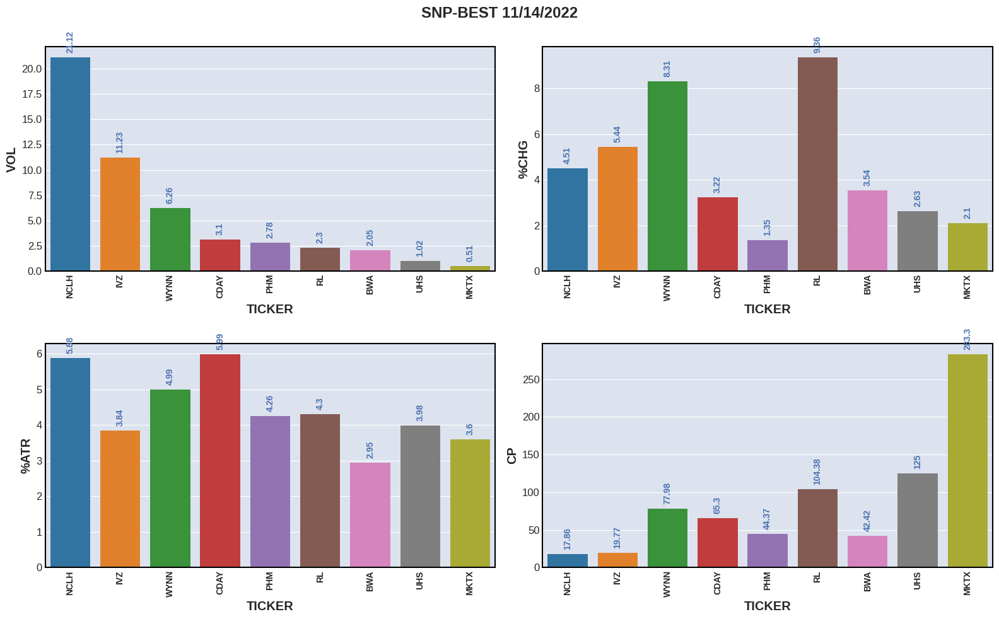

In [28]:
compare_bars(temp_df,title='snp-best')



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200    VOL  AVGVOL  %CHG   ATR                  SECTOR        INDUSTRY  IPO CATEGORY  %ATR
0   NCLH  17.86  16.88  64.75  16.94   14.6   16.03  21.12   24.96  4.51  1.05  Consumer_Discretionary  Hotels/Resorts  0.0   medium  5.88


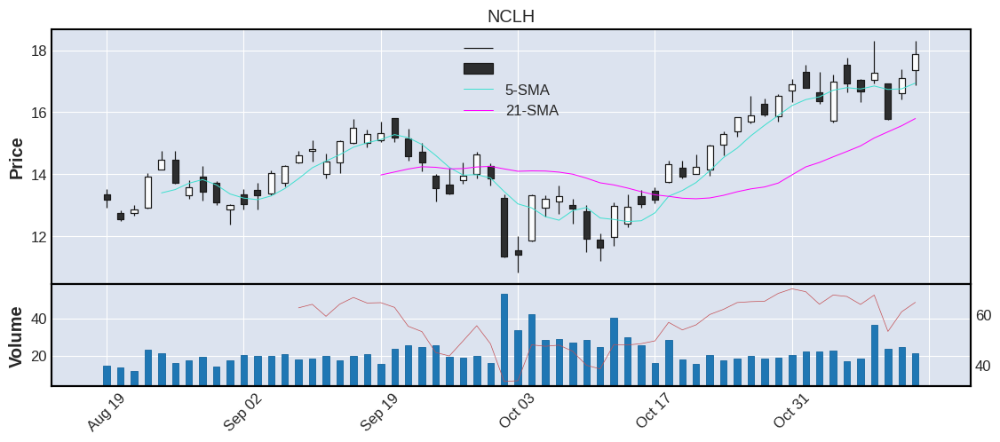



  TICKER     CP   EMA8   RSI   SMA5  SMA50  SMA200    VOL  AVGVOL  %CHG   ATR   SECTOR             INDUSTRY  IPO CATEGORY  %ATR
1    IVZ  19.77  17.18  77.1  17.43  15.57   18.33  11.23    7.68  5.44  0.76  Finance  Investment Managers  0.0   medium  3.84


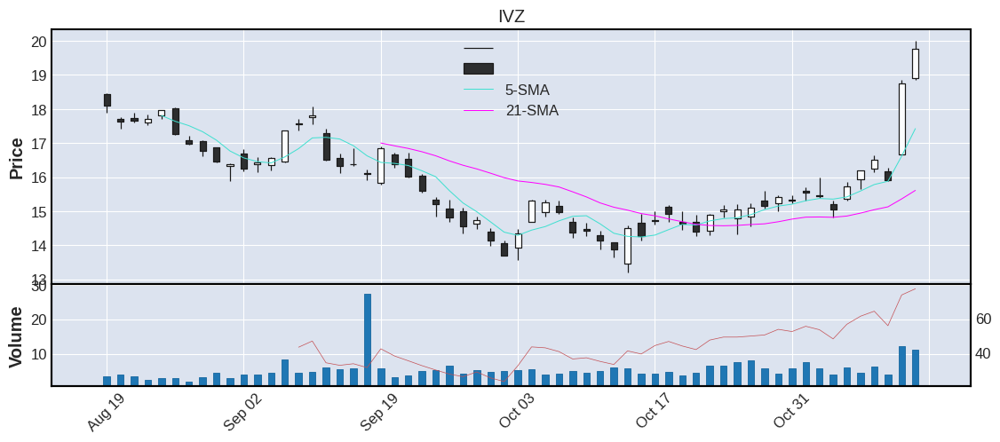



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR           INDUSTRY  IPO CATEGORY  %ATR
2    BWA  42.42  39.34  77.28  39.81  35.77   37.63  2.05    2.03  3.54  1.25  Consumer_Discretionary  Auto Parts:O.E.M.  0.0   medium  2.95


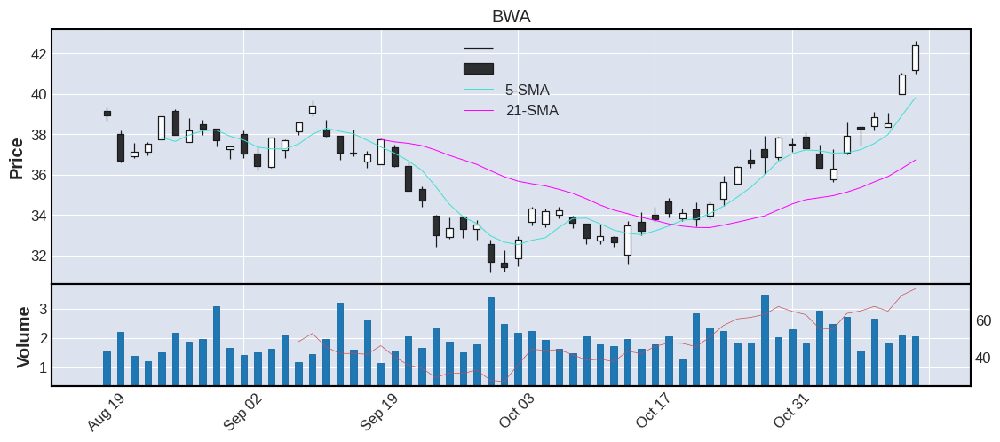



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR SECTOR INDUSTRY  IPO CATEGORY  %ATR
3    PHM  44.37  40.83  67.23  40.87  39.43   42.94  2.78    3.07  1.35  1.89    N-A      N-A  0.0   medium  4.26


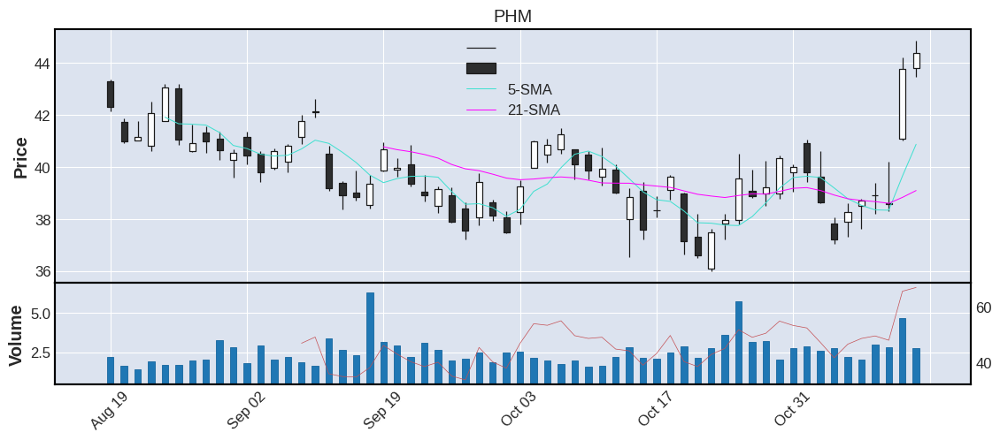



  TICKER    CP   EMA8    RSI   SMA5  SMA50  SMA200  VOL  AVGVOL  %CHG   ATR      SECTOR      INDUSTRY     IPO CATEGORY  %ATR
4   CDAY  65.3  61.46  58.39  59.91  59.43   60.23  3.1    4.05  3.22  3.91  Technology  EDP Services  2018.0   medium  5.99


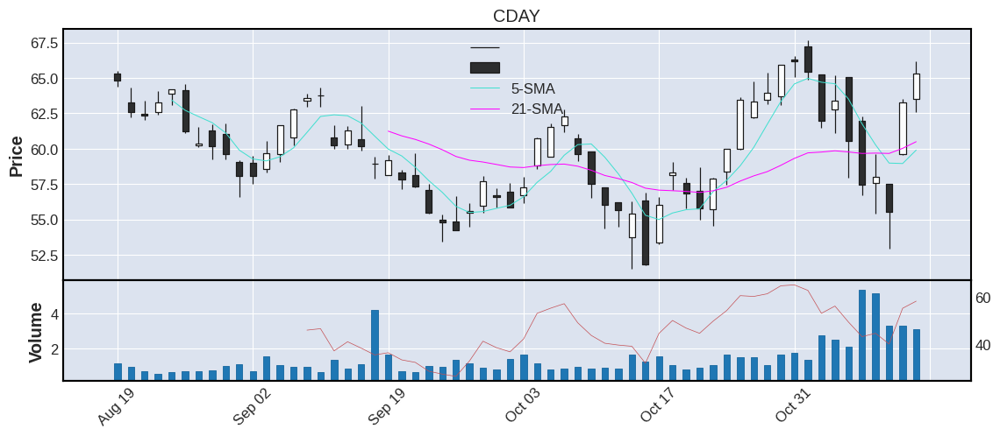



  TICKER     CP   EMA8    RSI   SMA5  SMA50  SMA200   VOL  AVGVOL  %CHG   ATR                  SECTOR        INDUSTRY     IPO CATEGORY  %ATR
5   WYNN  77.98  70.66  68.82  72.19  63.64   68.38  6.26     4.5  8.31  3.89  Consumer_Discretionary  Hotels/Resorts  2002.0   medium  4.99


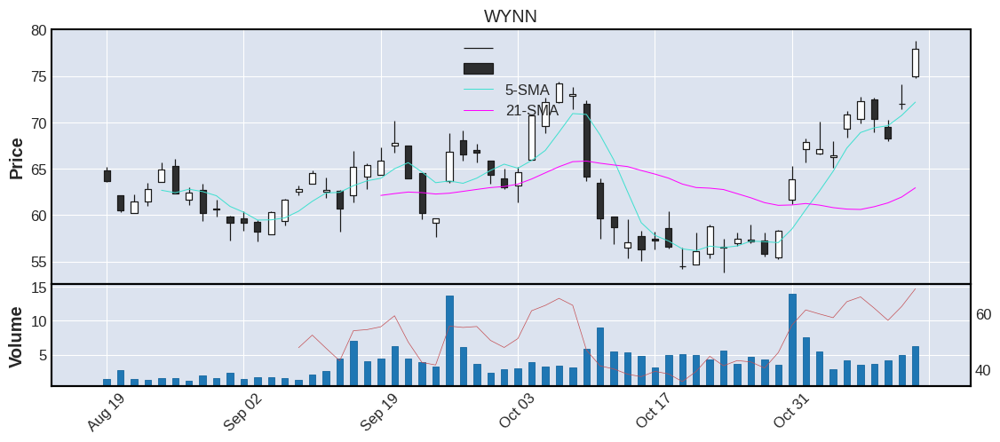



  TICKER      CP  EMA8    RSI   SMA5  SMA50  SMA200  VOL  AVGVOL  %CHG   ATR                  SECTOR INDUSTRY     IPO CATEGORY  %ATR
6     RL  104.38  95.8  65.71  95.96  92.08  101.55  2.3    1.43  9.36  4.49  Consumer_Discretionary  Apparel  1997.0   medium   4.3


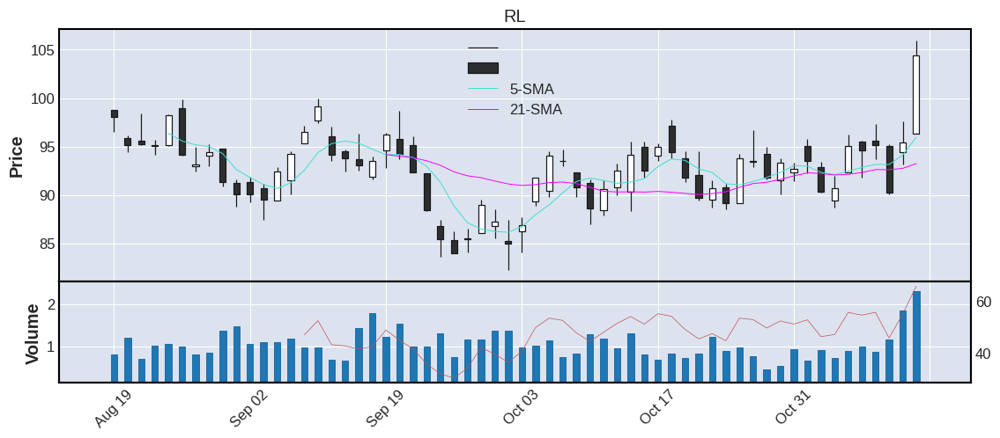



  TICKER     CP    EMA8    RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG   ATR       SECTOR                     INDUSTRY  IPO CATEGORY  %ATR
7    UHS  125.0  116.42  73.49  116.97  100.06  118.39  1.02    0.75  2.63  4.97  Health_Care  Hospital/Nursing Management  0.0   medium  3.98


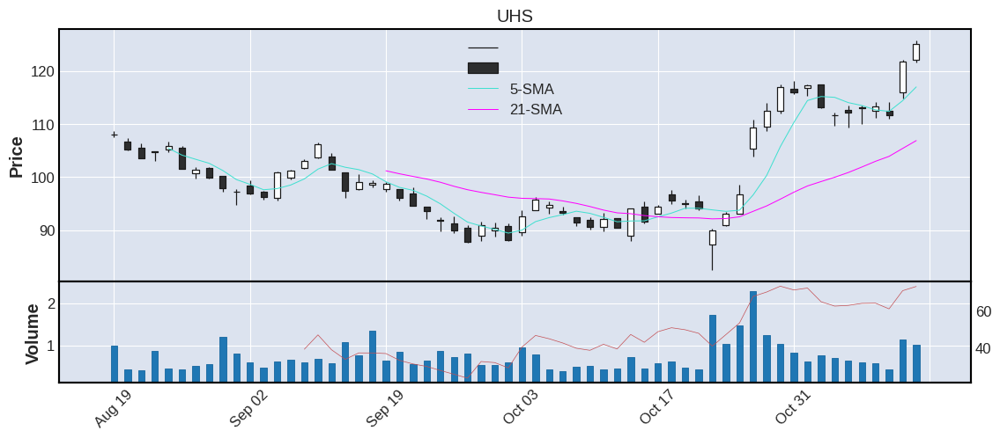



  TICKER     CP    EMA8    RSI    SMA5   SMA50  SMA200   VOL  AVGVOL  %CHG    ATR   SECTOR                            INDUSTRY     IPO CATEGORY  %ATR
8   MKTX  283.3  257.11  73.22  259.55  241.21  282.15  0.51     0.5   2.1  10.19  Finance  Investment Bankers/Brokers/Service  2004.0   medium   3.6


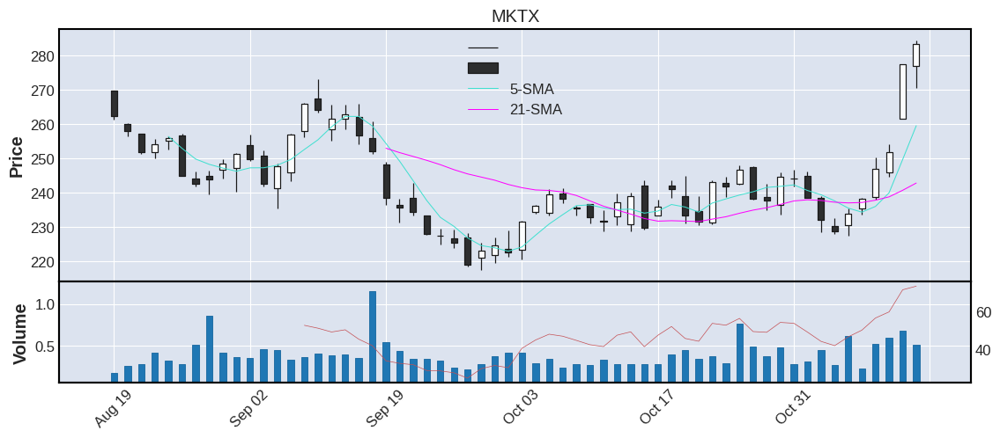

In [29]:
plot=True
tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
if plot:
    for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')

# SNP-500



================================================== SECTOR 1: TECHNOLOGY [ %CHG ] ================================================== 

    TICKER      CP    RSI     VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
1     STX   57.15  57.25    2.60    2.55  6.23   2.59  4.53  Technology  2002.0        Ireland    large
2     AMD   72.37  64.78  111.57   84.23   5.7   3.75  5.18  Technology     0.0  United States    large
3    AMAT  110.53  74.26   11.15    9.49  5.48   4.37  3.95  Technology  1972.0  United States    large
4    MTCH   51.44  62.01    4.65    4.59  5.32   3.03  5.89  Technology     0.0  United States    large
5     WDC   39.75  62.75    3.82    4.00   5.3   1.79  4.50  Technology     0.0  United States    large
6     TYL  324.61  51.31    0.47    0.48  4.81  12.00  3.70  Technology     0.0  United States    large
7     HPQ   30.55  67.15   10.79    9.55  4.27   0.97  3.18  Technology     0.0  United States    large
8    SNPS  331.40  67.51    1.2

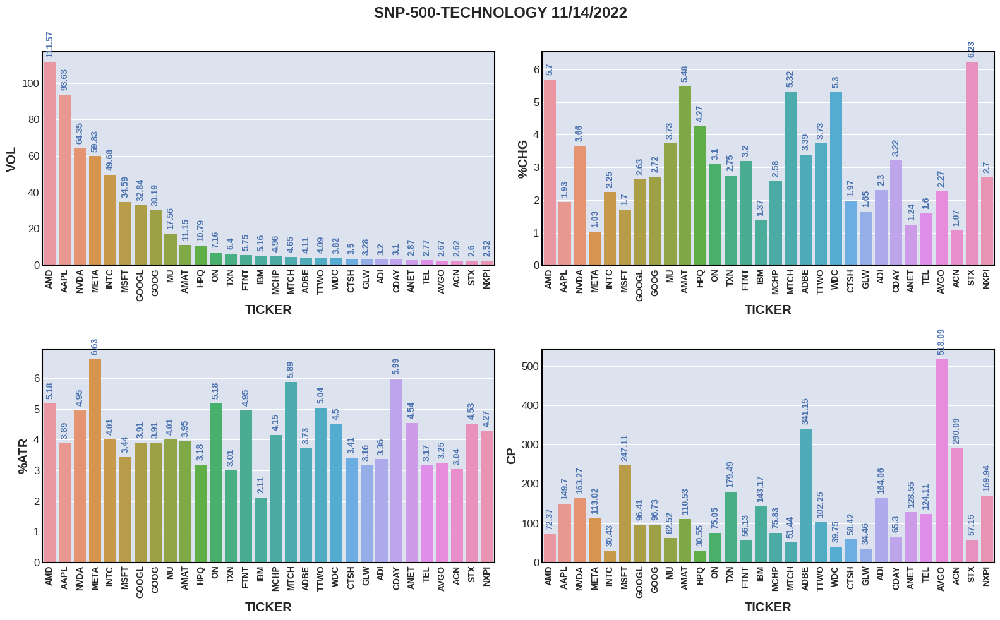

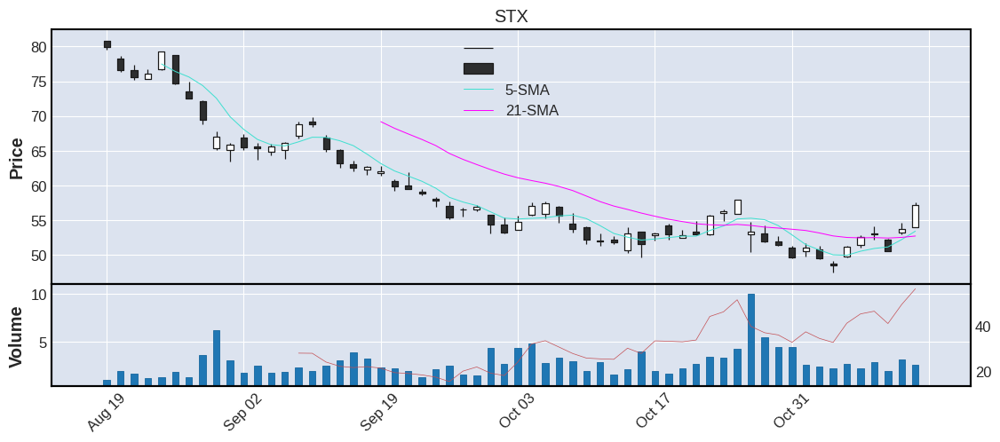



  TICKER     CP    RSI     VOL  AVGVOL %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
2    AMD  72.37  64.78  111.57   84.23  5.7  3.75  5.18  Technology  0.0  United States    large


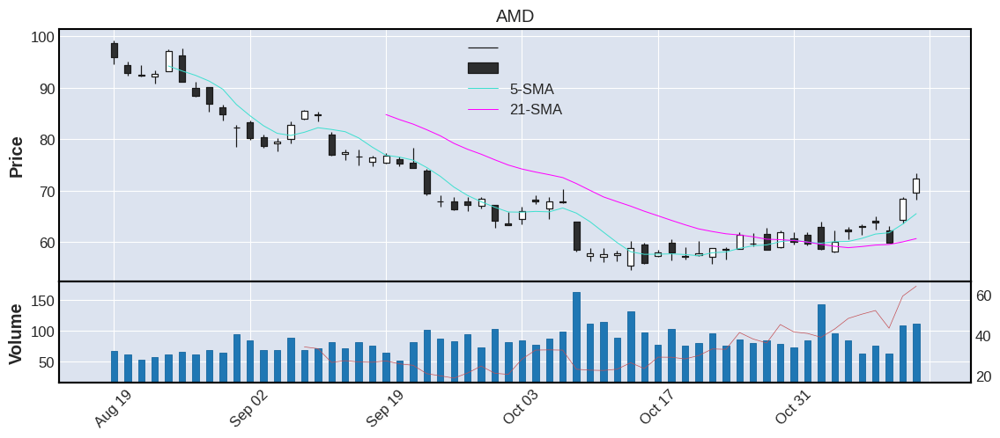



  TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
3   AMAT  110.53  74.26  11.15    9.49  5.48  4.37  3.95  Technology  1972.0  United States    large


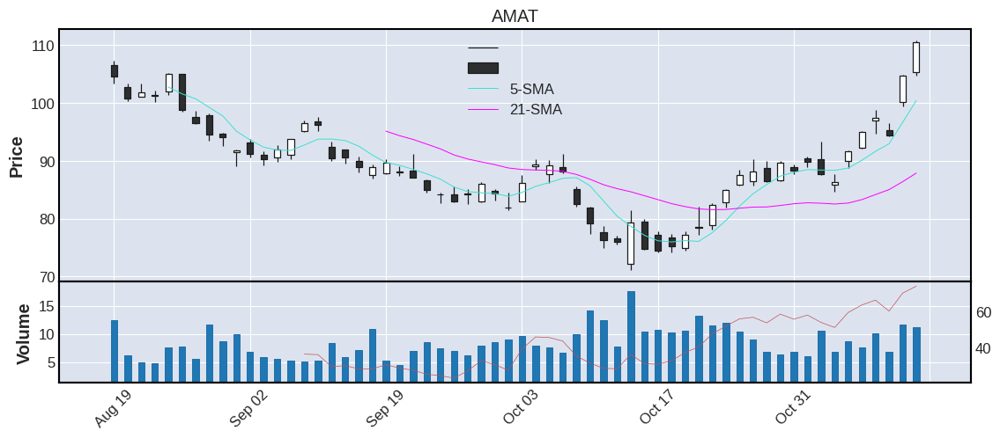



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
4   MTCH  51.44  62.01  4.65    4.59  5.32  3.03  5.89  Technology  0.0  United States    large


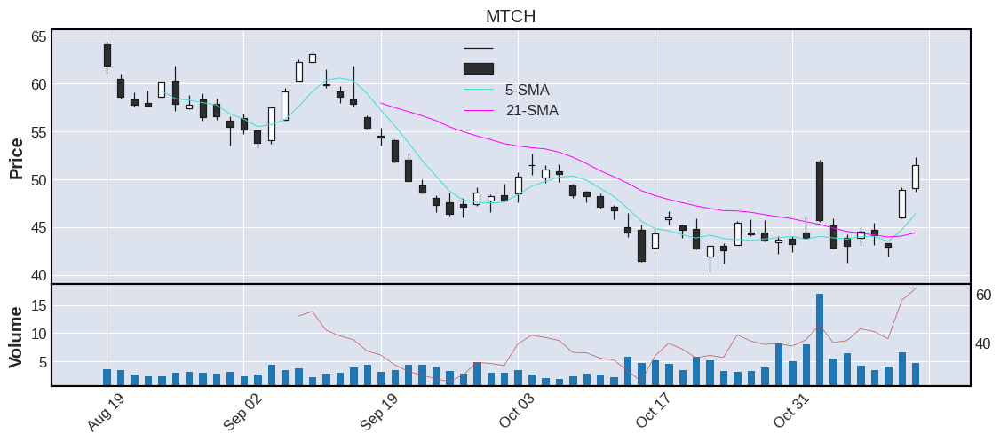



  TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
5    WDC  39.75  62.75  3.82     4.0  5.3  1.79   4.5  Technology  0.0  United States    large


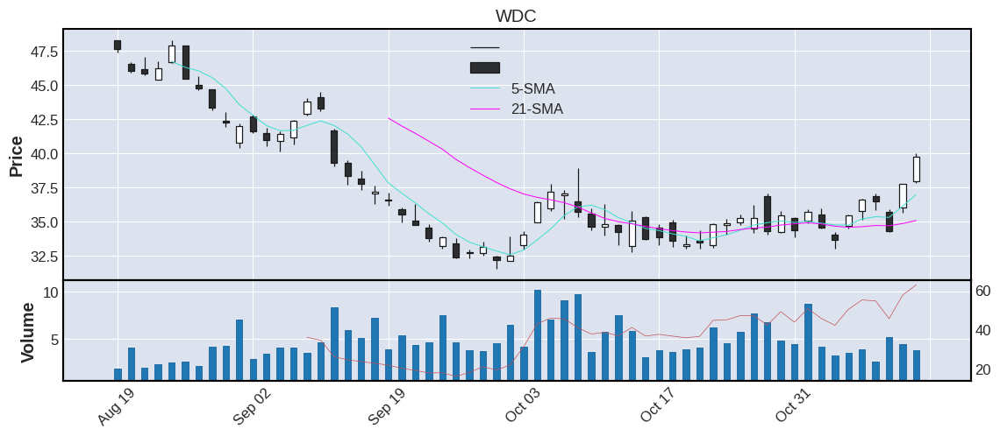



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
6    TYL  324.61  51.31  0.47    0.48  4.81  12.0   3.7  Technology  0.0  United States    large


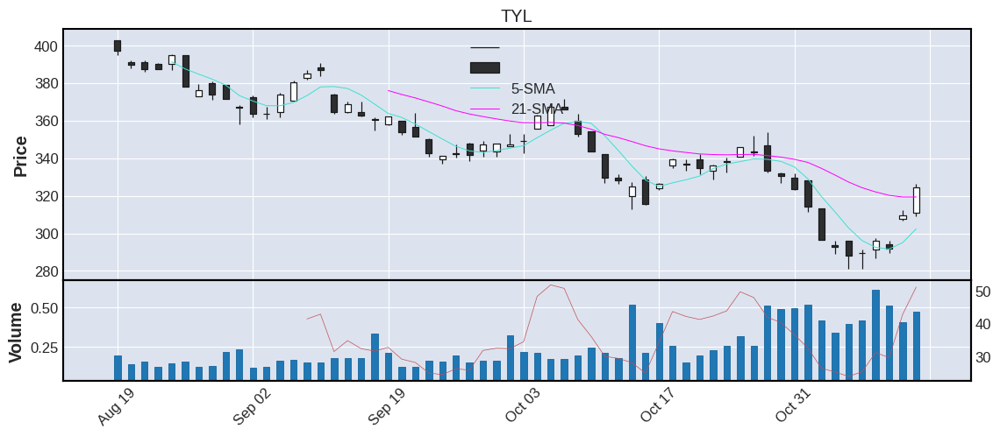



  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
7    HPQ  30.55  67.15  10.79    9.55  4.27  0.97  3.18  Technology  0.0  United States    large


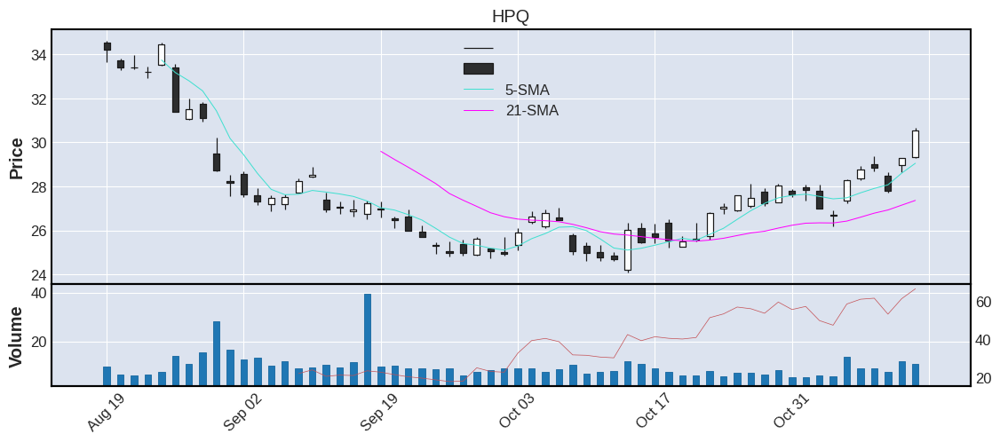



  TICKER     CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
8   SNPS  331.4  67.51  1.23    1.18  3.97  11.16  3.37  Technology  1992.0  United States    large


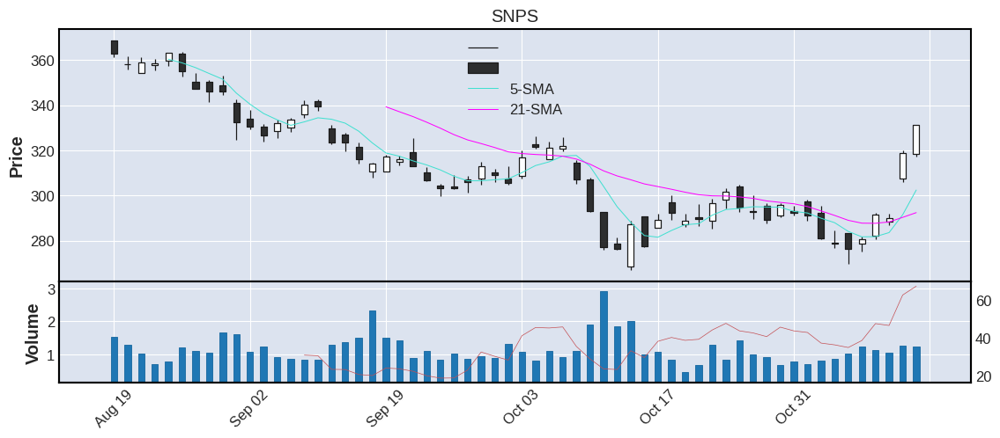



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
9   ZBRA  263.38  52.57  0.57    0.47  3.93  13.06  4.96  Technology  1991.0  United States    large


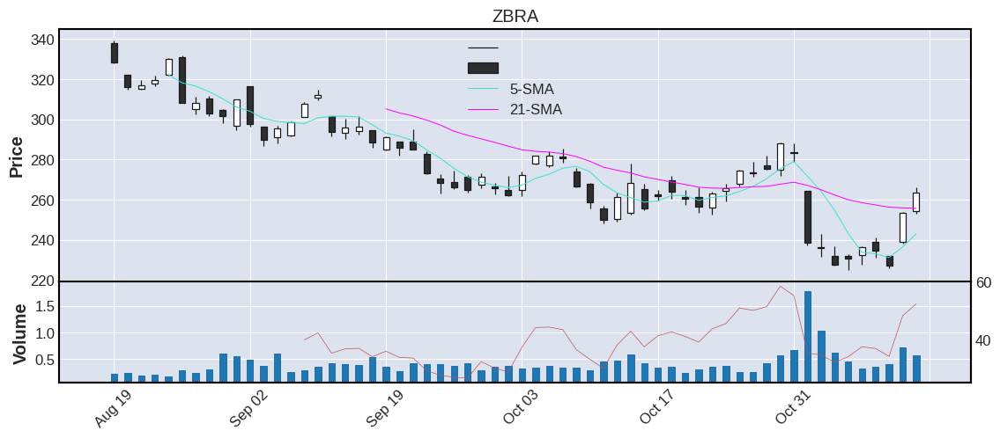



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
10   TTWO  102.25  36.84  4.09    7.19  3.73  5.15  5.04  Technology  1997.0  United States    large


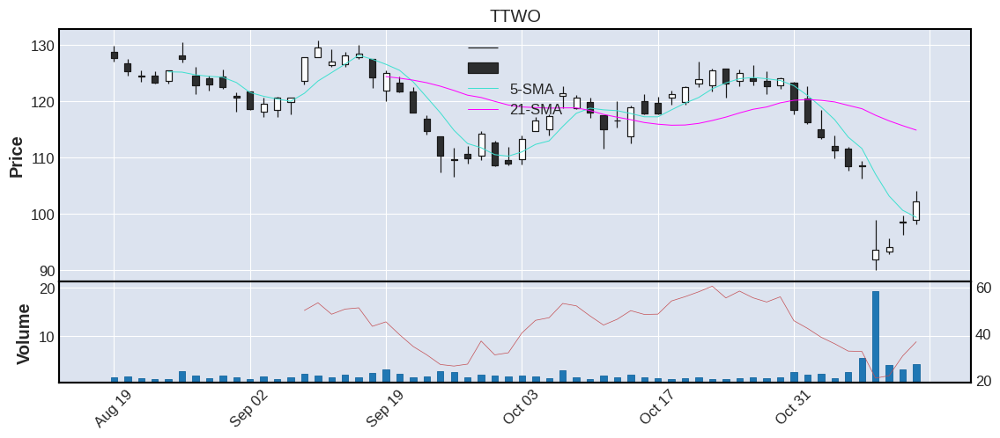



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
11     MU  62.52  68.68  17.56   17.62  3.73  2.51  4.01  Technology  0.0  United States    large


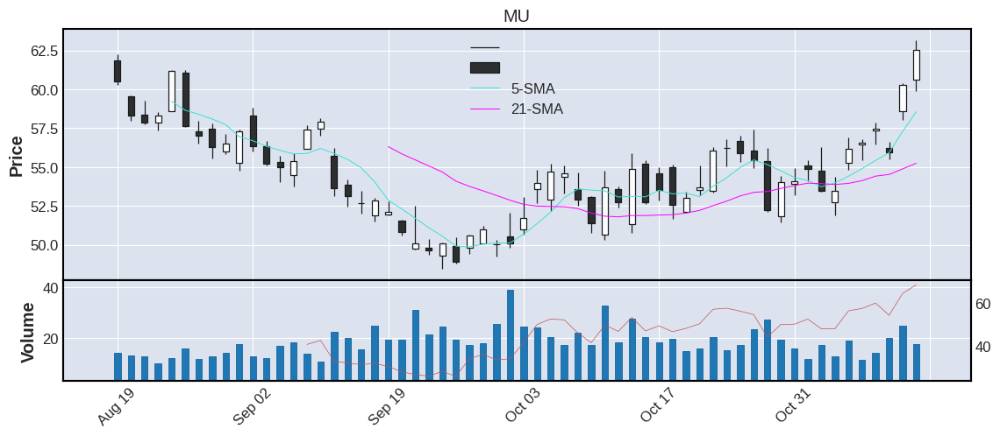



   TICKER      CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
12   NVDA  163.27  70.6  64.35   56.08  3.66  8.09  4.95  Technology  1999.0  United States     mega


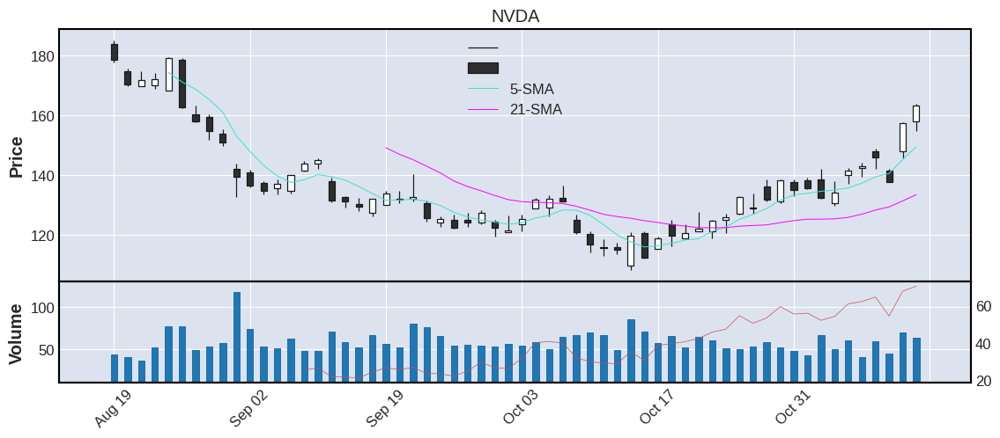



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
13   FFIV  149.91  57.04  0.66     0.5  3.57  5.42  3.62  Technology  1999.0  United States   medium


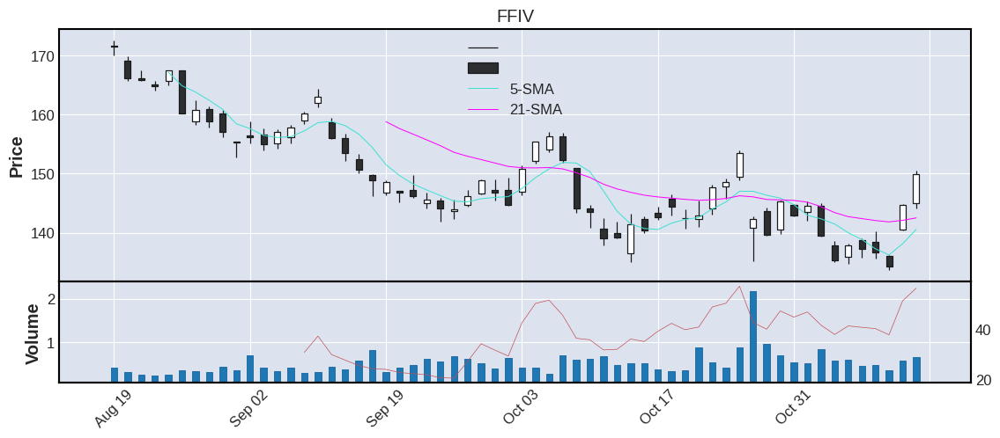



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
14   ADBE  341.15  64.46  4.11    4.12  3.39  12.73  3.73  Technology  1986.0  United States    large


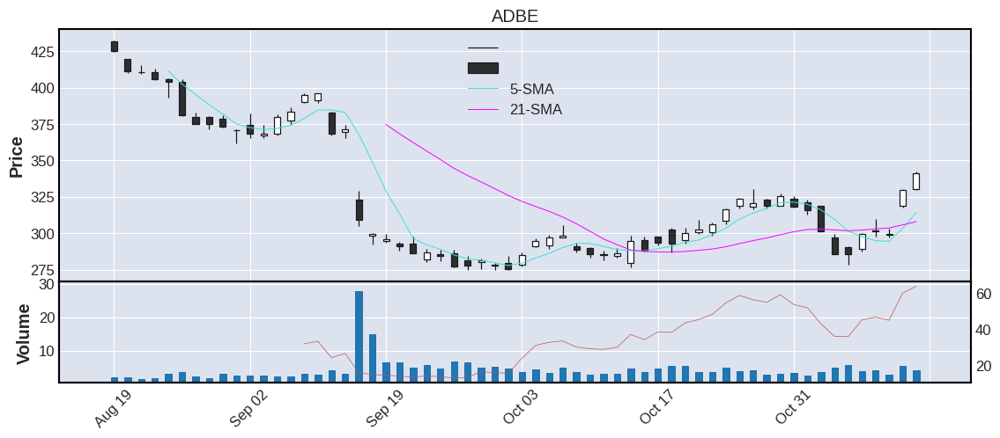



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
15   SWKS  96.35  62.98  1.83     2.4  3.35  3.73  3.87  Technology  0.0  United States    large


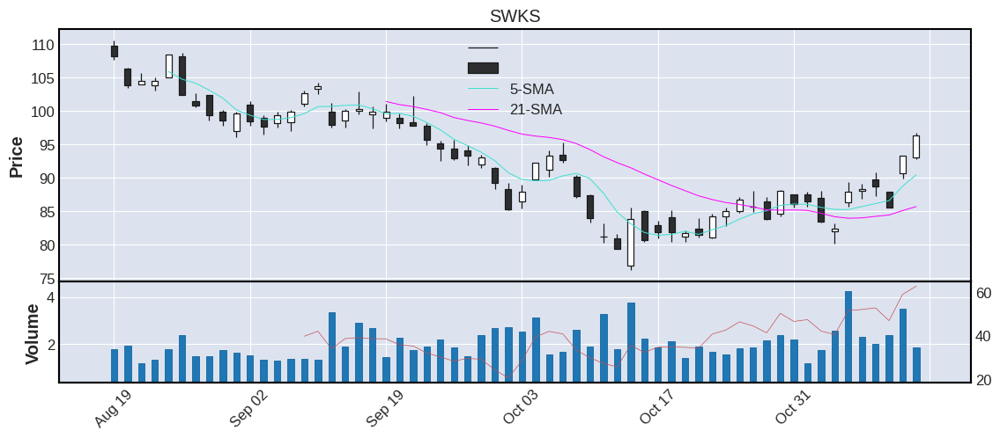



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
16   KLAC  380.21  74.87  1.6    1.85  3.25  13.2  3.47  Technology  1980.0  United States    large


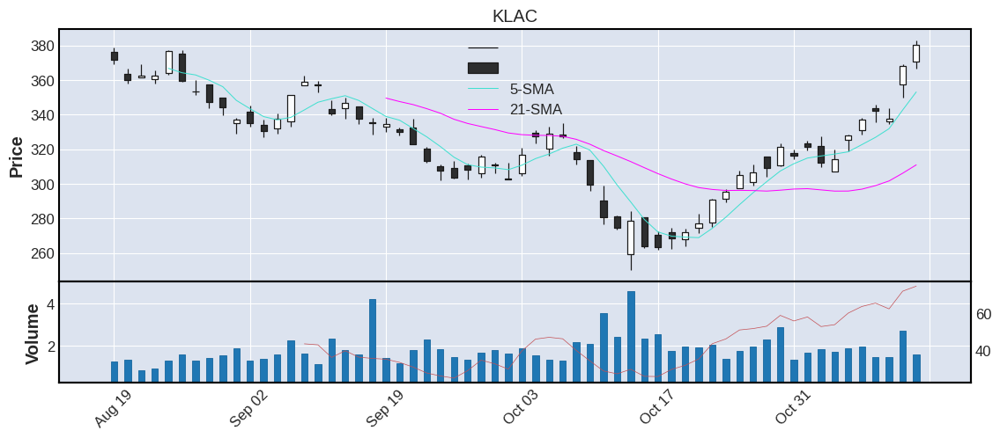



   TICKER    CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
17   CDAY  65.3  58.39  3.1    4.05  3.22  3.91  5.99  Technology  2018.0  United States   medium


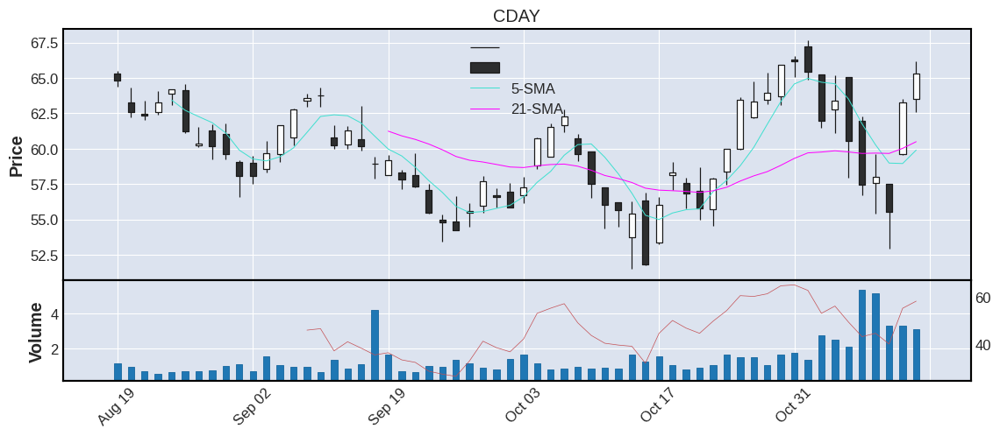



   TICKER      CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO COUNTRY CATEGORY
18   PAYC  340.35  55.36  0.6    0.58  3.21  18.37   5.4  Technology  2014.0     N-A    large


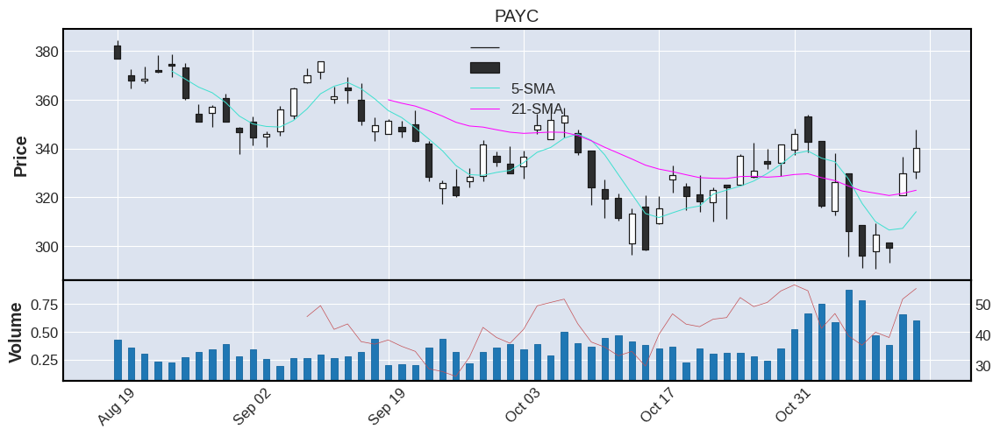



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
19   FTNT  56.13  58.98  5.75    6.23  3.2  2.78  4.95  Technology  2009.0  United States    large


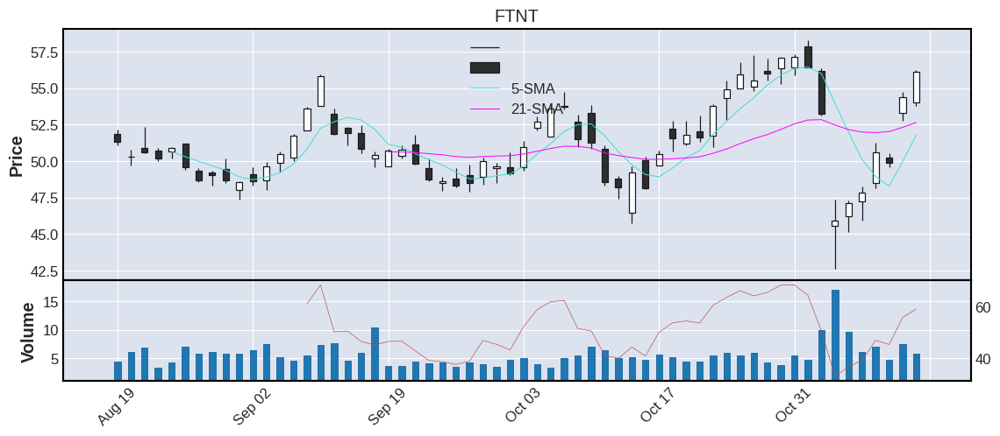



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
20   LRCX  500.82  74.9  2.43    2.39  3.17  20.66  4.13  Technology  1984.0  United States    large


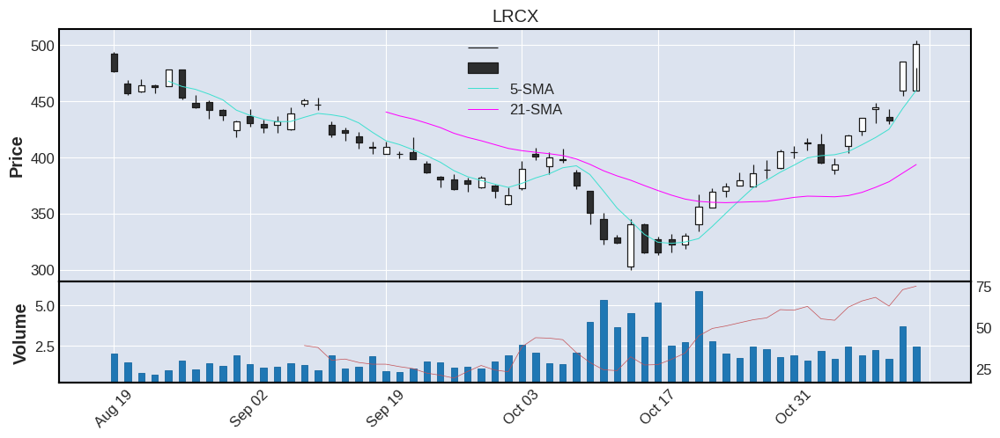



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
21     ON  75.05  64.49  7.16     7.2  3.1  3.89  5.18  Technology  0.0  United States    large


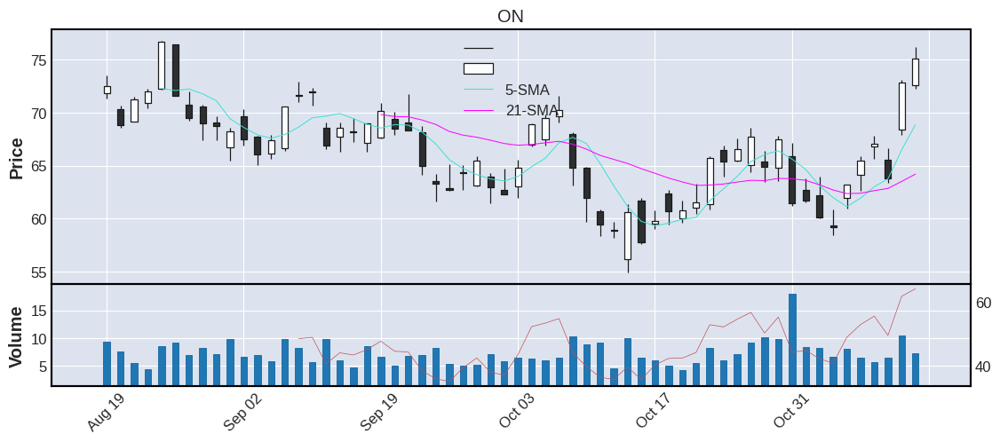



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
22   CDNS  166.9  63.41  2.15    1.84  3.01  5.8  3.48  Technology  0.0  United States    large


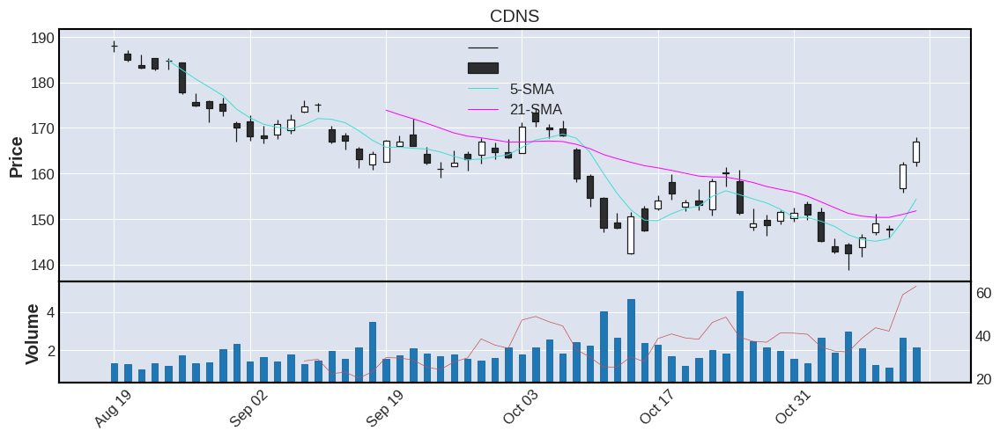



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
23   EPAM  360.23  57.23  0.35    0.43  2.79  16.29  4.52  Technology  2012.0  United States    large


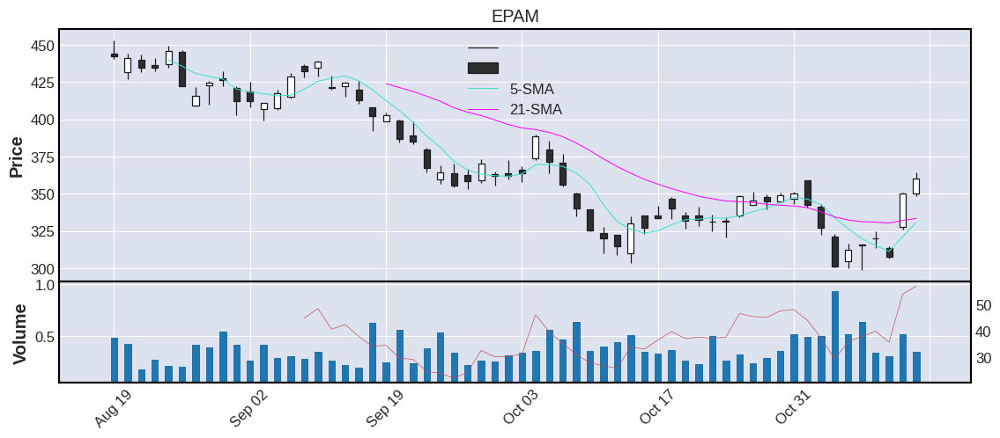



   TICKER      CP   RSI  VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
24    TXN  179.49  68.1  6.4    6.23  2.75  5.41  3.01  Technology  0.0  United States    large


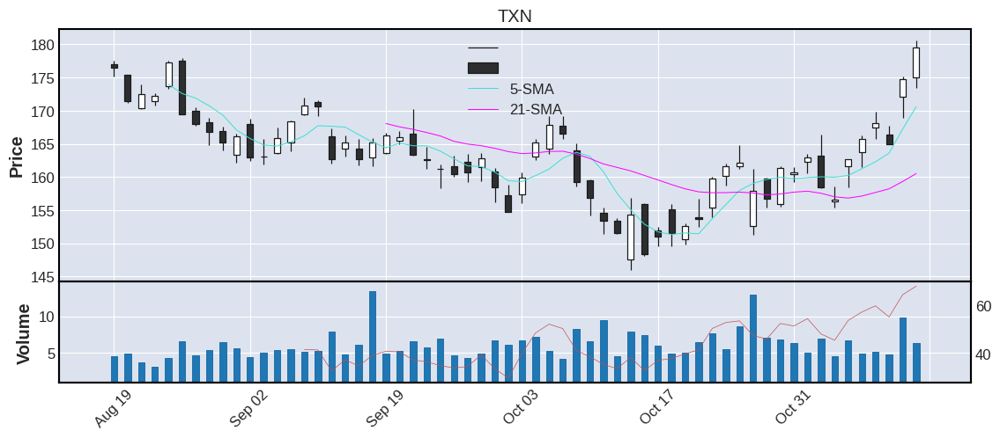



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
25   GOOG  96.73  52.39  30.19   31.28  2.72  3.78  3.91  Technology  2004.0  United States     mega


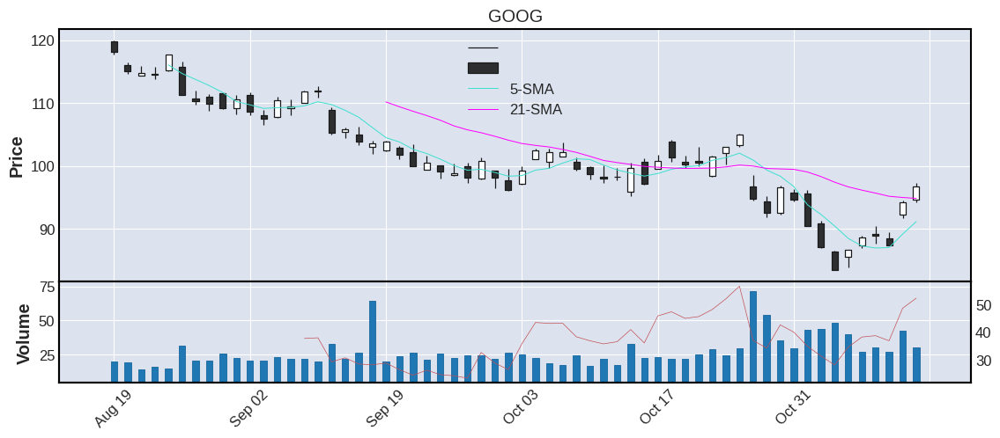



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR      SECTOR     IPO      COUNTRY CATEGORY
26   NXPI  169.94  63.32  2.52    2.98  2.7  7.26  4.27  Technology  2010.0  Netherlands    large


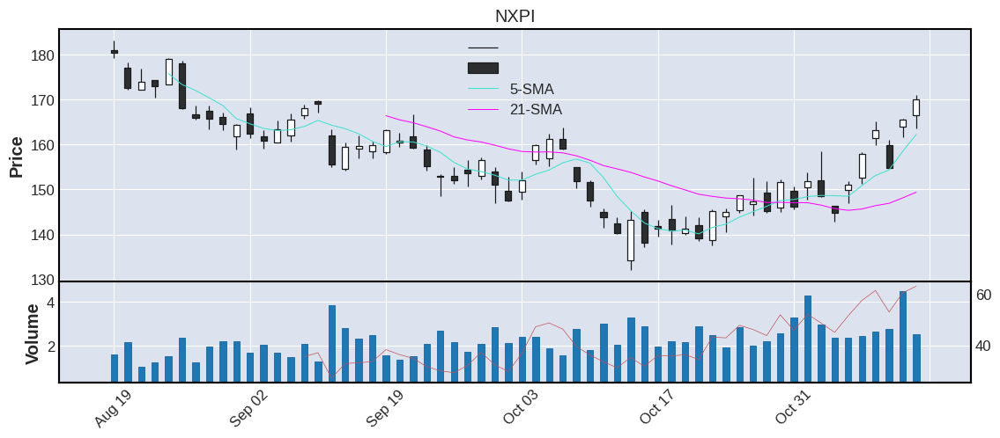



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
27    FLT  199.8  64.12  0.86    0.86  2.67  7.11  3.56  Technology  2010.0  United States    large


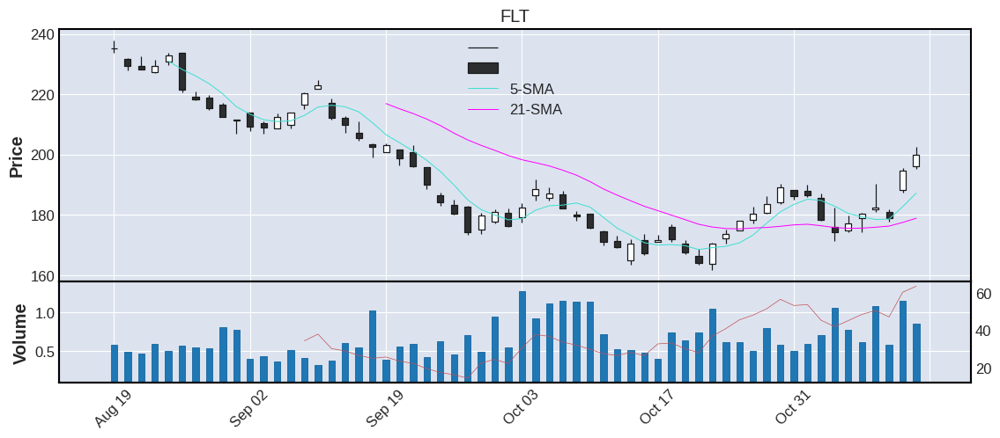



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
28  GOOGL  96.41  52.43  32.84   36.15  2.63  3.77  3.91  Technology  2004.0  United States     mega


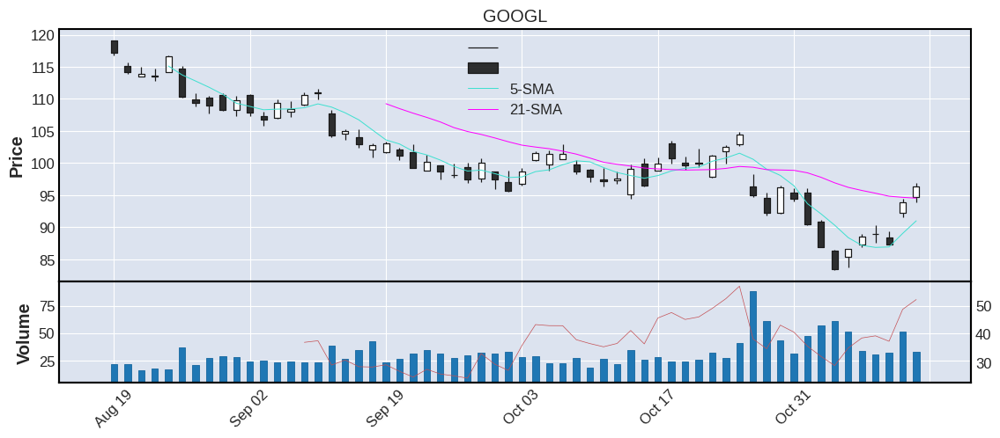



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
29   ADSK  228.8  66.23  1.82    1.72  2.62  9.19  4.02  Technology  0.0  United States    large


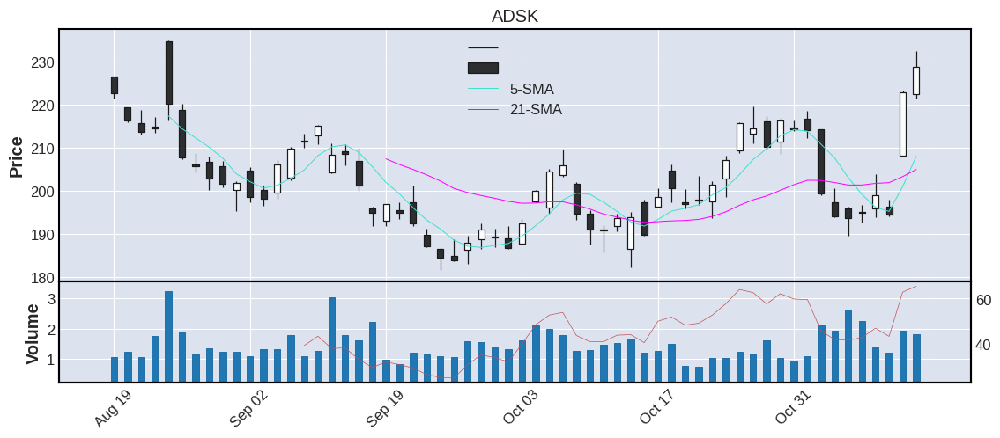



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
30   ANSS  255.71  70.89  0.74    0.89  2.62  8.6  3.36  Technology  1996.0  United States    large


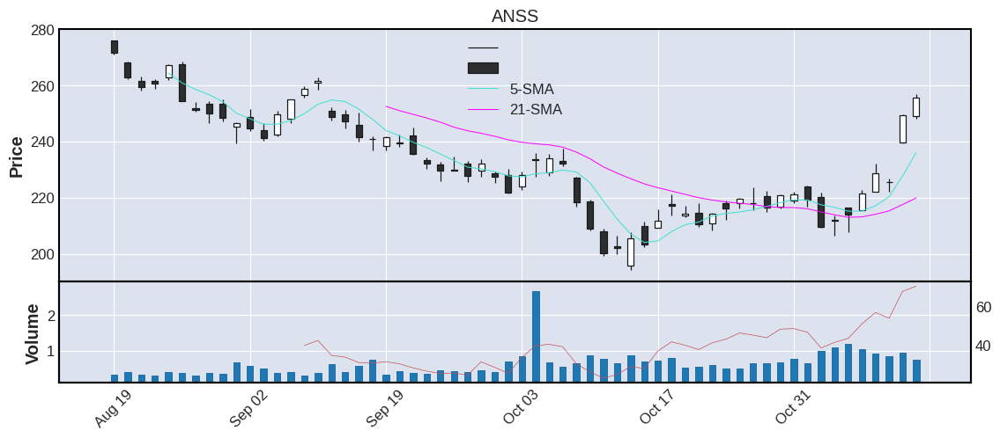



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
31   MCHP  75.83  71.14  4.96    6.82  2.58  3.15  4.15  Technology  1993.0  United States    large


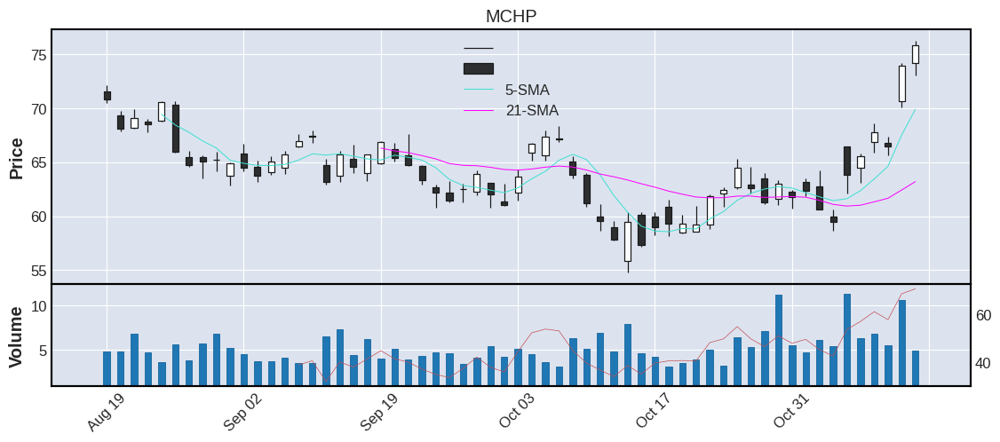



   TICKER      CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
32    ADI  164.06  67.54  3.2    4.29  2.3  5.51  3.36  Technology  0.0  United States    large


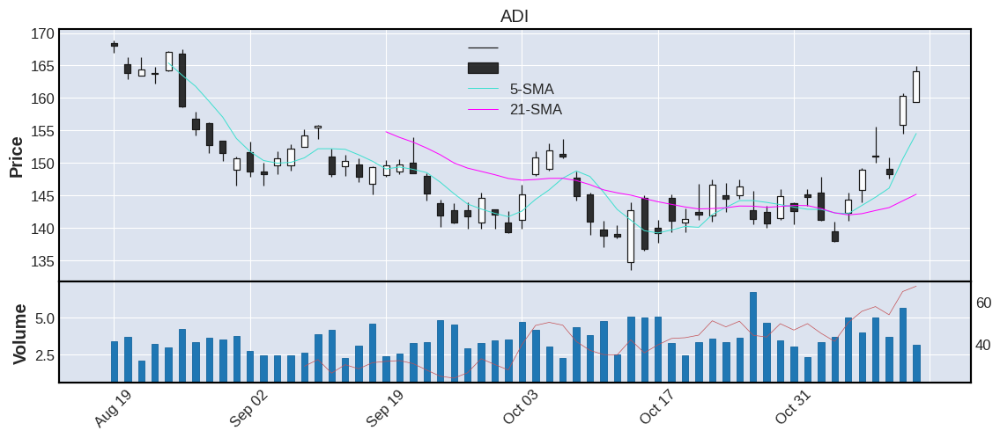



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
33   AVGO  518.09  66.5  2.67    2.46  2.27  16.85  3.25  Technology  2009.0  United States    large


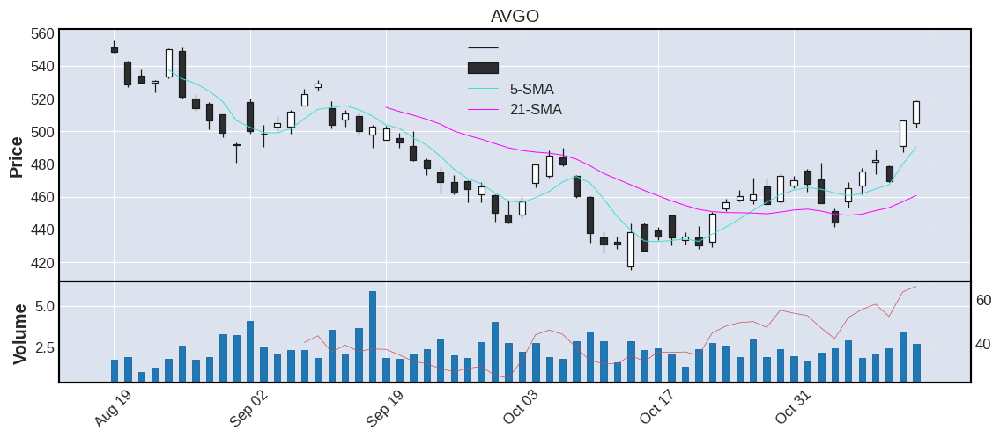



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
34   INTC  30.43  63.33  49.68   42.76  2.25  1.22  4.01  Technology  0.0  United States    large


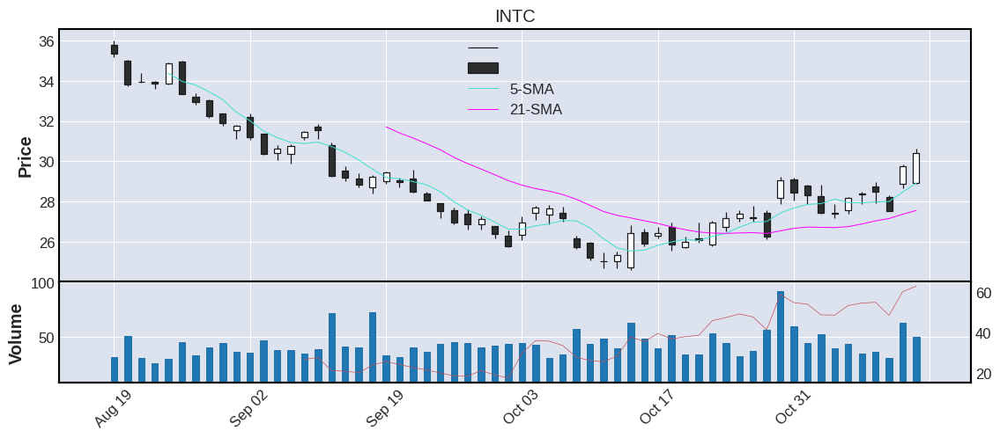



   TICKER    CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
35   NTAP  73.5  66.27  1.41     1.3  2.21  2.2  2.99  Technology  1995.0  United States    large


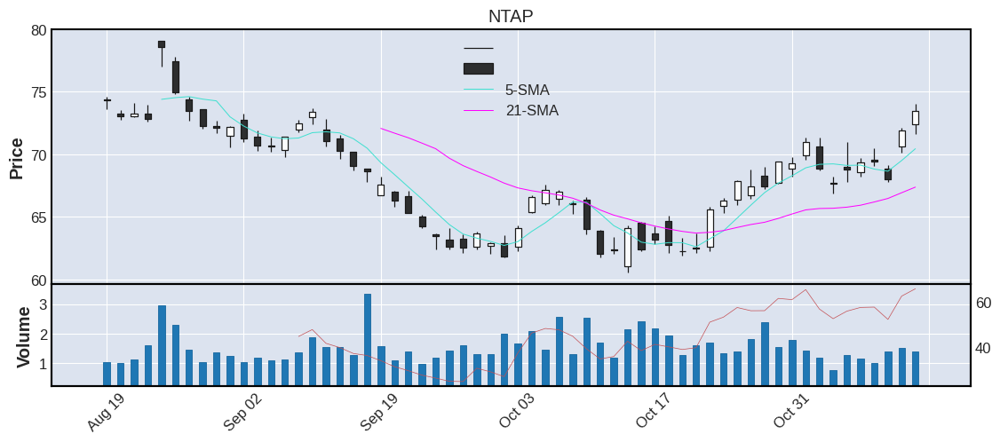



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
36   CTSH  58.42  50.01  3.5    4.72  1.97  1.99  3.41  Technology  1998.0  United States    large


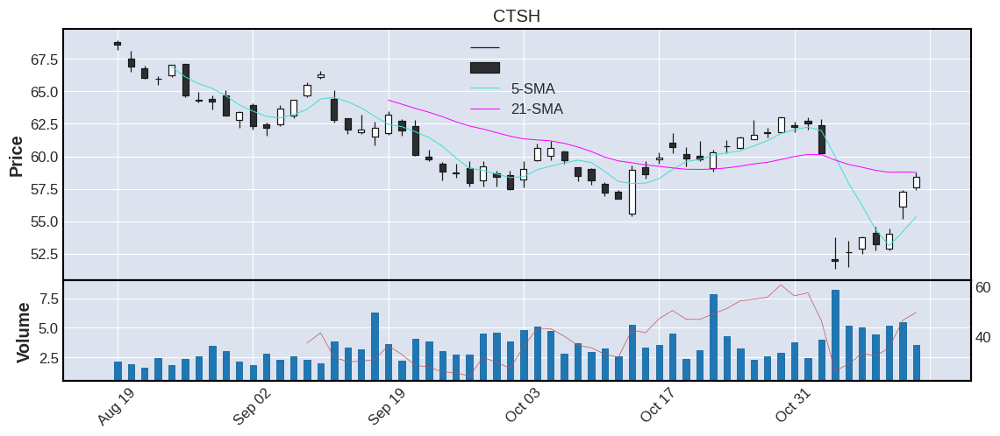



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
37   AAPL  149.7  54.56  93.63   92.14  1.93  5.83  3.89  Technology  1980.0  United States     mega


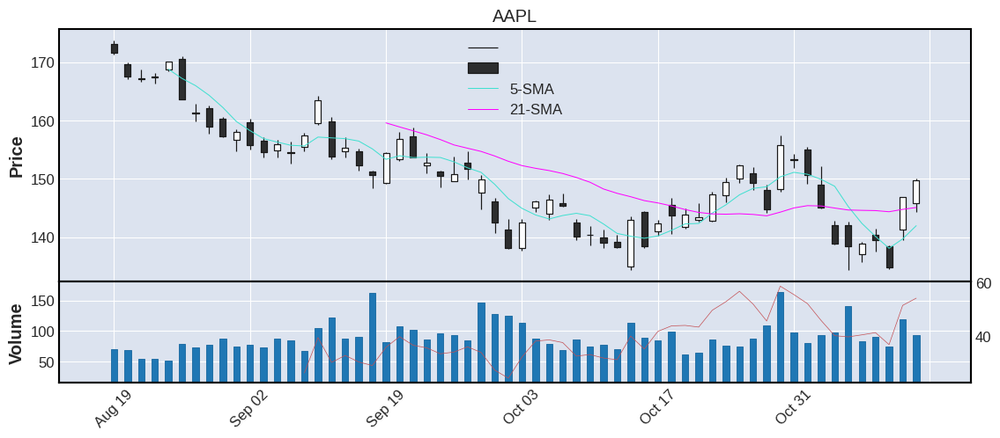



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO COUNTRY CATEGORY
38   SEDG  288.91  70.29  1.79    2.37  1.85  17.06   5.9  Technology  2015.0  Israel    large


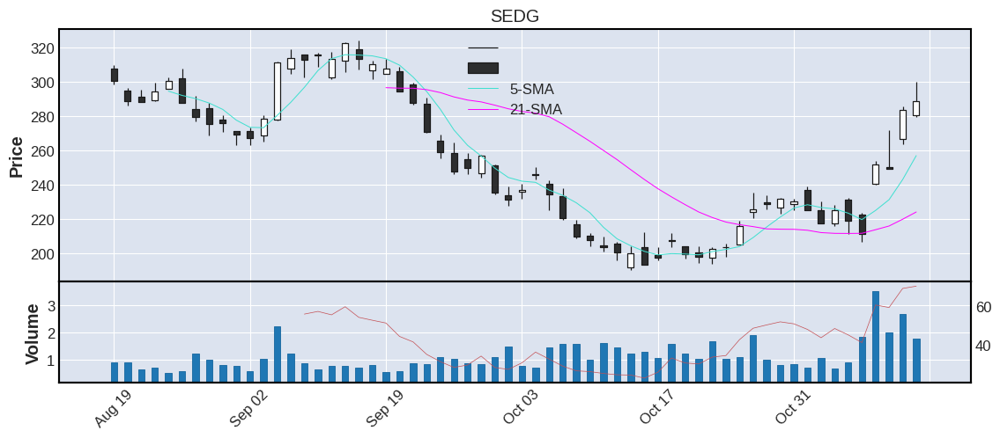



   TICKER      CP    RSI    VOL  AVGVOL %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
39   MSFT  247.11  57.84  34.59   34.08  1.7  8.49  3.44  Technology  1986.0  United States     mega


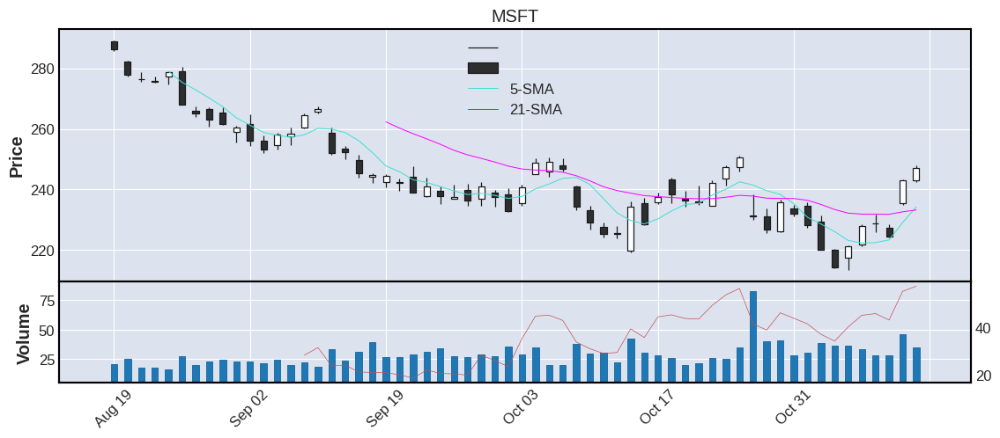



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
40   MPWR  393.37  62.96  0.75    0.72  1.68  18.91  4.81  Technology  2004.0  United States    large


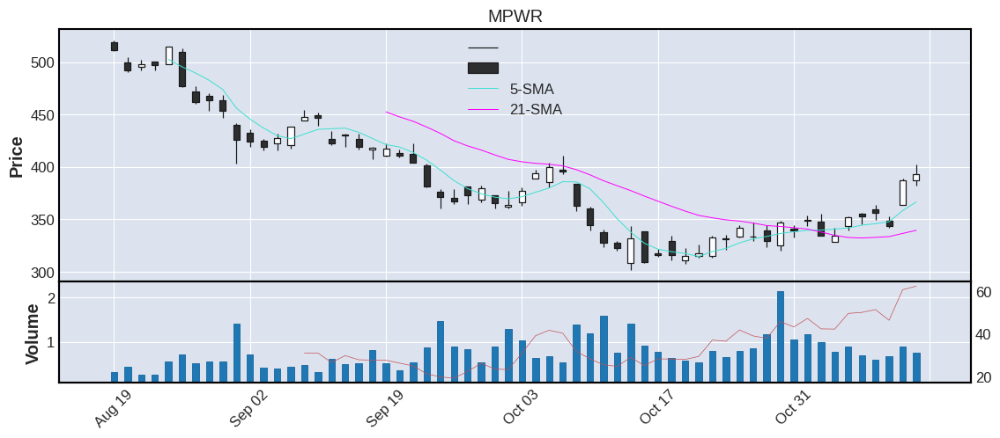



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
41    PTC  131.92  76.76  1.19    1.12  1.66  4.53  3.43  Technology  0.0  United States    large


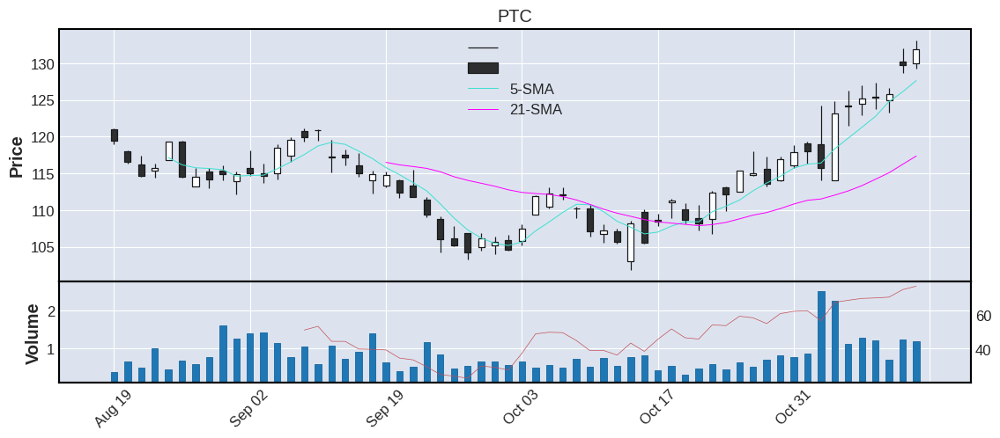



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
42    GLW  34.46  64.19  3.28    4.18  1.65  1.09  3.16  Technology  0.0  United States    large


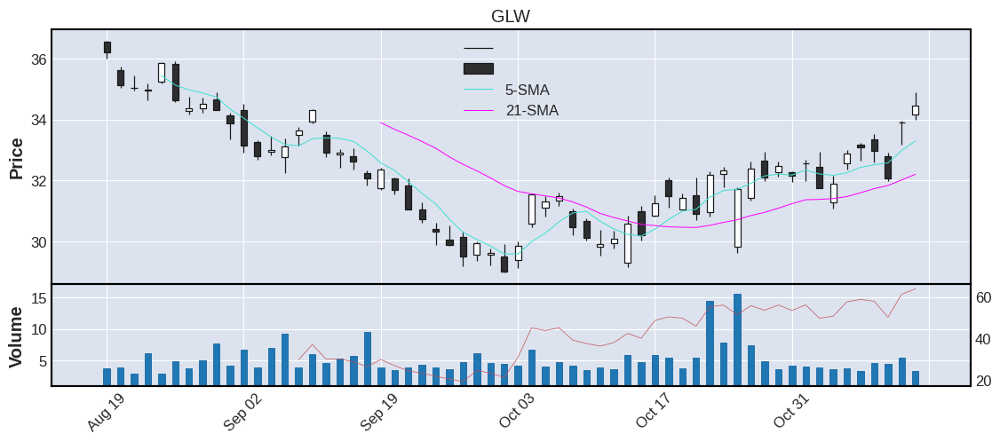



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR      SECTOR  IPO      COUNTRY CATEGORY
43    TEL  124.11  59.98  2.77     2.2  1.6  3.93  3.17  Technology  0.0  Switzerland    large


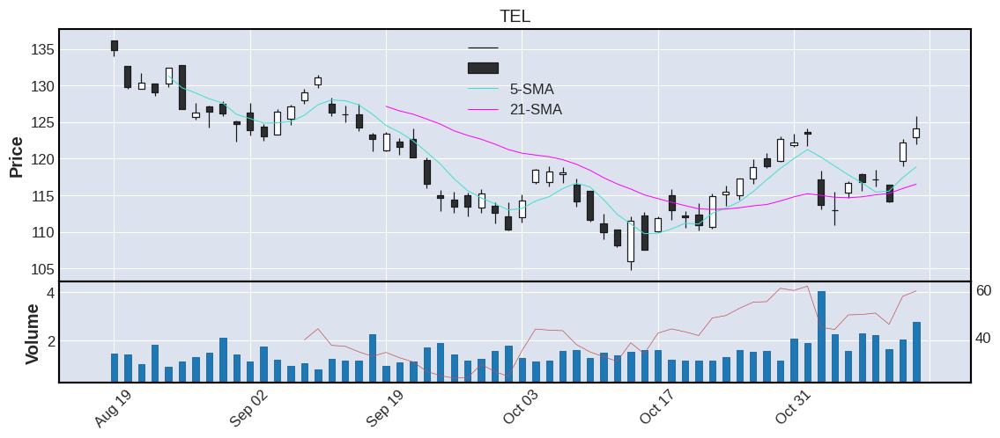



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO COUNTRY CATEGORY
44    DXC  29.46  57.42  1.51    1.87  1.55  1.17  3.97  Technology  0.0     N-A   medium


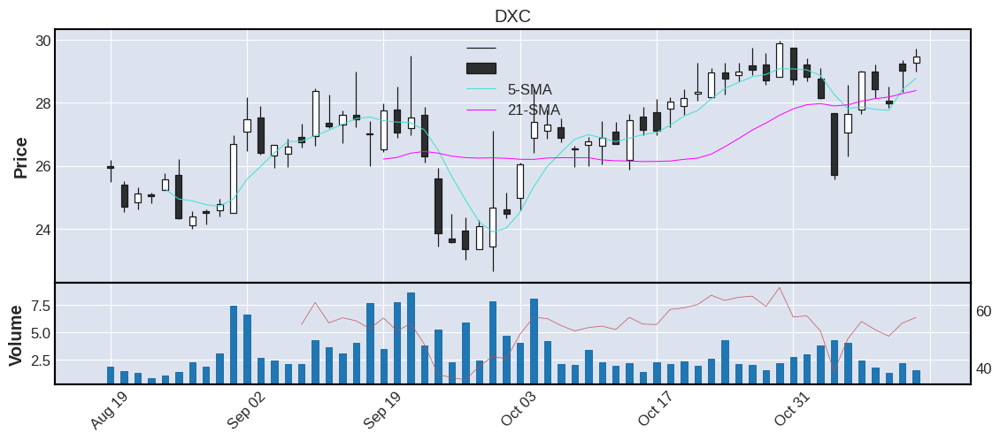



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
45    NOW  409.91  56.83  2.14     1.9  1.45  21.45  5.23  Technology  2012.0  United States    large


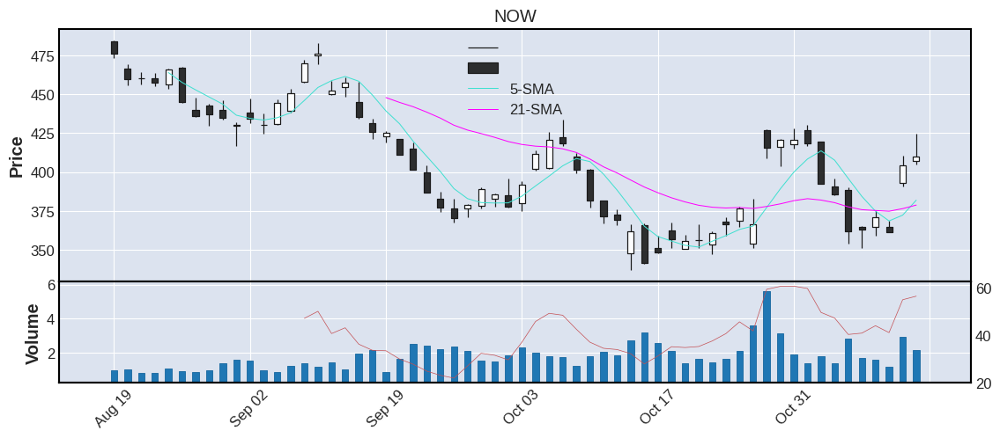



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR  IPO        COUNTRY CATEGORY
46    IBM  143.17  69.67  5.16    4.87  1.37  3.02  2.11  Technology  0.0  United States    large


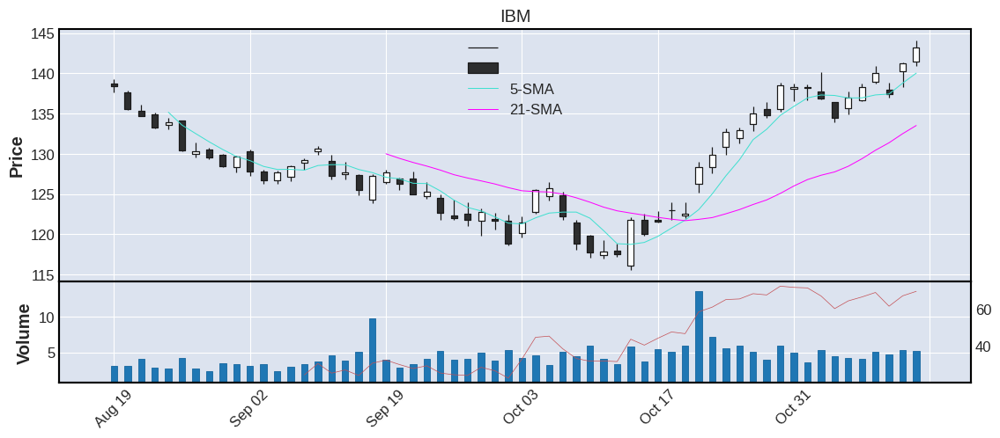



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO COUNTRY CATEGORY
47   ANET  128.55  60.19  2.87    2.94  1.24  5.83  4.54  Technology  2014.0     N-A    large


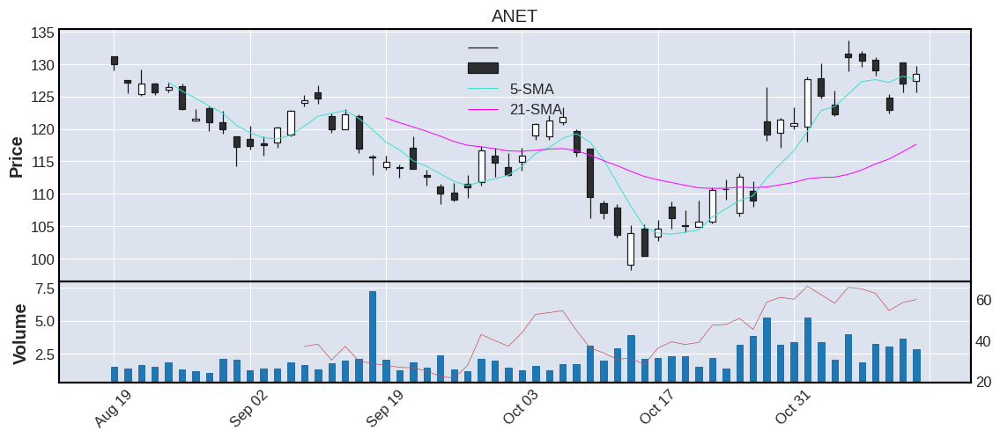



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
48   INTU  408.04  53.02  1.72    2.11  1.19  18.89  4.63  Technology  1993.0  United States    large


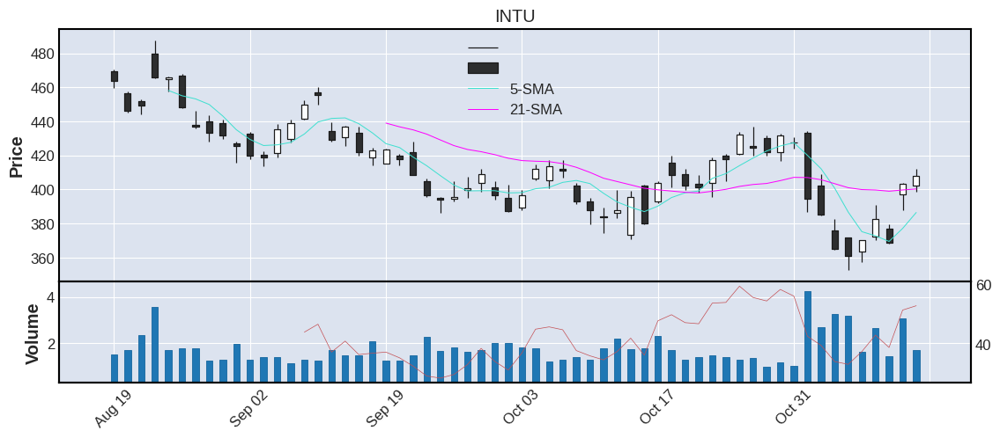



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO  COUNTRY CATEGORY
49    ACN  290.09  61.54  2.62    2.44  1.07  8.83  3.04  Technology  2001.0  Ireland    large


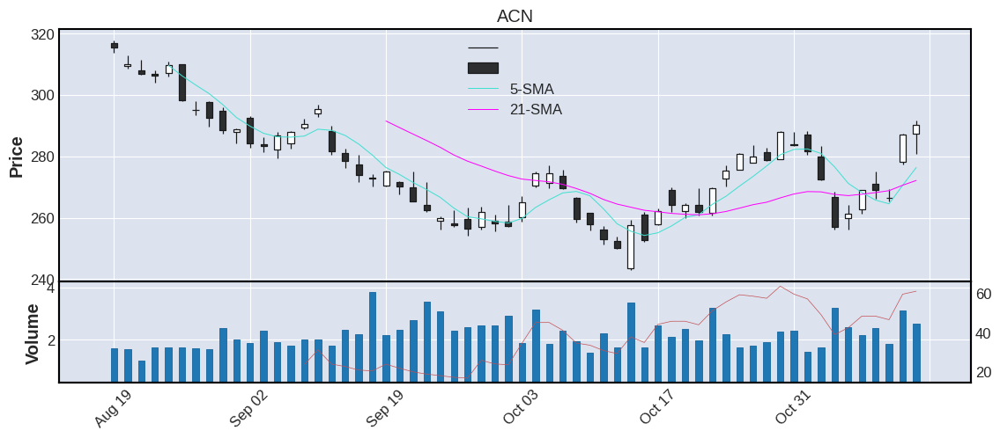



   TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR      SECTOR     IPO        COUNTRY CATEGORY
50   META  113.02  48.48  59.83   76.45  1.03  7.49  6.63  Technology  2012.0  United States     mega


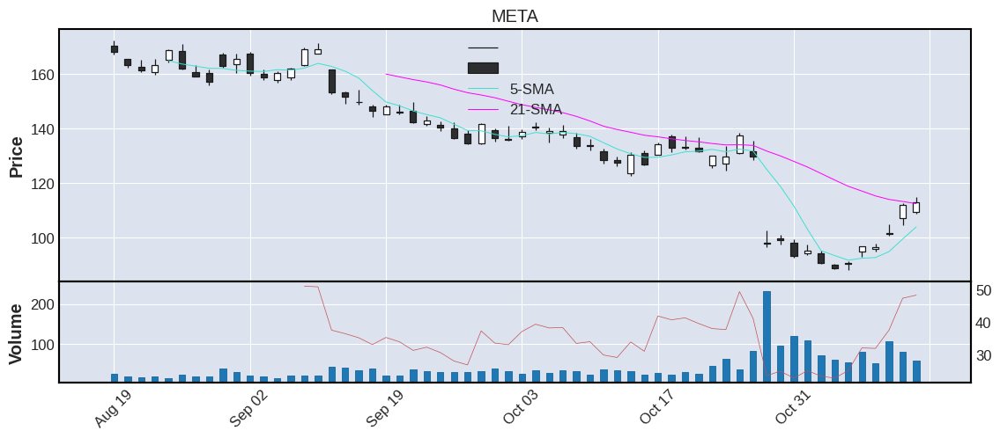



================================================== SECTOR 2: HEALTH_CARE [ %CHG ] ================================================== 

    TICKER       CP    RSI    VOL  AVGVOL   %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
1    ALGN   218.98  58.15   1.91    1.41  11.45  13.60  6.21  Health_Care  2001.0  United States    large
2     COO   324.32  75.80   1.02    0.45   7.38  10.39  3.20  Health_Care     0.0  United States    large
3    IDXX   441.27  75.28   0.87    0.58   6.06  17.52  3.97  Health_Care  1991.0  United States    large
4    XRAY    32.05  62.33   4.02    3.04   5.85   1.29  4.02  Health_Care  1987.0  United States   medium
5     PKI   143.46  64.20   1.51    1.29   5.19   5.18  3.61  Health_Care     0.0  United States    large
6    CTLT    47.18  31.16   3.43    3.61    5.1   3.90  8.27  Health_Care  2014.0  United States   medium
7     DVA    71.90  40.17   0.95    1.06   5.04   4.44  6.18  Health_Care     0.0  United States   medium
8     ZTS   14

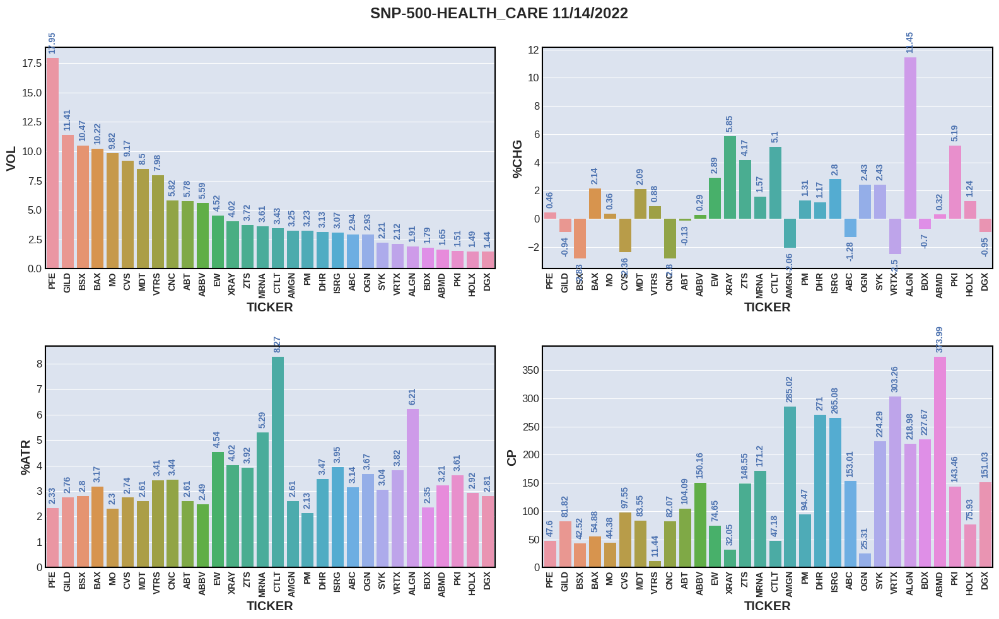

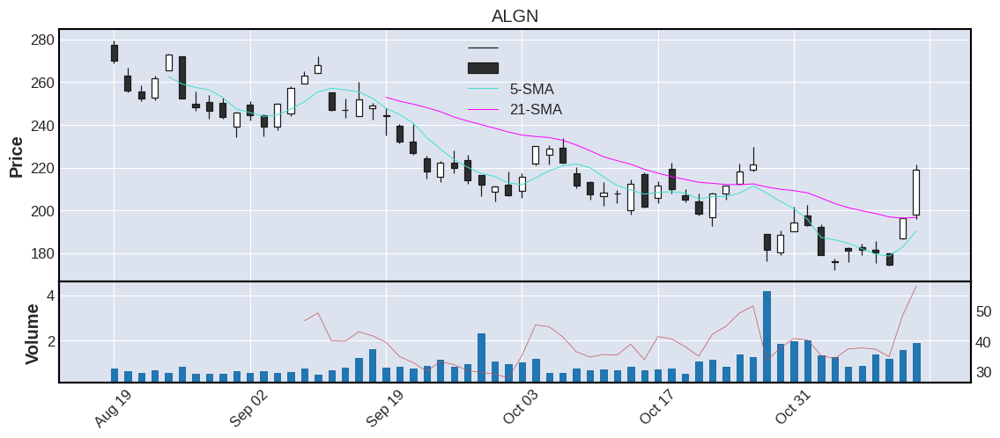



  TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
2    COO  324.32  75.8  1.02    0.45  7.38  10.39   3.2  Health_Care  0.0  United States    large


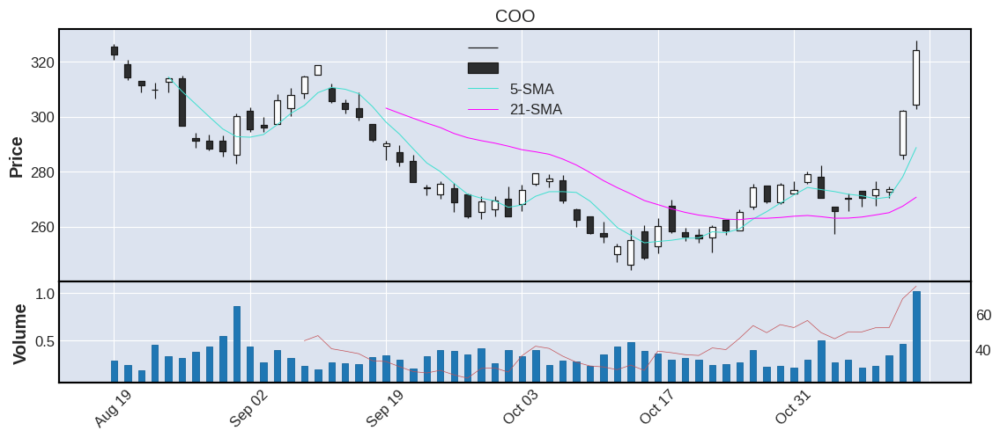



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
3   IDXX  441.27  75.28  0.87    0.58  6.06  17.52  3.97  Health_Care  1991.0  United States    large


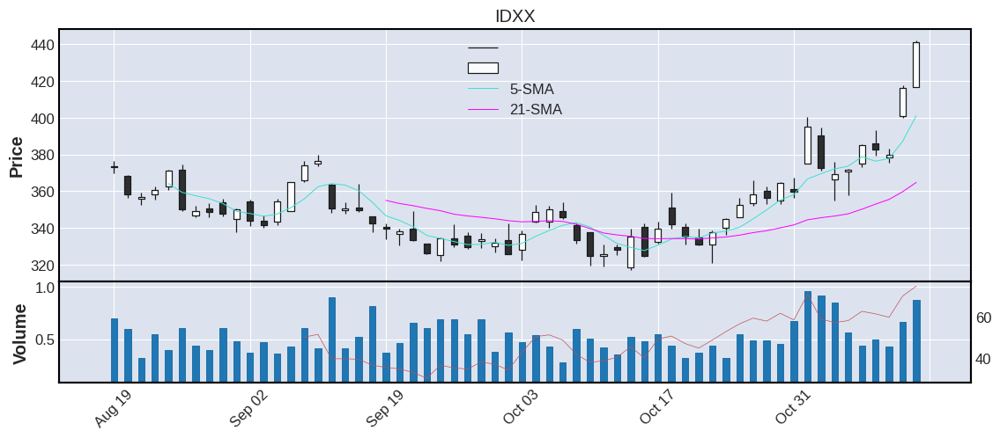



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
4   XRAY  32.05  62.33  4.02    3.04  5.85  1.29  4.02  Health_Care  1987.0  United States   medium


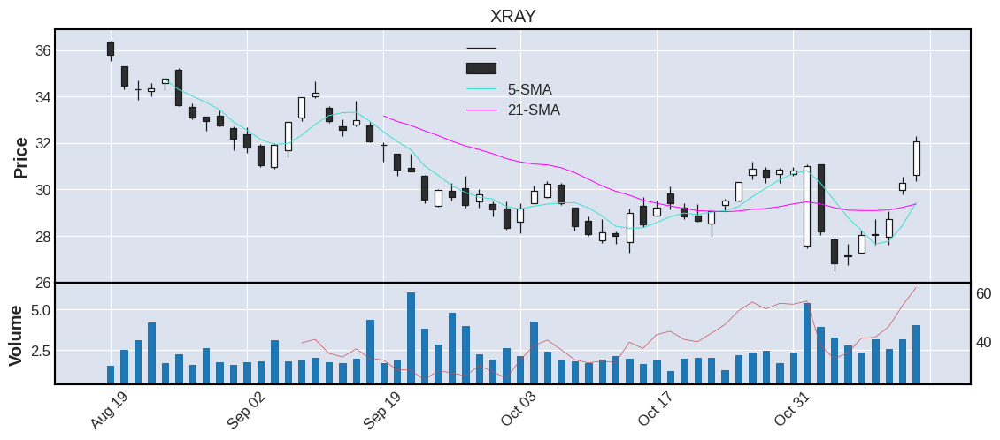



  TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
5    PKI  143.46  64.2  1.51    1.29  5.19  5.18  3.61  Health_Care  0.0  United States    large


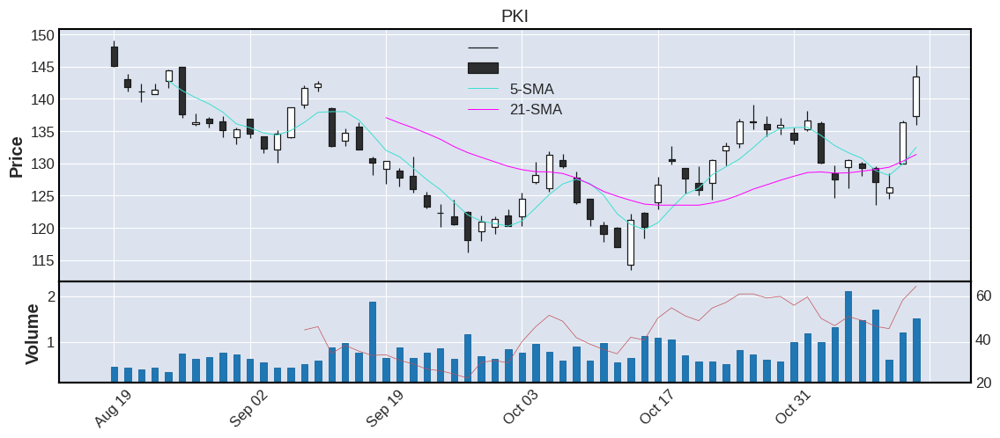



  TICKER     CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
6   CTLT  47.18  31.16  3.43    3.61  5.1  3.9  8.27  Health_Care  2014.0  United States   medium


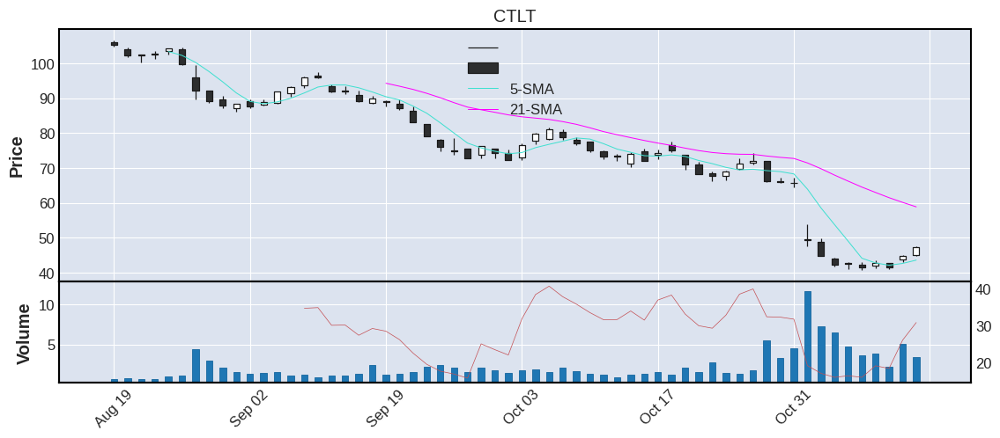



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
7    DVA  71.9  40.17  0.95    1.06  5.04  4.44  6.18  Health_Care  0.0  United States   medium


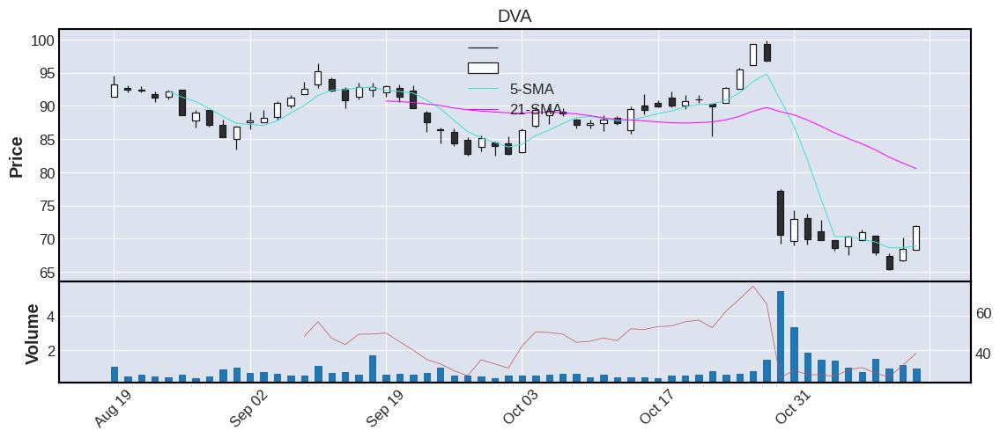



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
8    ZTS  148.55  52.67  3.72    3.56  4.17  5.82  3.92  Health_Care  2013.0  United States    large


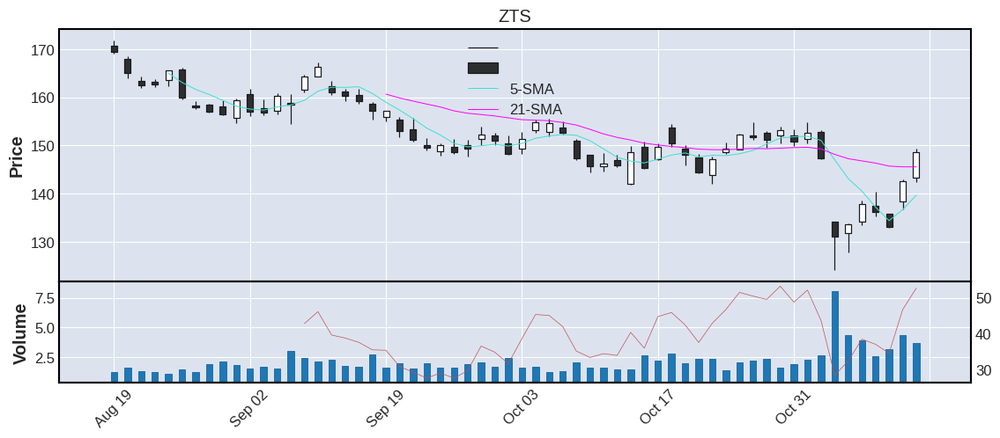



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
9   TECH  349.97  70.94  0.53    0.56  3.82  15.01  4.29  Health_Care  0.0  United States    large


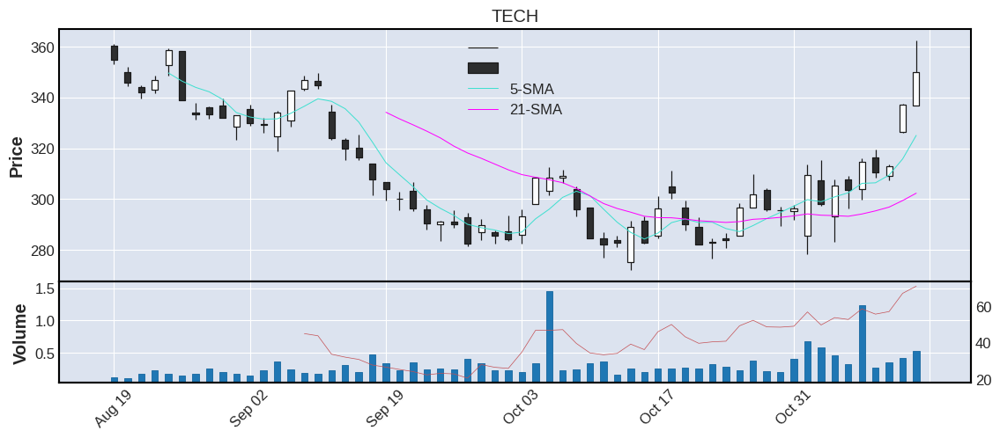



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
10    WST  250.93  55.74  0.96     0.7  3.37  12.69  5.06  Health_Care  0.0  United States    large


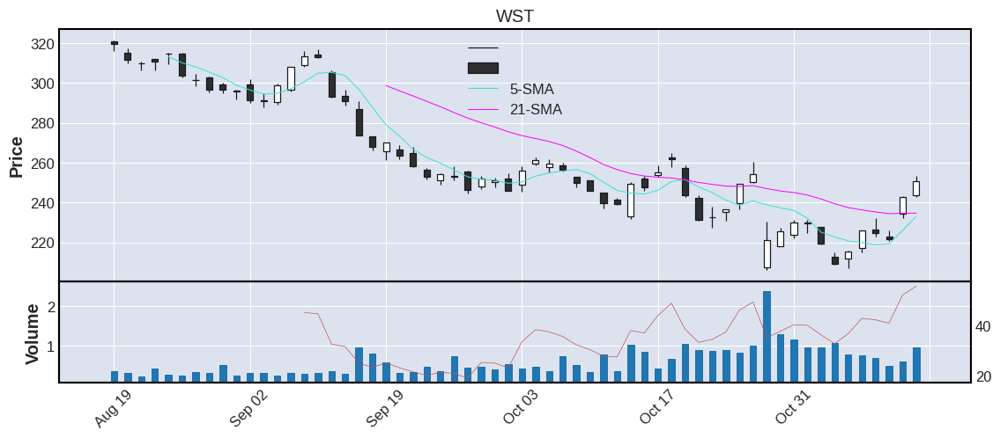



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
11     EW  74.65  43.17  4.52    7.55  2.89  3.39  4.54  Health_Care  0.0  United States    large


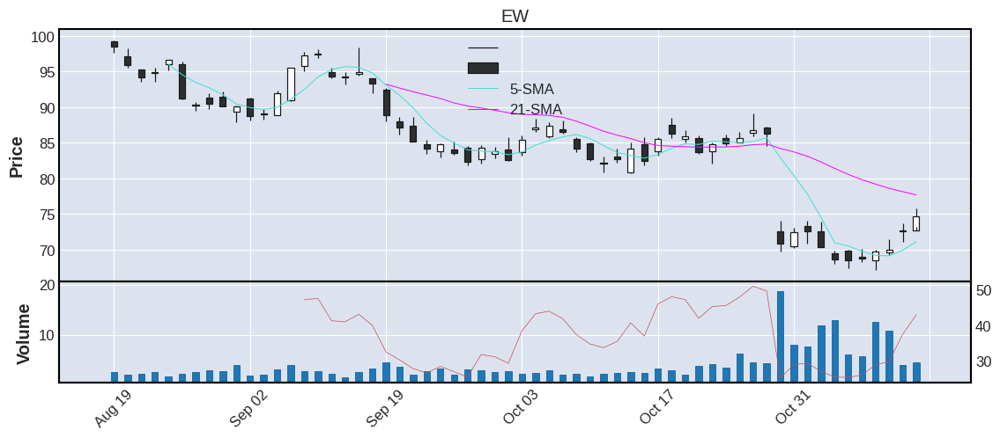



   TICKER      CP    RSI   VOL  AVGVOL %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
12   ISRG  265.08  74.26  3.07     2.5  2.8  10.48  3.95  Health_Care  2000.0  United States    large


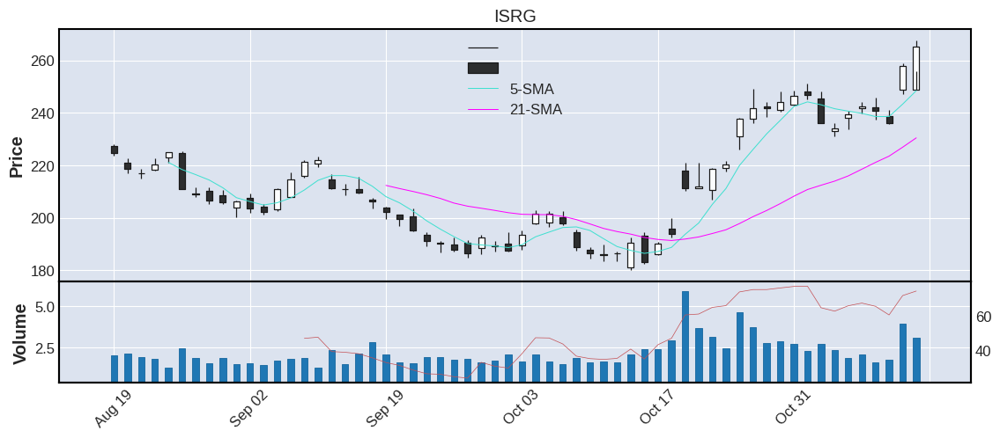



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
13    UHS  125.0  73.49  1.02    0.75  2.63  4.97  3.98  Health_Care  0.0  United States   medium


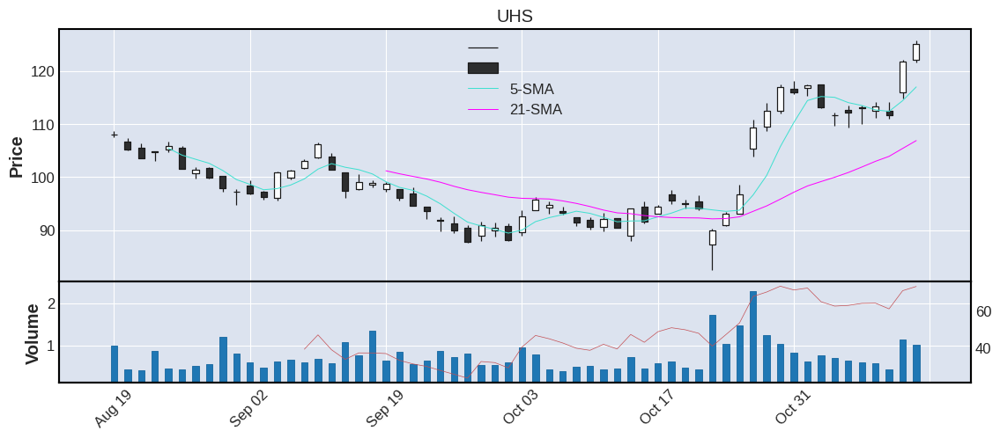



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
14    OGN  25.31  52.31  2.93    2.75  2.43  0.93  3.67  Health_Care  2021.0     N-A   medium


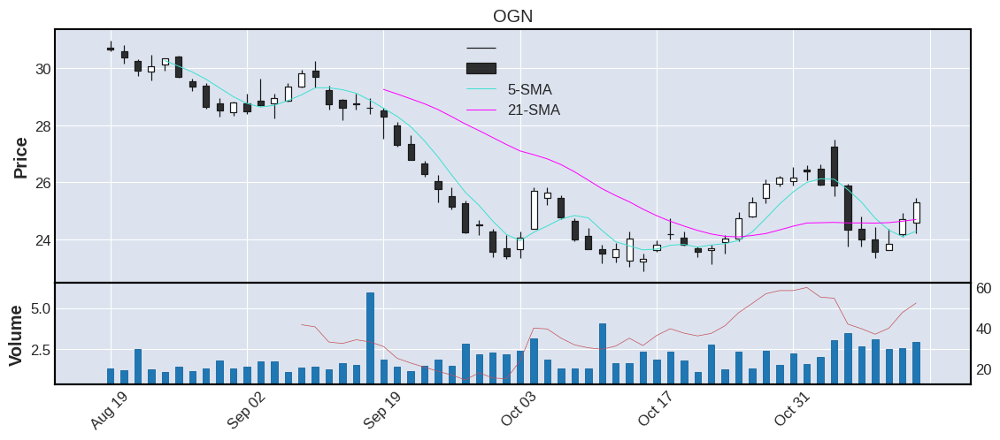



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
15     LH  248.97  70.12  0.95    0.92  2.43  8.14  3.27  Health_Care  0.0  United States    large


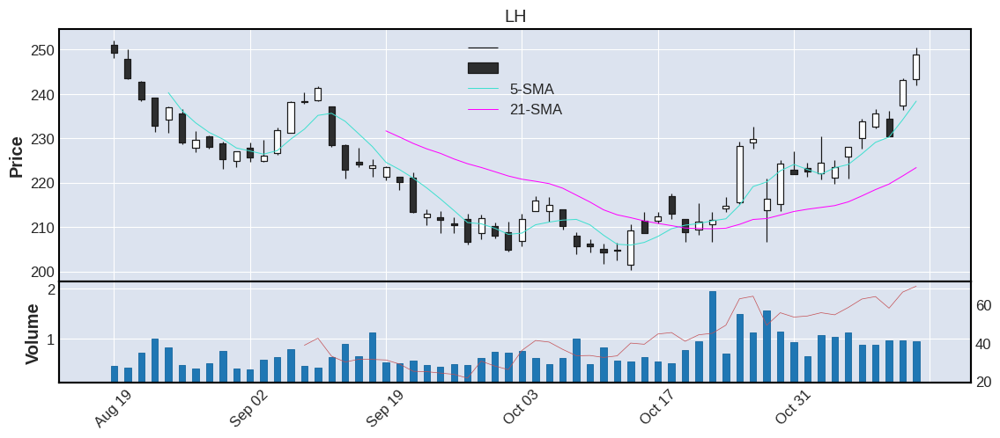



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
16    SYK  224.29  57.28  2.21    1.72  2.43  6.82  3.04  Health_Care  0.0  United States    large


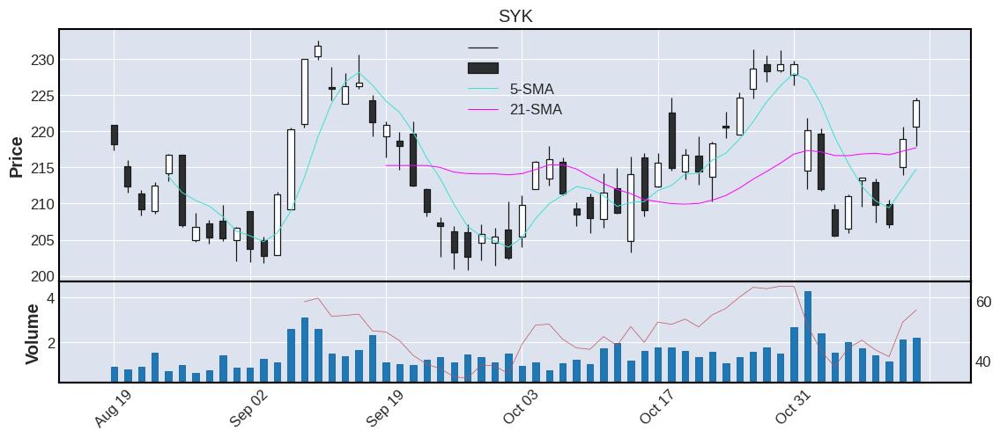



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
17    ZBH  115.56  61.21  1.03    1.15  2.36  3.43  2.97  Health_Care  0.0  United States    large


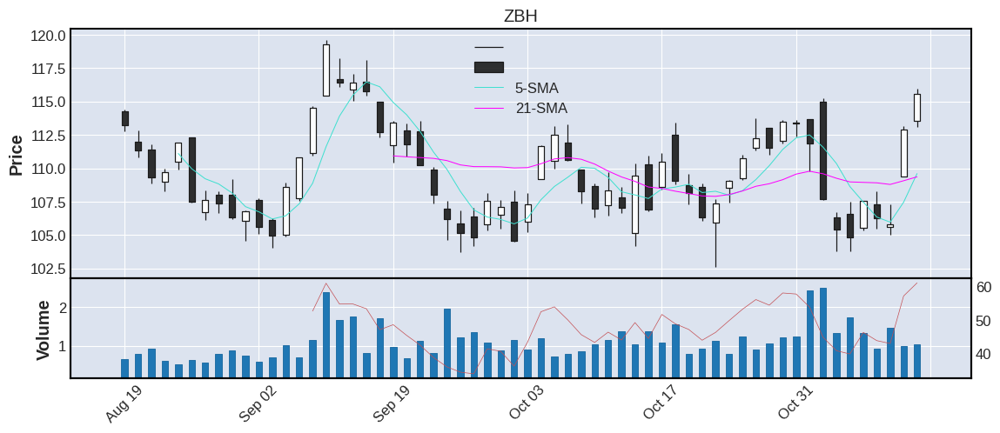



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
18    BAX  54.88  52.06  10.22    5.74  2.14  1.74  3.17  Health_Care  0.0  United States    large


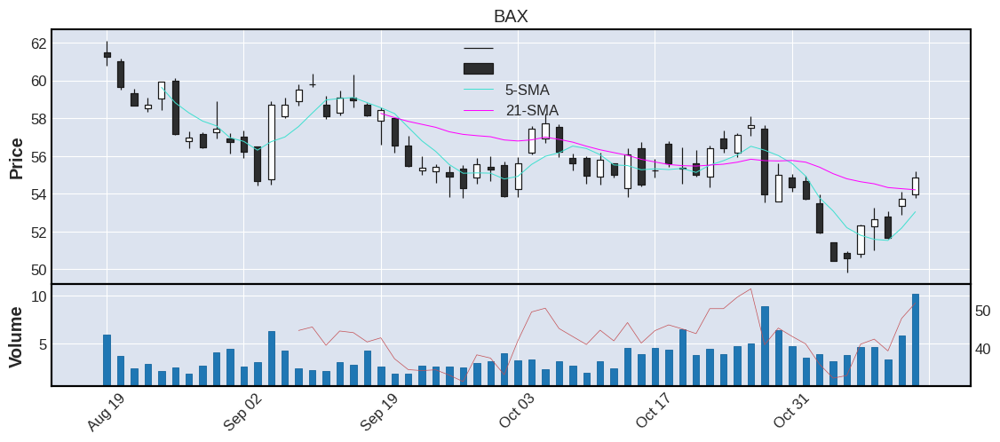



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
19    MDT  83.55  48.73  8.5    8.57  2.09  2.18  2.61  Health_Care  0.0  United States    large


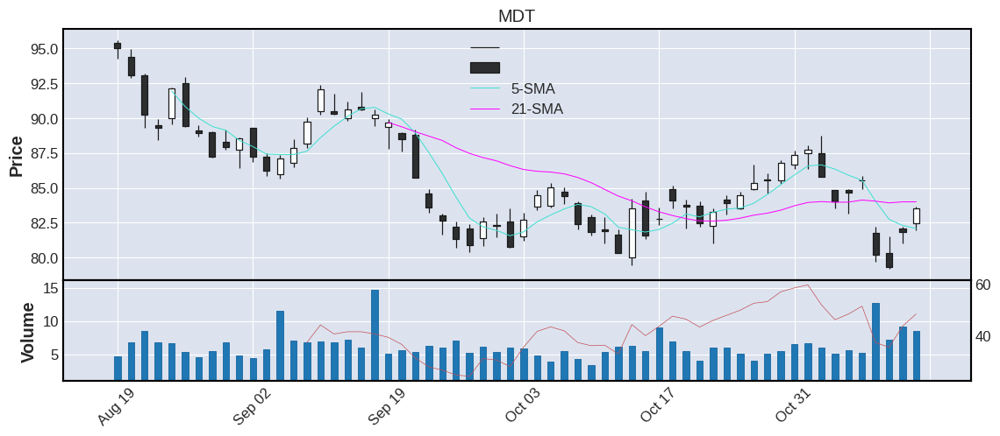



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
20    STE  172.54  53.52  0.77    0.79  1.93  4.58  2.65  Health_Care  0.0  United States    large


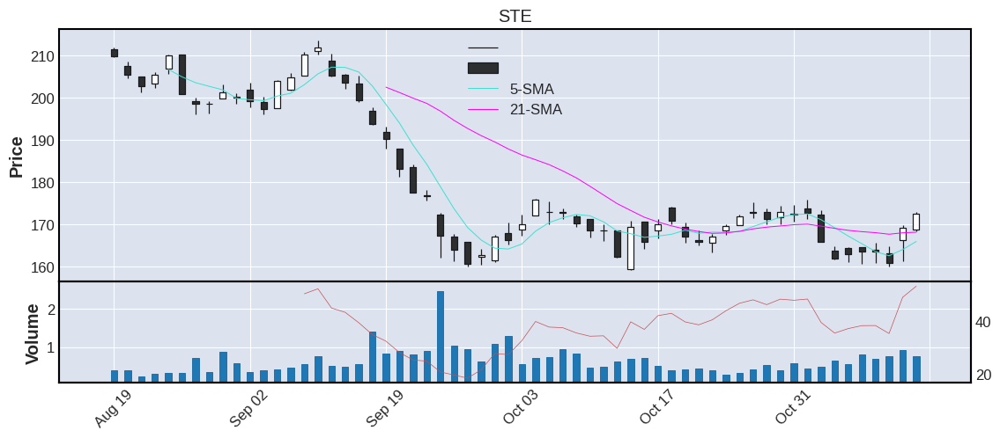



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
21    IQV  226.53  71.34  0.89    0.73  1.77  8.24  3.64  Health_Care  2013.0  United States    large


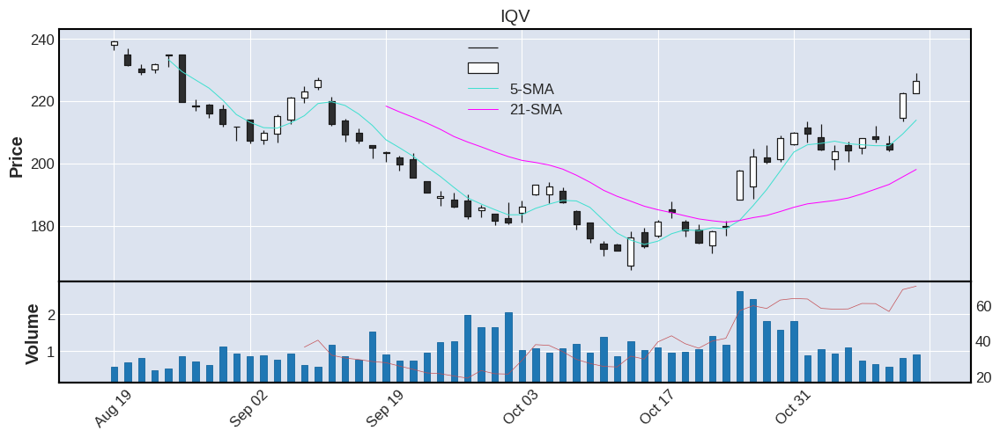



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
22   HSIC  78.63  70.95  0.98    1.14  1.69  2.3  2.93  Health_Care  1995.0  United States   medium


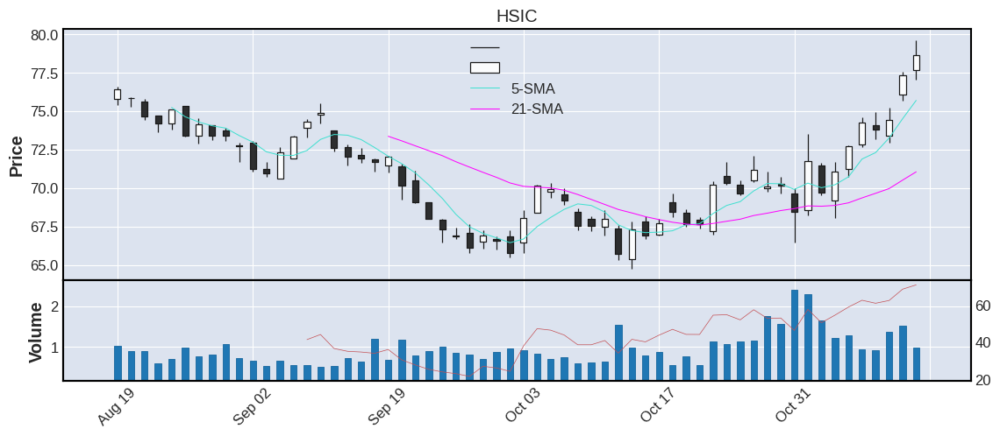



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
23   MRNA  171.2  71.49  3.61    4.11  1.57  9.06  5.29  Health_Care  2018.0  United States    large


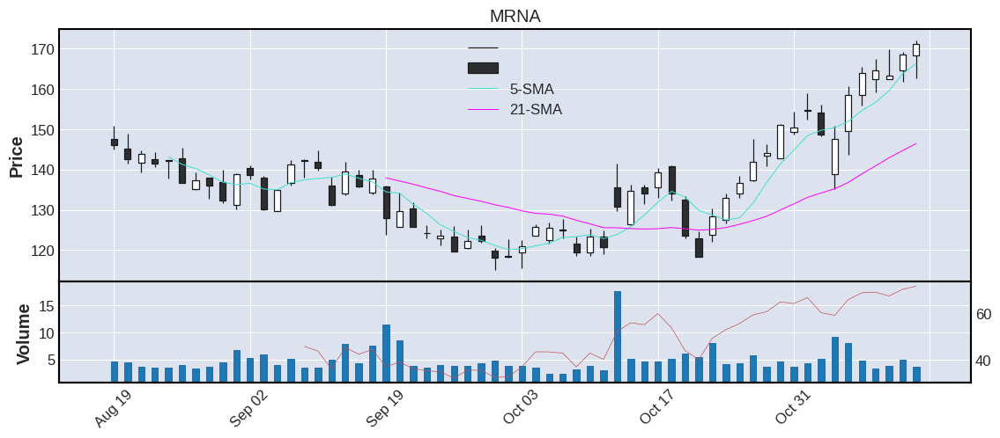



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
24     PM  94.47  62.78  3.23    4.21  1.31  2.01  2.13  Health_Care  0.0  United States    large


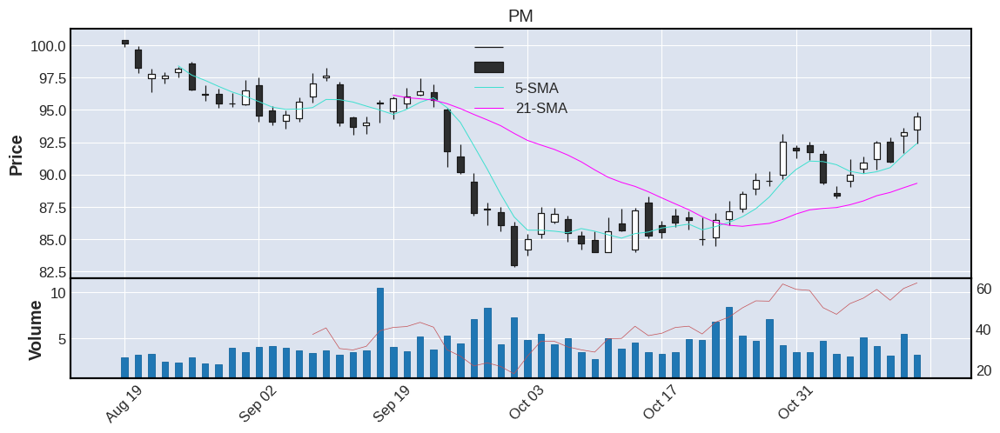



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
25   HOLX  75.93  68.81  1.49    1.57  1.24  2.22  2.92  Health_Care  1990.0  United States    large


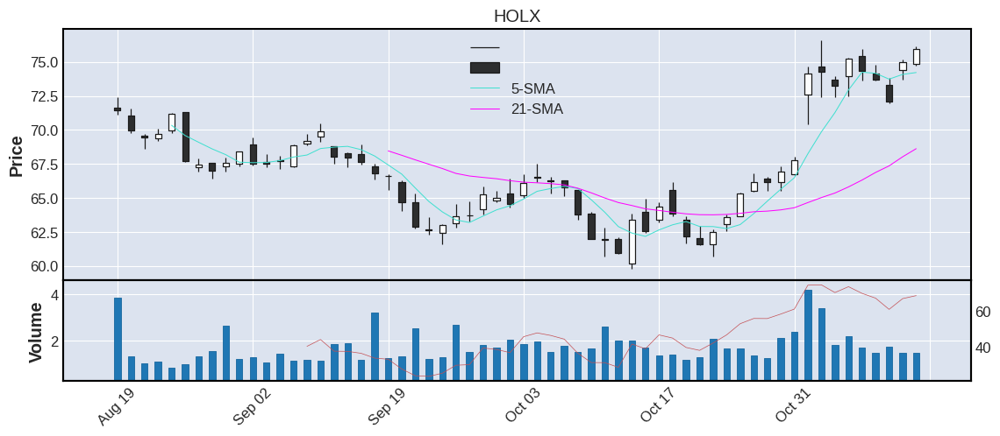



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
26    DHR  271.0  59.49  3.13    2.86  1.17  9.41  3.47  Health_Care  0.0  United States    large


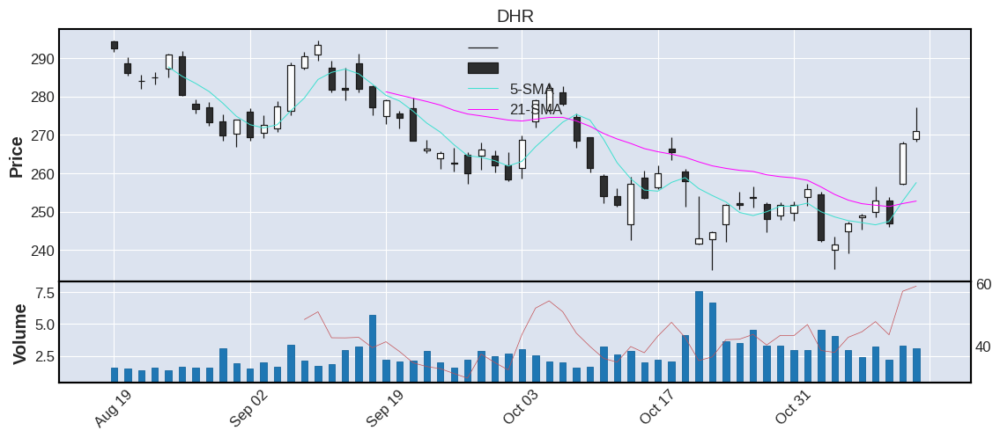



   TICKER      CP    RSI   VOL  AVGVOL %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
27   ILMN  242.74  64.51  1.31     1.3  1.1  11.22  4.62  Health_Care  2000.0  United States    large


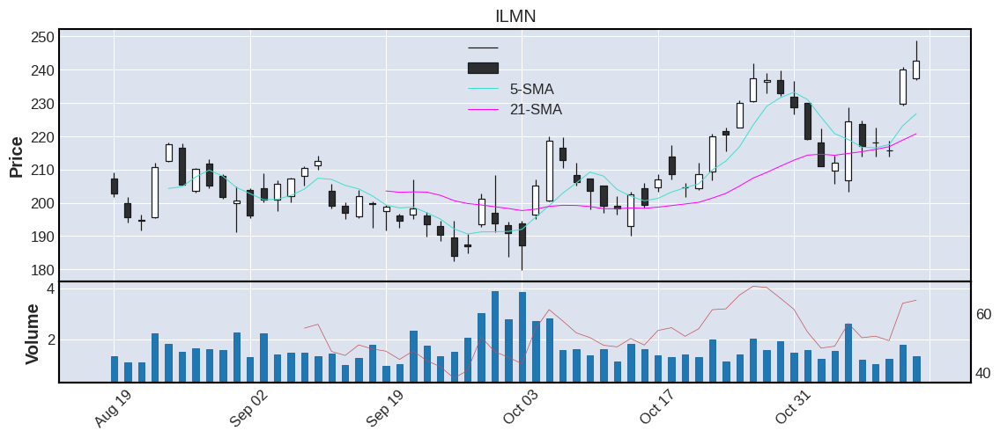



   TICKER       CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO      COUNTRY CATEGORY
28    MTD  1464.38  75.05  0.14    0.14  1.05  50.08  3.42  Health_Care  1997.0  Switzerland    large


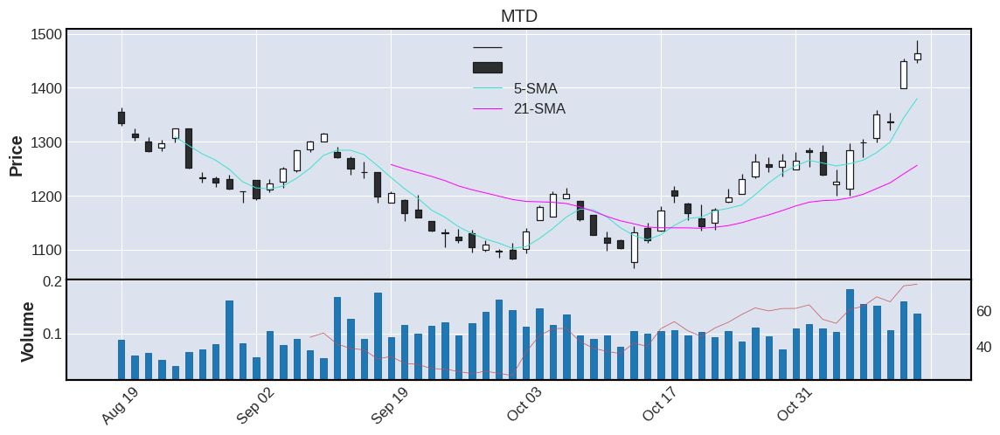



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
29   VTRS  11.44  71.37  7.98   14.14  0.88  0.39  3.41  Health_Care  0.0  United States    large


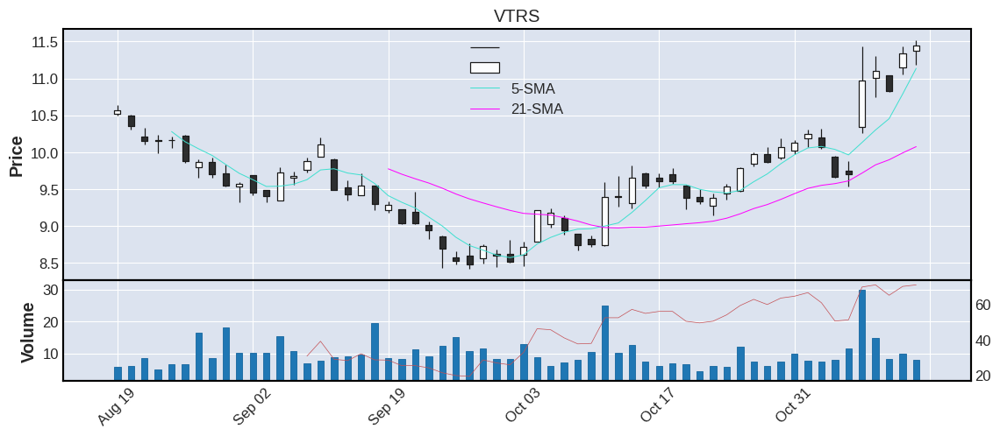



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
30    HCA  224.08  61.15  1.33    1.28  0.71  8.52   3.8  Health_Care  2011.0  United States    large


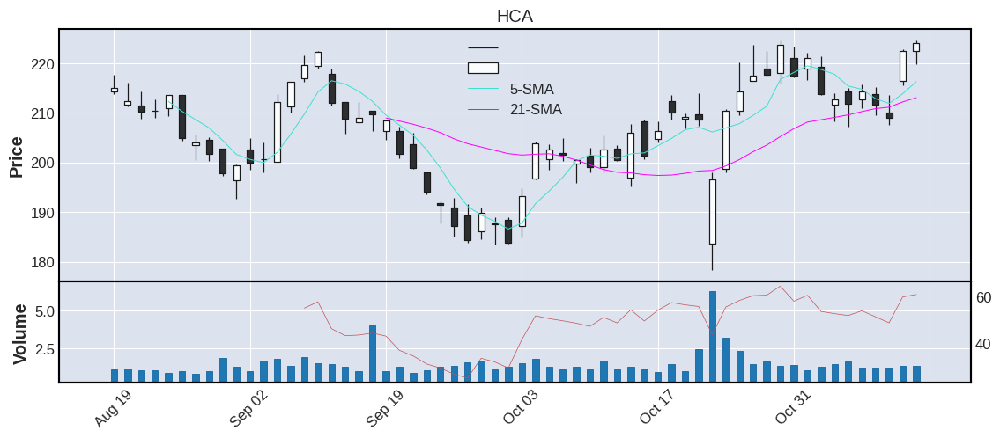



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
31    TFX  219.51  60.23  0.51    0.35  0.6  7.85  3.58  Health_Care  0.0  United States   medium


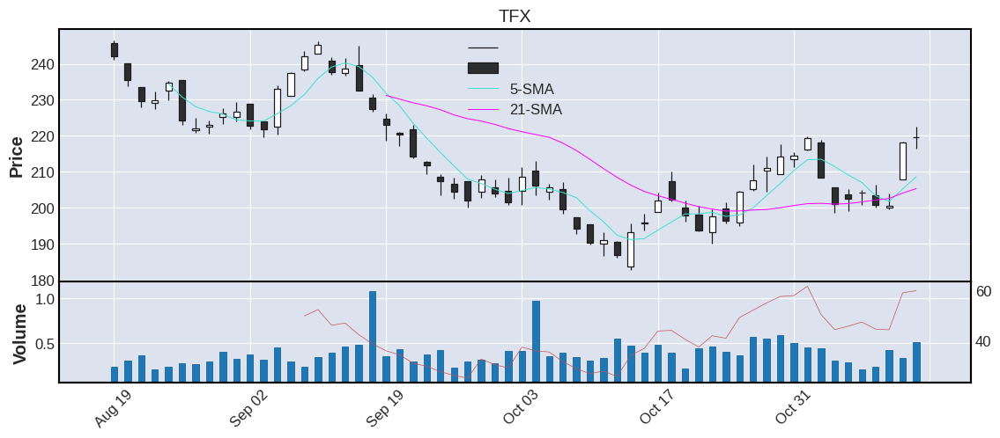



   TICKER    CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
32    PFE  47.6  60.1  17.95   18.43  0.46  1.11  2.33  Health_Care  0.0  United States     mega


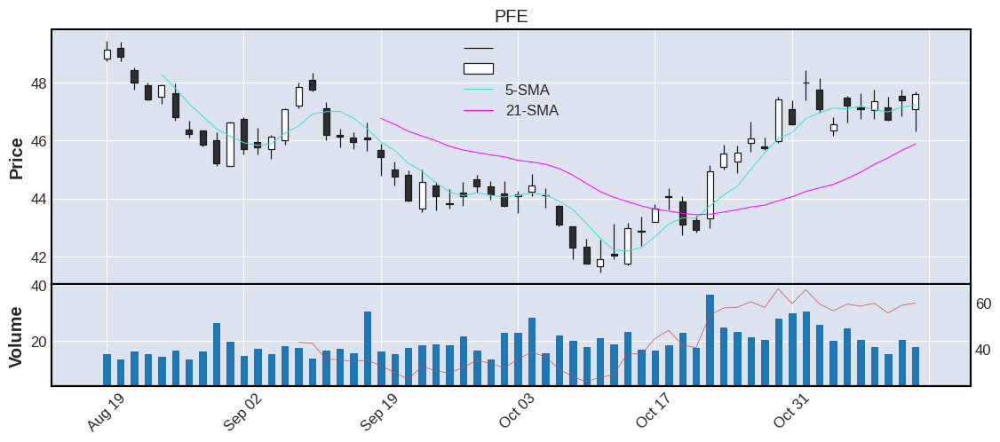



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
33     MO  44.38  46.75  9.82    8.53  0.36  1.02   2.3  Health_Care  0.0  United States    large


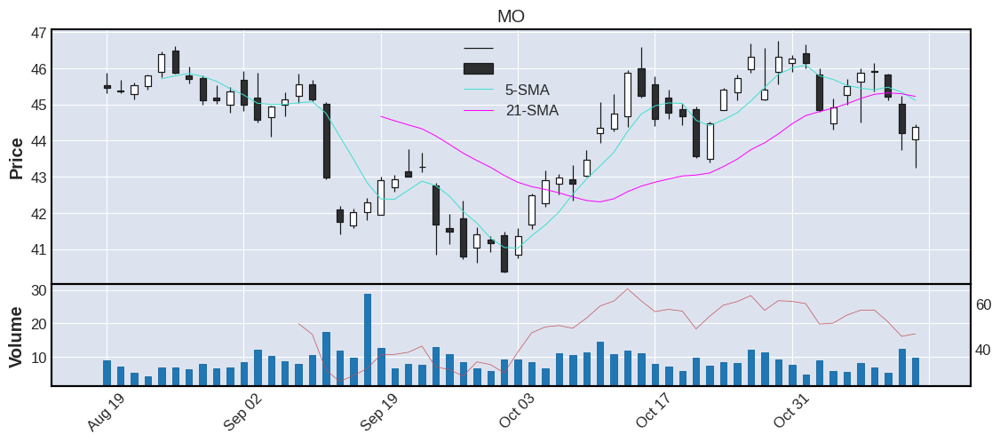



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
34   ABMD  373.99  78.72  1.65    2.18  0.32  12.0  3.21  Health_Care  0.0  United States    large


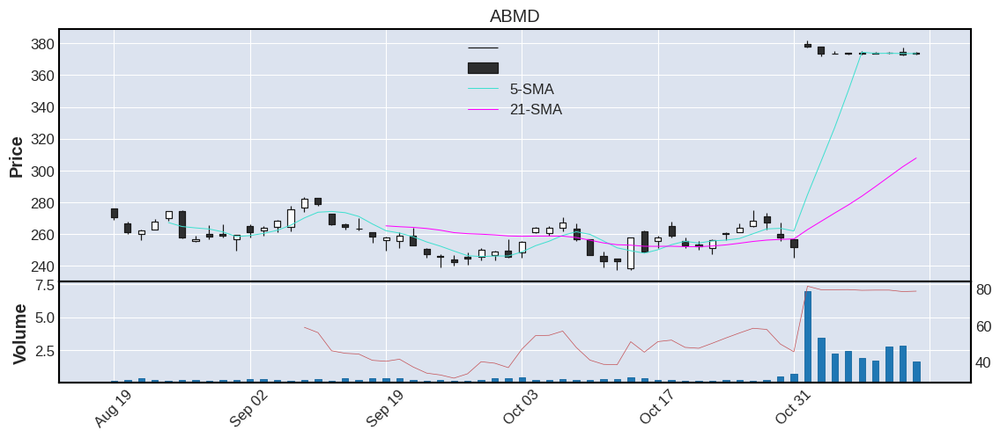



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
35   ABBV  150.16  59.1  5.59    4.94  0.29  3.74  2.49  Health_Care  2012.0  United States     mega


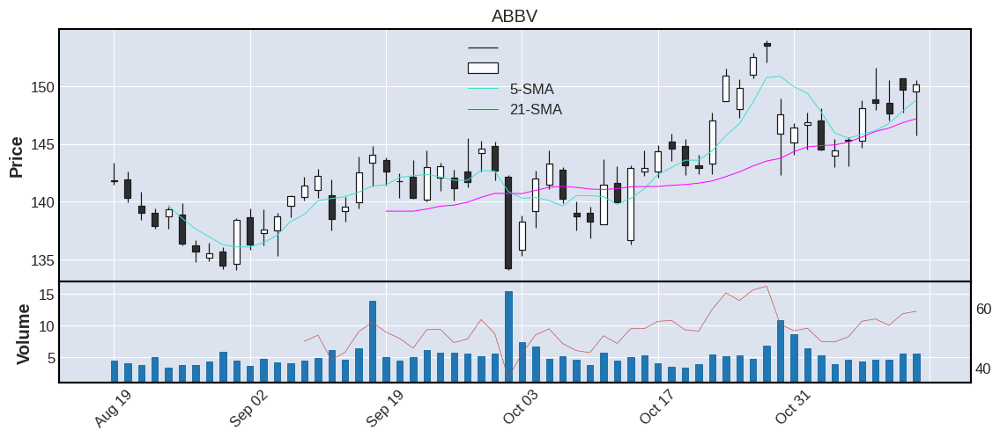



   TICKER      CP    RSI   VOL  AVGVOL %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
36    WAT  331.85  71.08  0.31    0.37  0.0  10.81  3.26  Health_Care  1995.0  United States    large


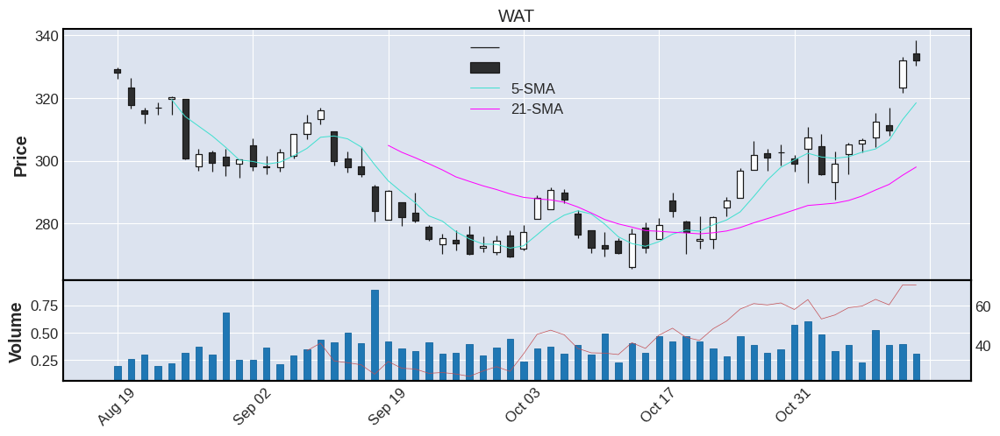



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
37    ABT  104.09  60.11  5.78    5.53 -0.13  2.72  2.61  Health_Care  0.0  United States    large


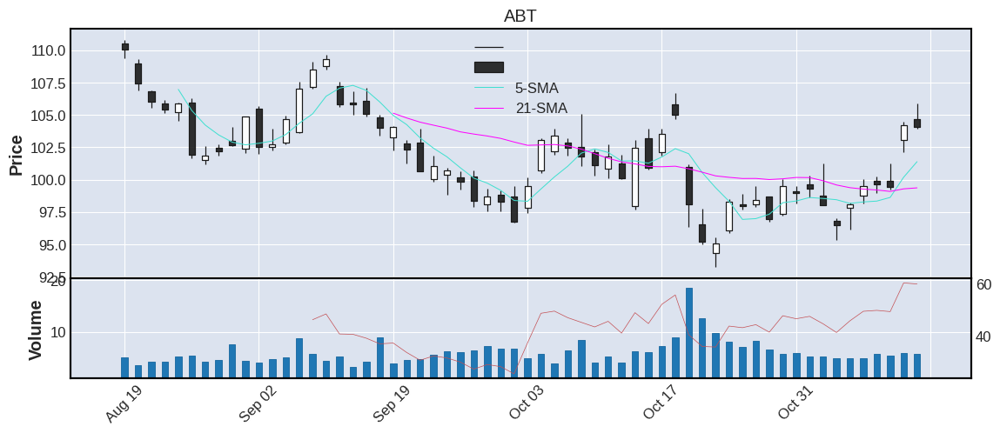



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
38   INCY  77.53  67.5  1.18    1.49 -0.32  2.15  2.77  Health_Care  0.0  United States    large


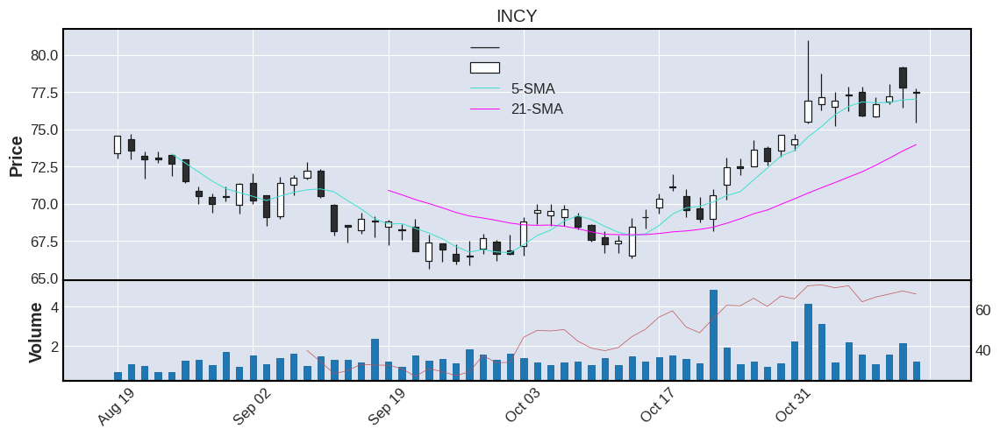



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
39   BIIB  289.45  66.98  1.23    1.24 -0.43  8.12  2.81  Health_Care  0.0  United States    large


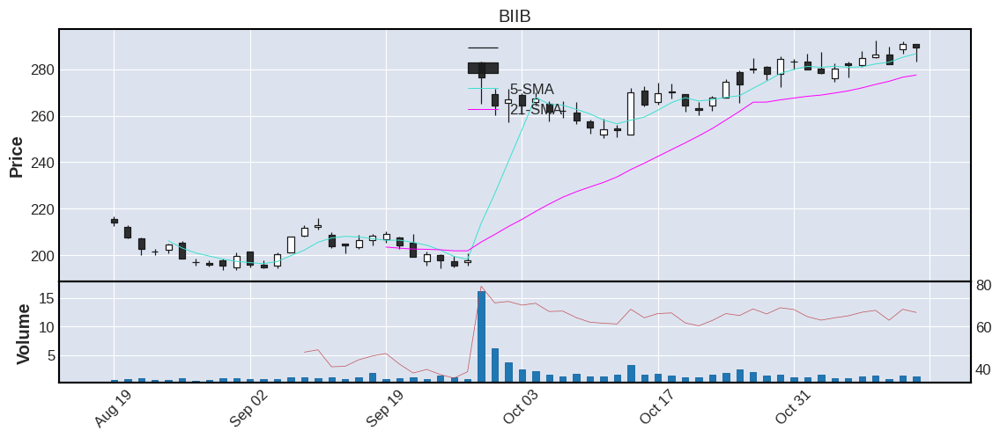



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
40    BDX  227.67  49.46  1.79    2.55 -0.7  5.35  2.35  Health_Care  0.0  United States    large


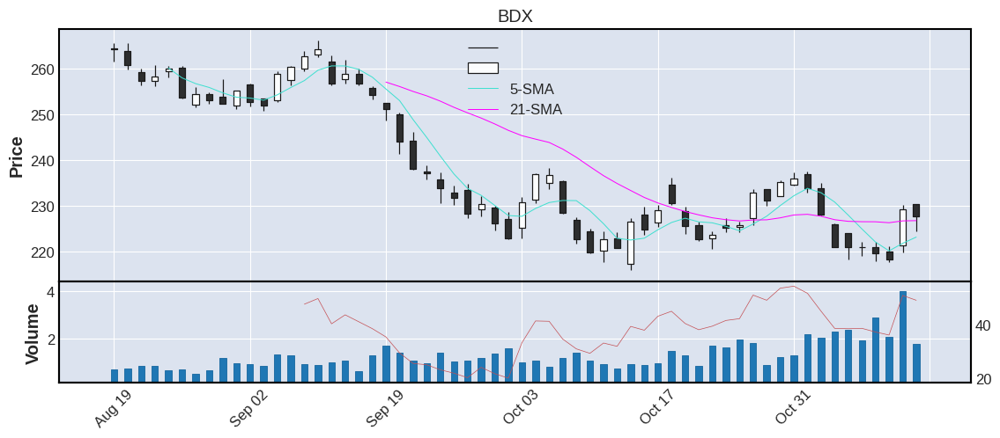



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
41   REGN  734.45  51.1  0.95    0.87 -0.89  25.0   3.4  Health_Care  1991.0  United States    large


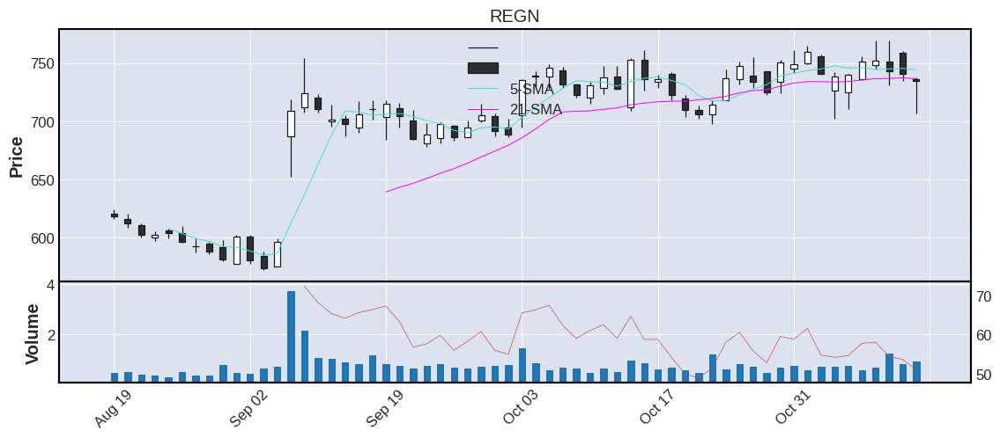



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
42   GILD  81.82  76.28  11.41    9.89 -0.94  2.26  2.76  Health_Care  1992.0  United States    large


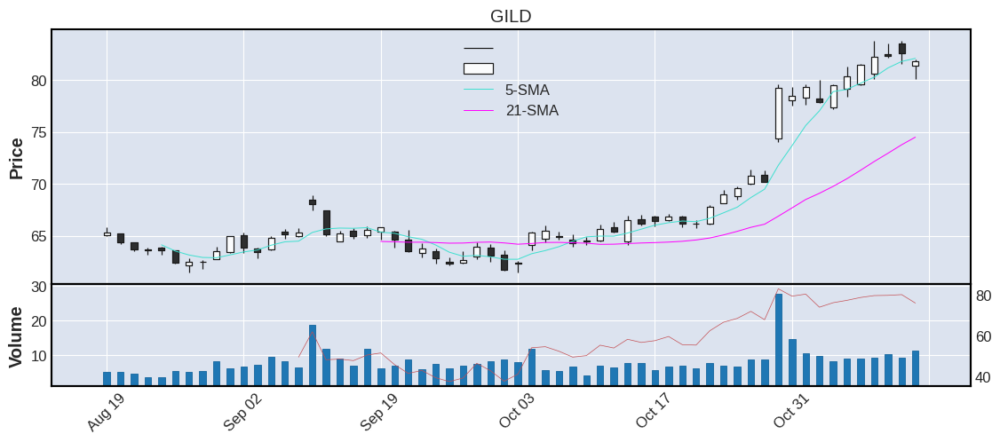



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
43    DGX  151.03  72.08  1.44    1.23 -0.95  4.25  2.81  Health_Care  0.0  United States    large


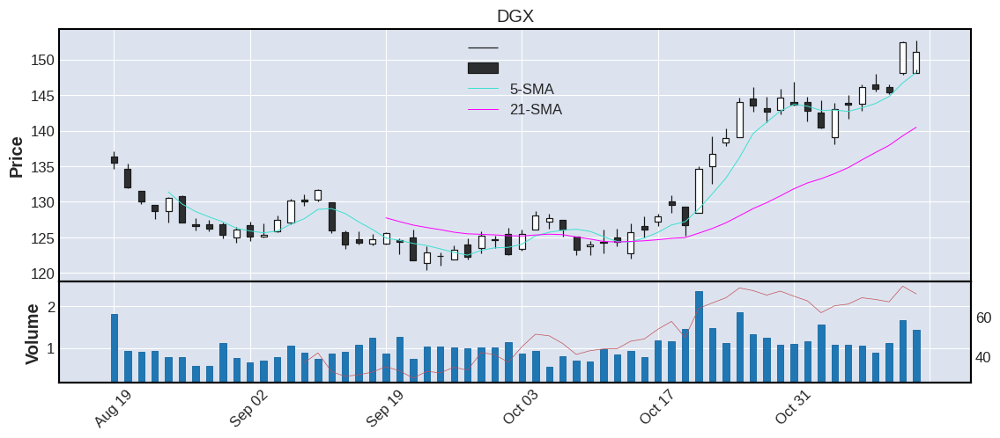



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
44    RMD  223.03  53.13  0.49    0.49 -0.95  7.86  3.52  Health_Care  0.0  United States    large


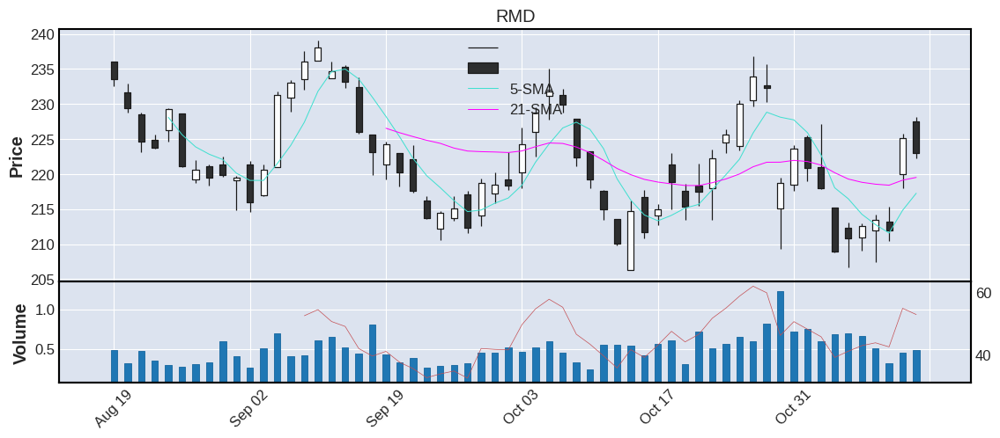



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
45    ABC  153.01  52.04  2.94    3.79 -1.28  4.81  3.14  Health_Care  0.0  United States    large


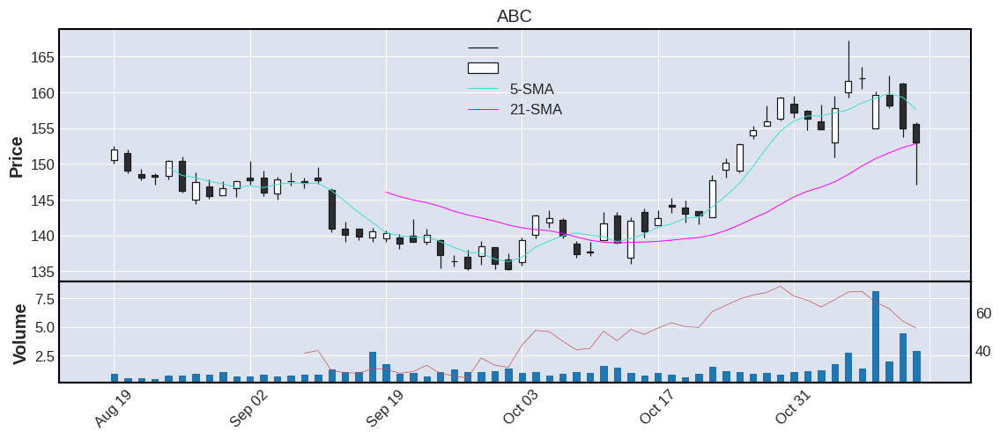



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
46   AMGN  285.02  67.89  3.25    4.13 -2.06  7.44  2.61  Health_Care  1983.0  United States    large


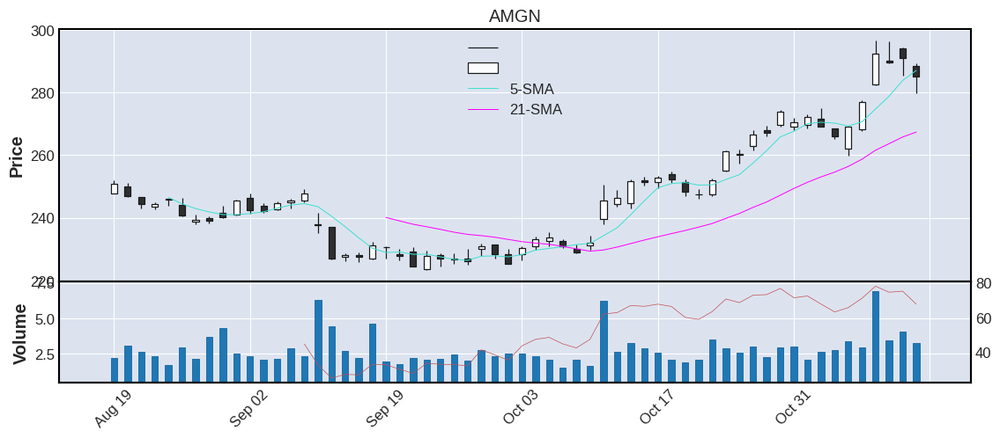



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
47    CVS  97.55  53.16  9.17    6.36 -2.36  2.67  2.74  Health_Care  0.0  United States    large


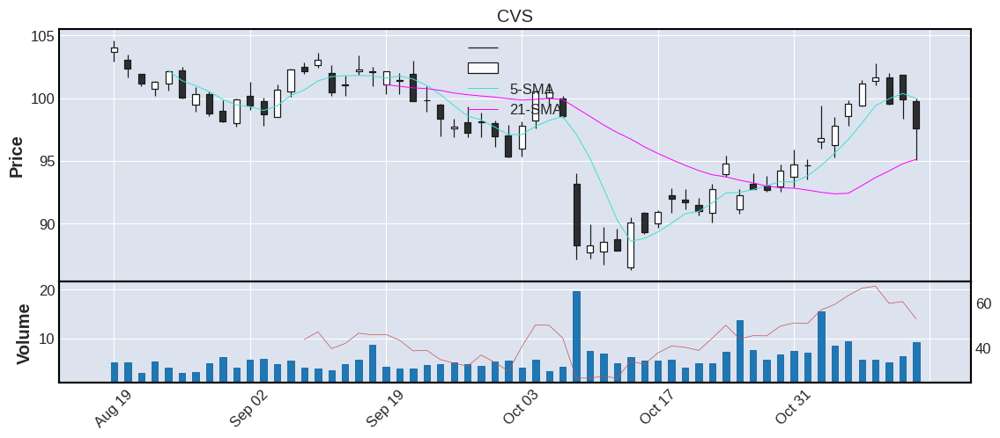



   TICKER      CP    RSI   VOL  AVGVOL %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
48   VRTX  303.26  50.15  2.12    1.69 -2.5  11.57  3.82  Health_Care  1991.0  United States    large


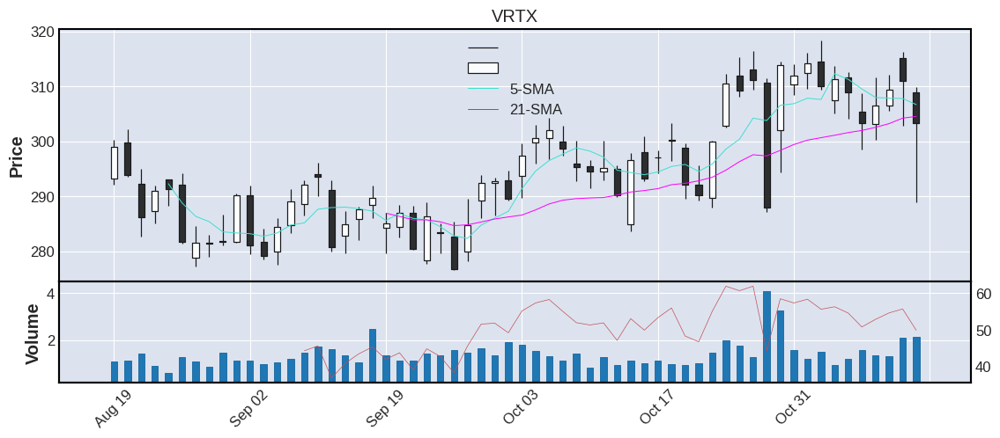



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
49    CNC  82.07  50.14  5.82    4.08 -2.8  2.82  3.44  Health_Care  0.0  United States    large


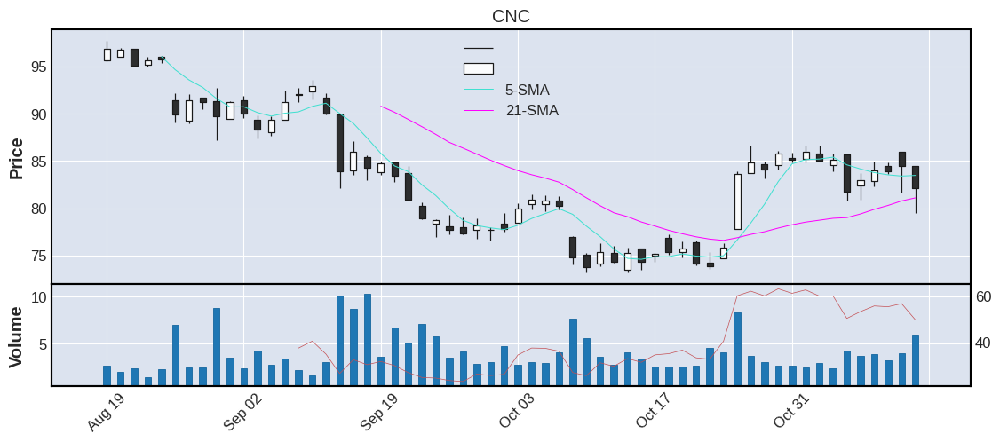



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
50    BSX  42.52  56.26  10.47    7.09 -2.83  1.19   2.8  Health_Care  0.0  United States    large


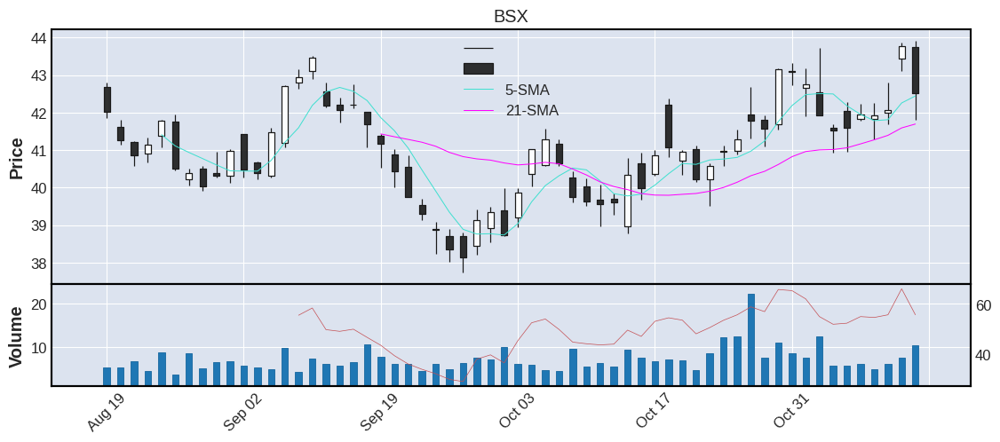



================================================== SECTOR 3: CONSUMER_DISCRETIONARY [ %CHG ] ================================================== 

    TICKER       CP    RSI     VOL  AVGVOL   %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
1    PARA    18.81  52.59   29.49   18.24  13.52   1.15  6.11  Consumer_Discretionary     0.0  United States    large
2     VFC    33.34  62.91   10.06    6.18  11.39   1.53  4.59  Consumer_Discretionary     0.0  United States    large
3      RL   104.38  65.71    2.30    1.43   9.36   4.49  4.30  Consumer_Discretionary  1997.0  United States   medium
4     TPR    35.37  64.56    4.67    4.62    8.7   1.65  4.66  Consumer_Discretionary     0.0  United States   medium
5    WYNN    77.98  68.82    6.26    4.50   8.31   3.89  4.99  Consumer_Discretionary  2002.0  United States   medium
6     MHK   109.80  66.93    1.01    0.68   7.18   4.69  4.27  Consumer_Discretionary     0.0  United States   medium
7     NKE   106.09  67.45

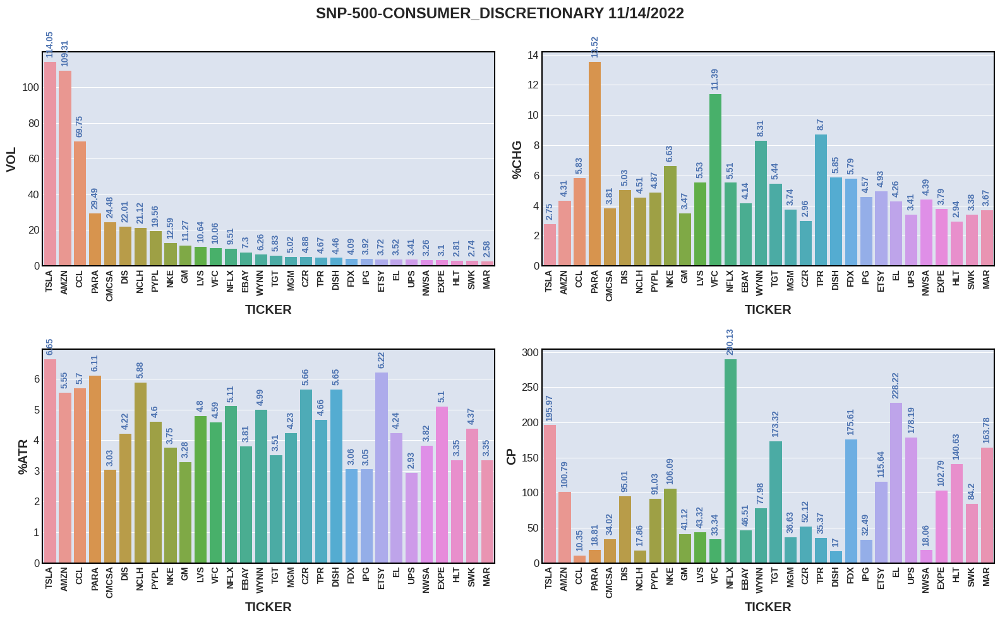

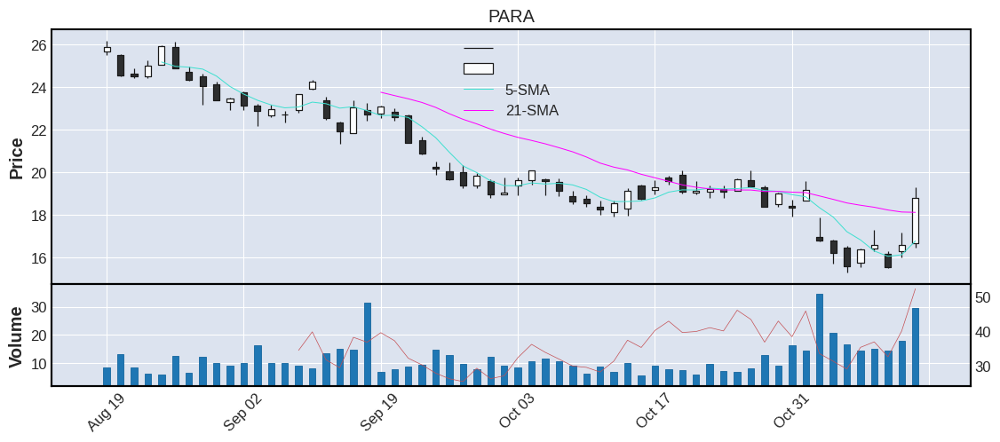



  TICKER     CP    RSI    VOL  AVGVOL   %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
2    VFC  33.34  62.91  10.06    6.18  11.39  1.53  4.59  Consumer_Discretionary  0.0  United States    large


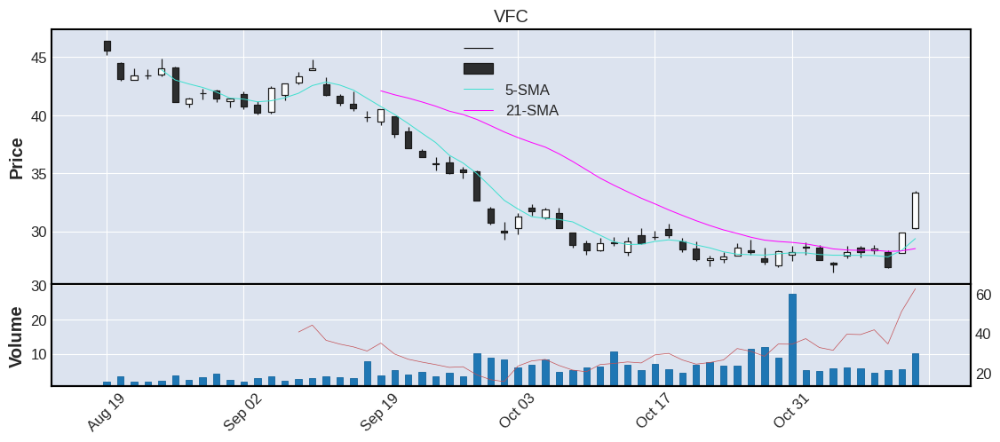



  TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
3     RL  104.38  65.71  2.3    1.43  9.36  4.49   4.3  Consumer_Discretionary  1997.0  United States   medium


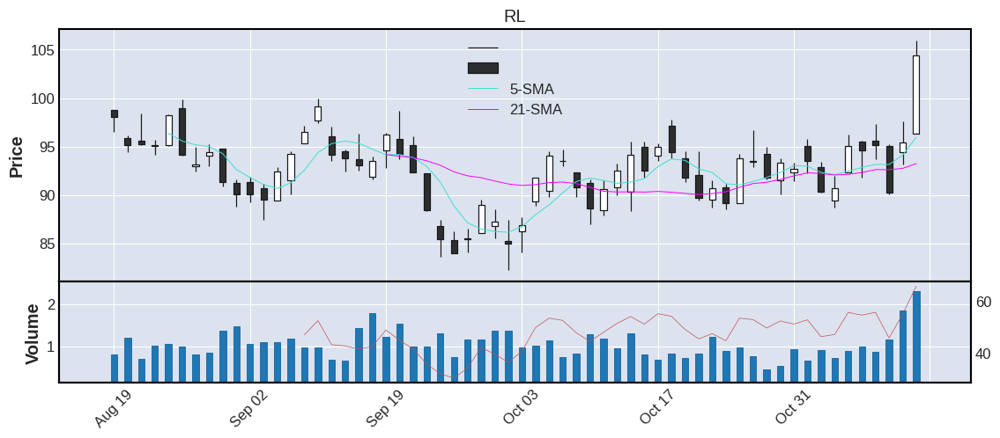



  TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
4    TPR  35.37  64.56  4.67    4.62  8.7  1.65  4.66  Consumer_Discretionary  0.0  United States   medium


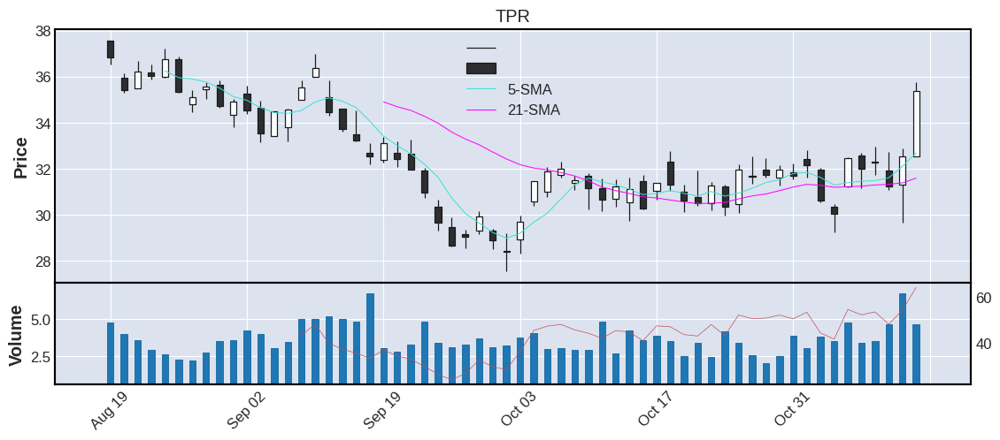



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
5   WYNN  77.98  68.82  6.26     4.5  8.31  3.89  4.99  Consumer_Discretionary  2002.0  United States   medium


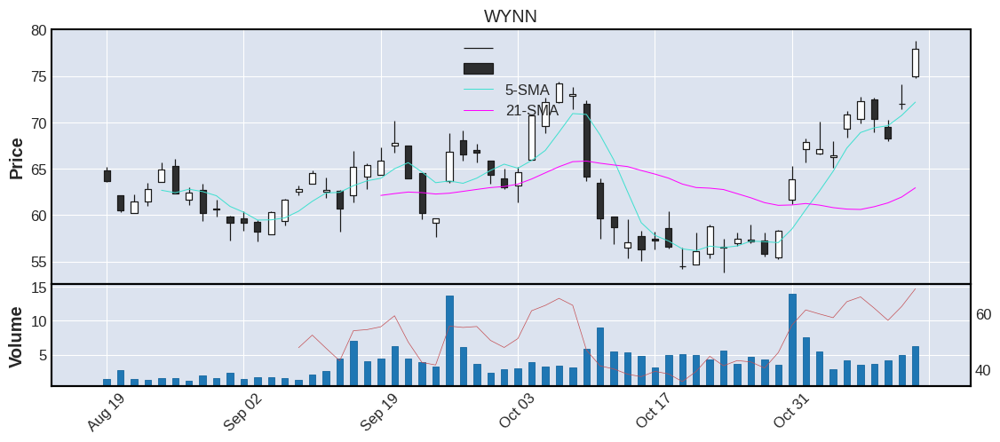



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
6    MHK  109.8  66.93  1.01    0.68  7.18  4.69  4.27  Consumer_Discretionary  0.0  United States   medium


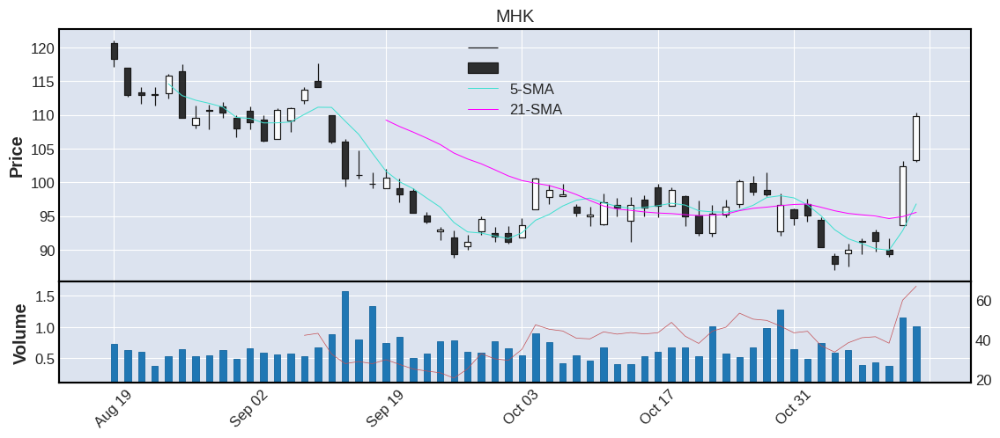



  TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
7    NKE  106.09  67.45  12.59    8.92  6.63  3.98  3.75  Consumer_Discretionary  0.0  United States    large


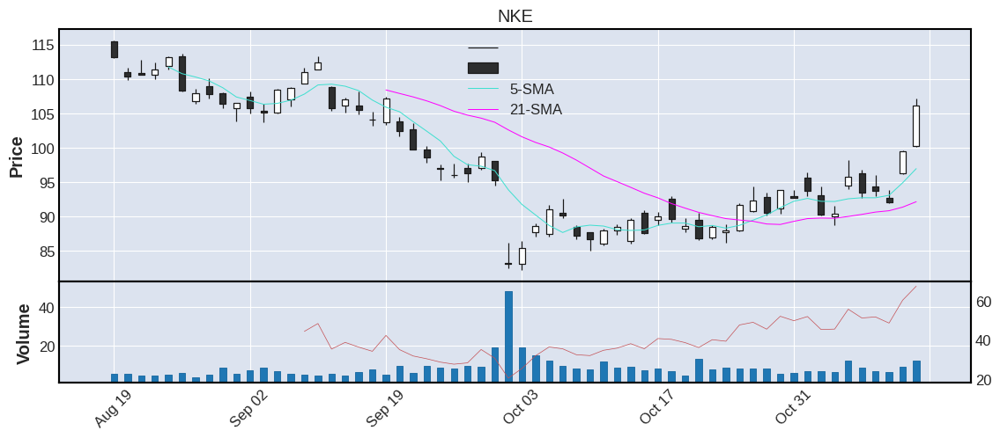



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
8   DISH  17.0  62.12  4.46    6.11  5.85  0.96  5.65  Consumer_Discretionary  1995.0  United States   medium


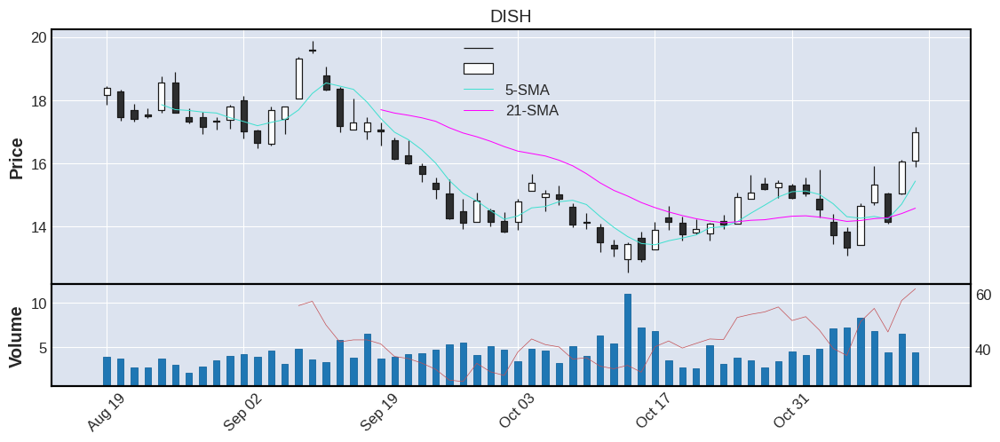



  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
9    CCL  10.35  66.24  69.75   59.13  5.83  0.59   5.7  Consumer_Discretionary  1987.0  United States    large


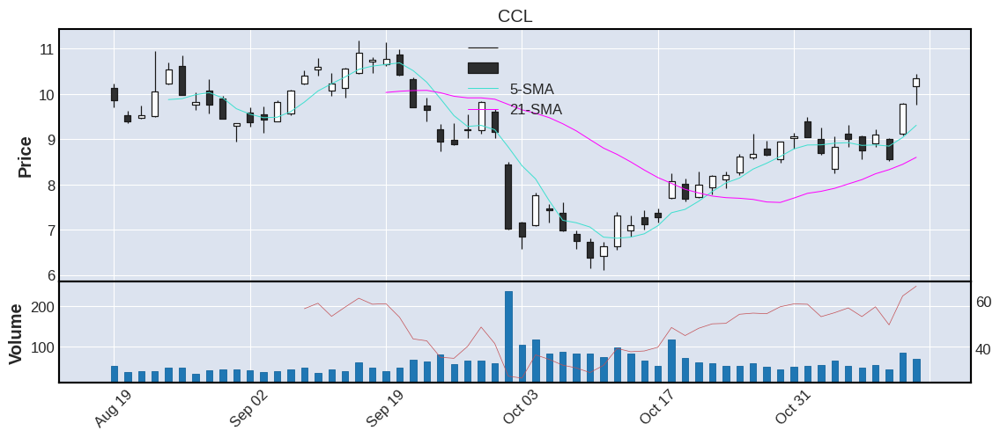



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
10    FDX  175.61  68.06  4.09    3.09  5.79  5.37  3.06  Consumer_Discretionary  0.0  United States    large


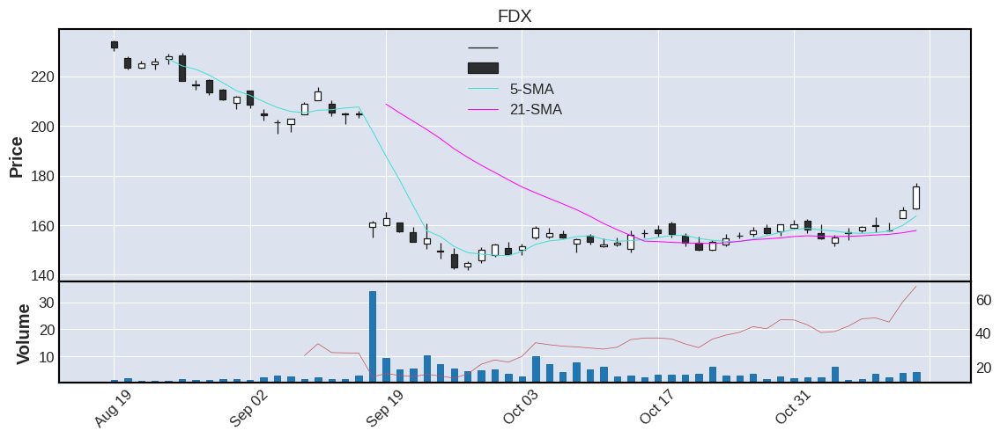



   TICKER     CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
11   CHTR  394.4  69.13  1.49    1.25  5.69  15.44  3.91  Consumer_Discretionary  0.0  United States    large


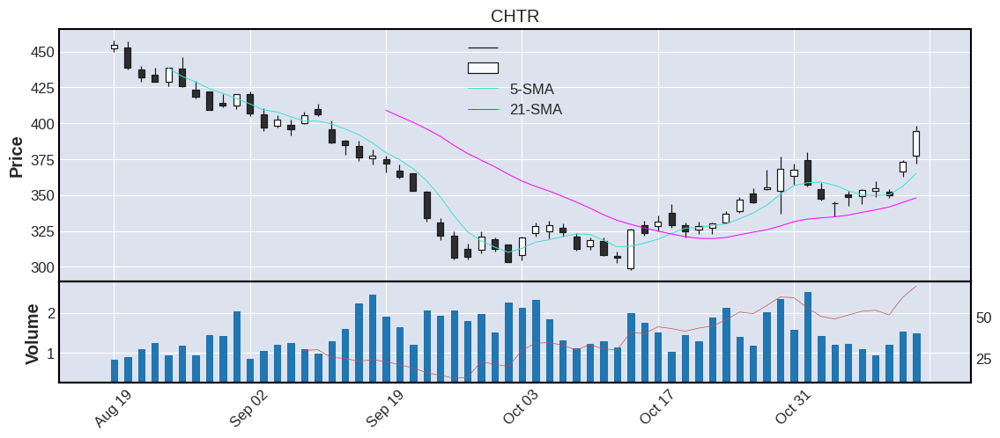



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
12    KMX  74.58  66.48  2.29    2.63  5.56  3.46  4.64  Consumer_Discretionary  0.0  United States   medium


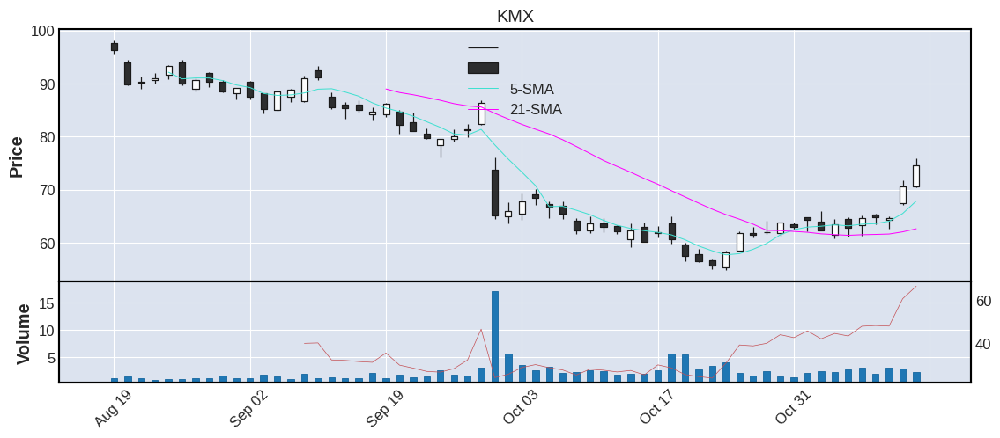



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
13    LVS  43.32  66.28  10.64    5.93  5.53  2.08   4.8  Consumer_Discretionary  2004.0  United States    large


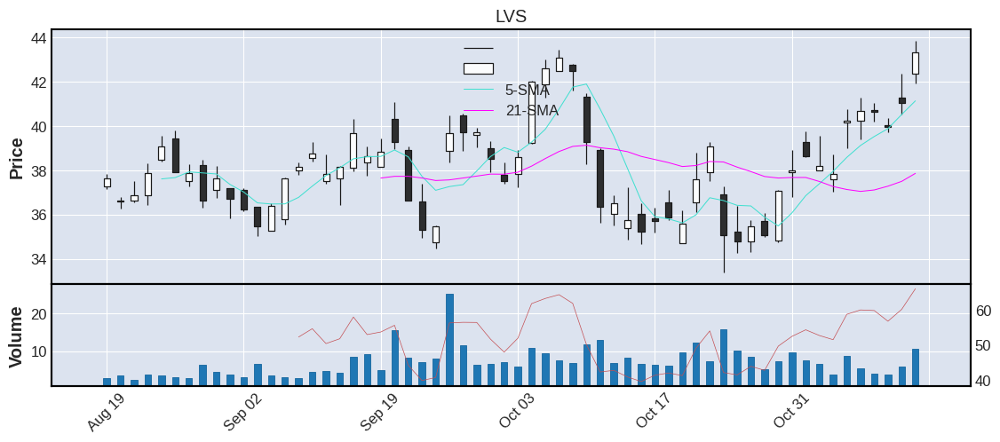



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
14   NFLX  290.13  61.1  9.51    8.41  5.51  14.83  5.11  Consumer_Discretionary  2002.0  United States    large


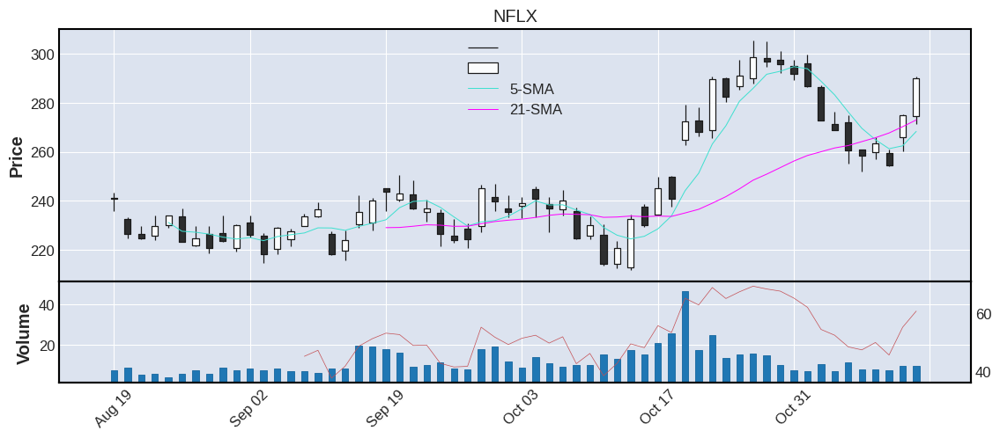



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
15    TGT  173.32  63.42  5.83     4.1  5.44  6.08  3.51  Consumer_Discretionary  0.0  United States    large


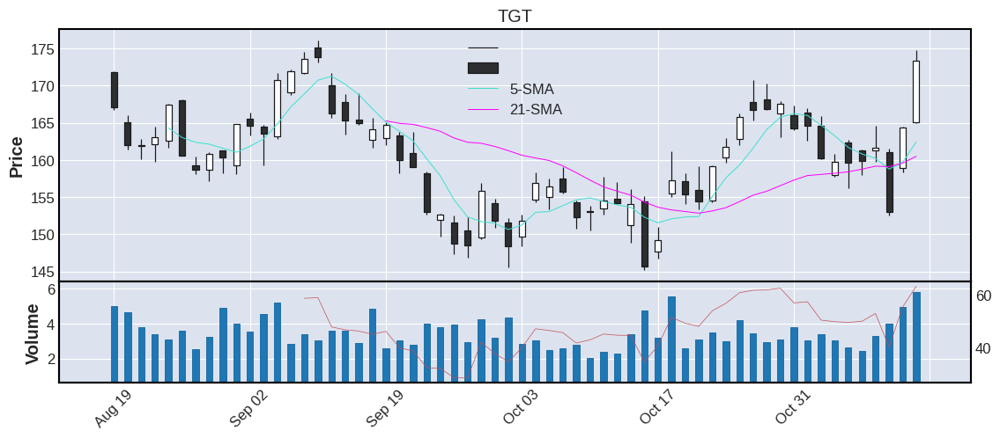



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
16    DIS  95.01  43.39  22.01    31.9  5.03  4.01  4.22  Consumer_Discretionary  0.0  United States    large


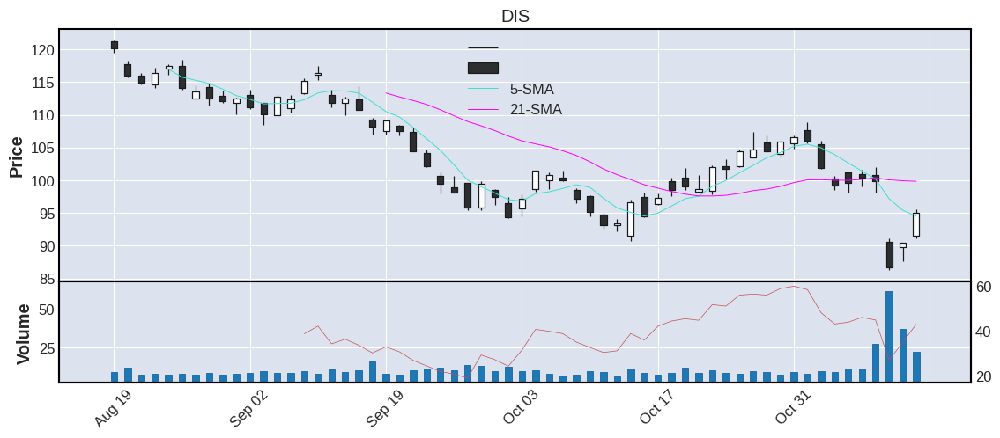



   TICKER     CP   RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
17    HAS  63.41  45.4  1.36    1.57  5.0  2.28   3.6  Consumer_Discretionary  0.0  United States   medium


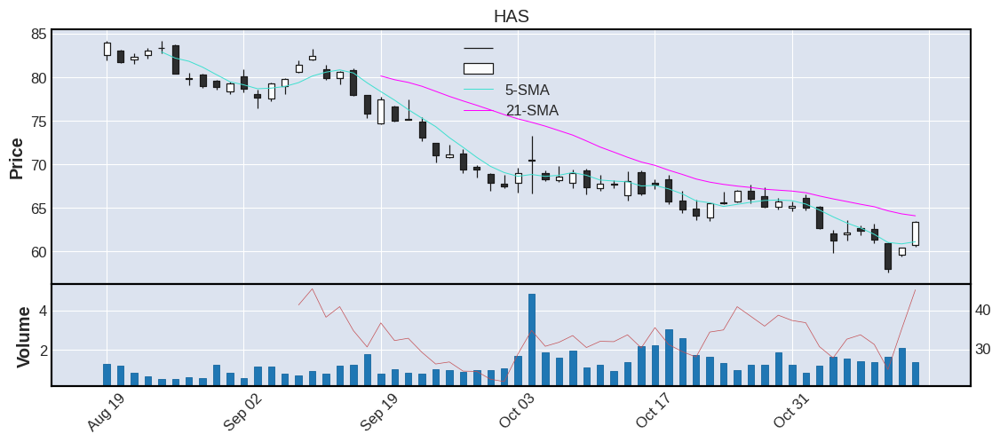



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
18   ETSY  115.64  62.19  3.72    3.37  4.93  7.19  6.22  Consumer_Discretionary  2015.0  United States    large


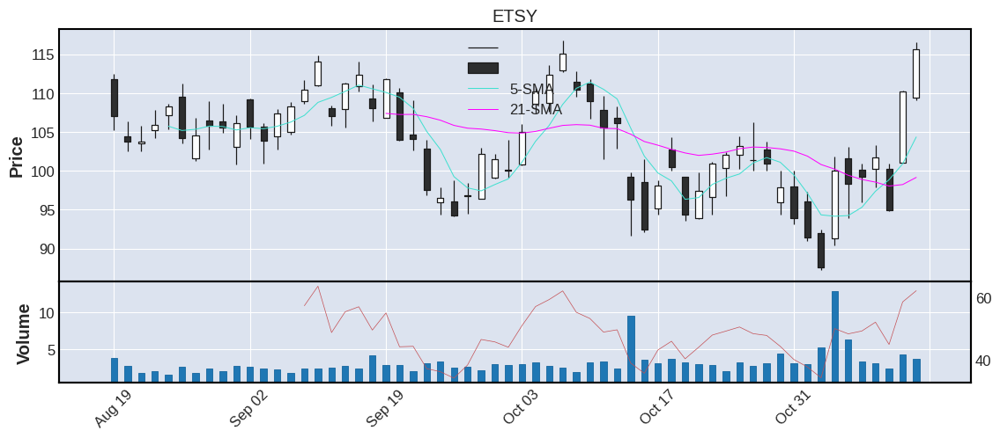



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
19   PYPL  91.03  59.38  19.56   18.31  4.87  4.19   4.6  Consumer_Discretionary  0.0  United States    large


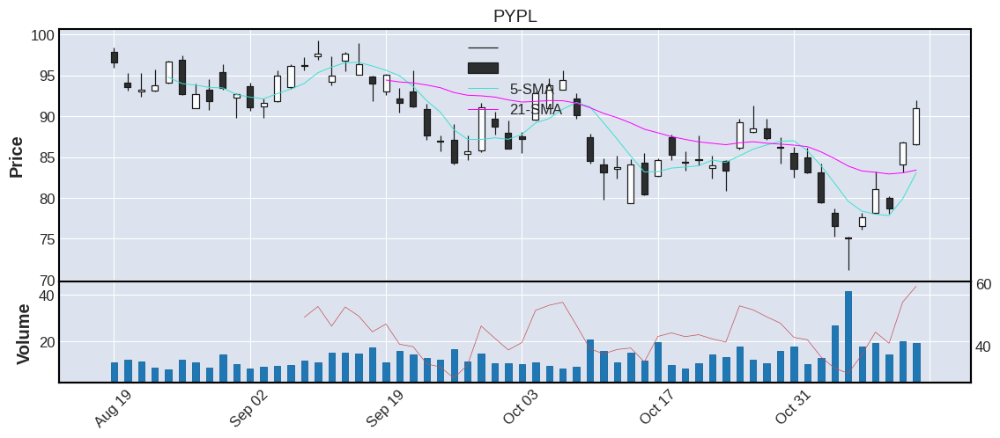



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
20    WHR  156.58  65.73  0.87     0.9  4.63  6.22  3.97  Consumer_Discretionary  0.0  United States   medium


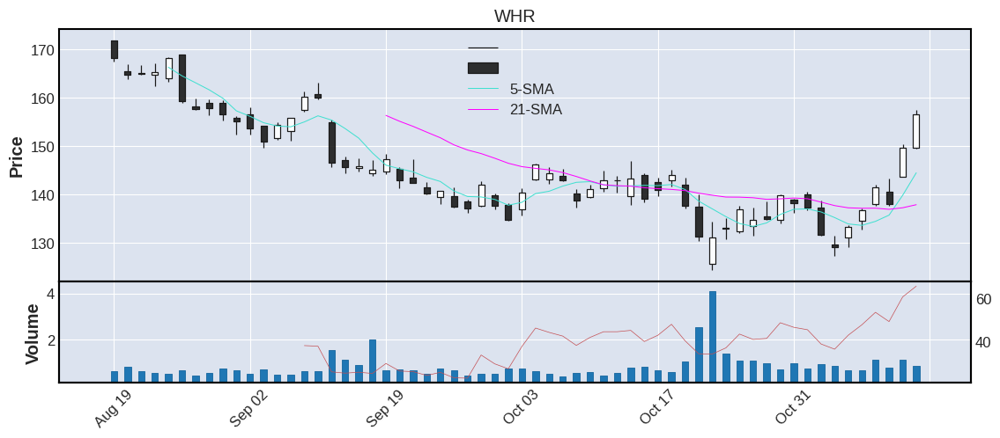



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
21    NWS  18.29  64.02  0.87    1.57  4.63  0.68  3.72  Consumer_Discretionary  0.0  United States   medium


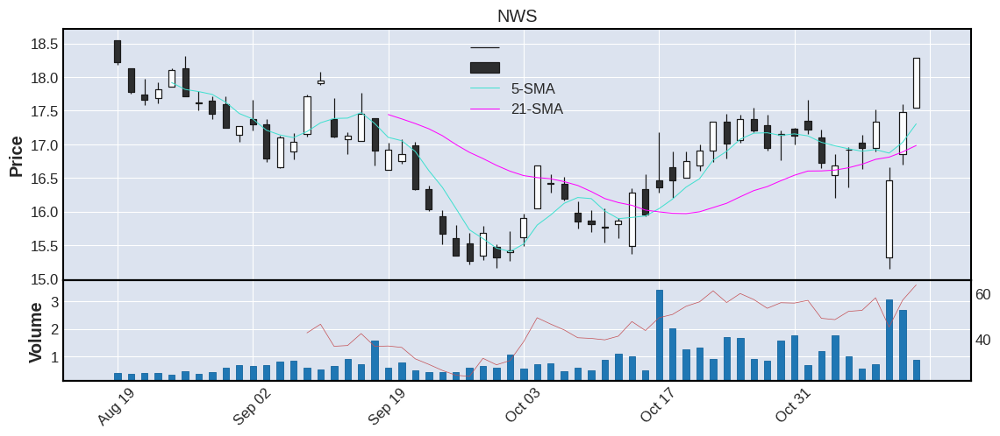



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
22   CHRW  98.26  56.05  1.92    1.73  4.61  3.23  3.29  Consumer_Discretionary  1997.0  United States    large


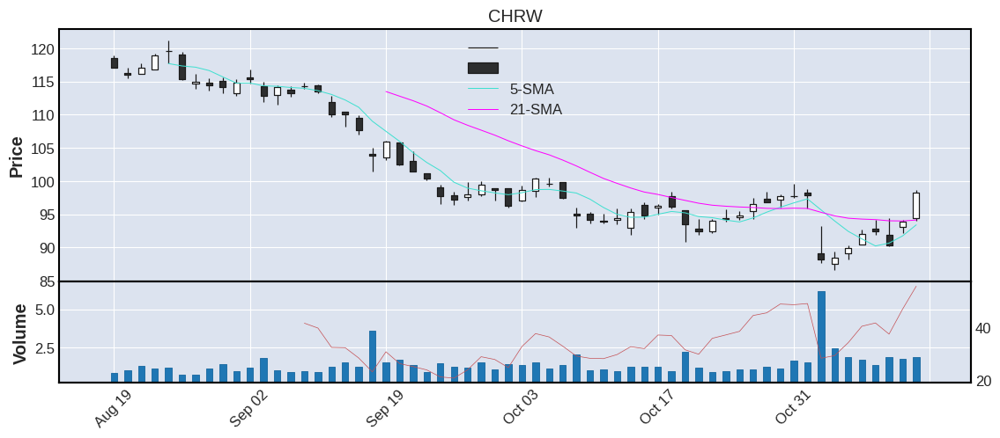



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
23    IPG  32.49  70.54  3.92    3.71  4.57  0.99  3.05  Consumer_Discretionary  0.0  United States    large


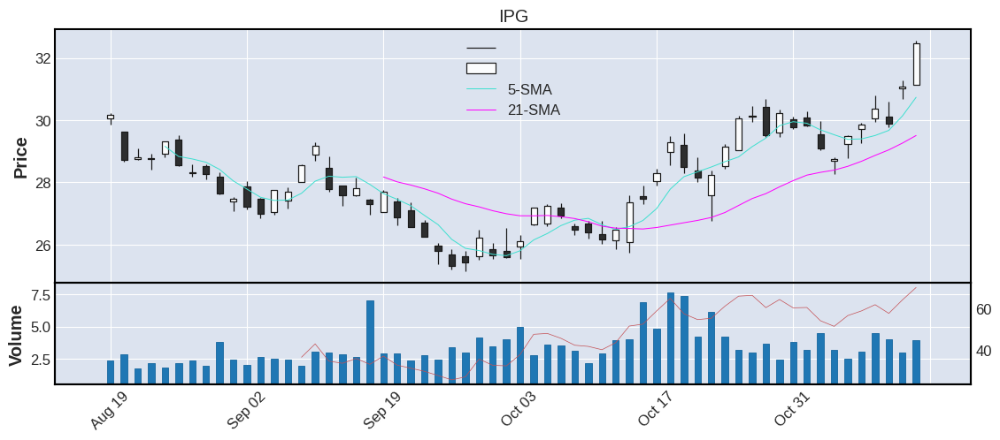



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
24   NCLH  17.86  64.75  21.12   24.96  4.51  1.05  5.88  Consumer_Discretionary  0.0  United States   medium


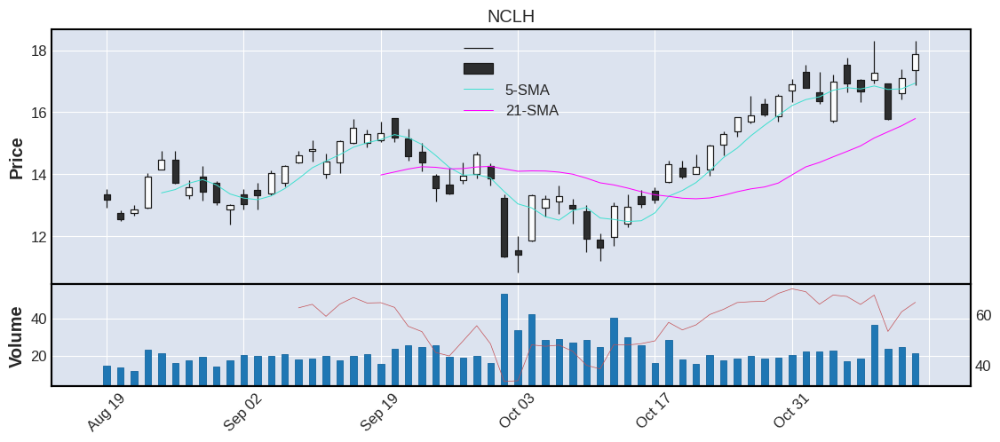



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
25   NWSA  18.06  63.96  3.26    4.58  4.39  0.69  3.82  Consumer_Discretionary  0.0  United States   medium


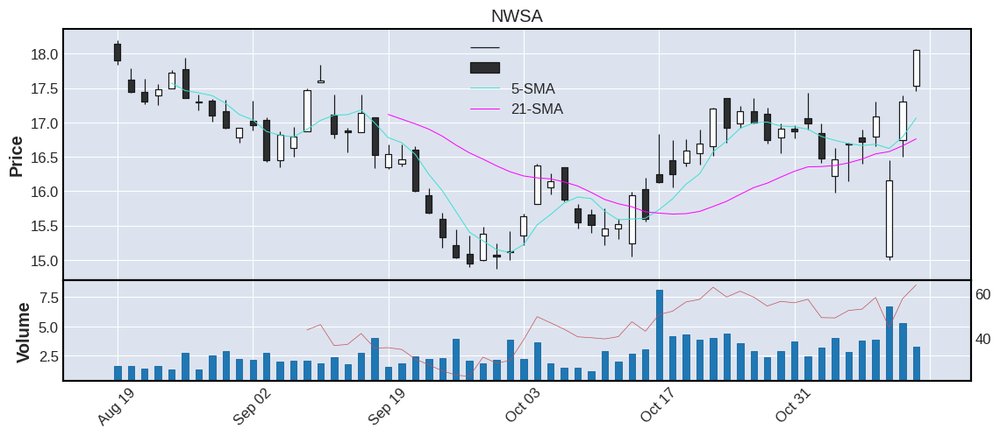



   TICKER      CP    RSI     VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
26   AMZN  100.79  45.87  109.31  107.94  4.31  5.59  5.55  Consumer_Discretionary  1997.0  United States     mega


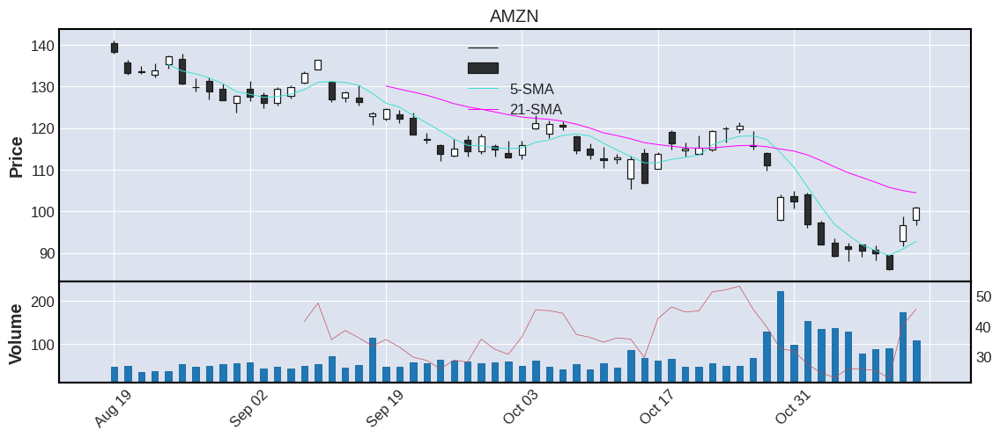



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
27     EL  228.22  60.0  3.52     2.4  4.26  9.68  4.24  Consumer_Discretionary  1995.0  United States    large


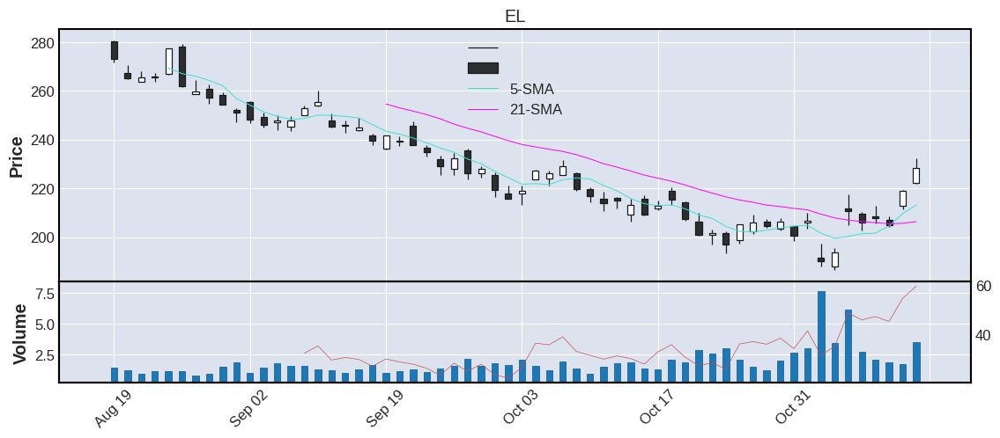



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
28    PPG  130.09  69.67  2.07    1.37  4.23  4.2  3.23  Consumer_Discretionary  0.0  United States    large


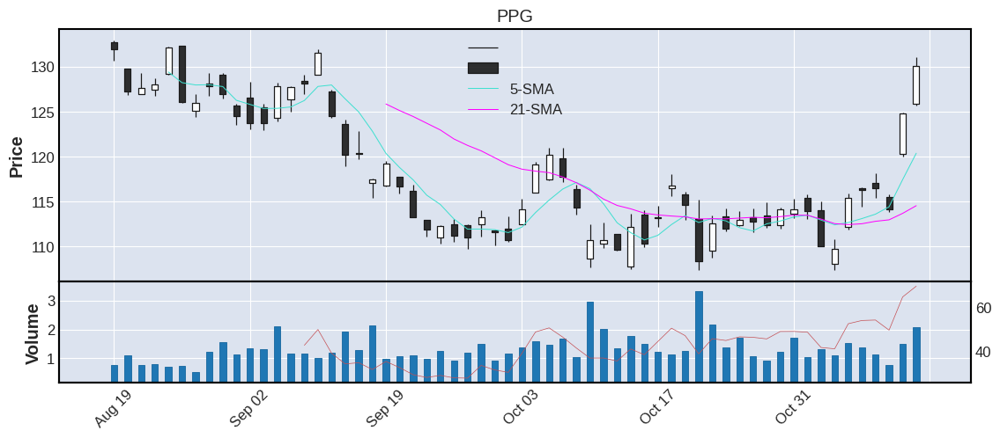



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
29   EBAY  46.51  73.07  7.3    6.97  4.14  1.77  3.81  Consumer_Discretionary  1998.0  United States    large


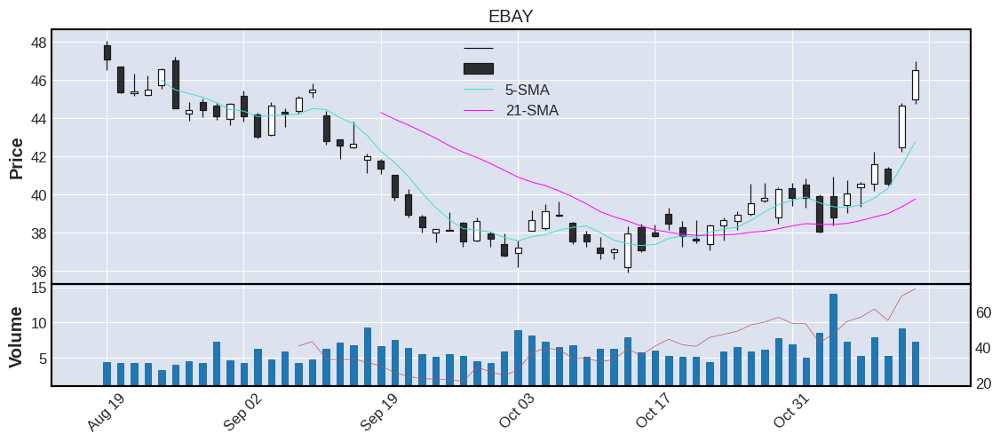



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
30  CMCSA  34.02  65.82  24.48   25.08  3.81  1.03  3.03  Consumer_Discretionary  0.0  United States    large


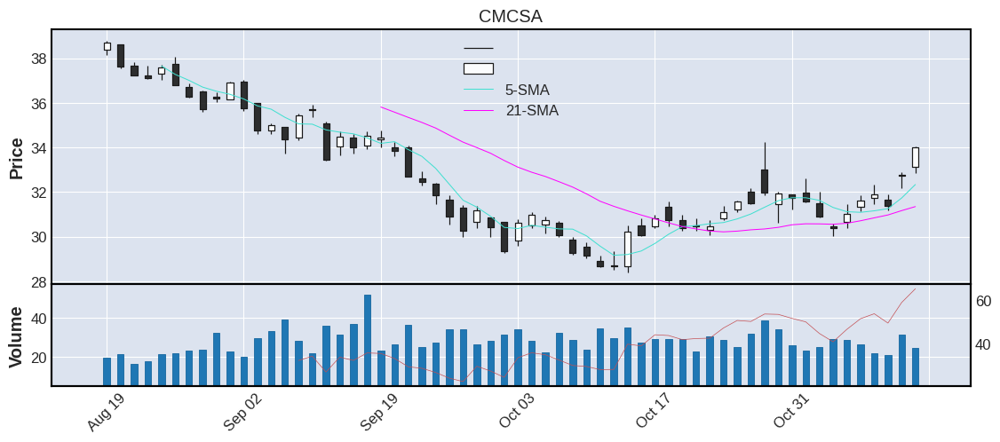



   TICKER      CP   RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
31   GNRC  114.08  41.6  2.06    2.65  3.8  9.01   7.9  Consumer_Discretionary  2010.0  United States   medium


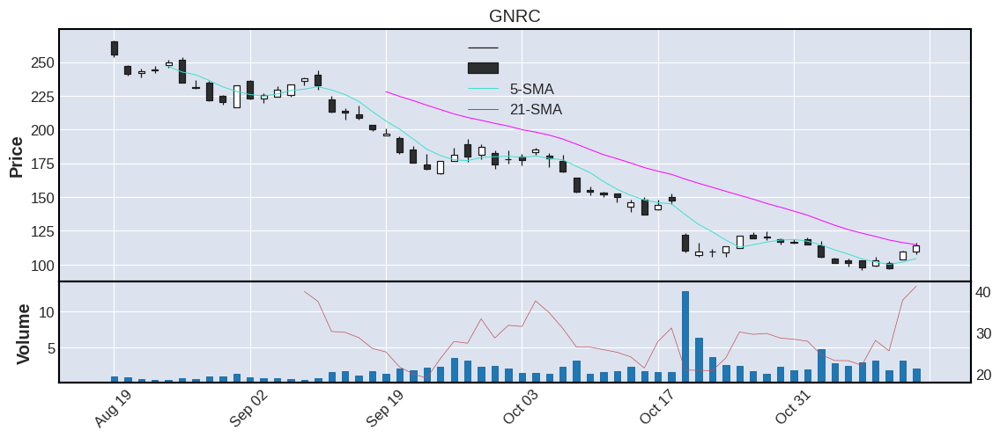



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
32   EXPE  102.79  60.05  3.1    3.13  3.79  5.24   5.1  Consumer_Discretionary  0.0  United States    large


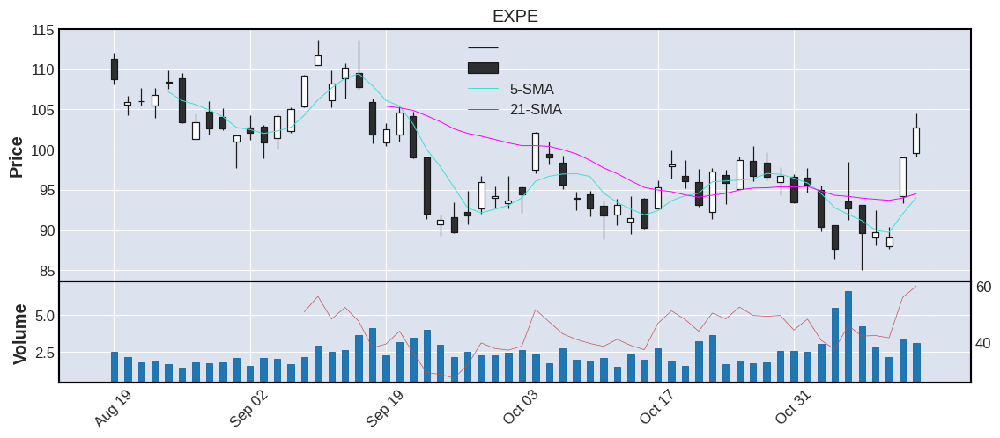



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
33    MGM  36.63  61.3  5.02    5.53  3.74  1.55  4.23  Consumer_Discretionary  0.0  United States    large


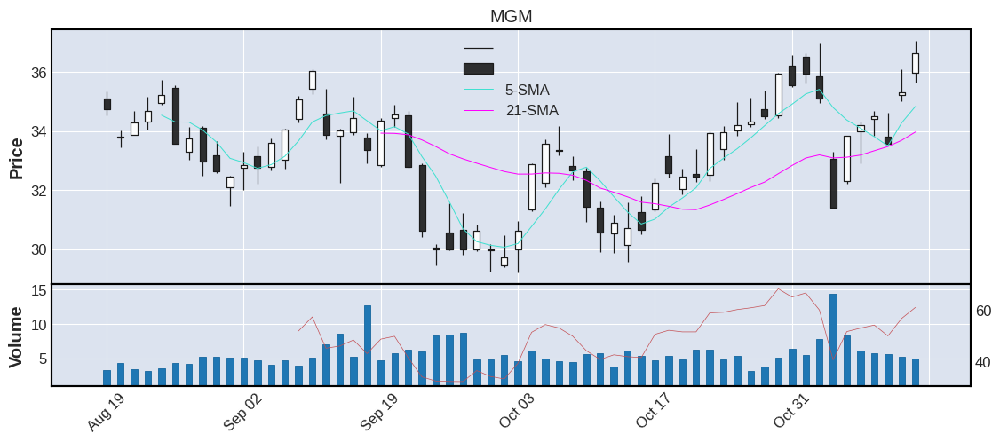



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
34    MAR  163.78  64.78  2.58    2.19  3.67  5.48  3.35  Consumer_Discretionary  0.0  United States    large


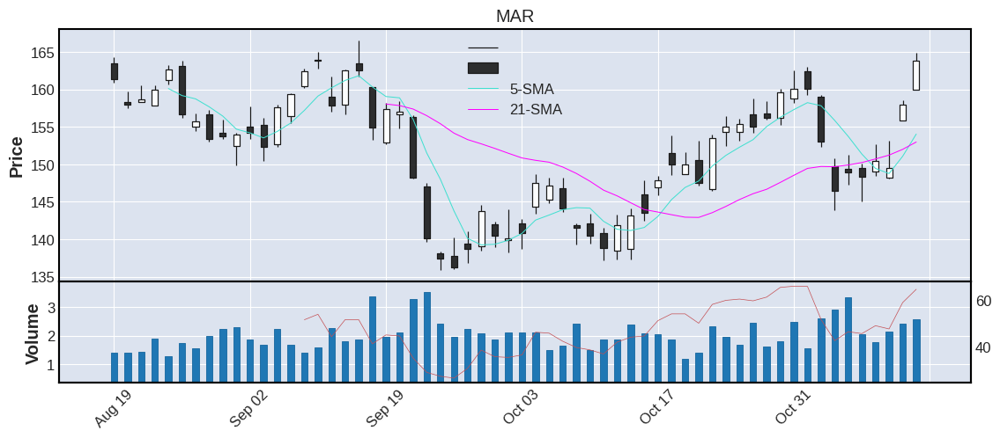



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
35    CRL  246.28  71.4  1.07    0.73  3.61  10.98  4.46  Consumer_Discretionary  2000.0  United States    large


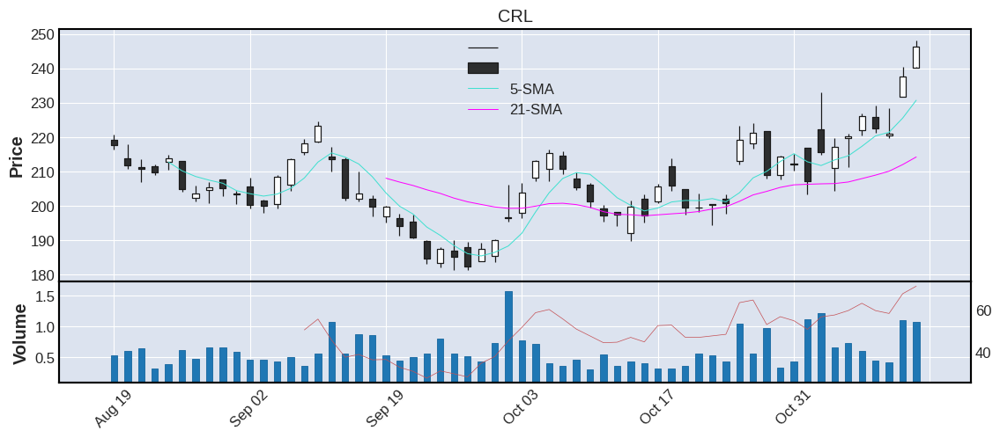



   TICKER       CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
36   BKNG  2015.77  66.91  0.44    0.41  3.56  74.43  3.69  Consumer_Discretionary  0.0  United States    large


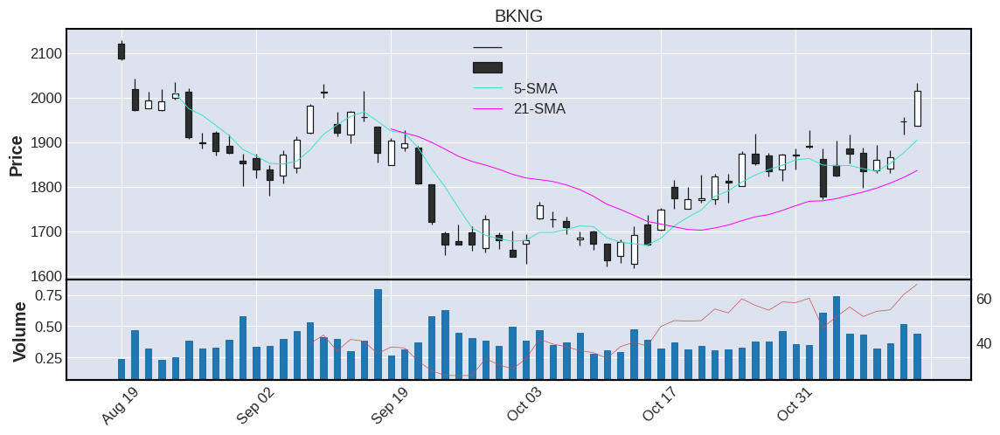



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
37    BWA  42.42  77.28  2.05    2.03  3.54  1.25  2.95  Consumer_Discretionary  0.0  United States   medium


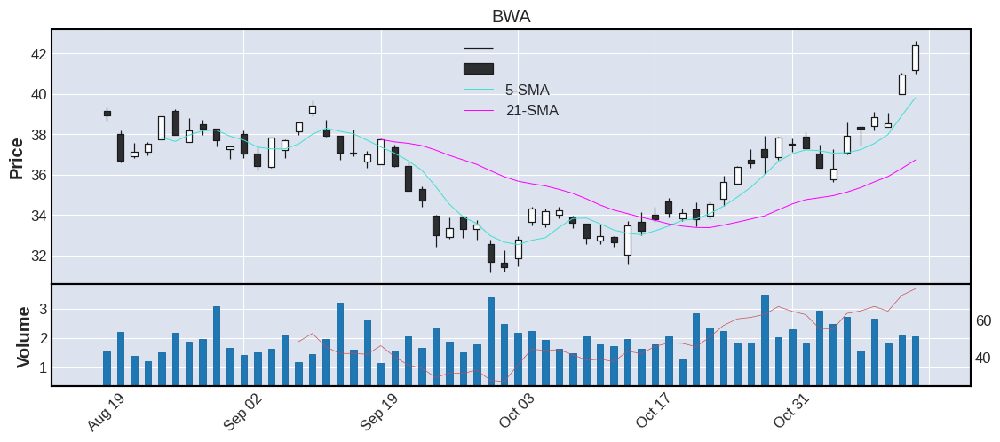



   TICKER     CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
38    BBY  74.55  66.91  2.4    2.22  3.5  2.75  3.69  Consumer_Discretionary  0.0  United States    large


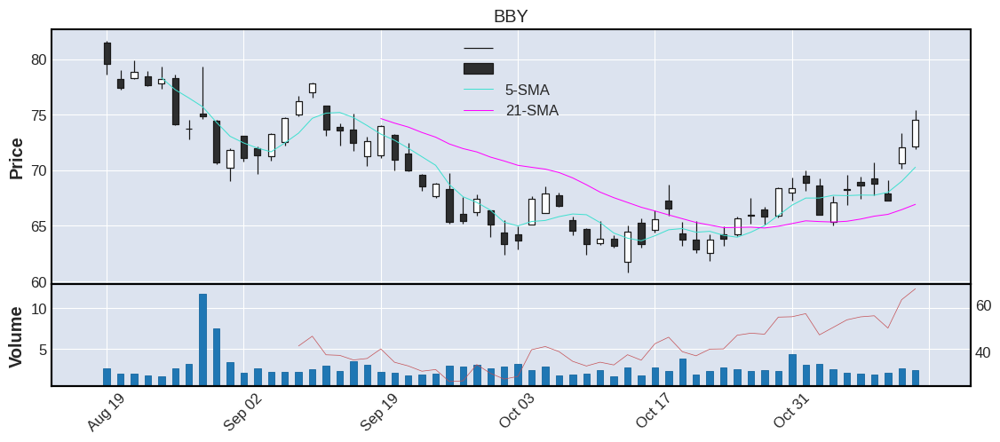



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
39     GM  41.12  67.88  11.27   12.89  3.47  1.35  3.28  Consumer_Discretionary  2010.0  United States    large


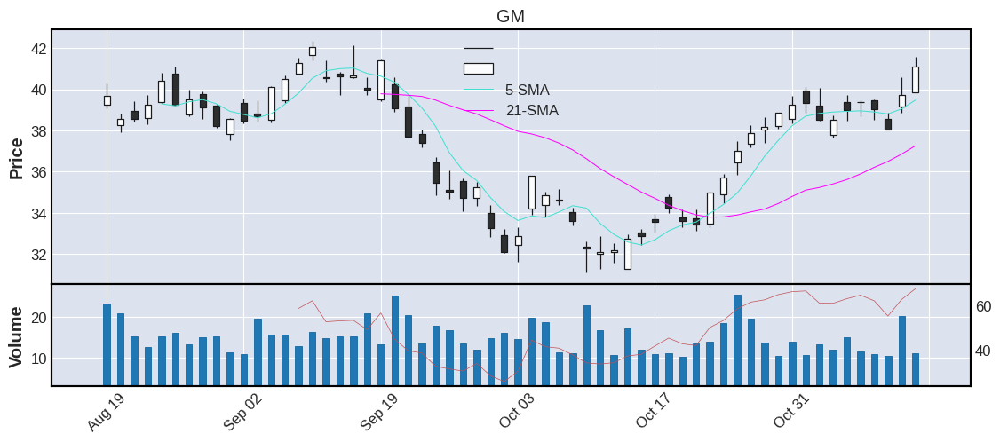



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
40    UPS  178.19  62.68  3.41    2.95  3.41  5.22  2.93  Consumer_Discretionary  1999.0  United States    large


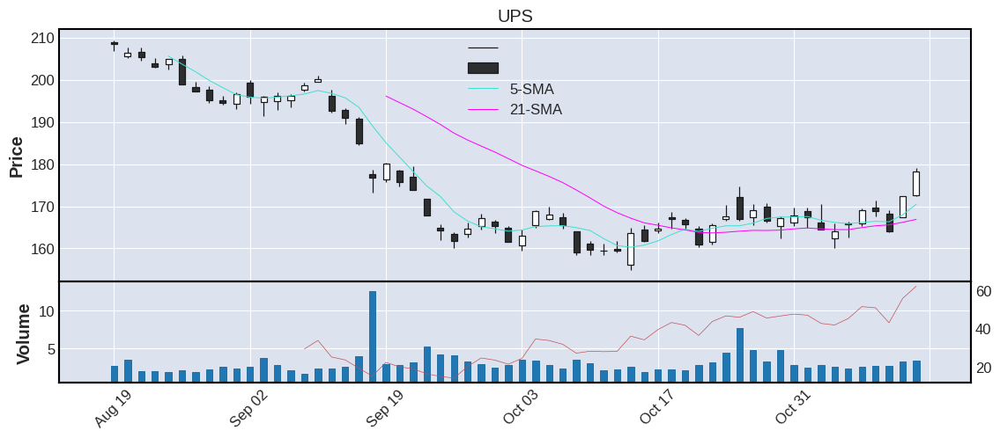



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
41    SWK  84.2  60.45  2.74    2.17  3.38  3.68  4.37  Consumer_Discretionary  0.0  United States    large


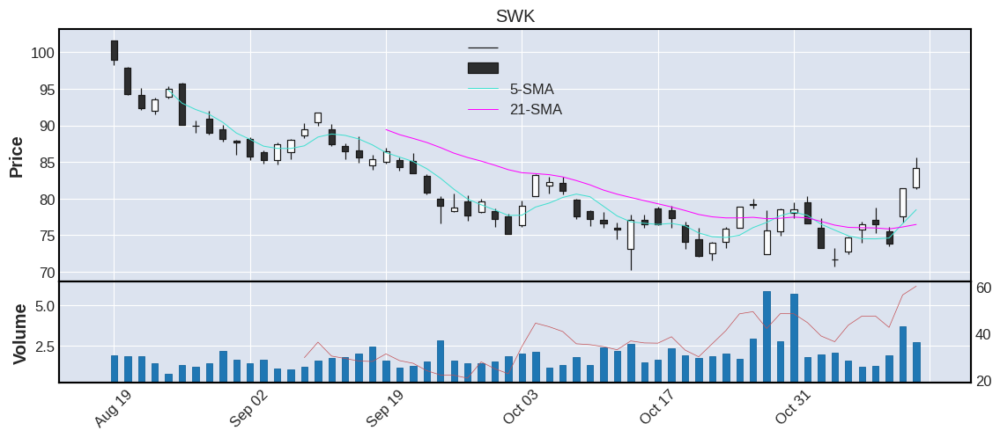



   TICKER      CP   RSI   VOL  AVGVOL  %CHG  ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
42    EFX  193.99  68.8  1.77    1.16  3.29  6.9  3.56  Consumer_Discretionary  0.0  United States    large


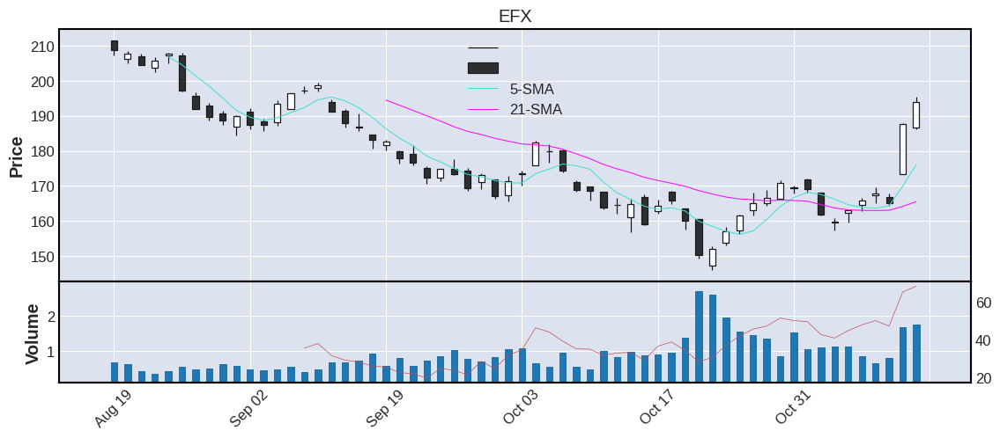



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
43    OMC  77.51  73.01  1.61    1.36  3.2  2.01  2.59  Consumer_Discretionary  0.0  United States    large


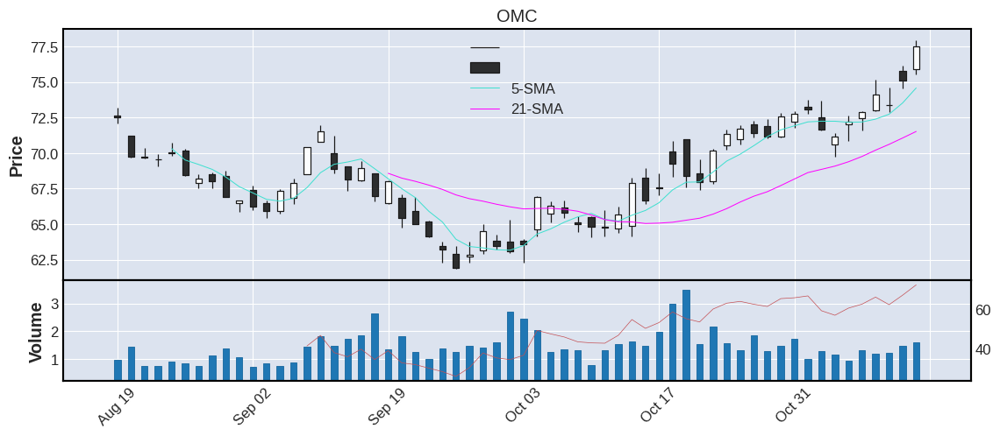



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
44   EXPD  111.91  77.17  1.63    2.24  2.96  3.41  3.05  Consumer_Discretionary  0.0  United States    large


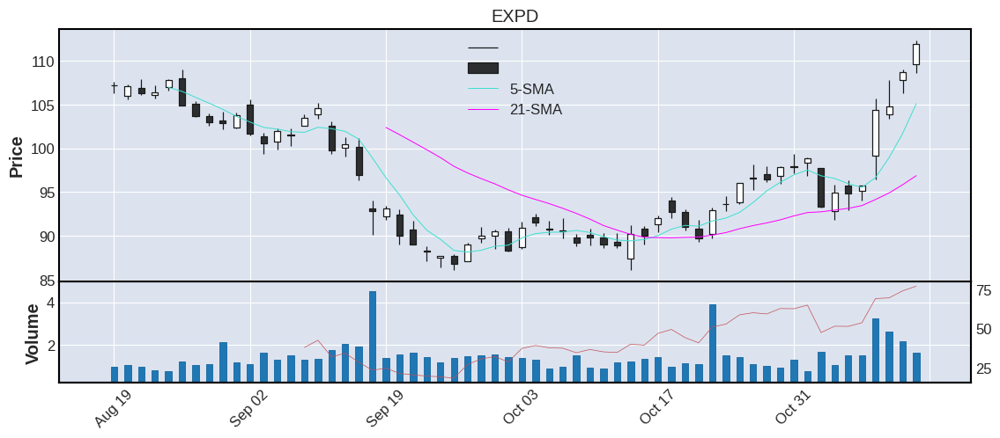



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
45    CZR  52.12  72.43  4.88    4.55  2.96  2.95  5.66  Consumer_Discretionary  0.0  United States   medium


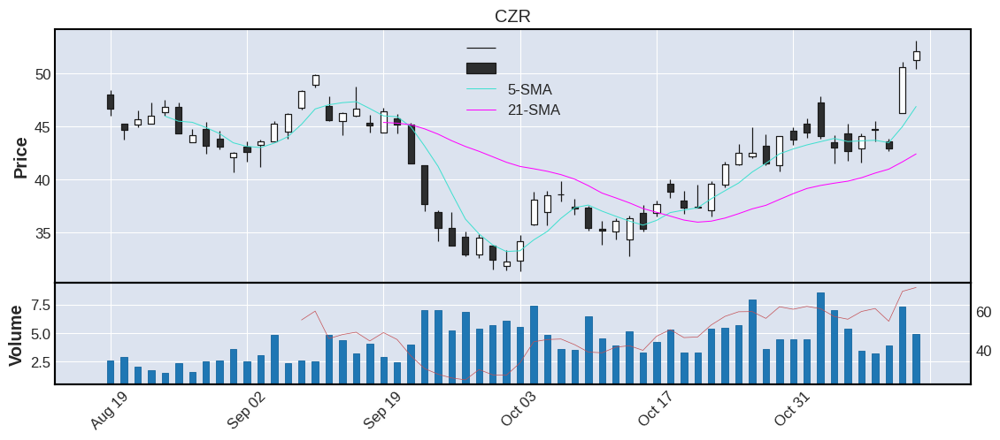



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR     IPO COUNTRY CATEGORY
46    HLT  140.63  67.43  2.81    2.24  2.94  4.71  3.35  Consumer_Discretionary  2016.0     N-A    large


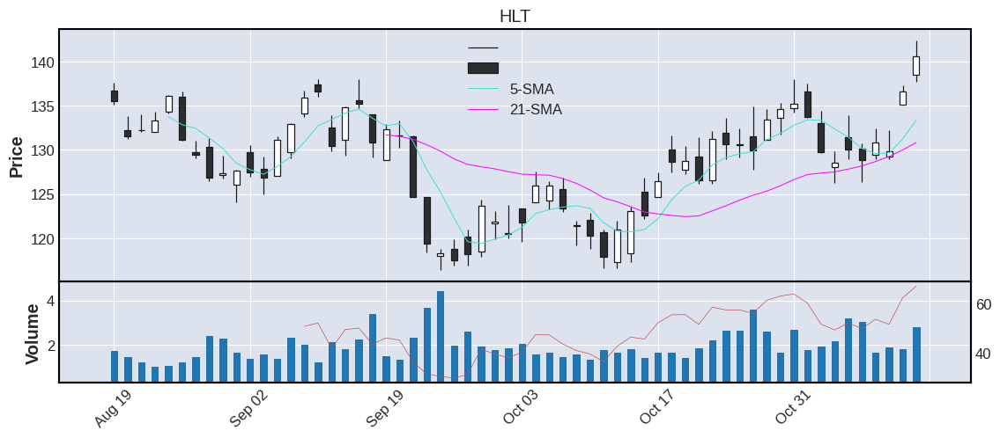



   TICKER      CP    RSI     VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
47   TSLA  195.97  37.82  114.05  119.31  2.75  13.04  6.65  Consumer_Discretionary  2010.0  United States     mega


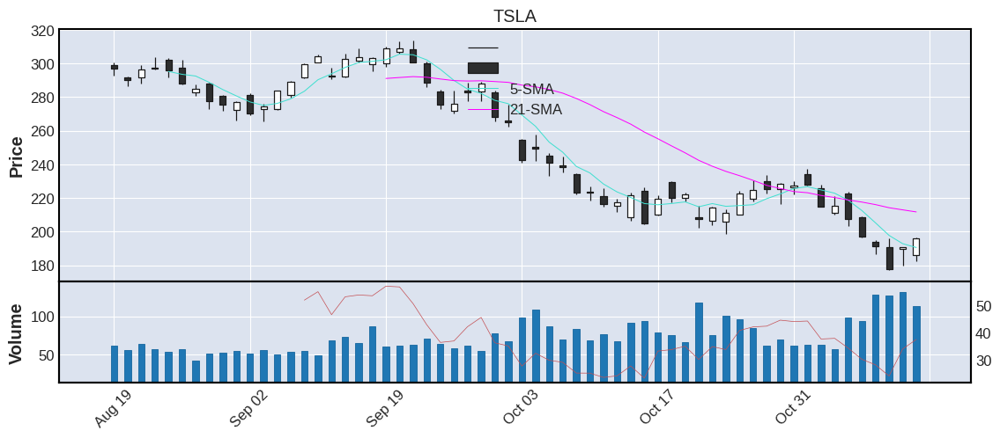



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR                  SECTOR  IPO        COUNTRY CATEGORY
48    ECL  155.68  58.24  1.32    1.71  2.67  5.39  3.46  Consumer_Discretionary  0.0  United States    large


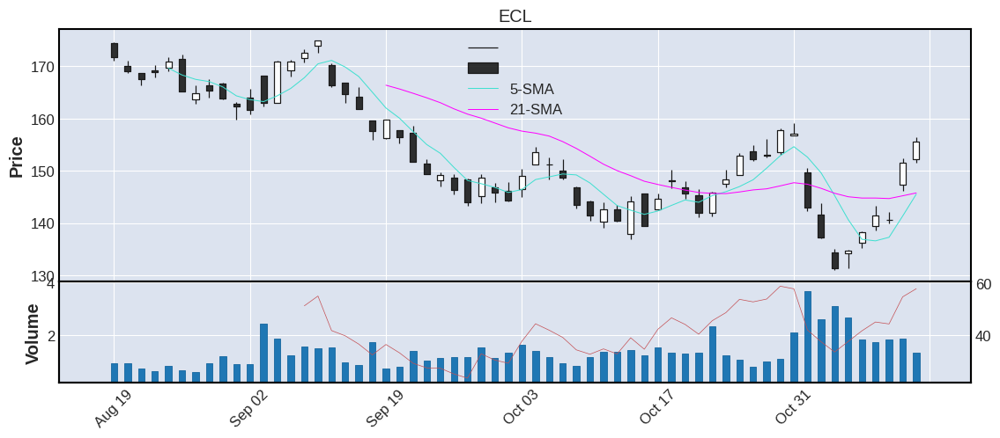



   TICKER      CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
49    DPZ  366.52  63.59  0.7    0.69  2.43  11.62  3.17  Consumer_Discretionary  2004.0  United States    large


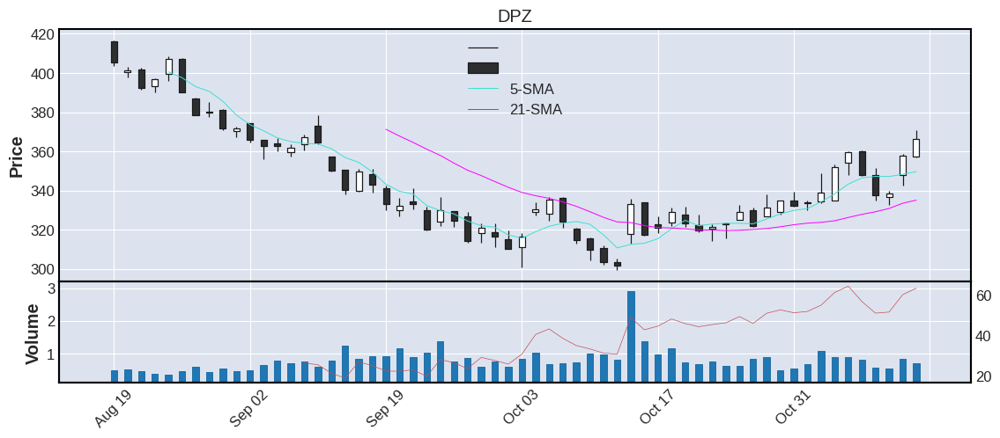



   TICKER       CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR                  SECTOR     IPO        COUNTRY CATEGORY
50    CMG  1506.35  53.11  0.44    0.32  2.41  48.29  3.21  Consumer_Discretionary  2006.0  United States    large


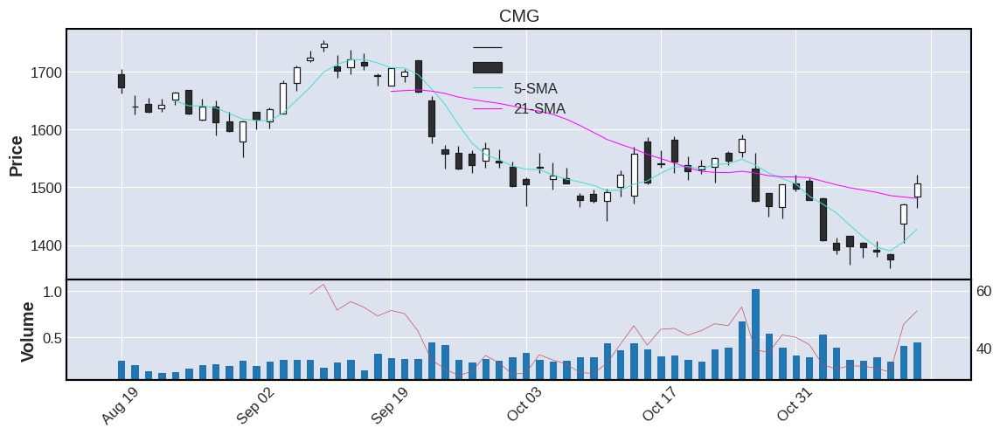



================================================== SECTOR 4: FINANCE [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR     IPO         COUNTRY CATEGORY
1    TROW  133.34  73.72   5.55    3.10  6.97   5.26  3.94  Finance  1986.0   United States    large
2     BEN   27.33  71.19   5.49    4.15  6.72   1.06  3.88  Finance     0.0   United States    large
3     MCO  310.37  74.83   1.88    1.05  5.47  10.34  3.33  Finance     0.0   United States    large
4     IVZ   19.77  77.10  11.23    7.68  5.44   0.76  3.84  Finance     0.0   United States   medium
5    NTRS   94.03  65.14   1.40    0.81  4.02   3.16  3.36  Finance     0.0   United States    large
6     SYF   40.23  72.15   6.38    5.02  3.87   1.47  3.65  Finance  2014.0   United States    large
7       C   50.19  70.05  23.54   18.66  3.66   1.30  2.59  Finance     0.0   United States    large
8    SPGI  356.20  69.93   2.04    1.72  2.89  11.08  3.11

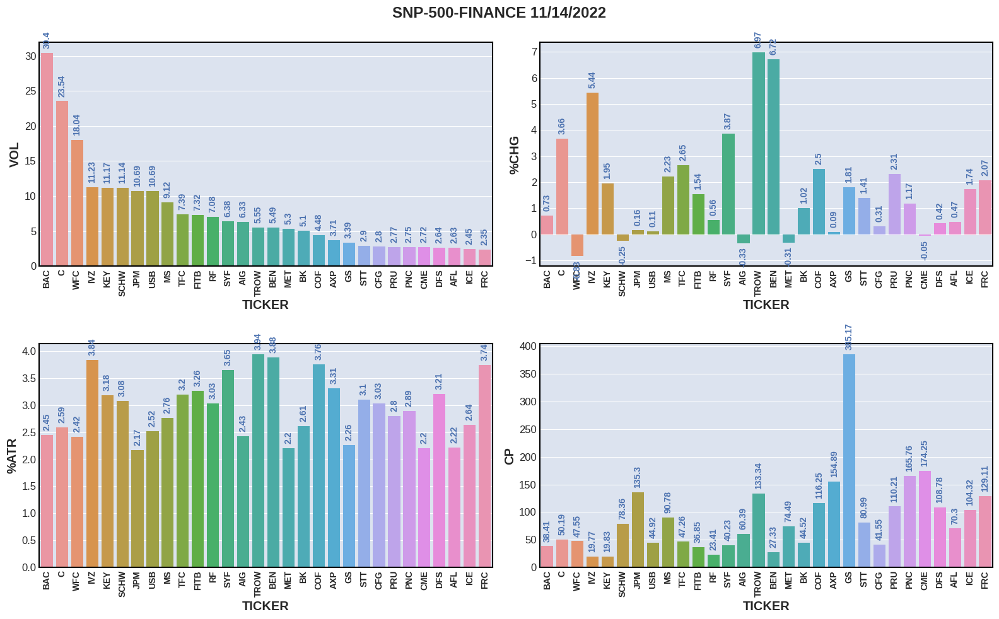

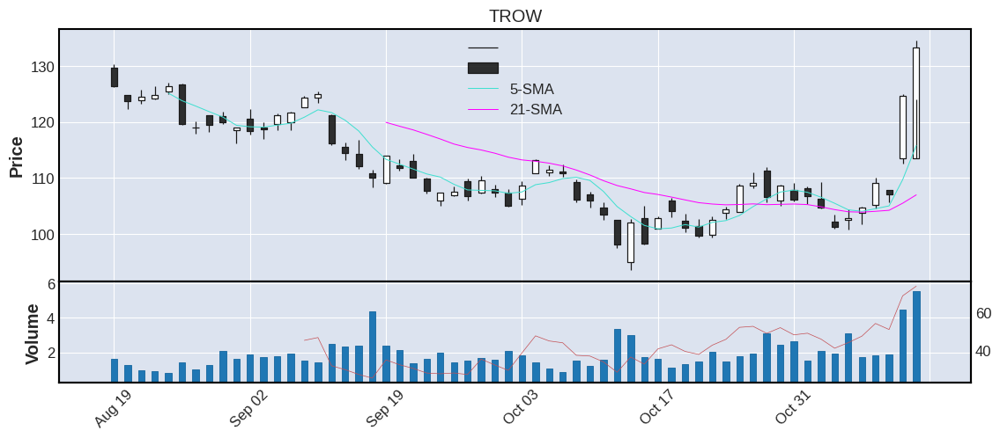



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
2    BEN  27.33  71.19  5.49    4.15  6.72  1.06  3.88  Finance  0.0  United States    large


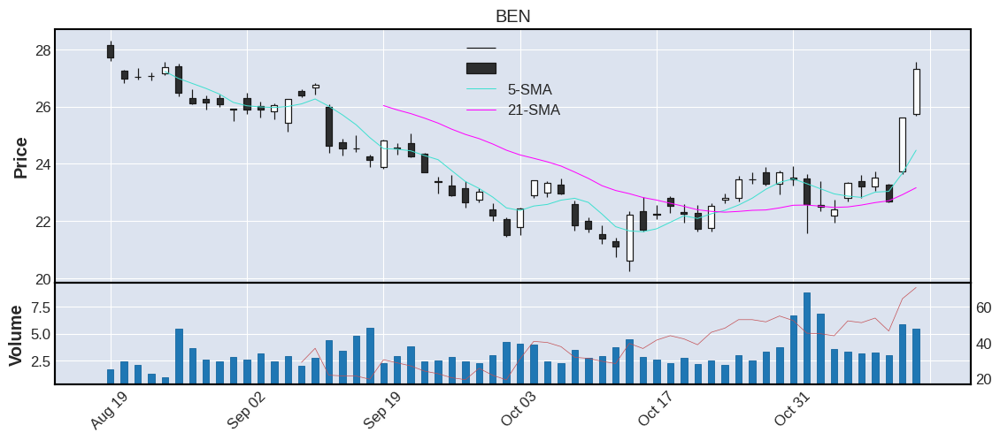



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
3    MCO  310.37  74.83  1.88    1.05  5.47  10.34  3.33  Finance  0.0  United States    large


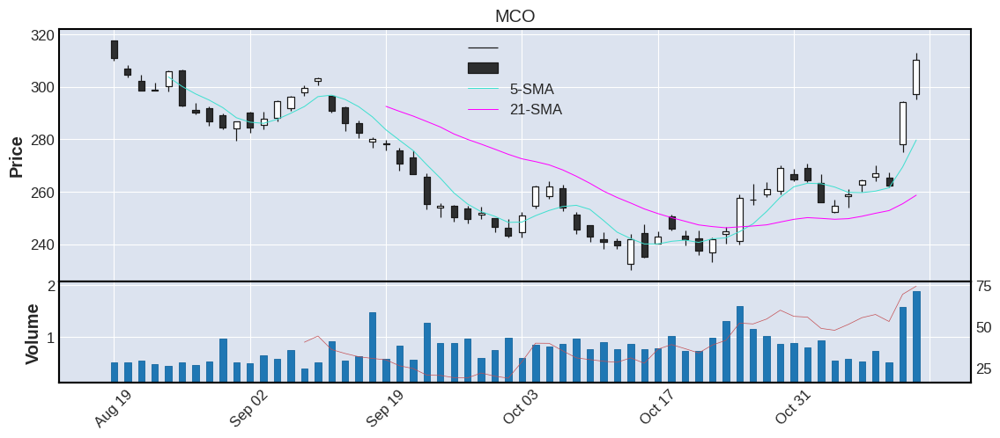



  TICKER     CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
4    IVZ  19.77  77.1  11.23    7.68  5.44  0.76  3.84  Finance  0.0  United States   medium


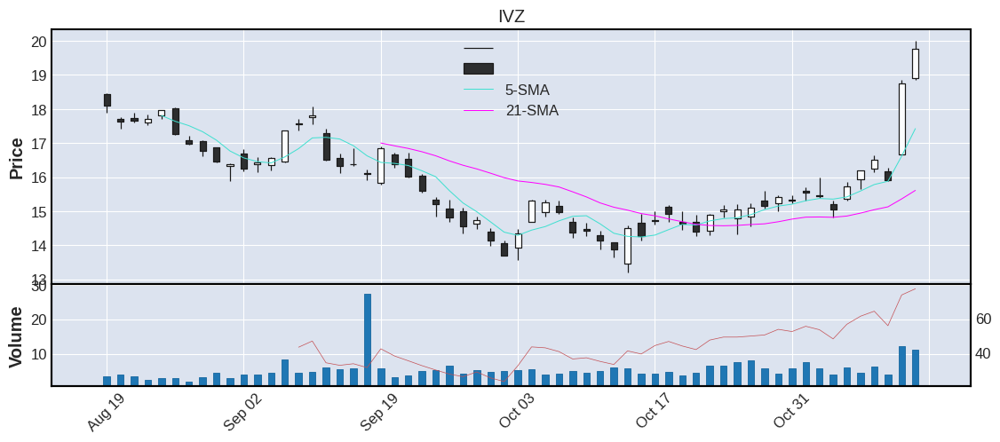



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
5   NTRS  94.03  65.14  1.4    0.81  4.02  3.16  3.36  Finance  0.0  United States    large


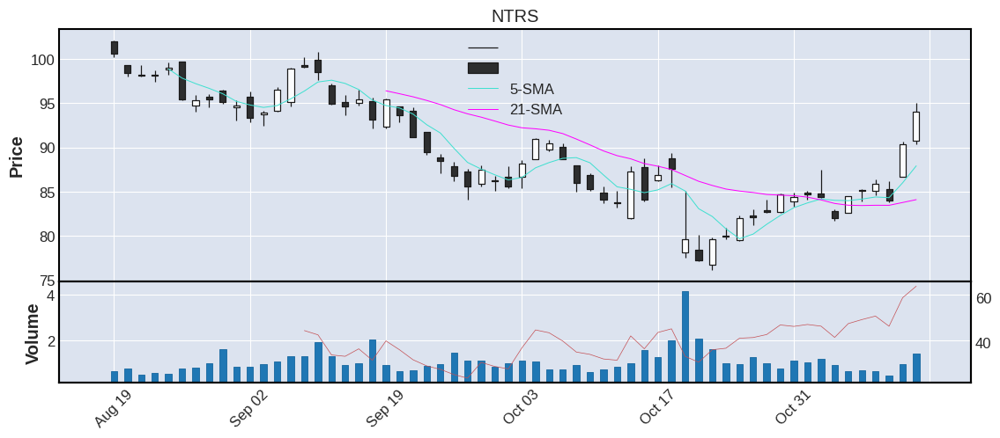



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
6    SYF  40.23  72.15  6.38    5.02  3.87  1.47  3.65  Finance  2014.0  United States    large


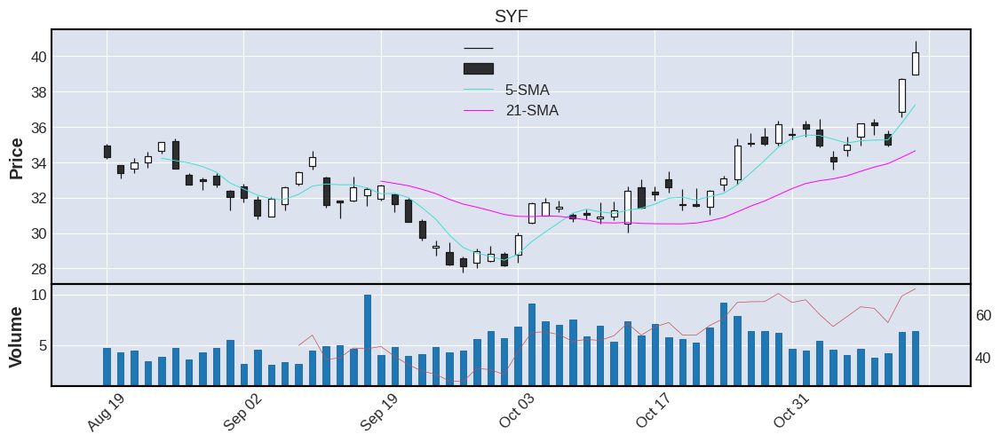



  TICKER     CP    RSI    VOL  AVGVOL  %CHG  ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
7      C  50.19  70.05  23.54   18.66  3.66  1.3  2.59  Finance  0.0  United States    large


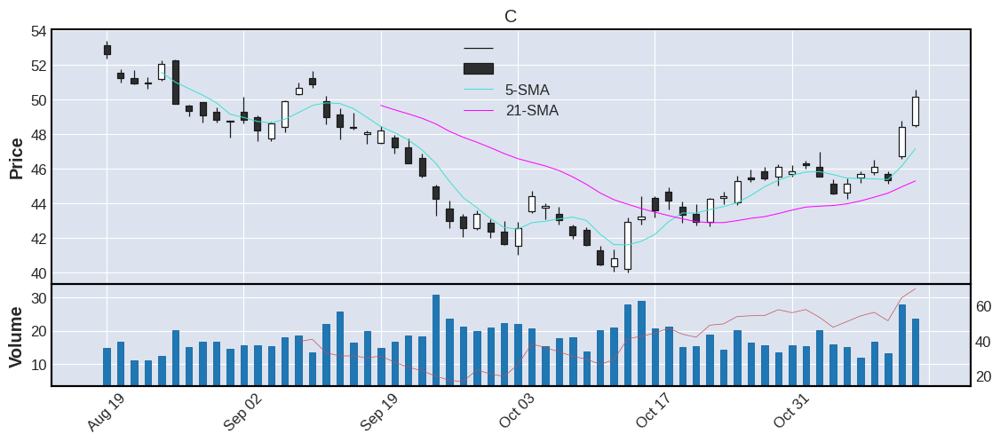



  TICKER     CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
8   SPGI  356.2  69.93  2.04    1.72  2.89  11.08  3.11  Finance  0.0  United States    large


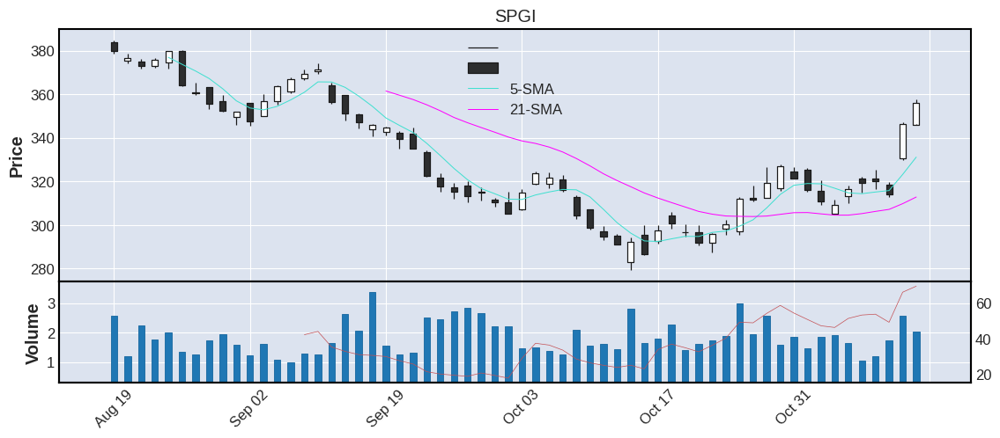



  TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
9   ZION  55.39  61.68  2.32    1.53  2.82  2.1  3.79  Finance  0.0  United States   medium


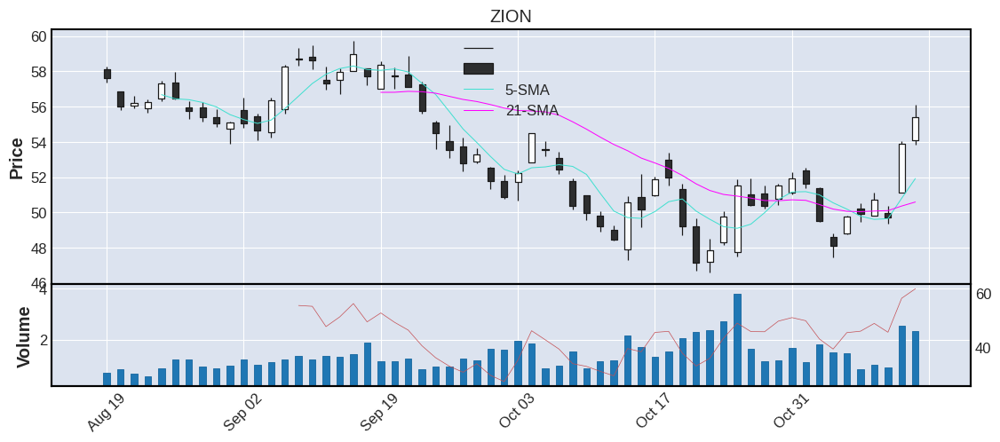



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
10    TFC  47.26  60.49  7.39    6.81  2.65  1.51   3.2  Finance  0.0  United States    large


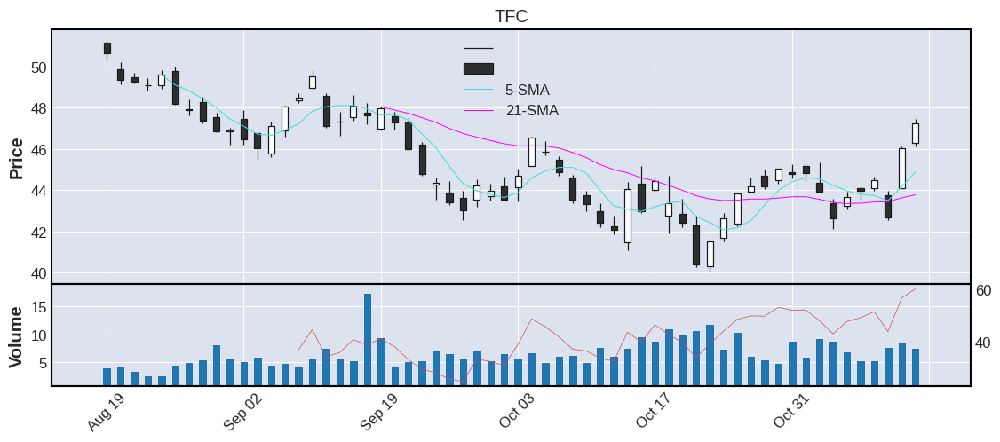



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
11    COF  116.25  66.94  4.48    2.85  2.5  4.37  3.76  Finance  1994.0  United States    large


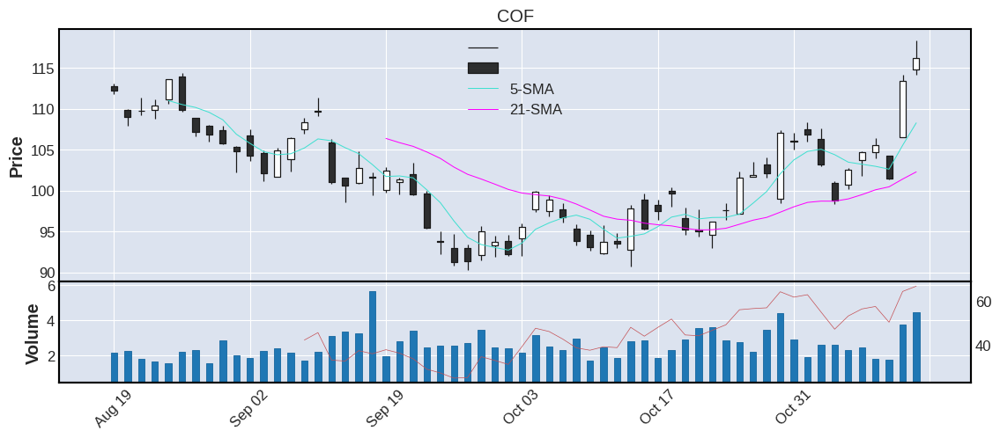



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
12   CINF  110.09  67.49  1.03    0.75  2.36  3.12  2.83  Finance  0.0  United States    large


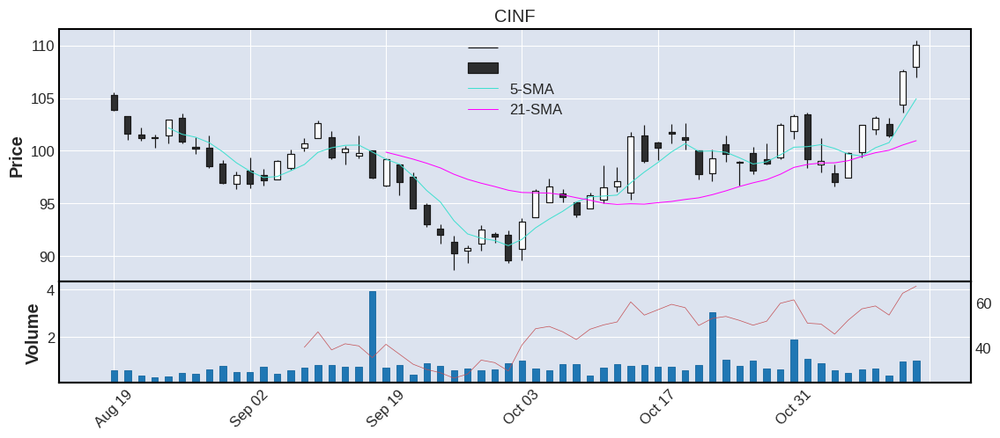



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
13    PRU  110.21  69.5  2.77    2.27  2.31  3.09   2.8  Finance  2001.0  United States    large


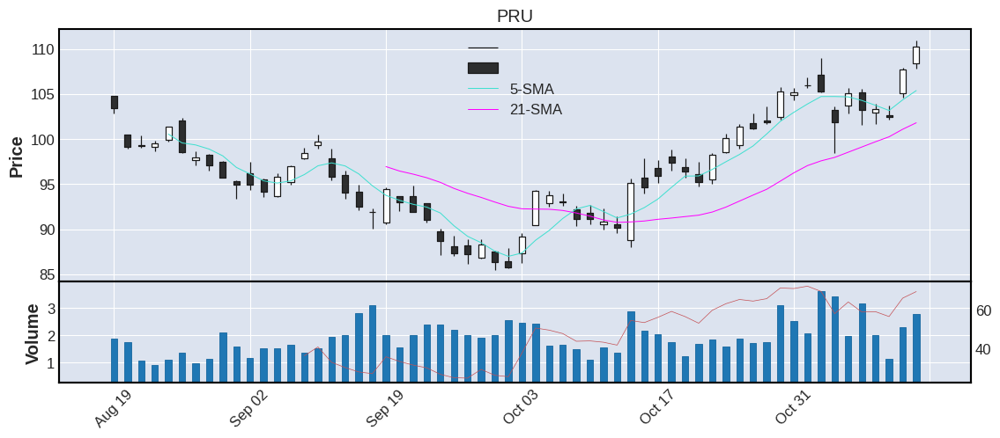



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
14     MS  90.78  68.92  9.12    6.76  2.23  2.51  2.76  Finance  0.0  United States    large


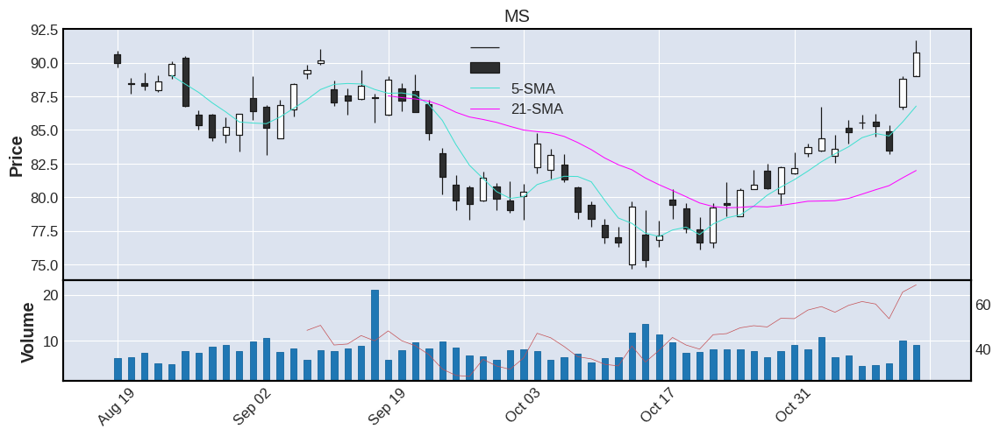



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
15   SBNY  143.98  45.0  1.58    1.79  2.16  8.76  6.08  Finance  2004.0  United States   medium


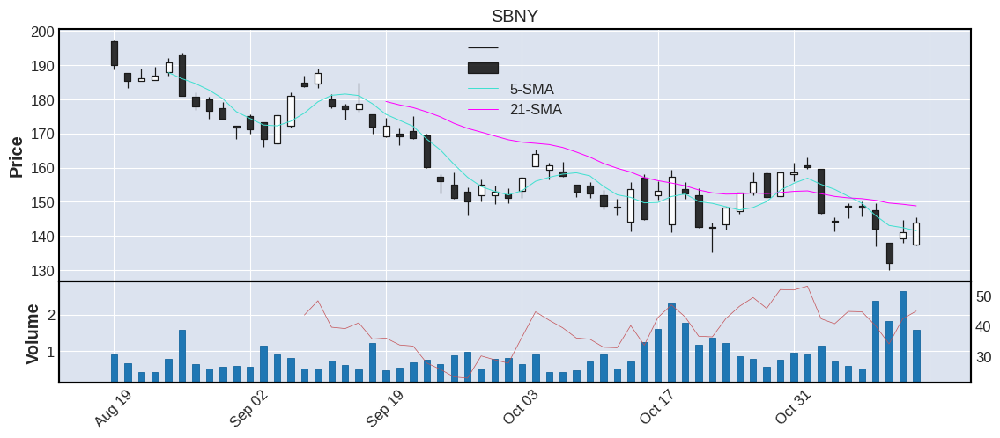



   TICKER     CP    RSI   VOL  AVGVOL %CHG    ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
16   MKTX  283.3  73.22  0.51     0.5  2.1  10.19   3.6  Finance  2004.0  United States   medium


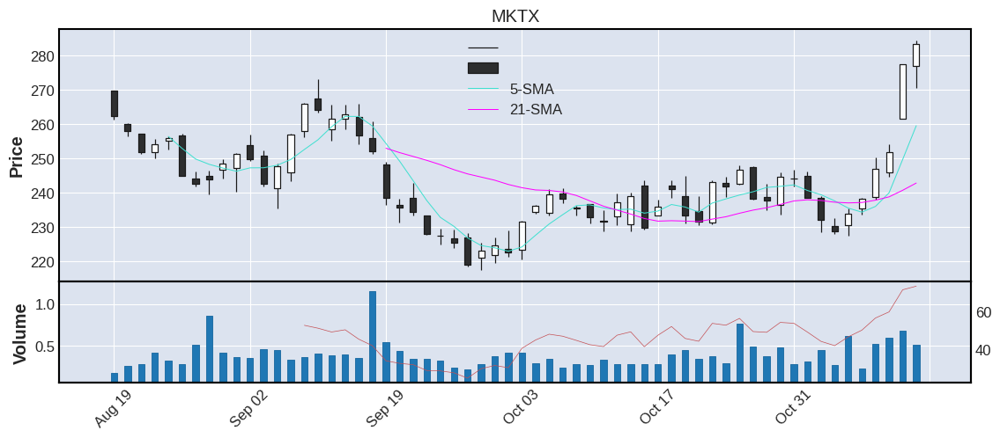



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
17   CBRE  78.83  66.03  2.22    1.77  2.08  2.67  3.39  Finance  0.0  United States    large


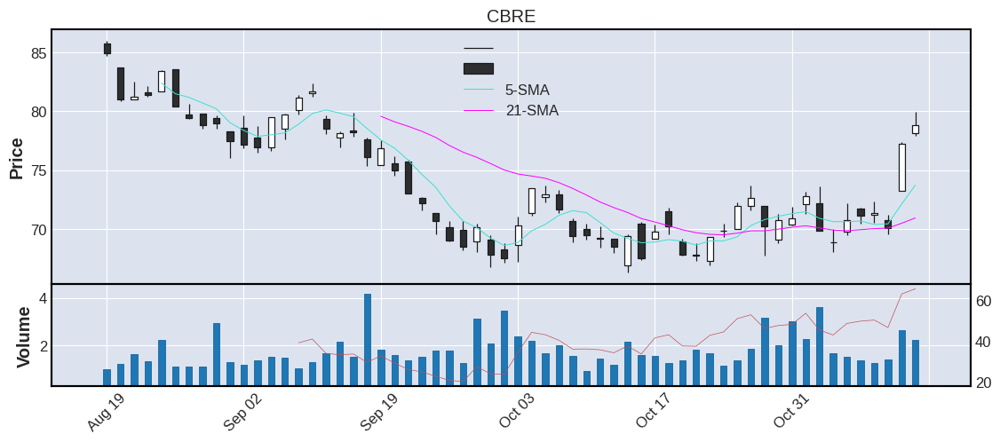



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
18    FRC  129.11  57.79  2.35    3.39  2.07  4.83  3.74  Finance  0.0  United States    large


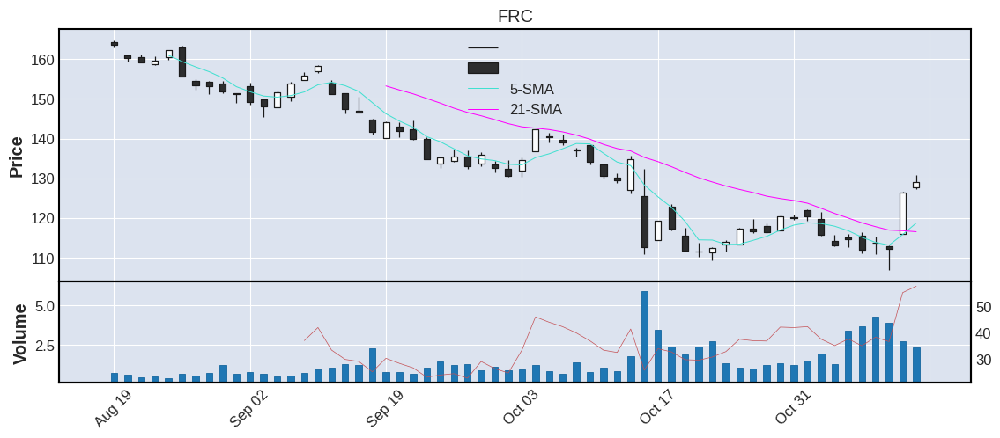



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
19   SIVB  235.62  39.85  1.27    1.22  2.02  16.93  7.19  Finance  0.0  United States    large


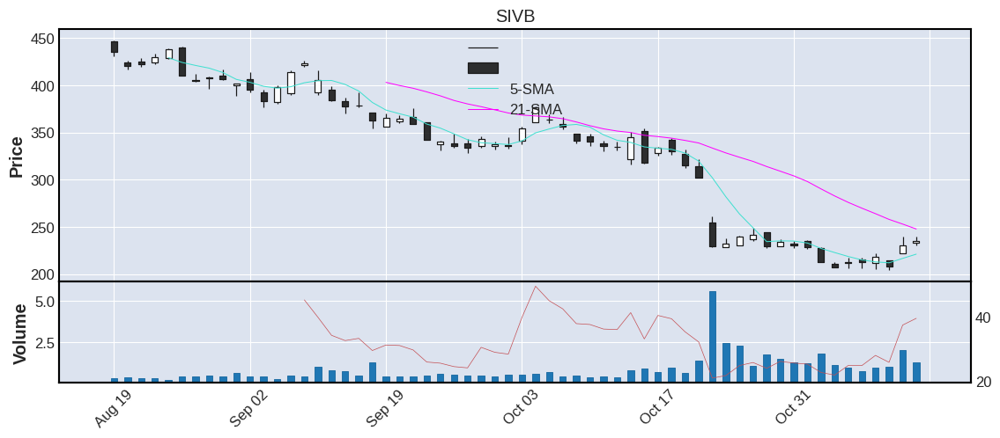



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
20    BLK  774.75  76.02  1.17    1.08  1.97  25.68  3.31  Finance  1999.0  United States    large


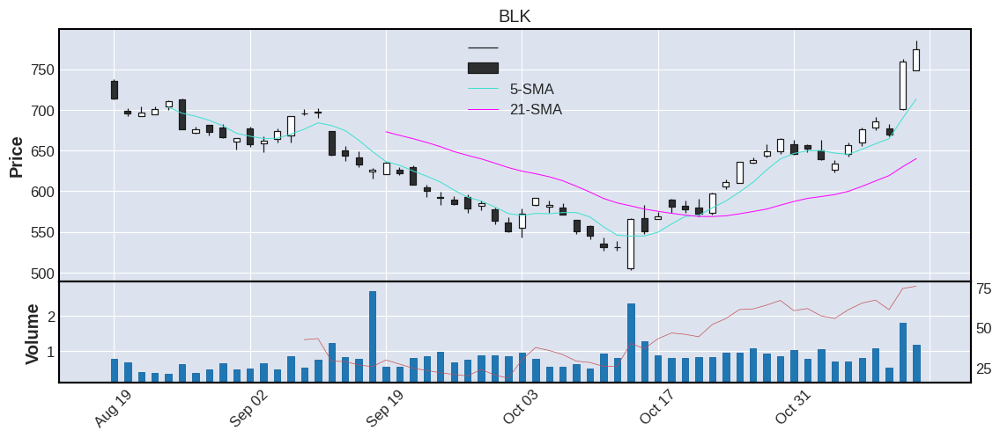



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
21    KEY  19.83  70.37  11.17    10.0  1.95  0.63  3.18  Finance  0.0  United States    large


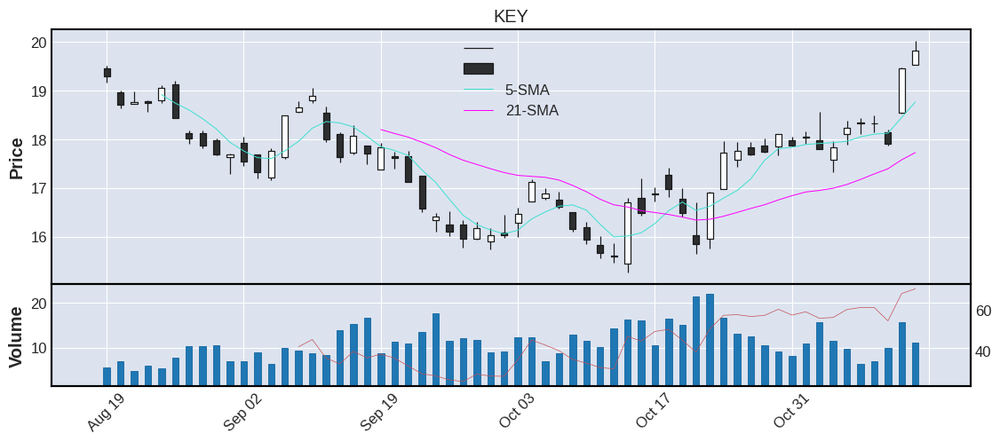



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
22     GS  385.17  81.88  3.39    3.25  1.81  8.72  2.26  Finance  1999.0  United States    large


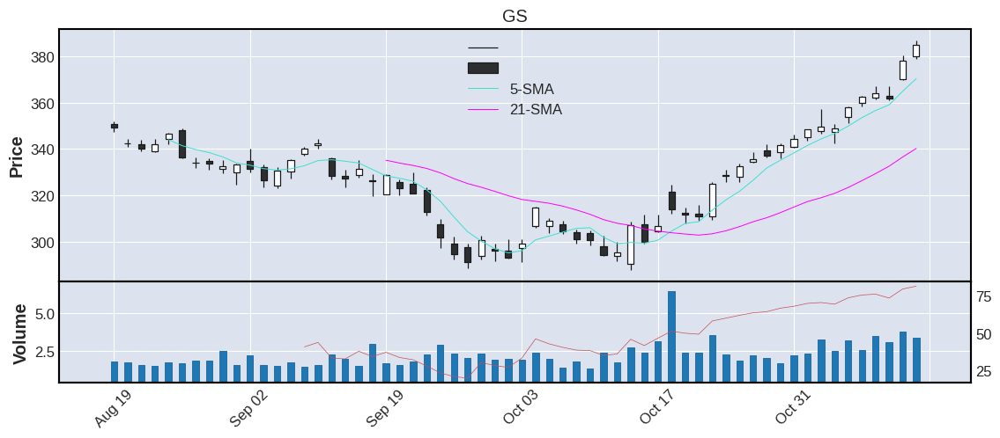



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
23    LNC  35.24  32.51  2.04    3.68  1.76  2.51  7.12  Finance  0.0  United States   medium


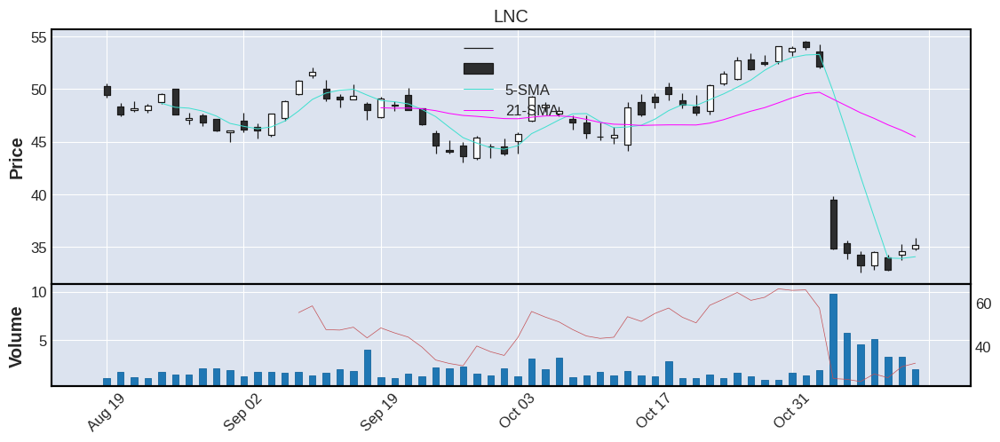



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
24    ICE  104.32  67.85  2.45     2.4  1.74  2.75  2.64  Finance  2005.0  United States    large


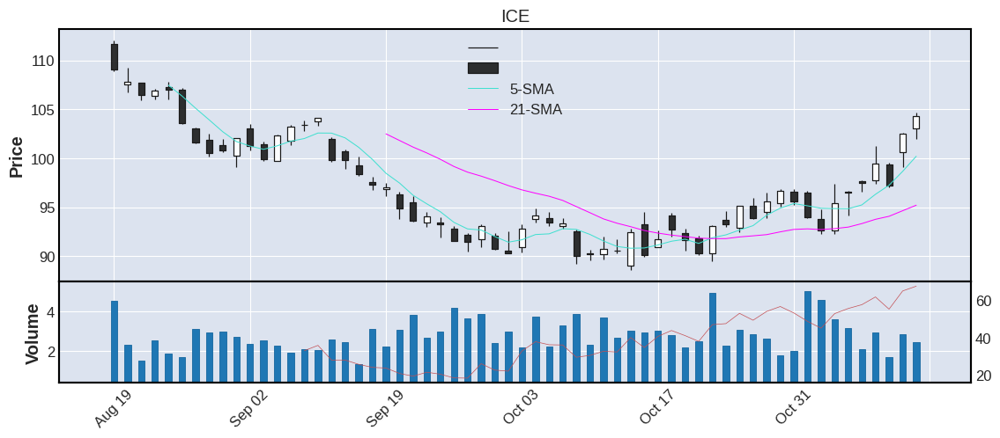



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
25   FITB  36.85  60.82  7.32    5.22  1.54  1.2  3.26  Finance  0.0  United States    large


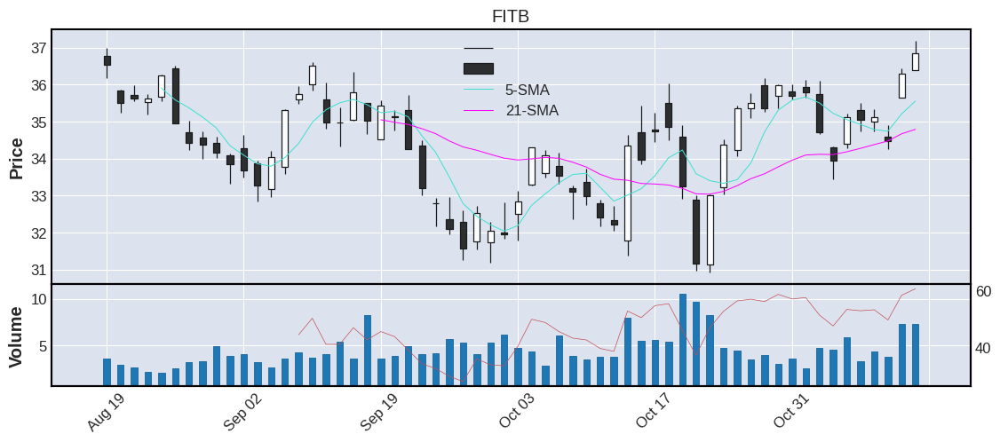



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
26    PFG  95.0  77.13  1.96    1.47  1.47  2.36  2.48  Finance  2001.0  United States    large


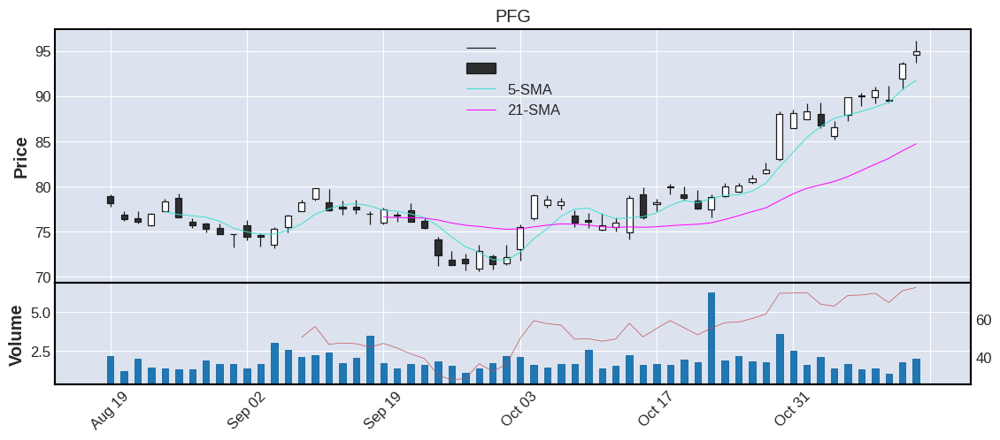



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
27    ALL  132.09  57.16  1.53     1.4  1.46  4.62   3.5  Finance  0.0  United States    large


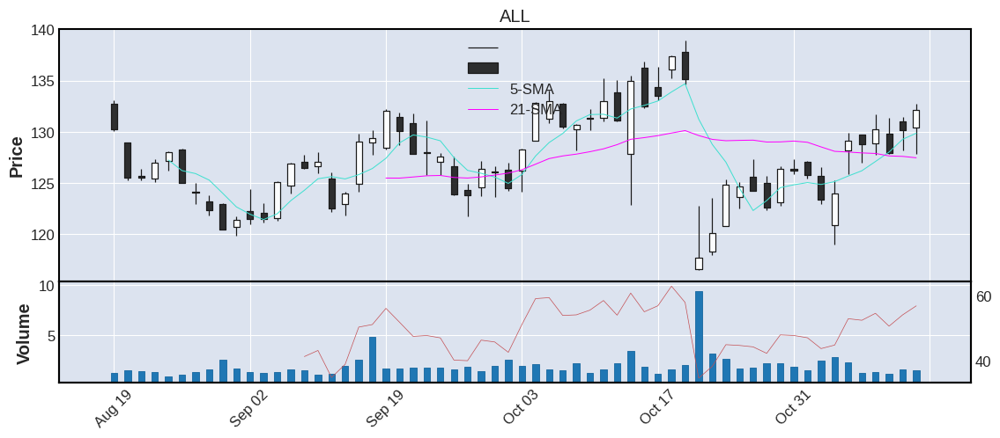



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
28    STT  80.99  75.07  2.9    2.17  1.41  2.51   3.1  Finance  0.0  United States    large


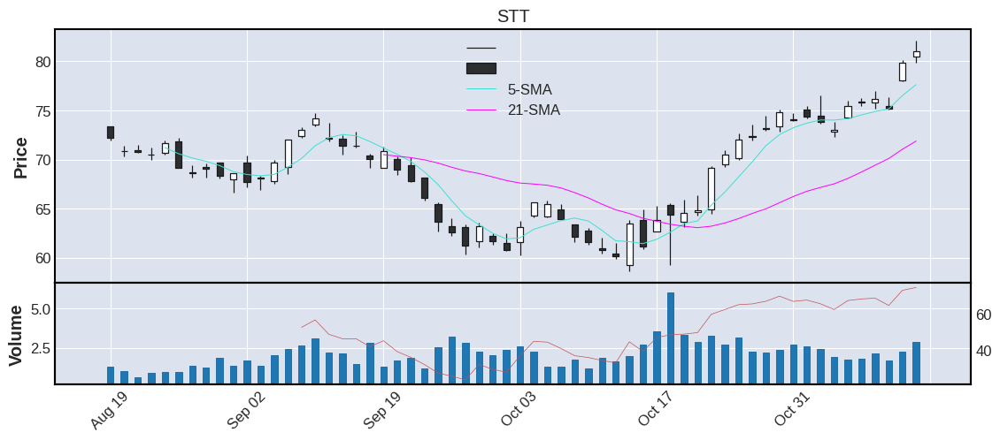



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
29    AIZ  128.15  39.23  0.49    0.73  1.18  5.01  3.91  Finance  2004.0  United States   medium


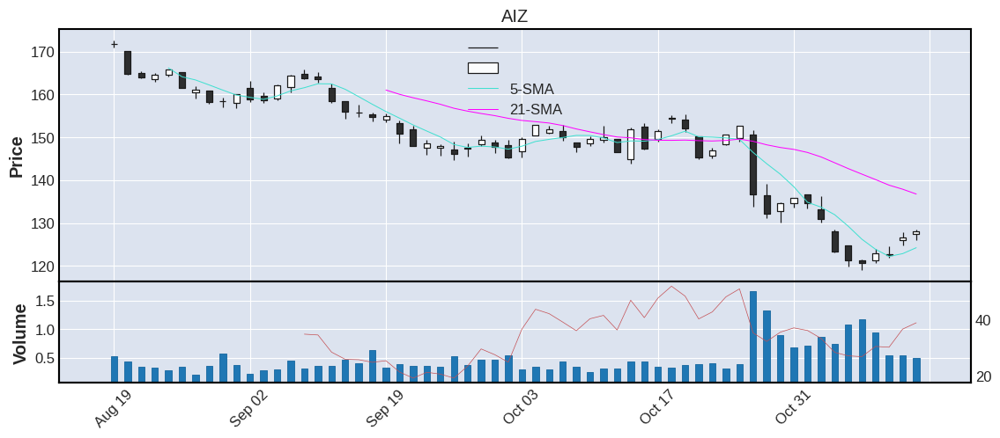



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
30    PNC  165.76  59.55  2.75     2.7  1.17  4.79  2.89  Finance  0.0  United States    large


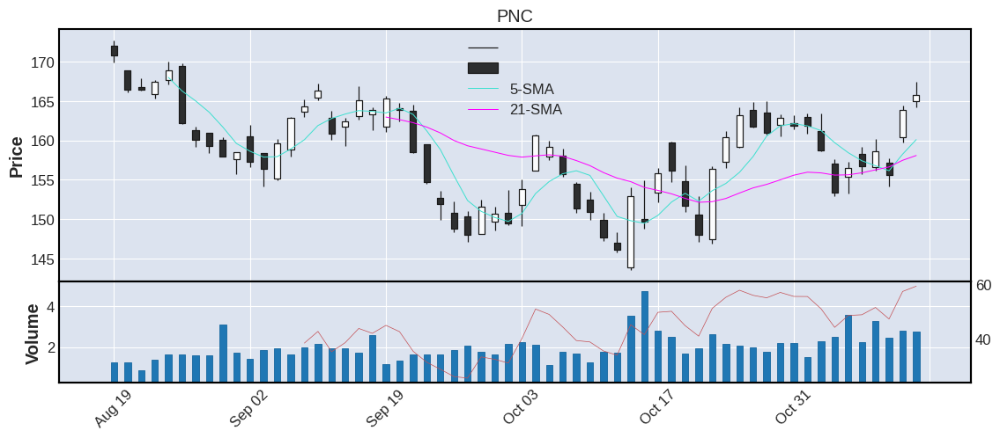



   TICKER     CP   RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
31     BK  44.52  65.5  5.1    5.49  1.02  1.16  2.61  Finance  0.0  United States    large


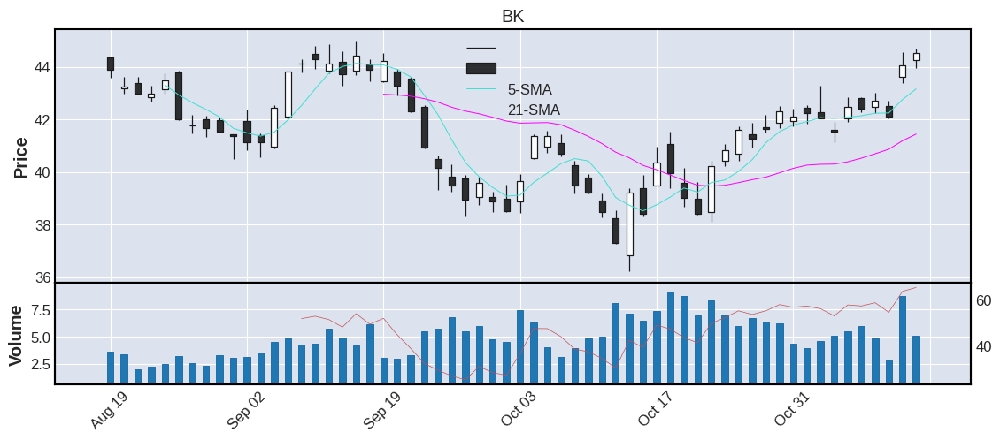



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO         COUNTRY CATEGORY
32    WTW  233.89  70.53  0.75    0.51  0.76  5.45  2.33  Finance  2001.0  United Kingdom    large


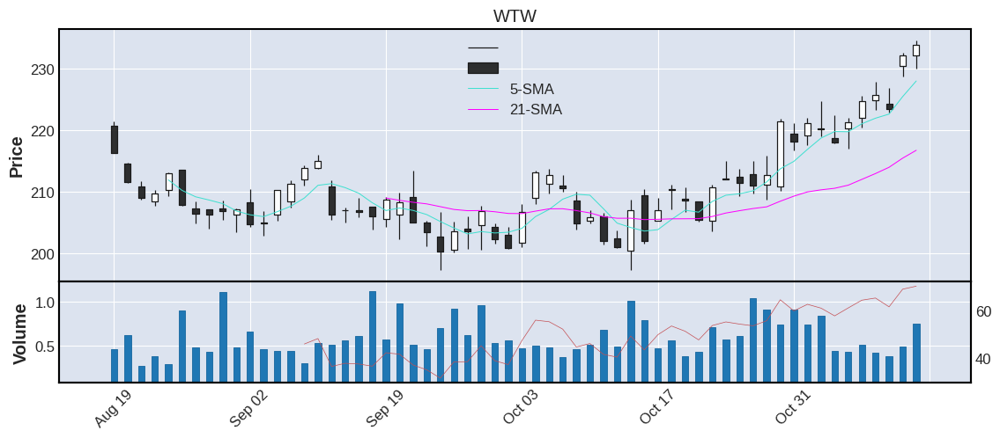



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
33    BAC  38.41  71.96  30.4   35.29  0.73  0.94  2.45  Finance  0.0  United States     mega


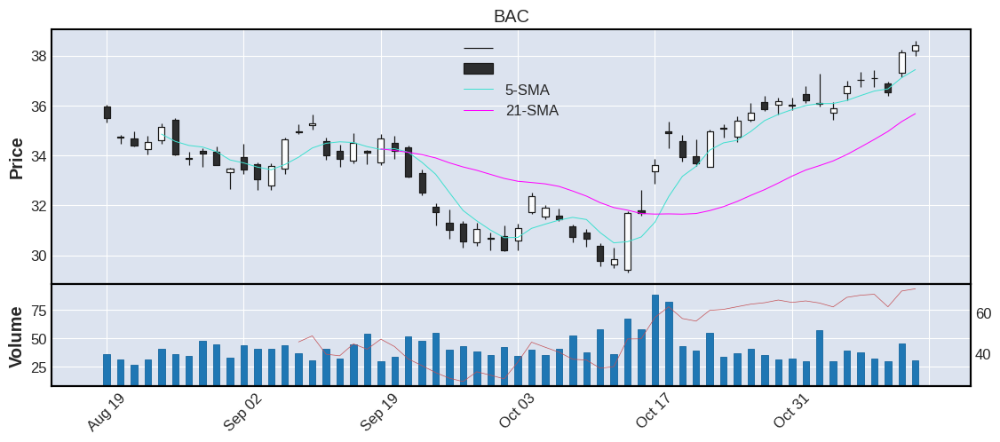



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
34     RF  23.41  65.54  7.08    6.75  0.56  0.71  3.03  Finance  0.0  United States    large


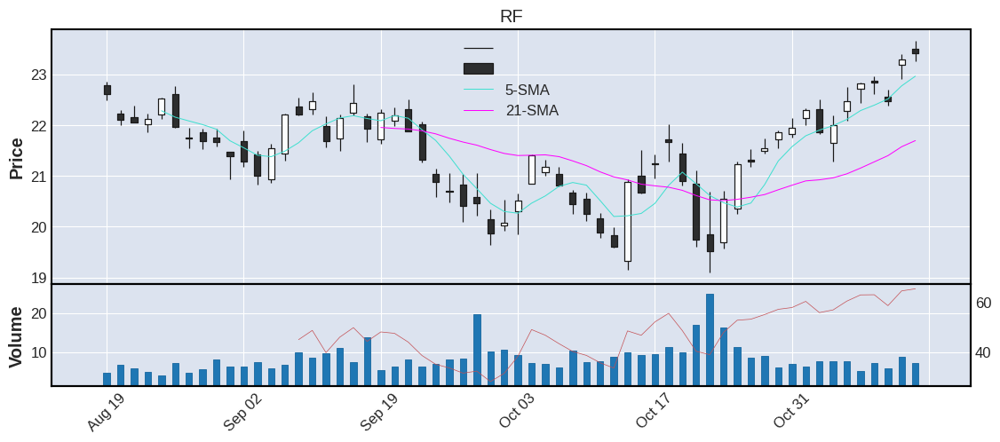



   TICKER      CP   RSI   VOL  AVGVOL  %CHG    ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
35   MSCI  512.37  72.1  0.47    0.41  0.52  17.35  3.39  Finance  0.0  United States    large


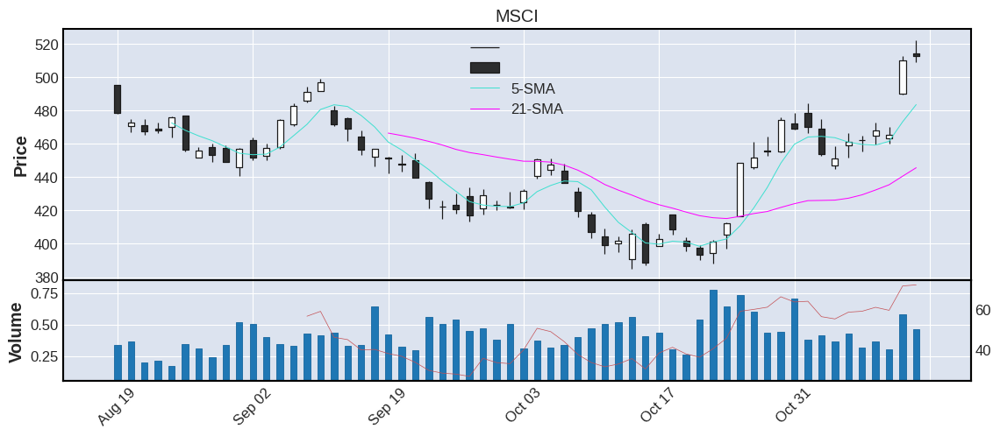



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
36    AFL  70.3  78.28  2.63    2.66  0.47  1.56  2.22  Finance  0.0  United States    large


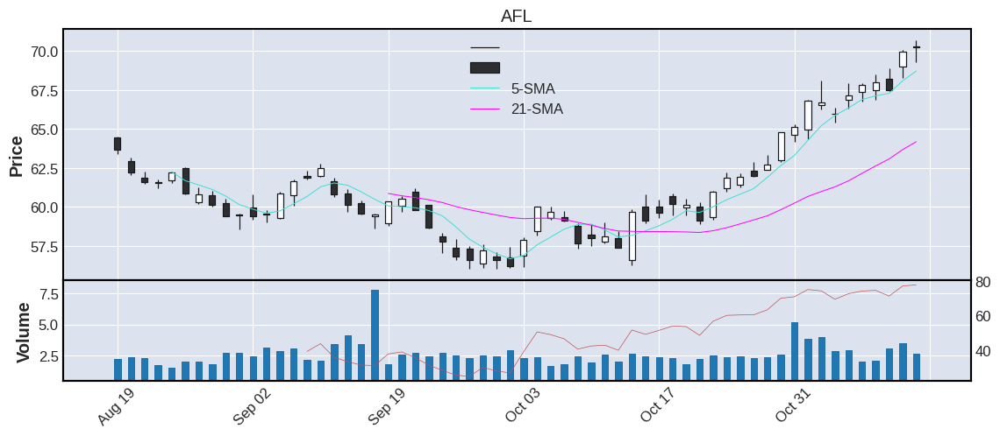



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
37    DFS  108.78  64.74  2.64    1.68  0.42  3.49  3.21  Finance  0.0  United States    large


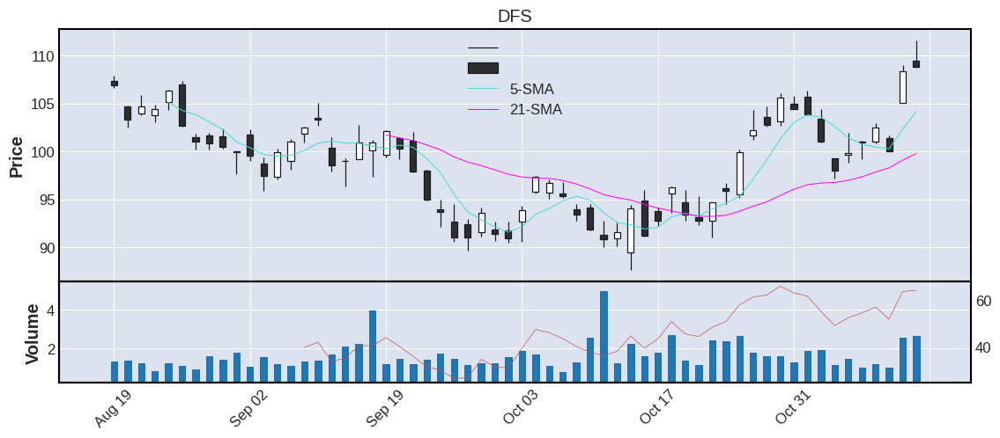



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
38    CFG  41.55  65.63  2.8    4.02  0.31  1.26  3.03  Finance  2014.0  United States    large


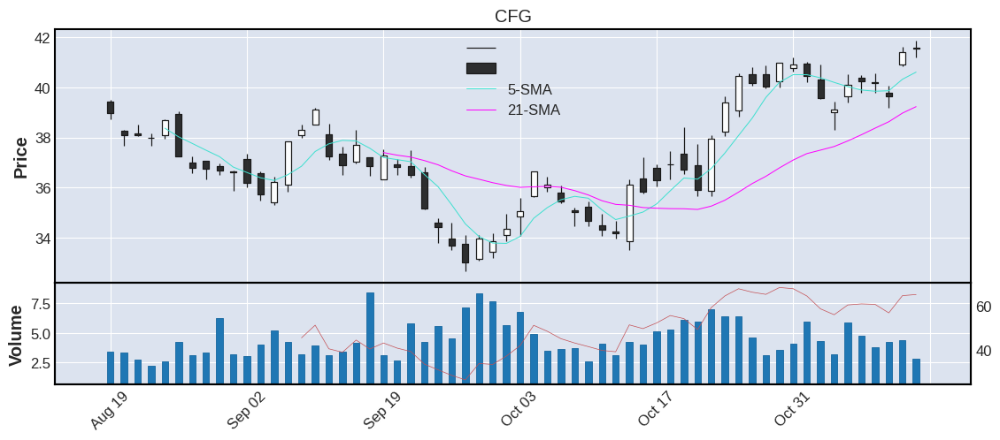



   TICKER    CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
39   NDAQ  66.4  69.17  1.8    2.52  0.29  1.68  2.53  Finance  0.0  United States    large


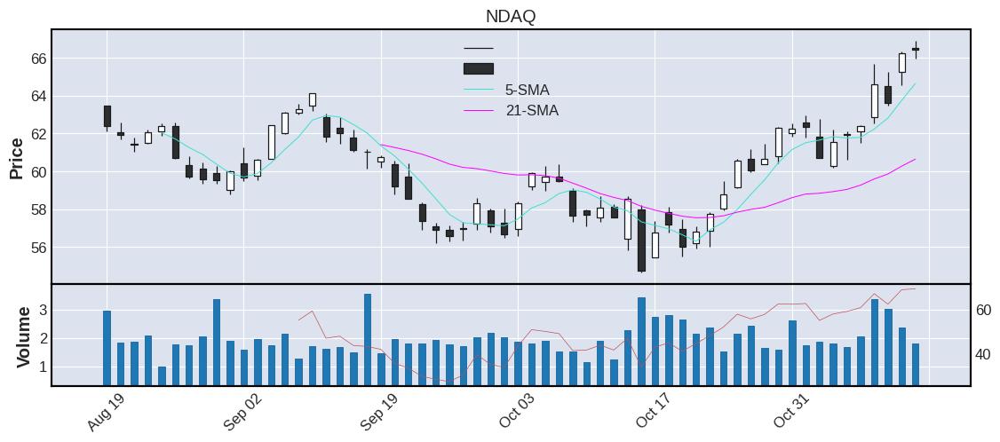



   TICKER     CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
40    JPM  135.3  74.4  10.69   11.69  0.16  2.93  2.17  Finance  0.0  United States     mega


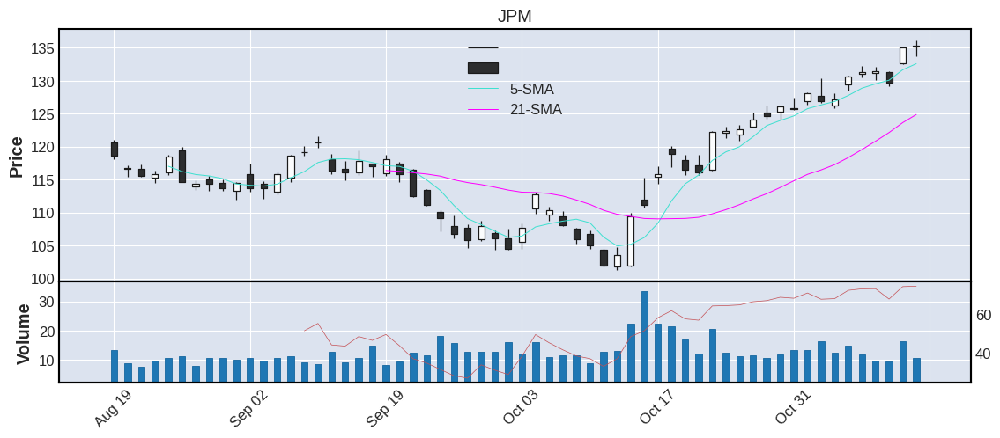



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
41    USB  44.92  60.79  10.69   11.84  0.11  1.13  2.52  Finance  0.0  United States    large


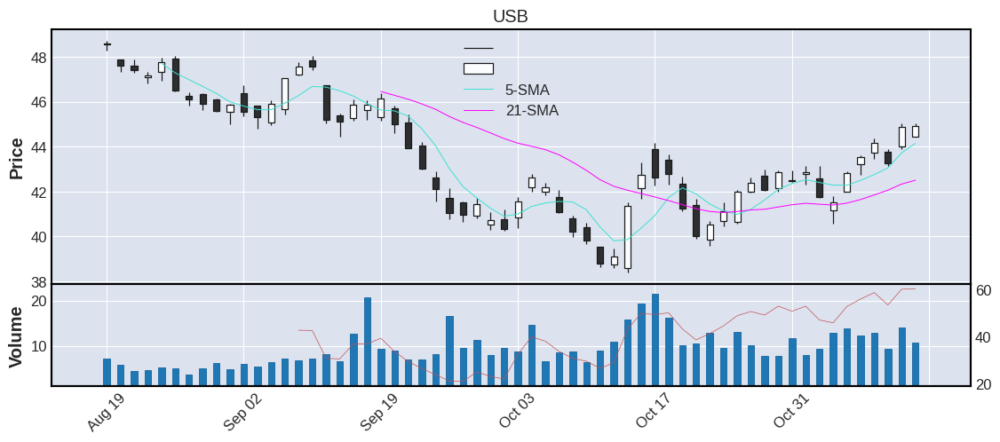



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
42    AXP  154.89  60.34  3.71    3.52  0.09  5.12  3.31  Finance  0.0  United States    large


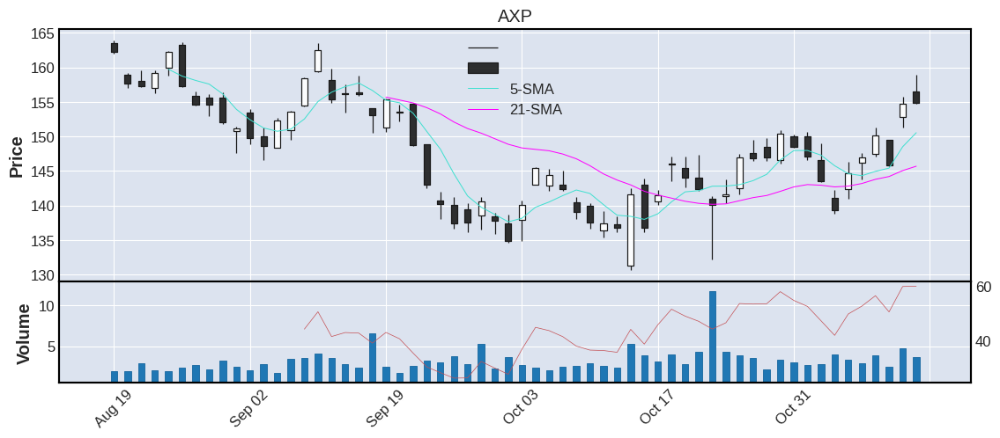



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
43    CME  174.25  49.45  2.72    2.37 -0.05  3.83   2.2  Finance  2002.0  United States    large


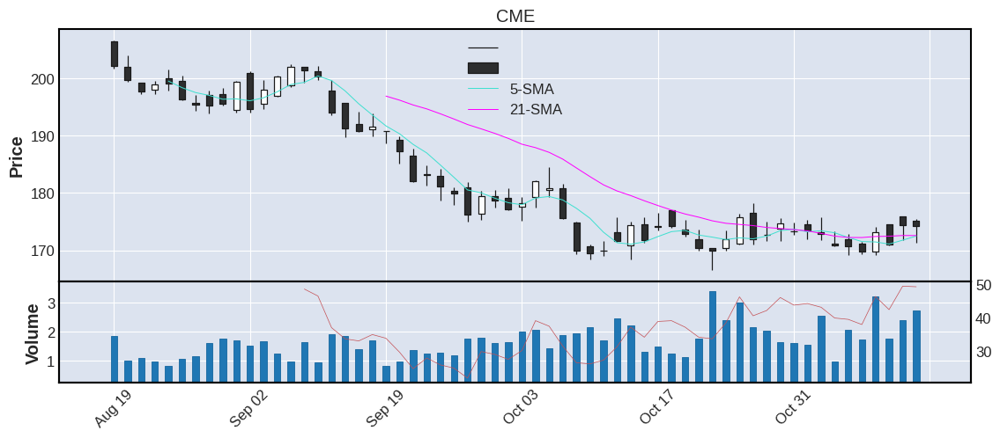



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
44    AMP  331.16  71.49  1.07    0.65 -0.12  9.89  2.99  Finance  0.0  United States    large


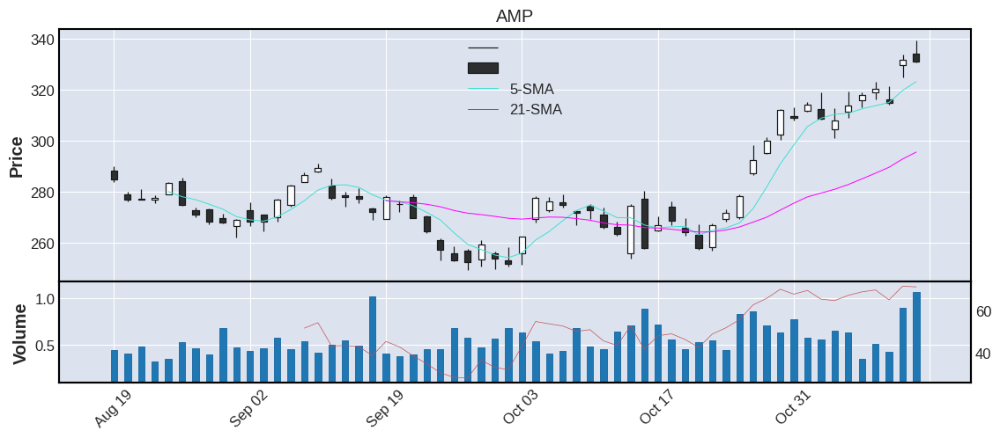



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
45   SCHW  78.36  59.66  11.14    7.81 -0.25  2.41  3.08  Finance  0.0  United States    large


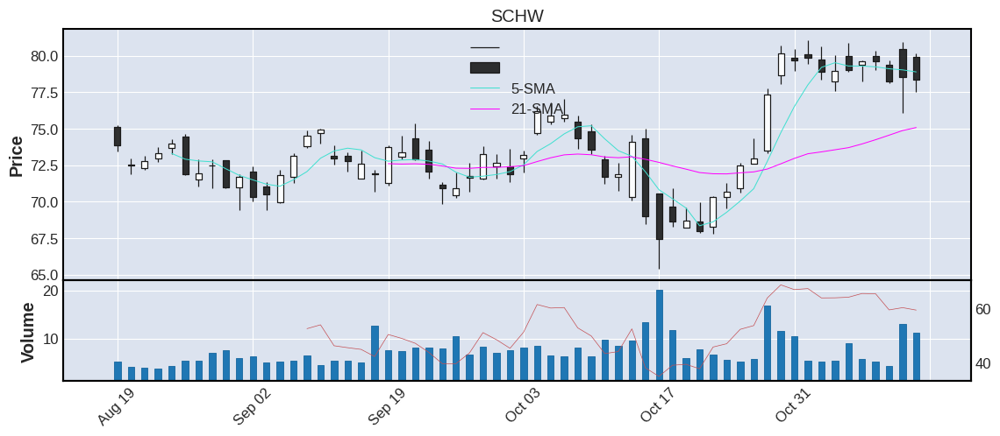



   TICKER     CP   RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR     IPO        COUNTRY CATEGORY
46    MET  74.49  68.7  5.3     4.6 -0.31  1.64   2.2  Finance  2000.0  United States    large


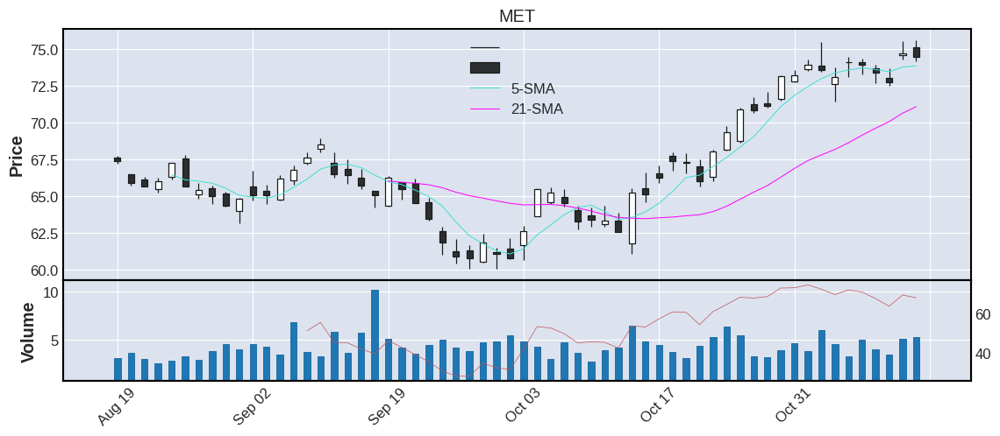



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
47    AIG  60.39  74.47  6.33    4.66 -0.33  1.47  2.43  Finance  0.0  United States    large


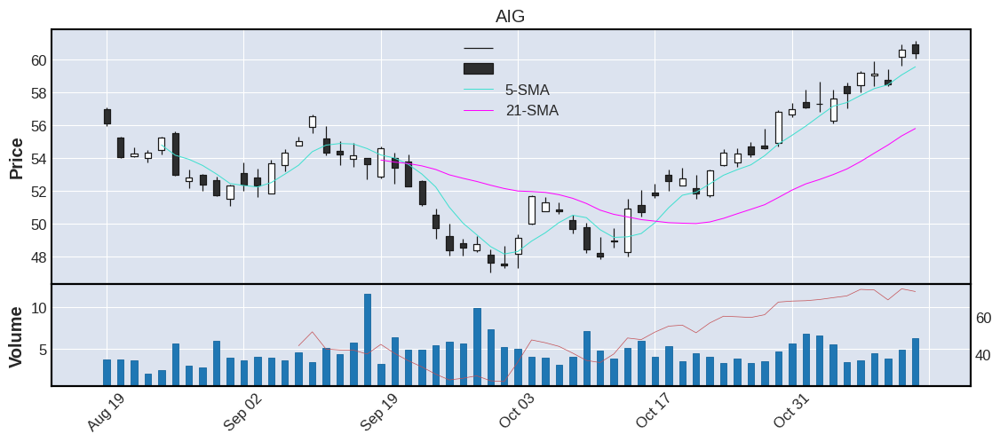



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
48    RJF  123.4  70.07  1.82    1.34 -0.47  3.38  2.74  Finance  0.0  United States    large


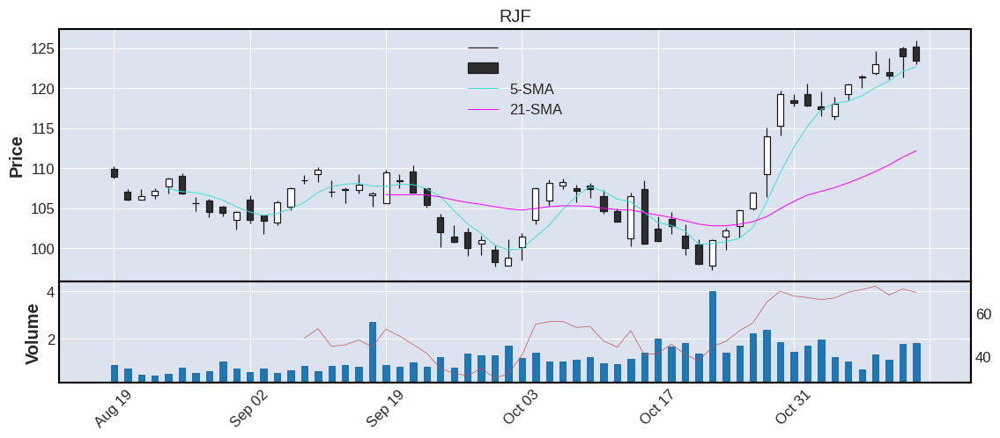



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
49    WFC  47.55  61.45  18.04    18.4 -0.83  1.15  2.42  Finance  0.0  United States    large


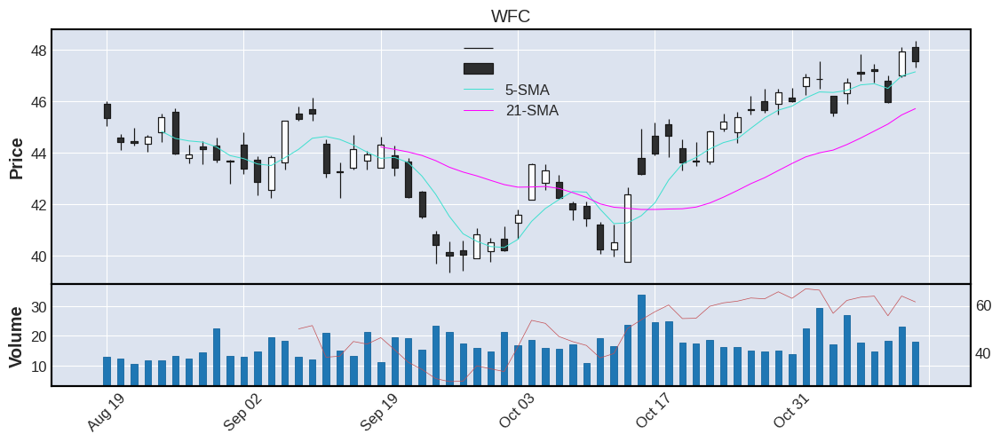



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR   SECTOR  IPO        COUNTRY CATEGORY
50    TRV  181.73  61.25  1.4     1.3 -0.86  3.79  2.09  Finance  0.0  United States    large


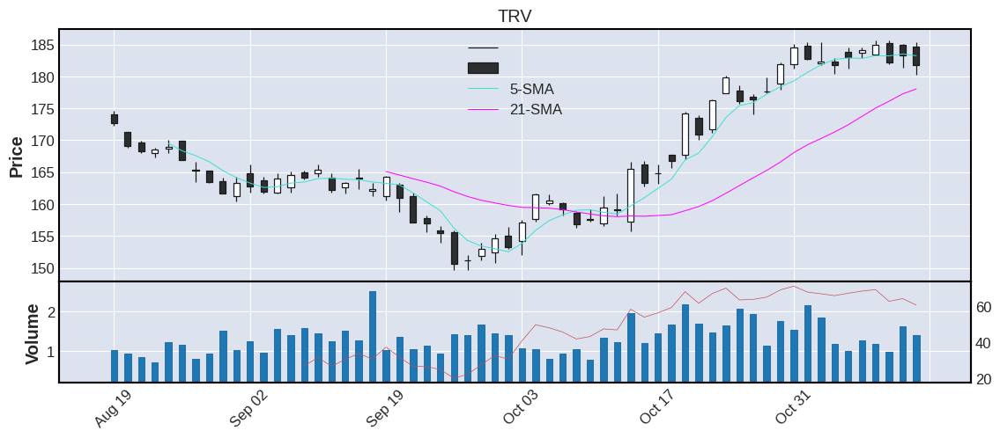



================================================== SECTOR 5: N-A [ %CHG ] ================================================== 

    TICKER       CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR SECTOR     IPO        COUNTRY CATEGORY
1    FBHS    67.25  68.75  1.38    1.43  2.37   2.80  4.16    N-A     0.0  United States   medium
2    OTIS    77.37  71.96  2.98    2.14  2.34   2.07  2.68    N-A  2020.0            N-A    large
3   BRK-B   309.72  67.59  6.56    4.42  2.15   6.97  2.25    N-A     0.0  United States     mega
4     WRK    37.66  68.62  3.94    2.78  1.92   1.16  3.08    N-A  2015.0            N-A   medium
5    ULTA   430.27  62.39  0.88    0.63  1.58  13.24  3.08    N-A  2007.0  United States    large
6     PHM    44.37  67.23  2.78    3.07  1.35   1.89  4.26    N-A     0.0  United States   medium
7     RCL    58.48  65.83  5.14    5.67  1.32   3.16  5.40    N-A  1993.0  United States    large
8     DHI    84.92  69.16  3.65    4.84  1.19   3.66  4.31    N-A     0.0  United Stat

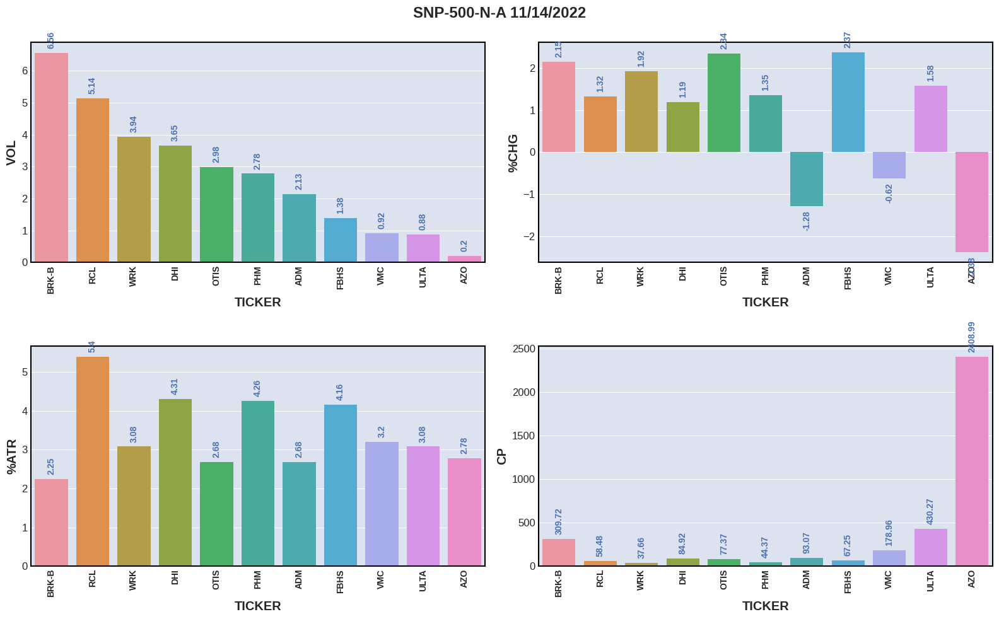

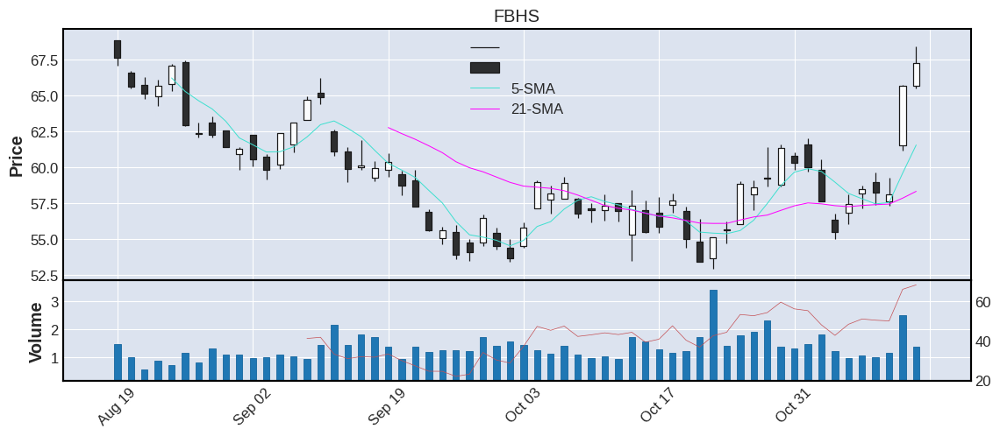



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR     IPO COUNTRY CATEGORY
2   OTIS  77.37  71.96  2.98    2.14  2.34  2.07  2.68    N-A  2020.0     N-A    large


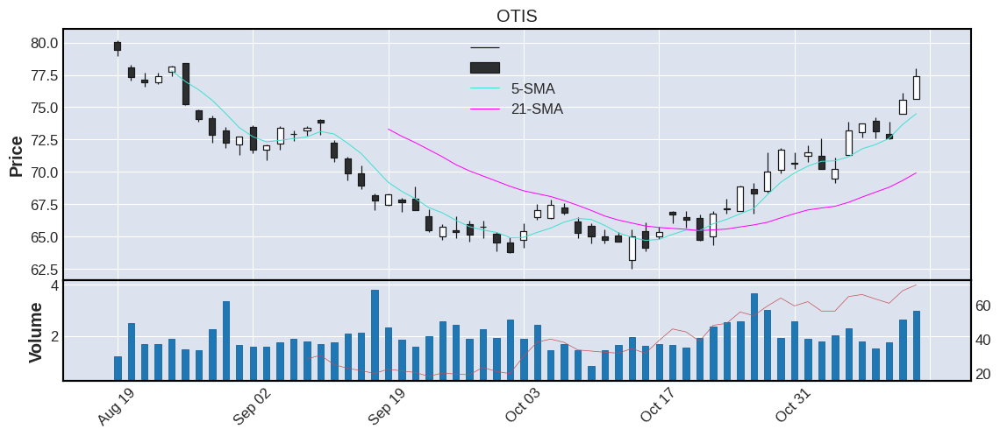



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
3  BRK-B  309.72  67.59  6.56    4.42  2.15  6.97  2.25    N-A  0.0  United States     mega


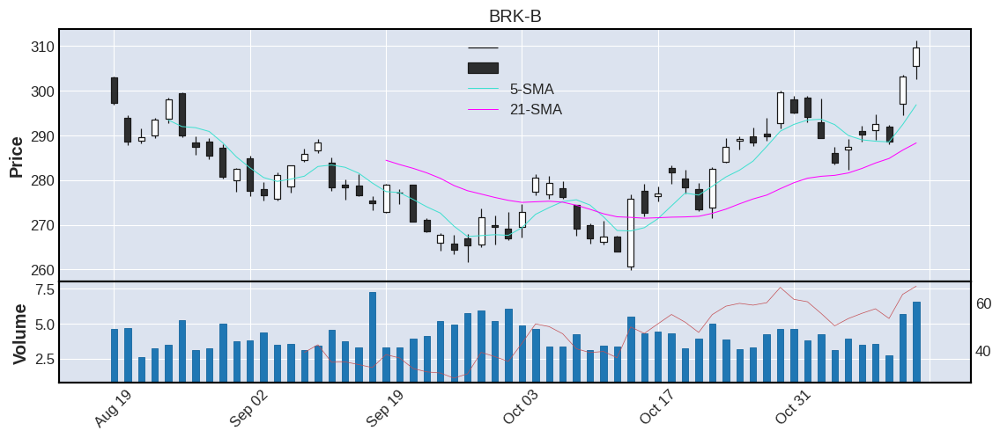



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR     IPO COUNTRY CATEGORY
4    WRK  37.66  68.62  3.94    2.78  1.92  1.16  3.08    N-A  2015.0     N-A   medium


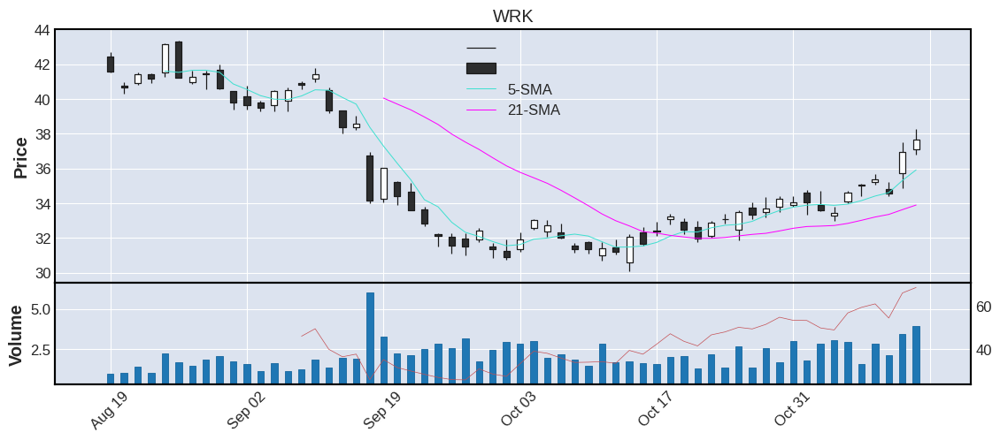



  TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR SECTOR     IPO        COUNTRY CATEGORY
5   ULTA  430.27  62.39  0.88    0.63  1.58  13.24  3.08    N-A  2007.0  United States    large


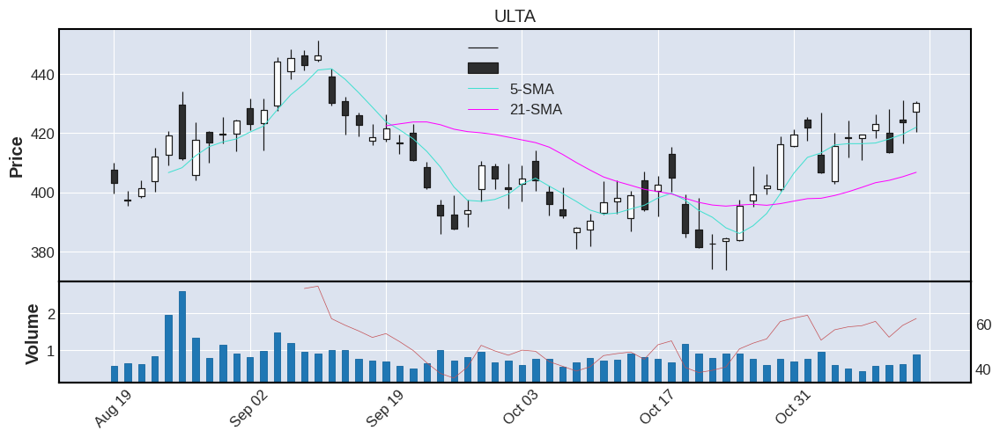



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
6    PHM  44.37  67.23  2.78    3.07  1.35  1.89  4.26    N-A  0.0  United States   medium


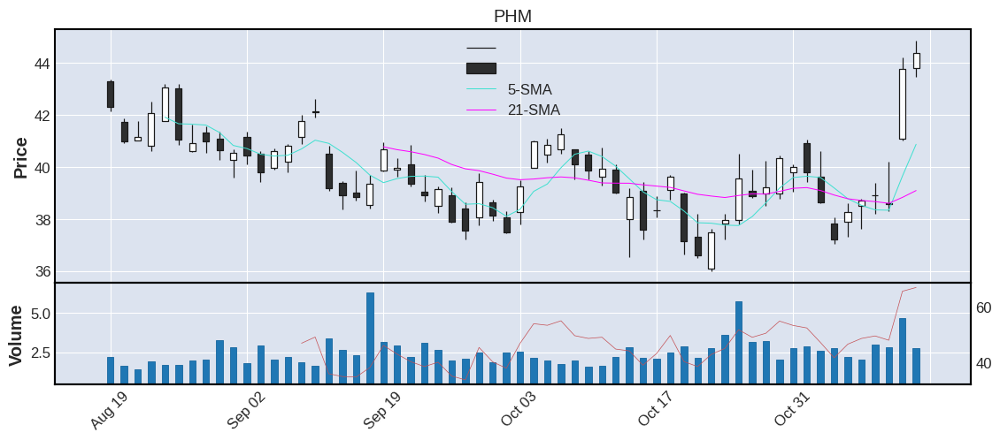



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR     IPO        COUNTRY CATEGORY
7    RCL  58.48  65.83  5.14    5.67  1.32  3.16   5.4    N-A  1993.0  United States    large


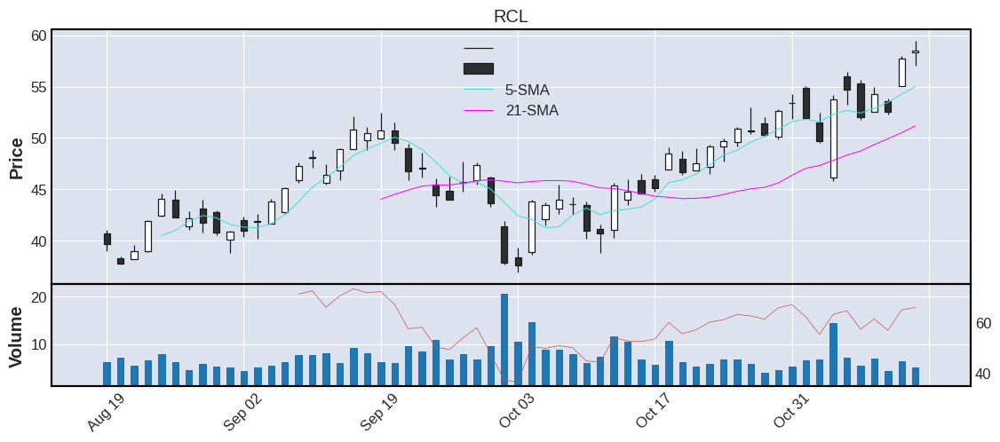



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
8    DHI  84.92  69.16  3.65    4.84  1.19  3.66  4.31    N-A  0.0  United States    large


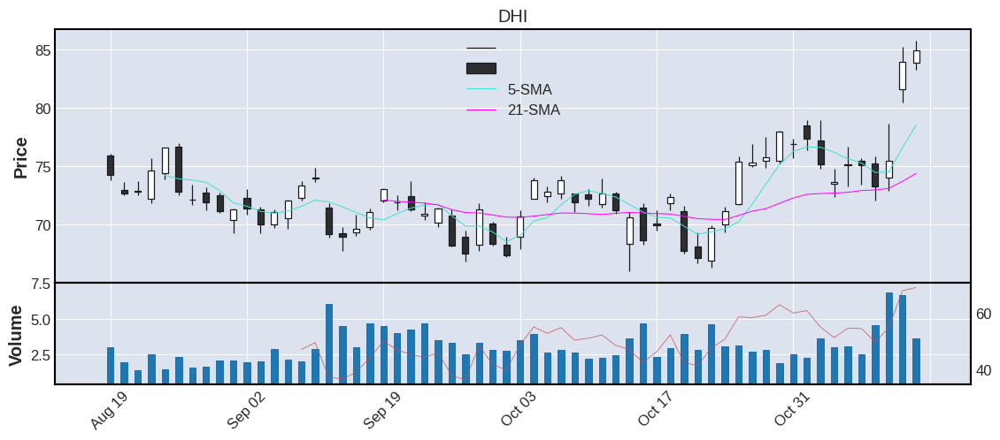



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
9    VMC  178.96  66.53  0.92    0.79 -0.62  5.72   3.2    N-A  0.0  United States    large


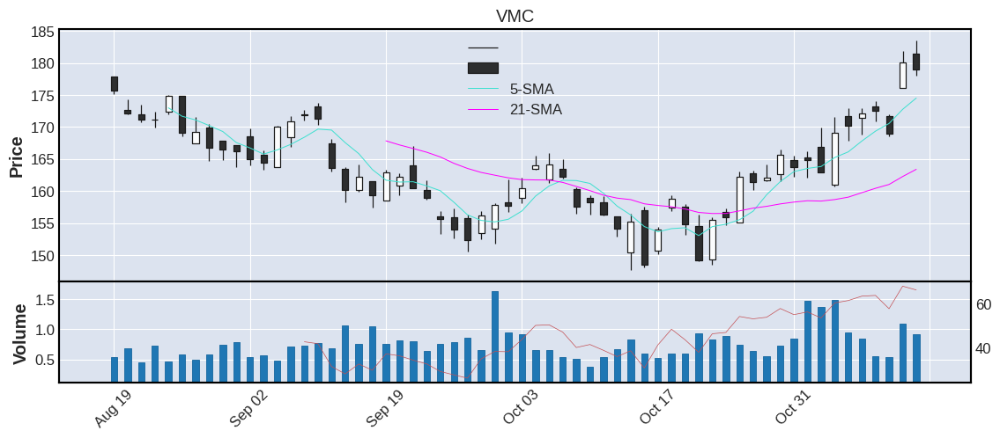



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
10    ADM  93.07  53.55  2.13    2.42 -1.28  2.49  2.68    N-A  0.0  United States    large


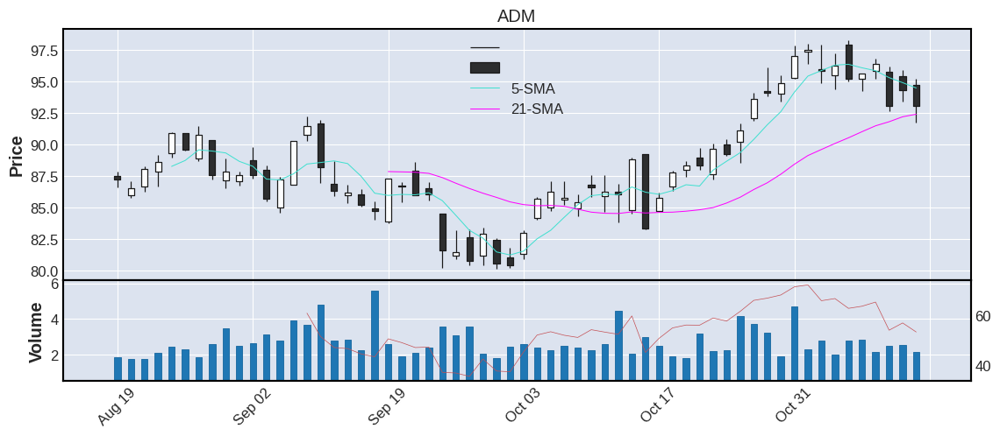



   TICKER       CP    RSI  VOL  AVGVOL  %CHG    ATR  %ATR SECTOR  IPO        COUNTRY CATEGORY
11    AZO  2408.99  51.97  0.2    0.14 -2.38  67.09  2.78    N-A  0.0  United States    large


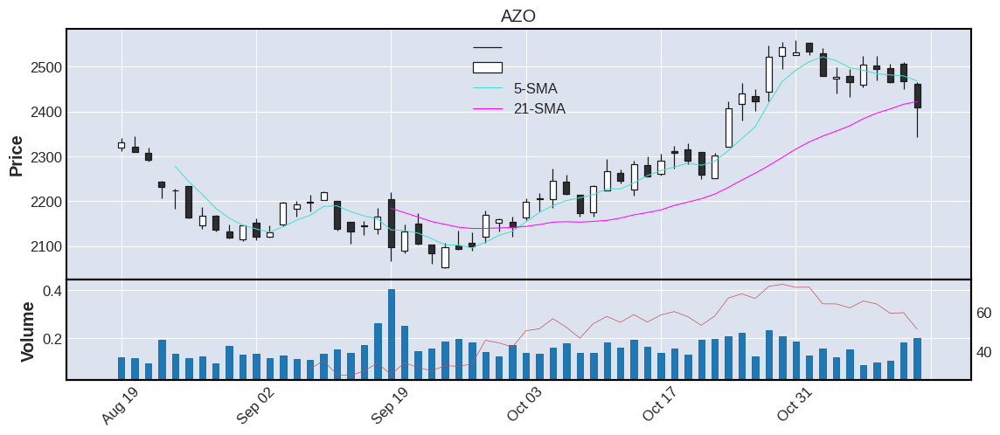



================================================== SECTOR 6: ENERGY [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR     IPO        COUNTRY CATEGORY
1     OXY   74.33  57.70  20.65   19.51  5.46  2.93  3.94  Energy     0.0  United States    large
2     PSX  111.30  73.68   4.97    3.77  4.76  3.36  3.02  Energy     0.0  United States    large
3     PXD  255.63  53.34   2.22    2.10  4.15  8.92  3.49  Energy     0.0  United States    large
4     HES  145.58  61.38   2.31    2.11   4.1  5.50  3.78  Energy     0.0  United States    large
5     DVN   71.80  51.40   9.49    8.97  4.09  3.44  4.79  Energy  1985.0  United States    large
6     MRO   32.88  64.70  11.54   13.03  4.05  1.25  3.80  Energy     0.0  United States    large
7     APA   48.76  62.90   5.93    6.65  3.74  2.20  4.51  Energy     0.0  United States    large
8     COP  133.96  62.60   8.66    7.04  3.48  4.74  3.54  Energy     0.0  United S

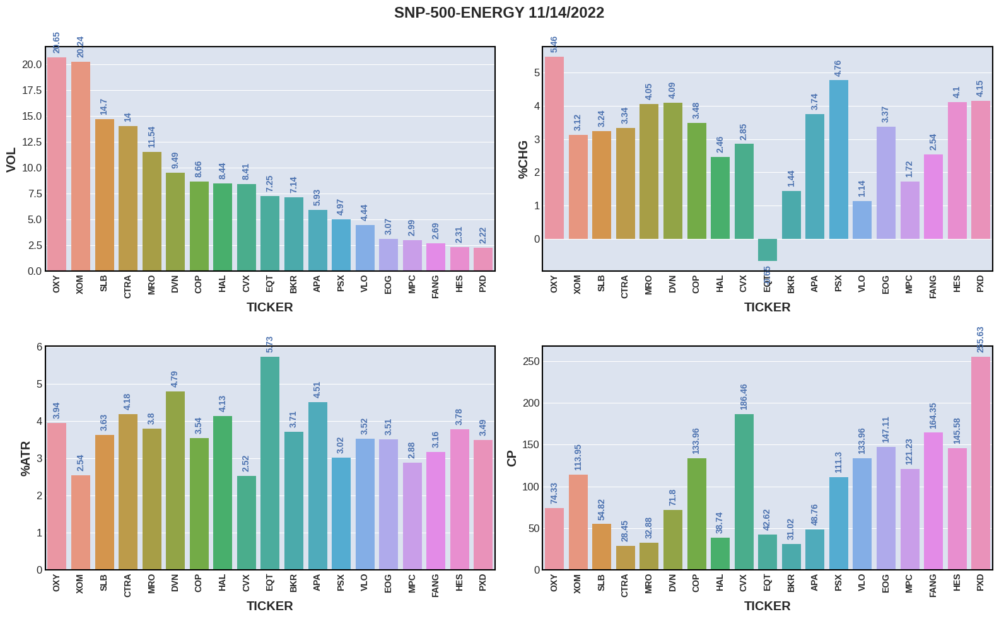

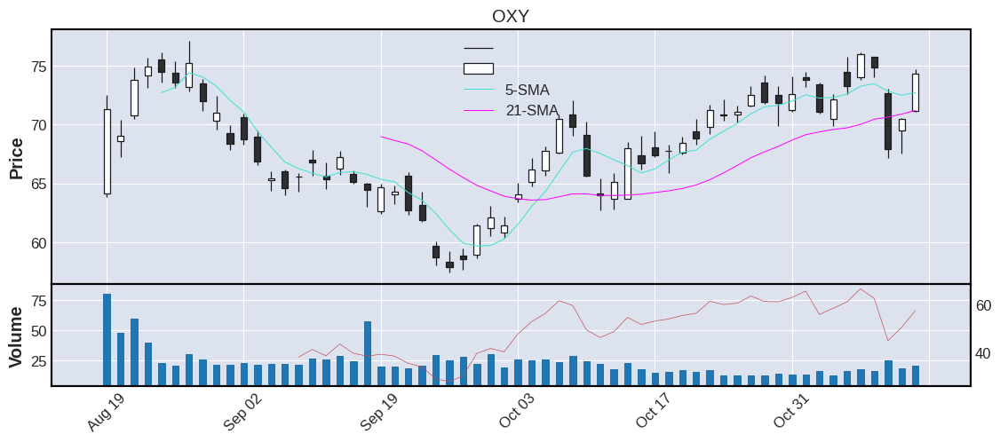



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
2    PSX  111.3  73.68  4.97    3.77  4.76  3.36  3.02  Energy  0.0  United States    large


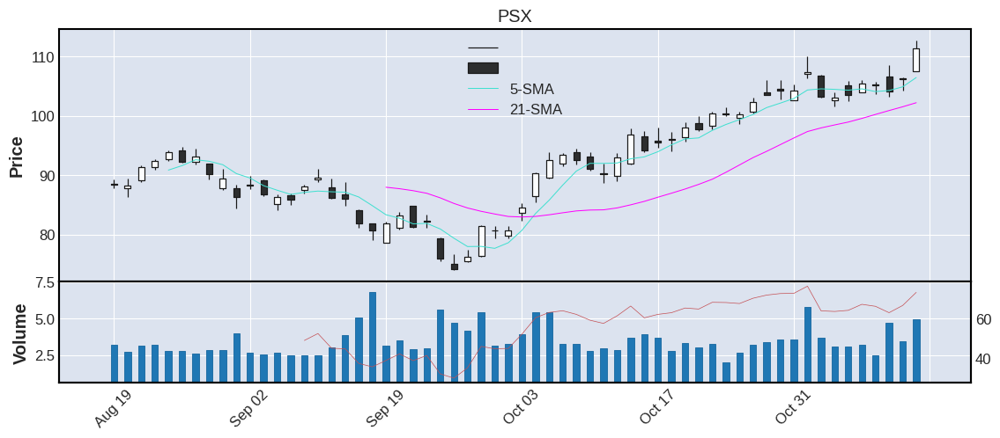



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
3    PXD  255.63  53.34  2.22     2.1  4.15  8.92  3.49  Energy  0.0  United States    large


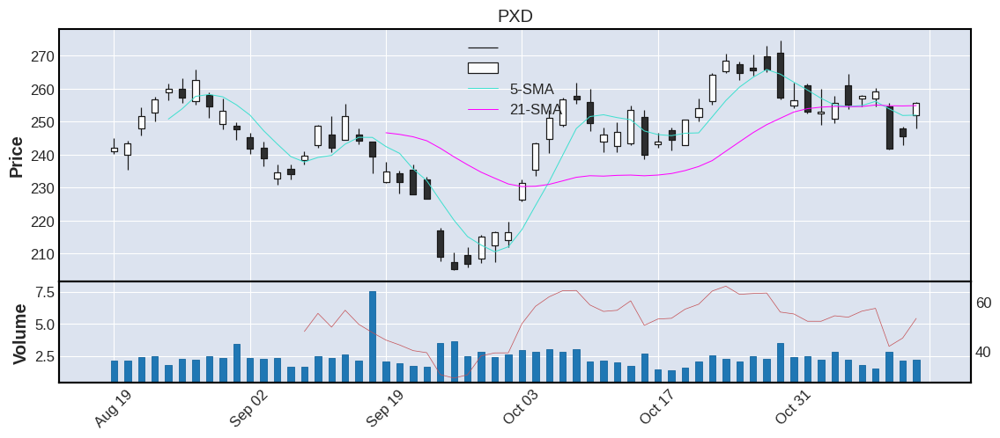



  TICKER      CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
4    HES  145.58  61.38  2.31    2.11  4.1  5.5  3.78  Energy  0.0  United States    large


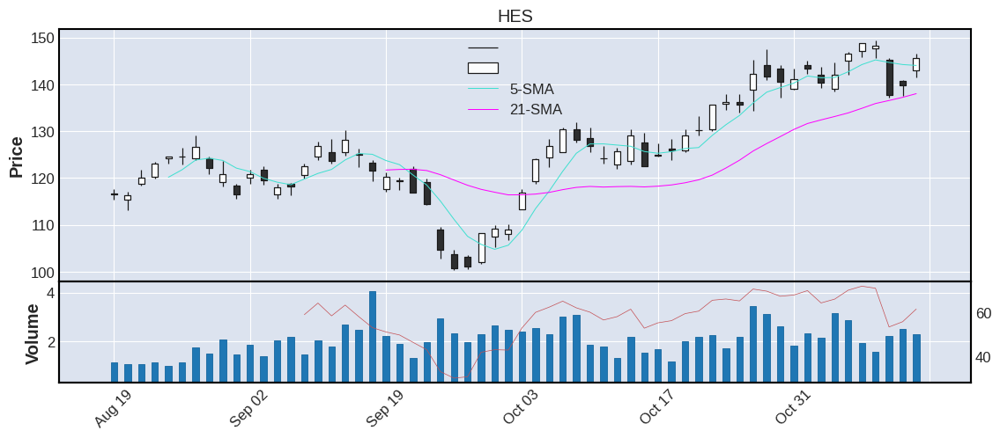



  TICKER    CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR     IPO        COUNTRY CATEGORY
5    DVN  71.8  51.4  9.49    8.97  4.09  3.44  4.79  Energy  1985.0  United States    large


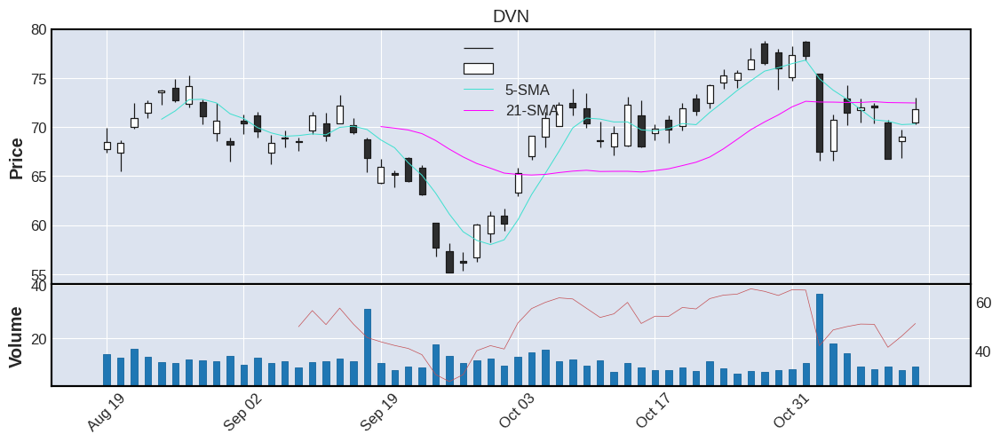



  TICKER     CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
6    MRO  32.88  64.7  11.54   13.03  4.05  1.25   3.8  Energy  0.0  United States    large


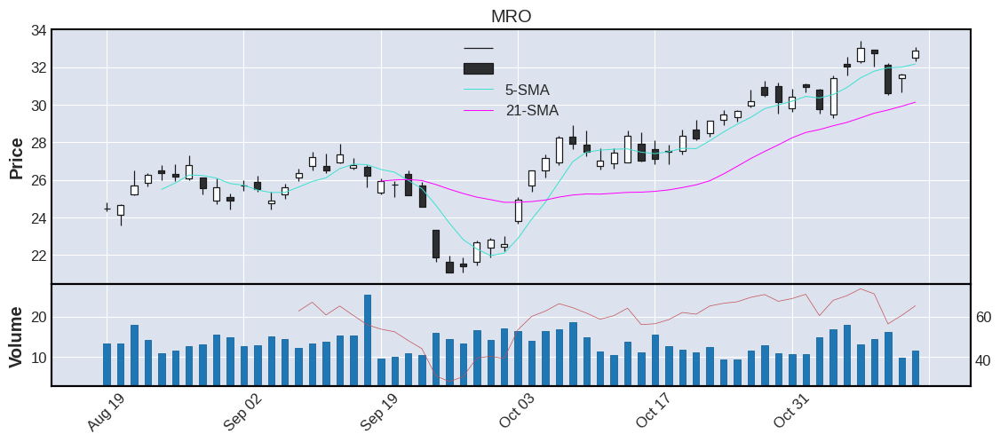



  TICKER     CP   RSI   VOL  AVGVOL  %CHG  ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
7    APA  48.76  62.9  5.93    6.65  3.74  2.2  4.51  Energy  0.0  United States    large


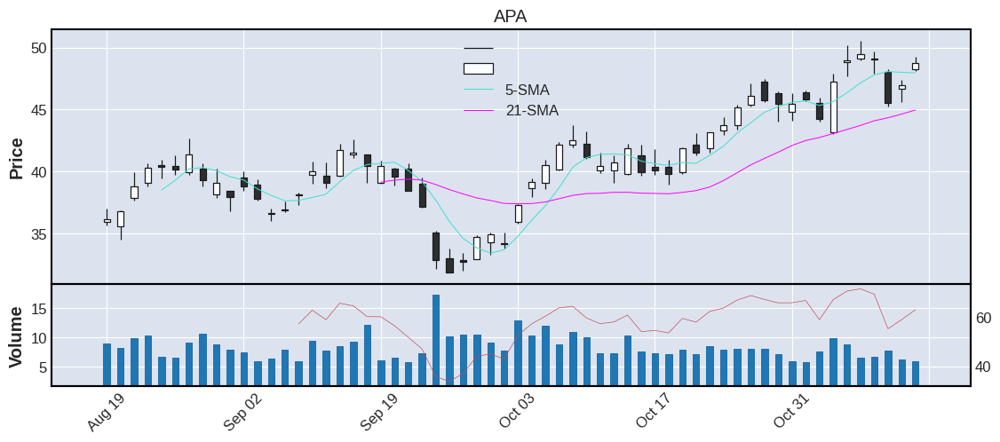



  TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
8    COP  133.96  62.6  8.66    7.04  3.48  4.74  3.54  Energy  0.0  United States    large


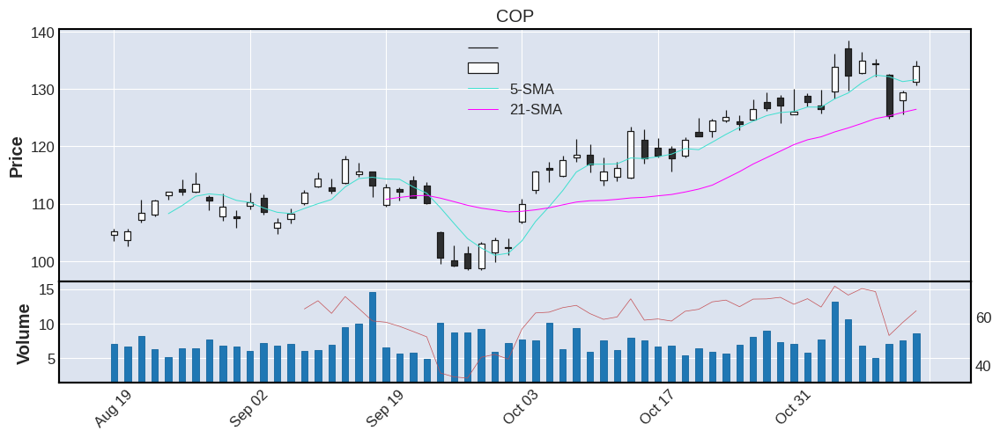



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
9    EOG  147.11  66.32  3.07    3.91  3.37  5.17  3.51  Energy  0.0  United States    large


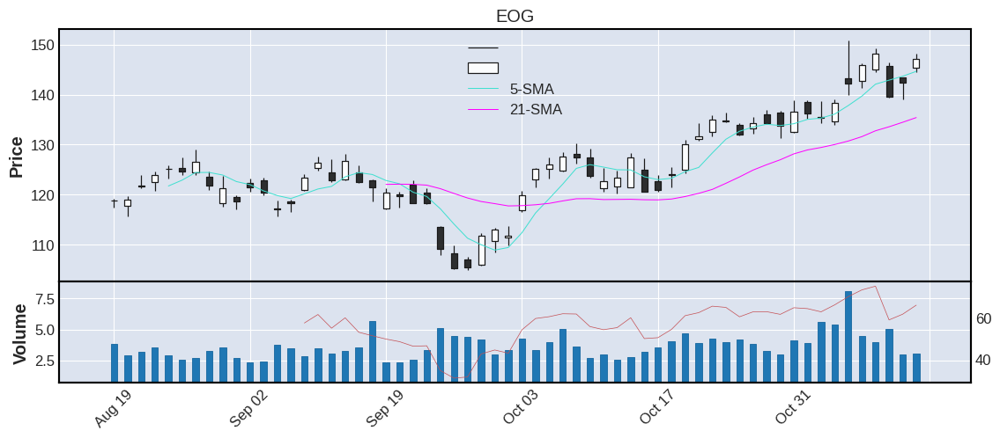



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
10   CTRA  28.45  45.89  14.0   14.83  3.34  1.19  4.18  Energy  0.0  United States    large


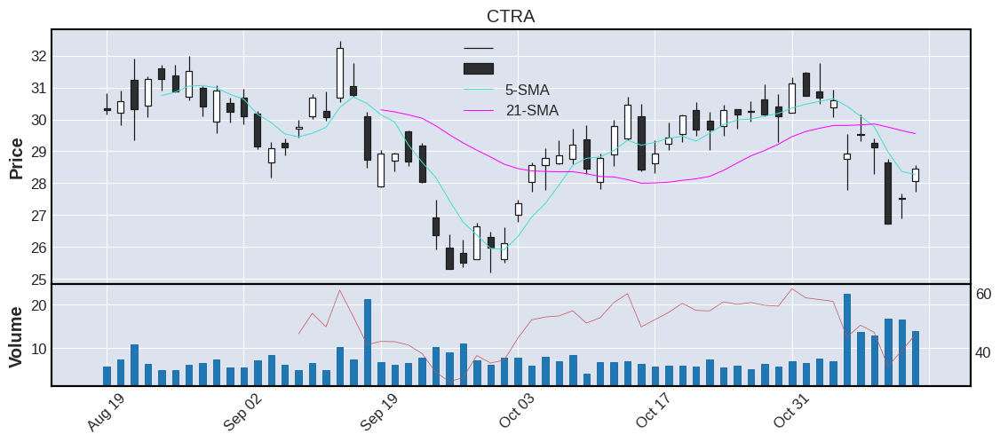



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO COUNTRY CATEGORY
11    SLB  54.82  70.74  14.7   16.96  3.24  1.99  3.63  Energy  0.0  France    large


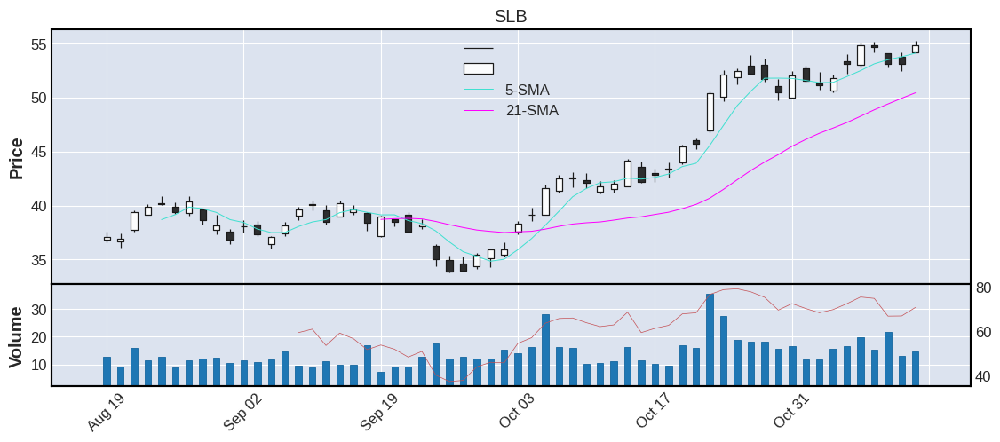



   TICKER      CP    RSI    VOL  AVGVOL  %CHG  ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
12    XOM  113.95  65.56  20.24   18.12  3.12  2.9  2.54  Energy  0.0  United States     mega


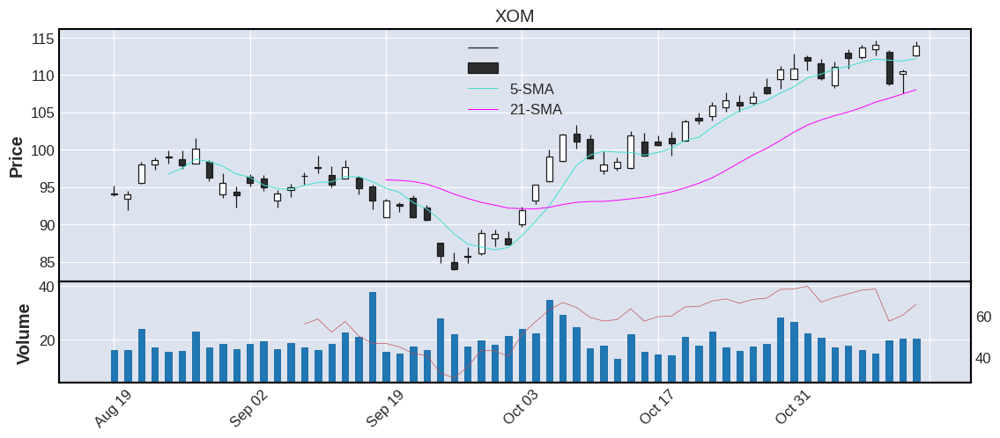



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
13    CVX  186.46  66.87  8.41    7.46  2.85  4.7  2.52  Energy  0.0  United States     mega


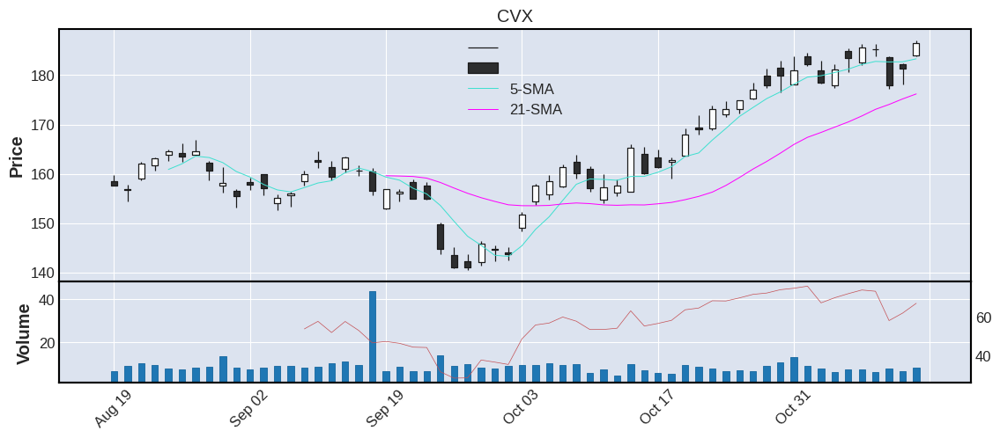



   TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR  SECTOR     IPO        COUNTRY CATEGORY
14   FANG  164.35  67.23  2.69    2.74  2.54  5.2  3.16  Energy  2012.0  United States    large


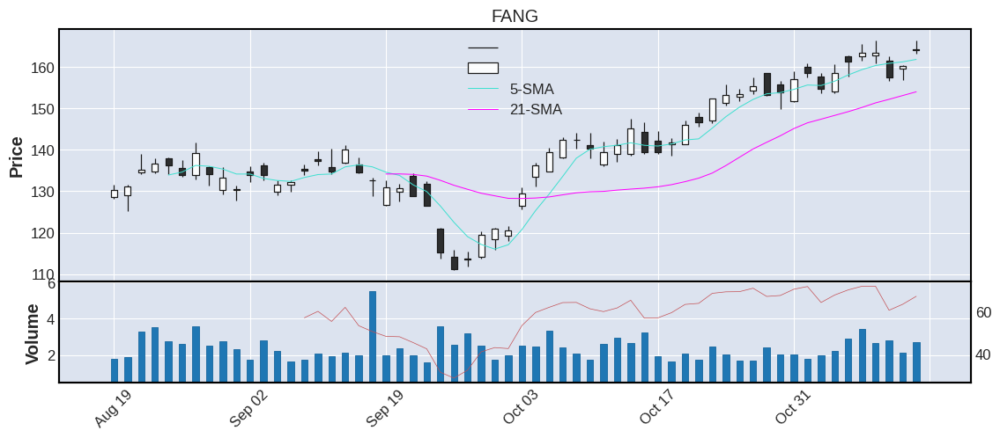



   TICKER     CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
15    HAL  38.74  66.51  8.44     9.0  2.46  1.6  4.13  Energy  0.0  United States    large


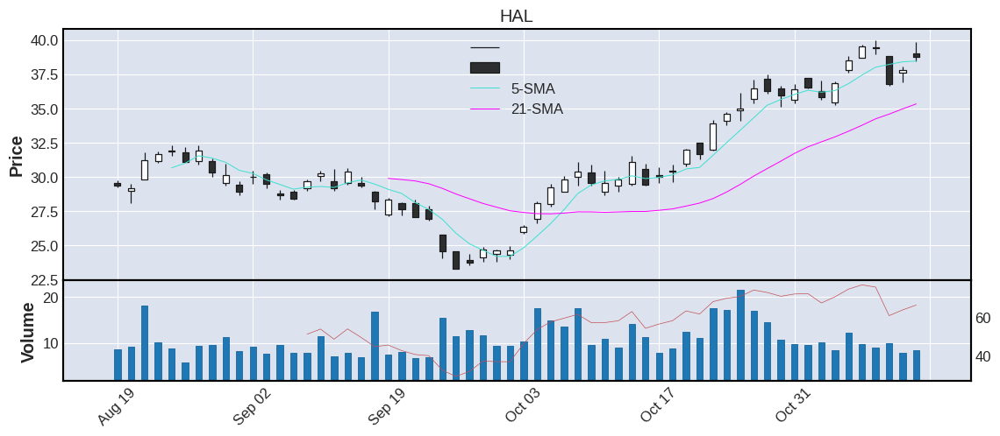



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
16    MPC  121.23  66.42  2.99    3.07  1.72  3.49  2.88  Energy  0.0  United States    large


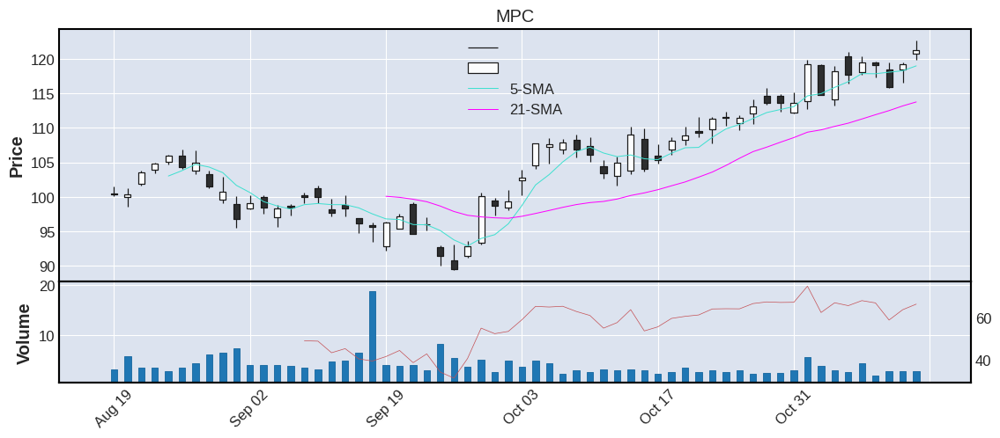



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
17    BKR  31.02  70.06  7.14    7.11  1.44  1.15  3.71  Energy  0.0  United States    large


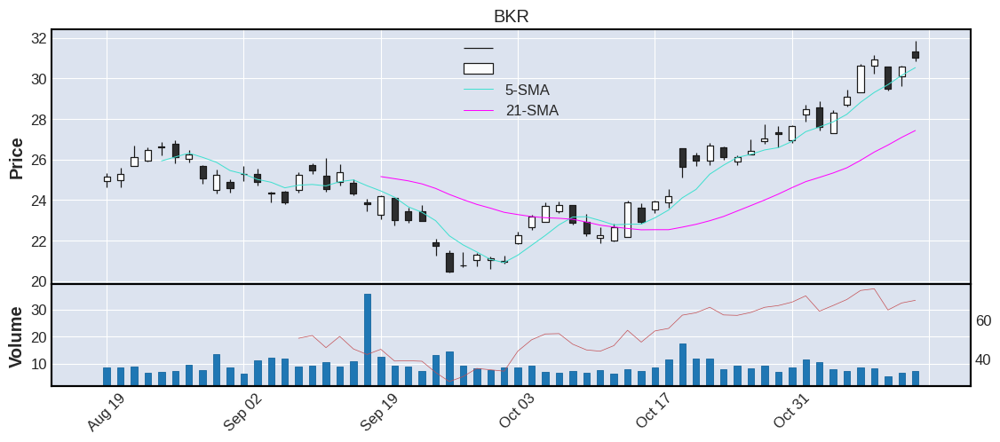



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
18    VLO  133.96  62.79  4.44     3.8  1.14  4.71  3.52  Energy  0.0  United States    large


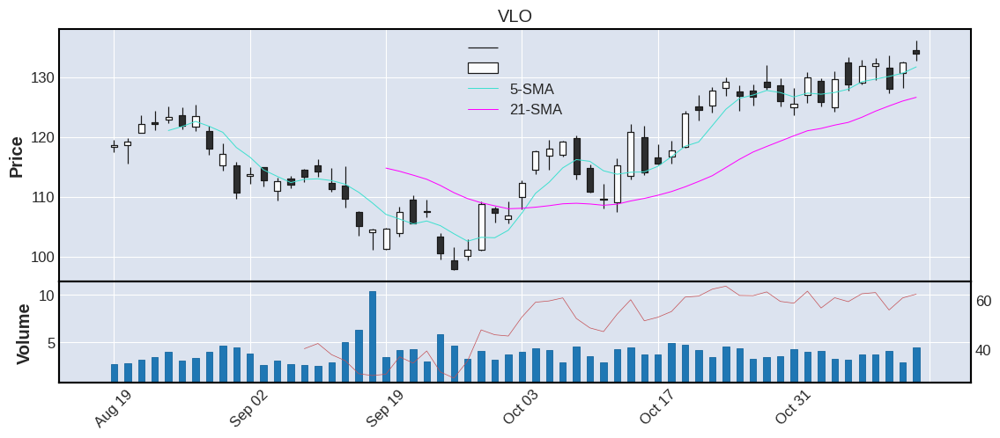



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR  IPO        COUNTRY CATEGORY
19    EQT  42.62  52.35  7.25    6.64 -0.65  2.44  5.73  Energy  0.0  United States    large


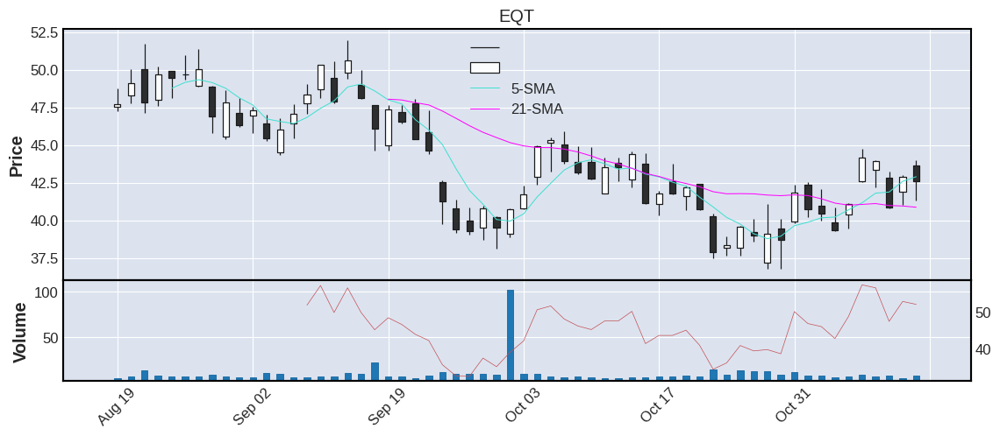



================================================== SECTOR 7: CONSUMER_STAPLES [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR     IPO        COUNTRY CATEGORY
1     WBA   41.26  73.35  12.85    9.84   7.2  1.26  3.05  Consumer_Staples     0.0  United States    large
2     MKC   83.77  67.95   1.82    1.28  2.33  2.16  2.58  Consumer_Staples     0.0  United States    large
3     TSN   67.41  50.70   4.79    4.09  1.43  1.78  2.64  Consumer_Staples     0.0  United States    large
4     STZ  247.00  60.25   1.48    1.02  1.22  6.15  2.49  Consumer_Staples     0.0  United States    large
5     TAP   51.90  58.98   1.44    1.14  0.87  1.46  2.81  Consumer_Staples     0.0         Canada    large
6      KO   61.32  64.30  18.93   12.96  0.72  1.14  1.86  Consumer_Staples     0.0  United States     mega
7    MDLZ   64.80  68.64   6.13    6.71 -0.28  1.32  2.04  Consumer_Staples     0.0  United States   

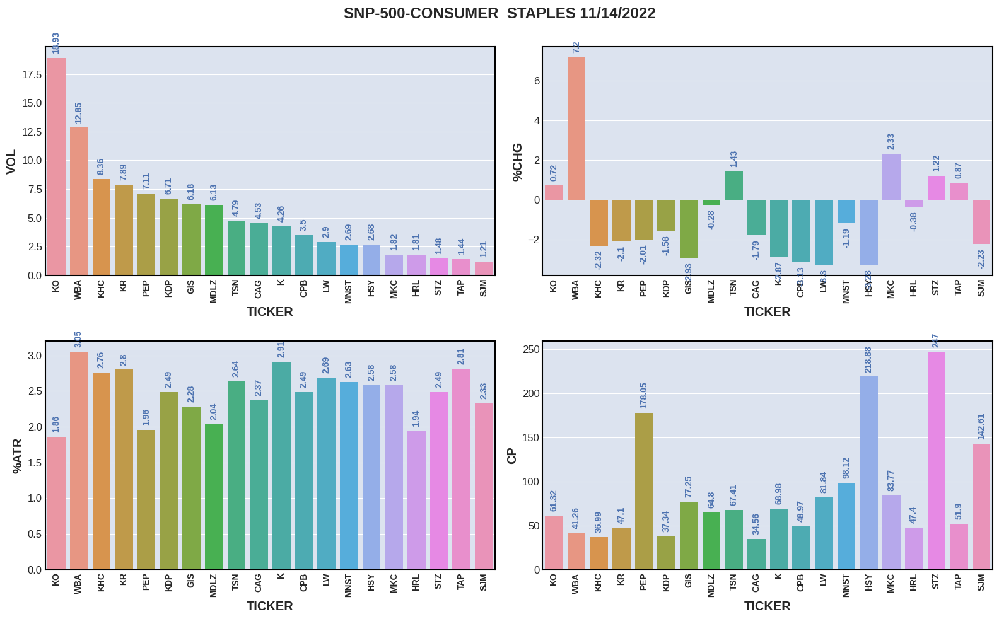

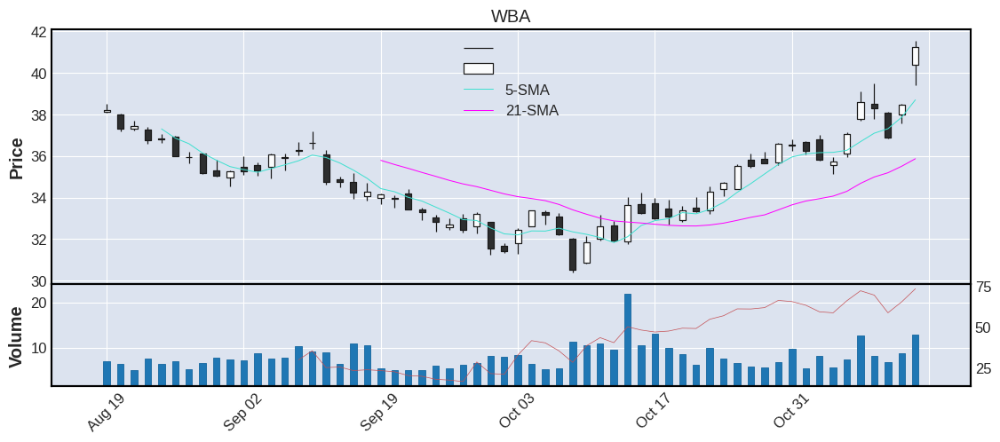



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
2    MKC  83.77  67.95  1.82    1.28  2.33  2.16  2.58  Consumer_Staples  0.0  United States    large


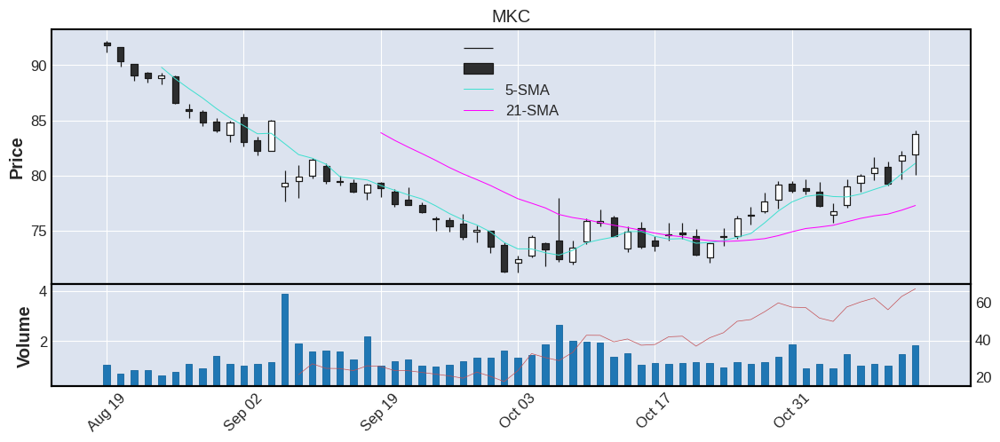



  TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
3    TSN  67.41  50.7  4.79    4.09  1.43  1.78  2.64  Consumer_Staples  0.0  United States    large


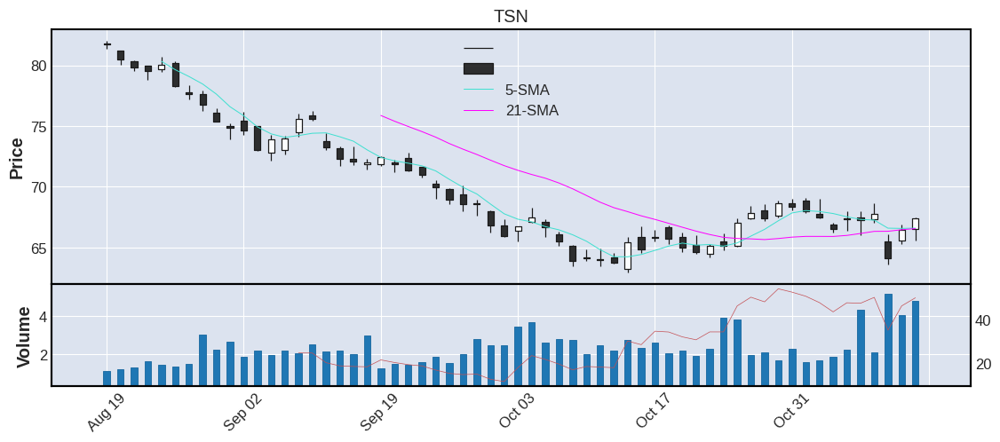



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
4    STZ  247.0  60.25  1.48    1.02  1.22  6.15  2.49  Consumer_Staples  0.0  United States    large


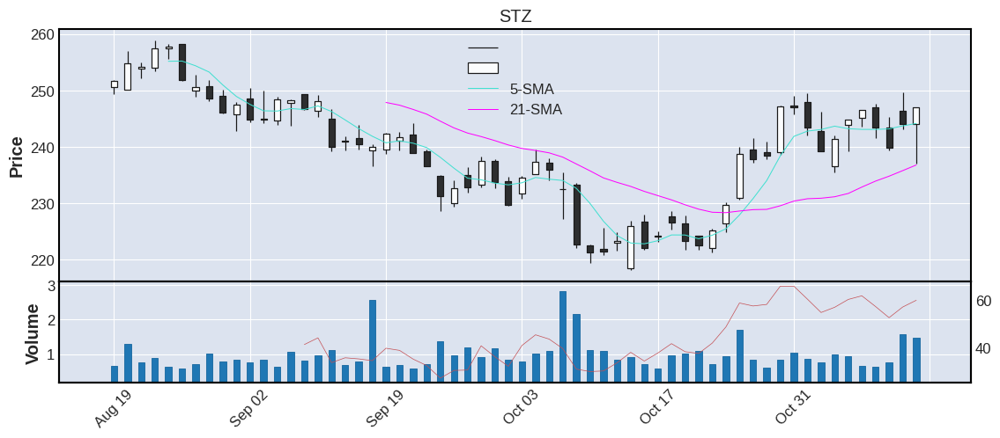



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO COUNTRY CATEGORY
5    TAP  51.9  58.98  1.44    1.14  0.87  1.46  2.81  Consumer_Staples  0.0  Canada    large


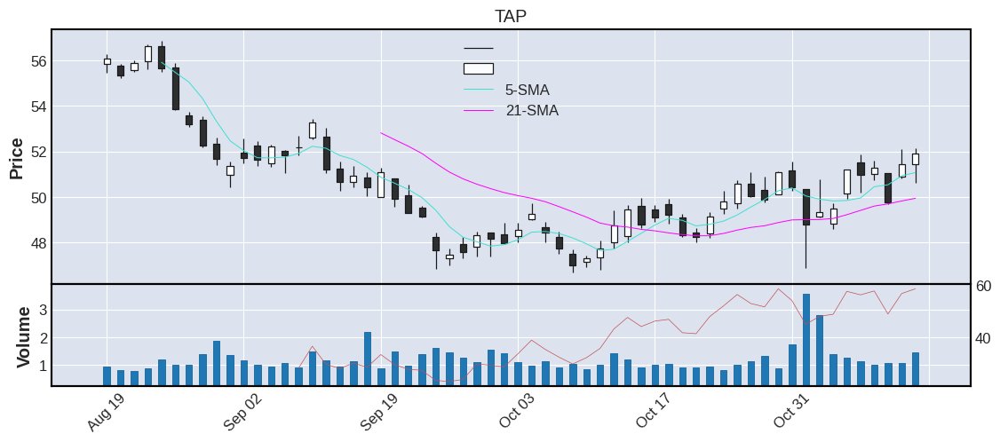



  TICKER     CP   RSI    VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
6     KO  61.32  64.3  18.93   12.96  0.72  1.14  1.86  Consumer_Staples  0.0  United States     mega


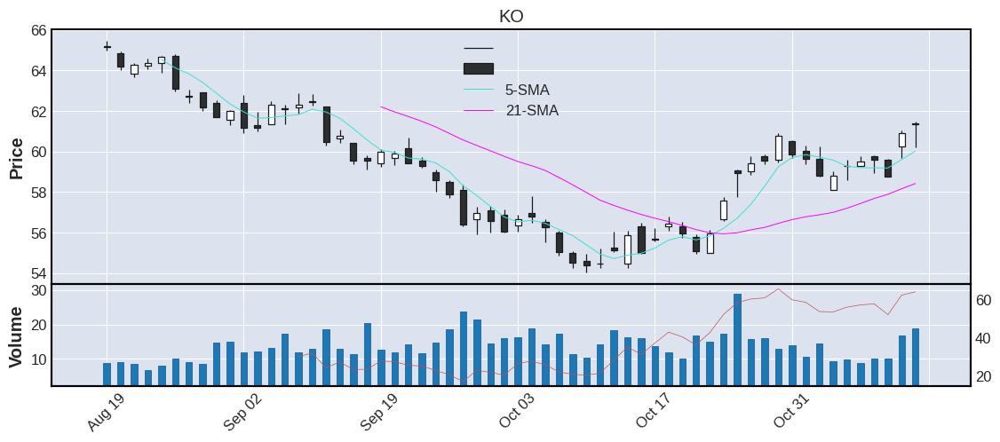



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
7   MDLZ  64.8  68.64  6.13    6.71 -0.28  1.32  2.04  Consumer_Staples  0.0  United States    large


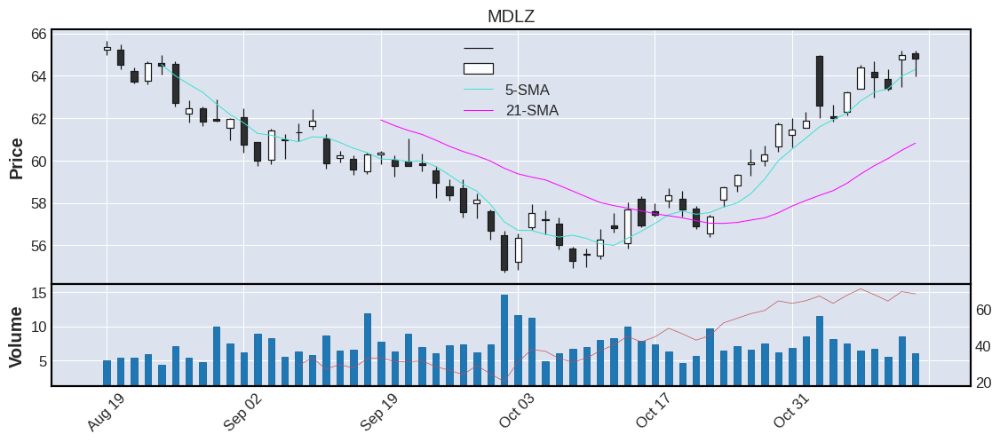



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
8    HRL  47.4  58.21  1.81    1.48 -0.38  0.92  1.94  Consumer_Staples  0.0  United States    large


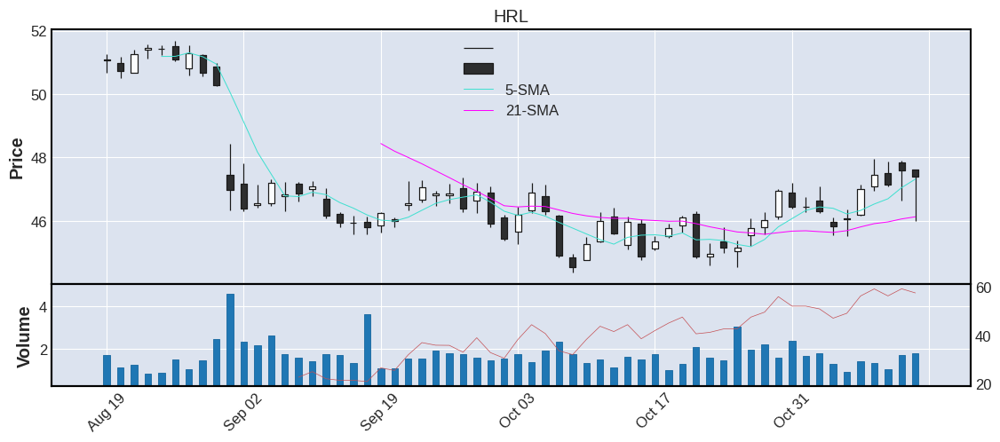



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
9   MNST  98.12  61.58  2.69    2.73 -1.19  2.58  2.63  Consumer_Staples  0.0  United States    large


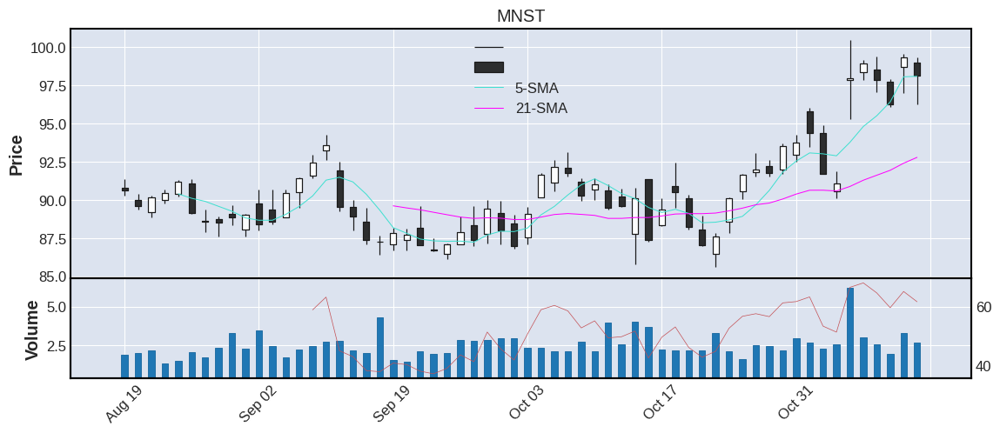



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
10    KDP  37.34  47.64  6.71    6.91 -1.58  0.93  2.49  Consumer_Staples  0.0  United States    large


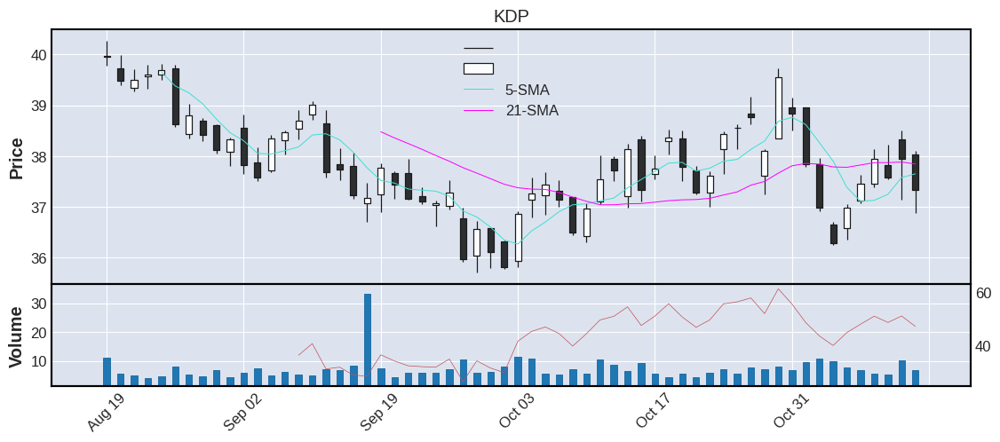



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
11    CAG  34.56  43.79  4.53    3.58 -1.79  0.82  2.37  Consumer_Staples  0.0  United States    large


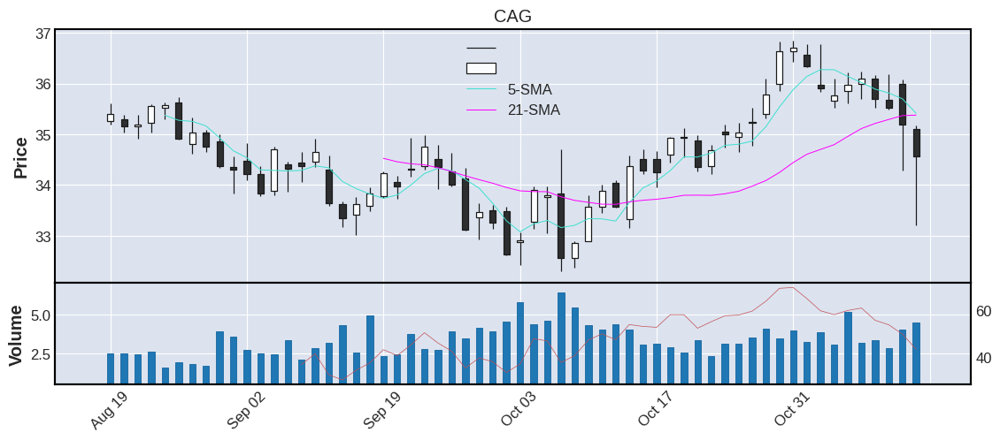



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
12    PEP  178.05  53.5  7.11     5.1 -2.01  3.49  1.96  Consumer_Staples  0.0  United States     mega


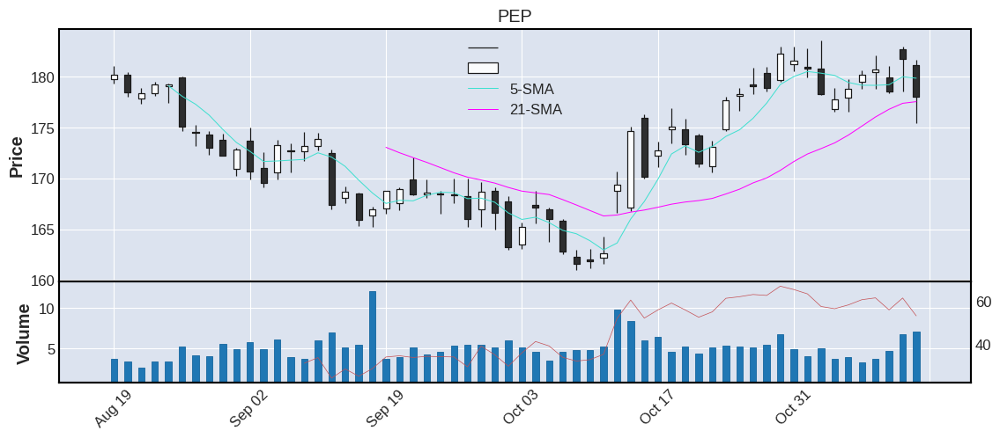



   TICKER    CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
13     KR  47.1  55.19  7.89    5.37 -2.1  1.32   2.8  Consumer_Staples  0.0  United States    large


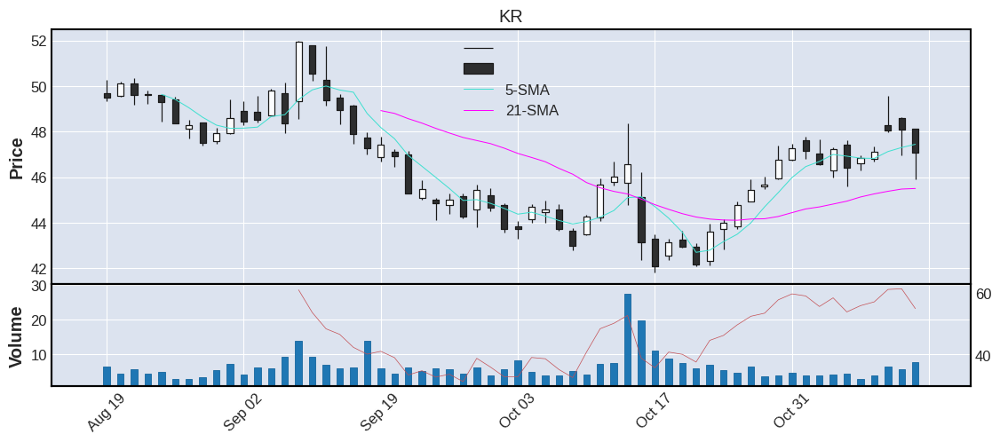



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
14    SJM  142.61  42.01  1.21    0.82 -2.23  3.32  2.33  Consumer_Staples  0.0  United States    large


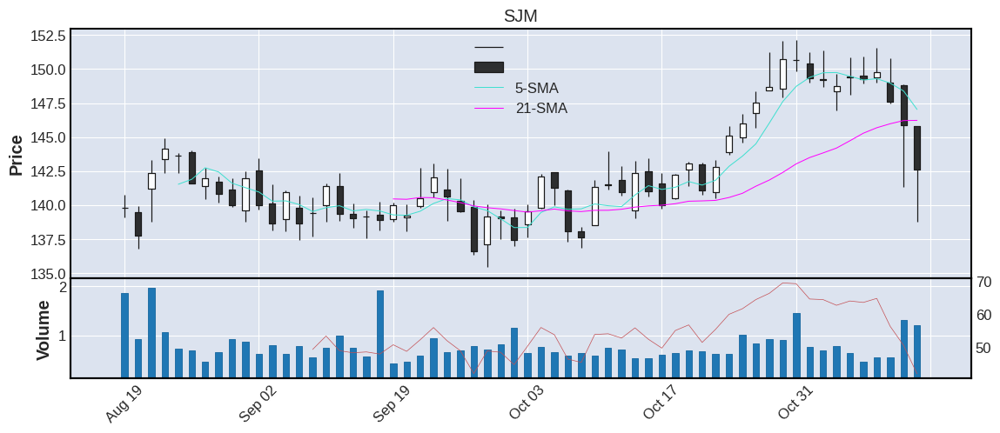



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
15    KHC  36.99  50.38  8.36    6.32 -2.32  1.02  2.76  Consumer_Staples  0.0  United States    large


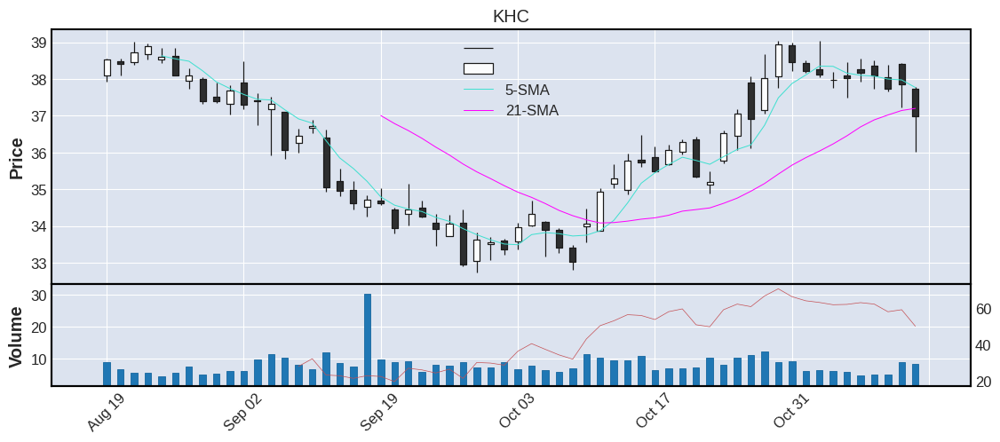



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
16      K  68.98  37.52  4.26    2.73 -2.87  2.01  2.91  Consumer_Staples  0.0  United States    large


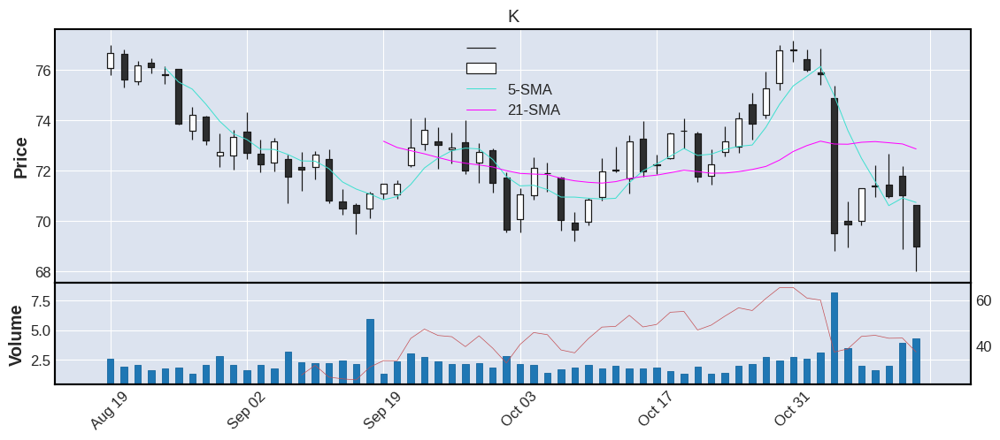



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
17    GIS  77.25  43.39  6.18    4.32 -2.93  1.76  2.28  Consumer_Staples  0.0  United States    large


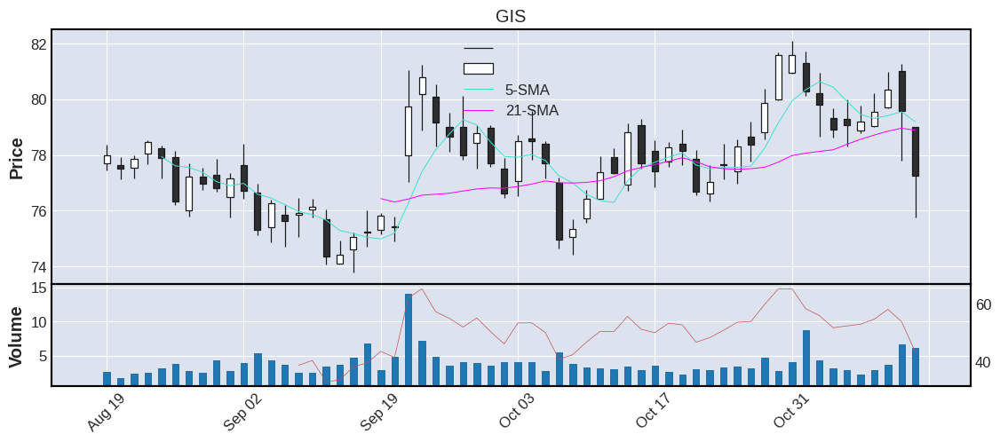



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
18    CPB  48.97  39.85  3.5     2.5 -3.13  1.22  2.49  Consumer_Staples  0.0  United States    large


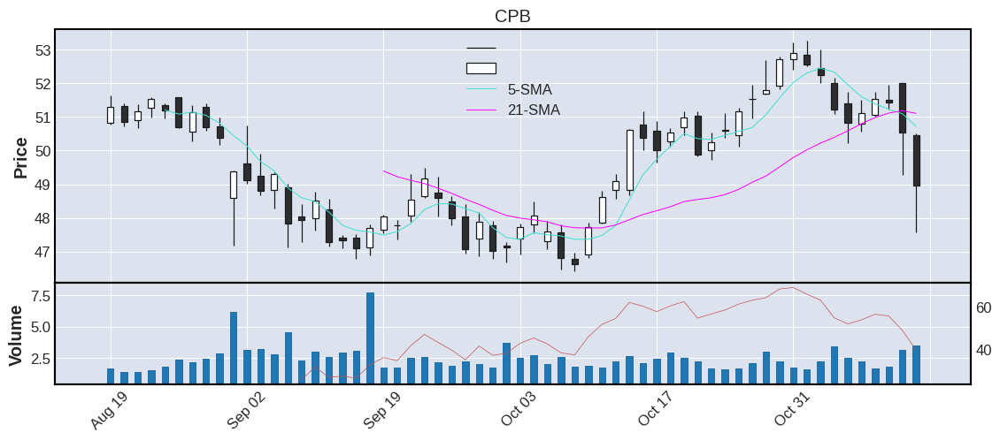



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR            SECTOR  IPO        COUNTRY CATEGORY
19    HSY  218.88  35.24  2.68    1.44 -3.28  5.65  2.58  Consumer_Staples  0.0  United States    large


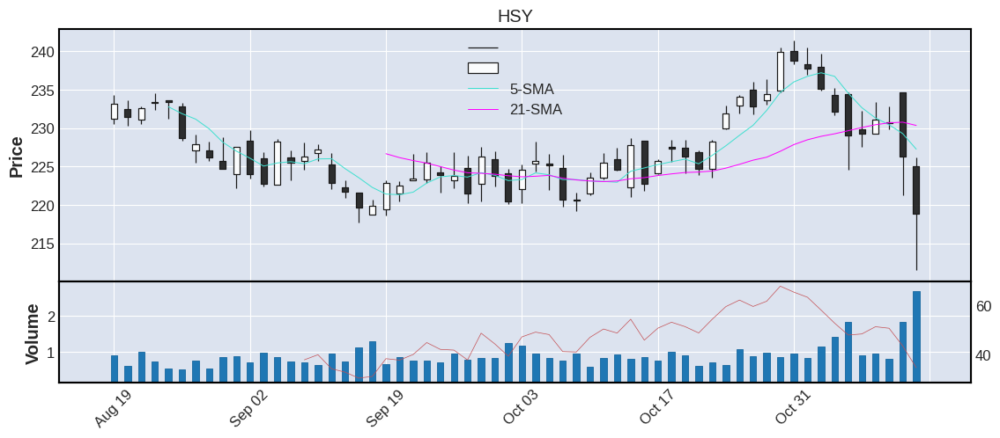



   TICKER     CP    RSI  VOL  AVGVOL %CHG  ATR  %ATR            SECTOR     IPO COUNTRY CATEGORY
20     LW  81.84  43.75  2.9    1.64 -3.3  2.2  2.69  Consumer_Staples  2016.0     N-A    large


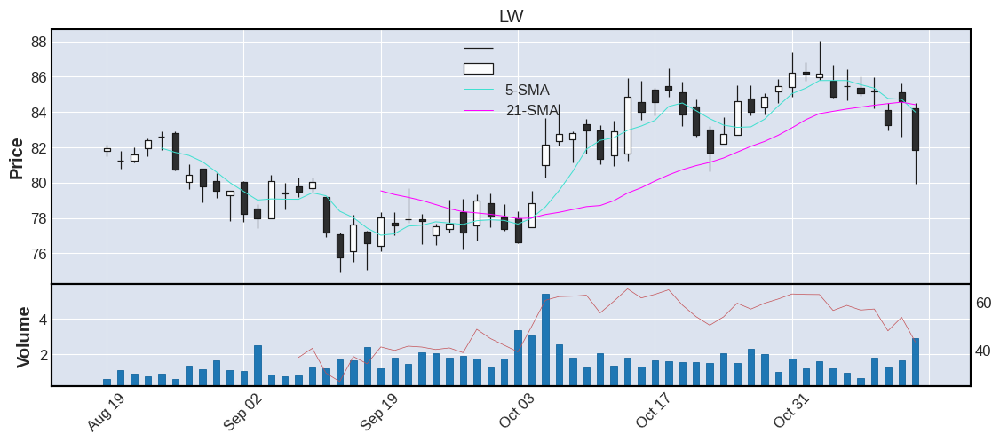



================================================== SECTOR 8: INDUSTRIALS [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
1     DOW   53.14  69.46   9.01    6.26  6.37   1.70  3.20  Industrials  2019.0            N-A    large
2    BALL   56.81  68.06   3.28    2.12  6.19   2.23  3.93  Industrials     0.0  United States    large
3     LYB   89.06  64.73   2.72    2.11  6.07   3.29  3.69  Industrials     0.0    Netherlands    large
4      CE  110.56  68.68   2.03    1.70  6.01   4.24  3.84  Industrials  2005.0  United States   medium
5     EMN   89.49  70.15   1.46    1.16  5.12   3.04  3.40  Industrials     0.0  United States   medium
6     NWL   14.12  49.06   4.15    4.08  4.98   0.62  4.39  Industrials     0.0  United States   medium
7    TRMB   62.00  60.21   1.26    2.28   4.8   2.57  4.15  Industrials  1990.0  United States    large
8     IFF  100.54  60.21   2.1

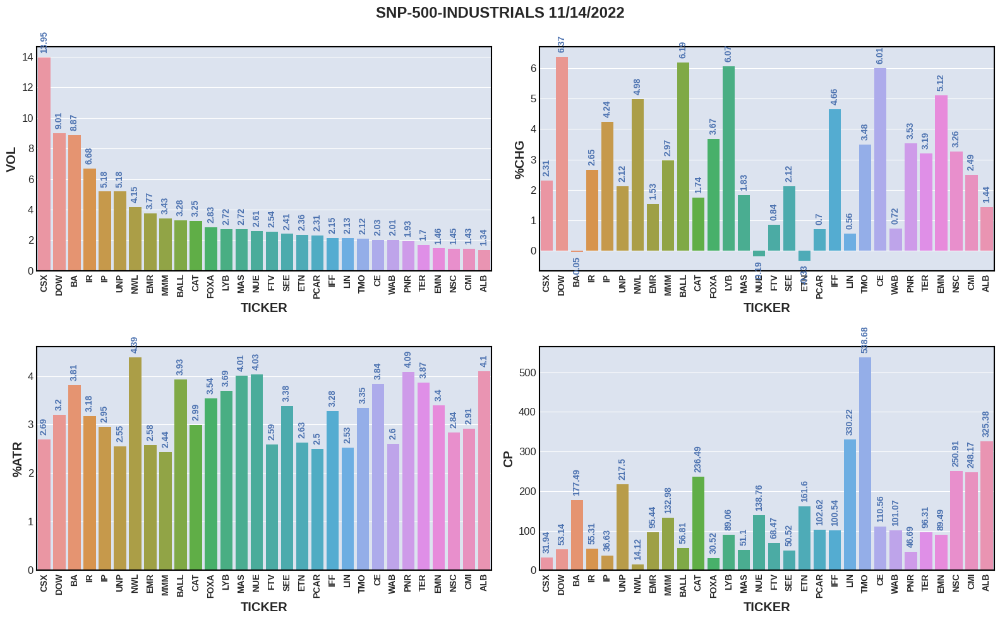

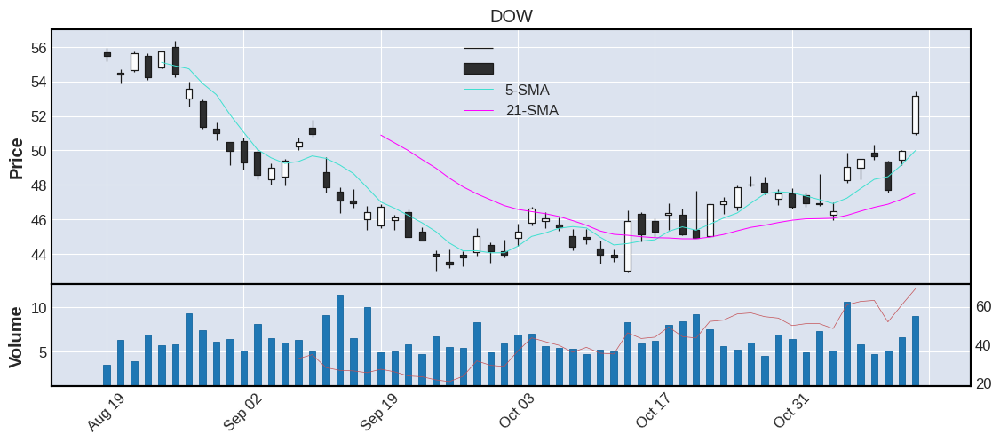



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
2   BALL  56.81  68.06  3.28    2.12  6.19  2.23  3.93  Industrials  0.0  United States    large


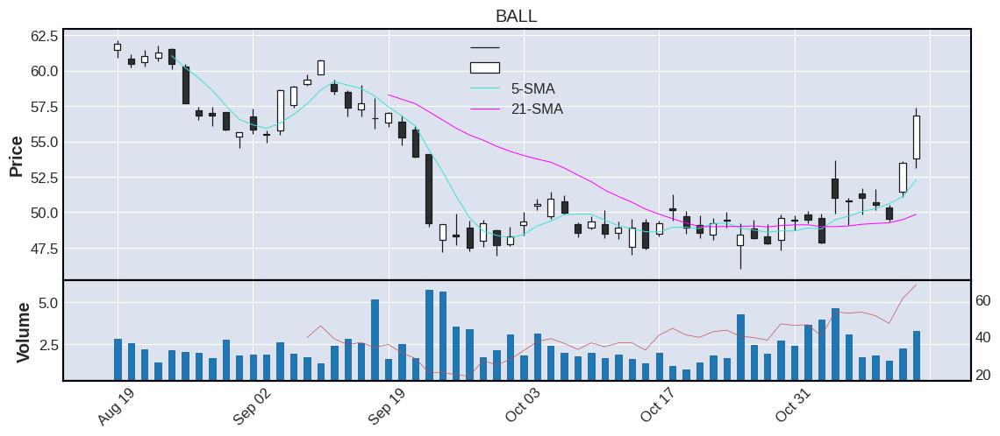



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO      COUNTRY CATEGORY
3    LYB  89.06  64.73  2.72    2.11  6.07  3.29  3.69  Industrials  0.0  Netherlands    large


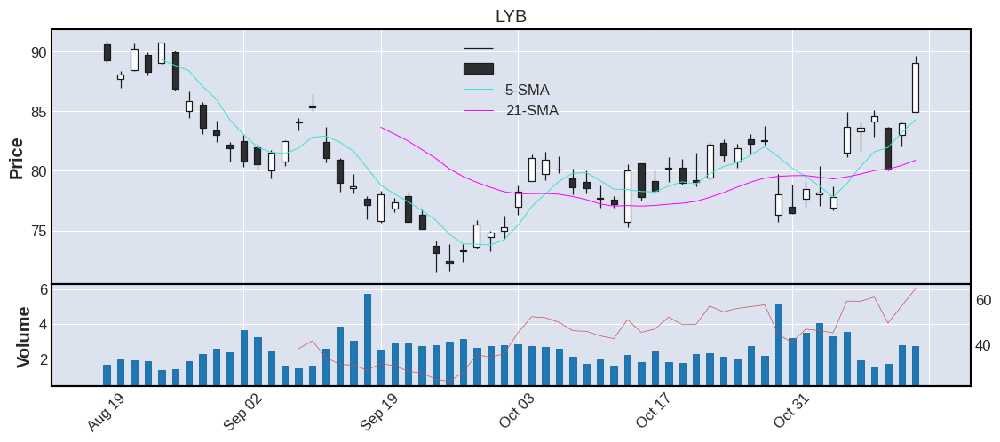



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
4     CE  110.56  68.68  2.03     1.7  6.01  4.24  3.84  Industrials  2005.0  United States   medium


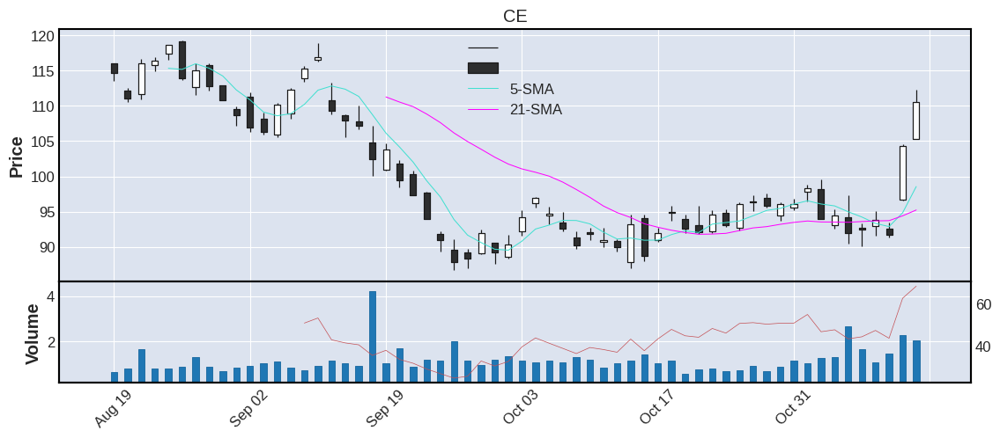



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
5    EMN  89.49  70.15  1.46    1.16  5.12  3.04   3.4  Industrials  0.0  United States   medium


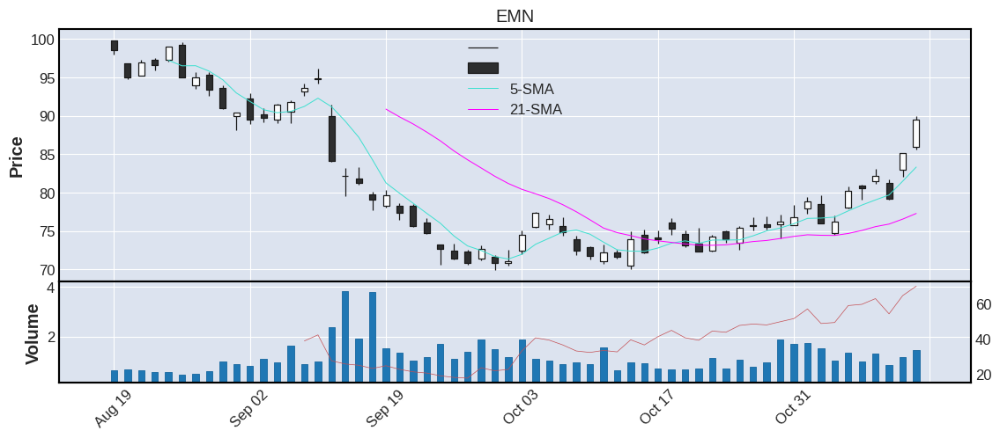



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
6    NWL  14.12  49.06  4.15    4.08  4.98  0.62  4.39  Industrials  0.0  United States   medium


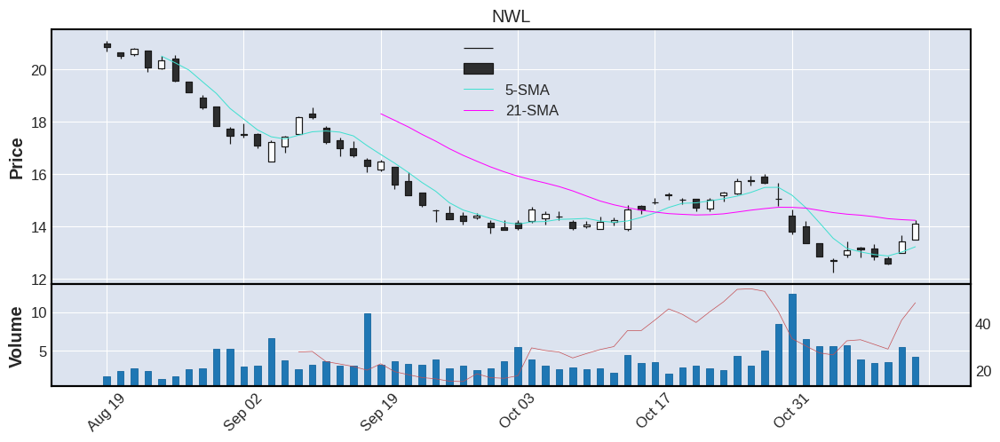



  TICKER    CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
7   TRMB  62.0  60.21  1.26    2.28  4.8  2.57  4.15  Industrials  1990.0  United States    large


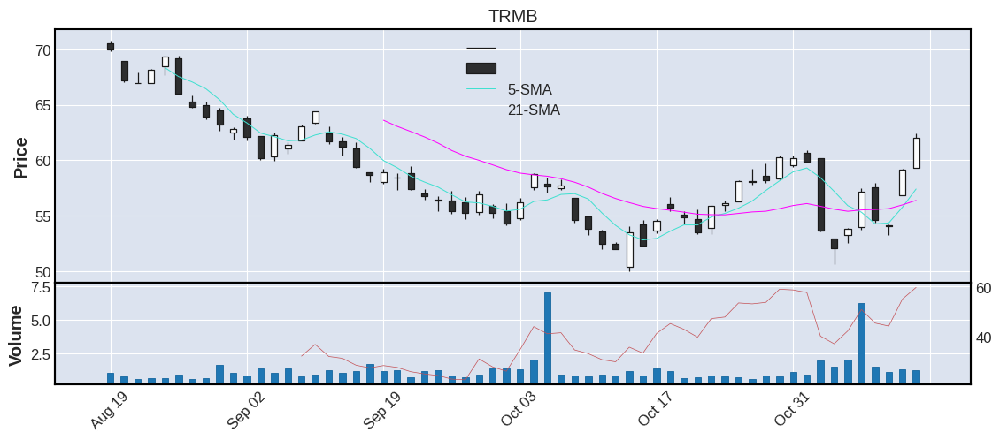



  TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
8    IFF  100.54  60.21  2.15    2.05  4.66  3.3  3.28  Industrials  0.0  United States    large


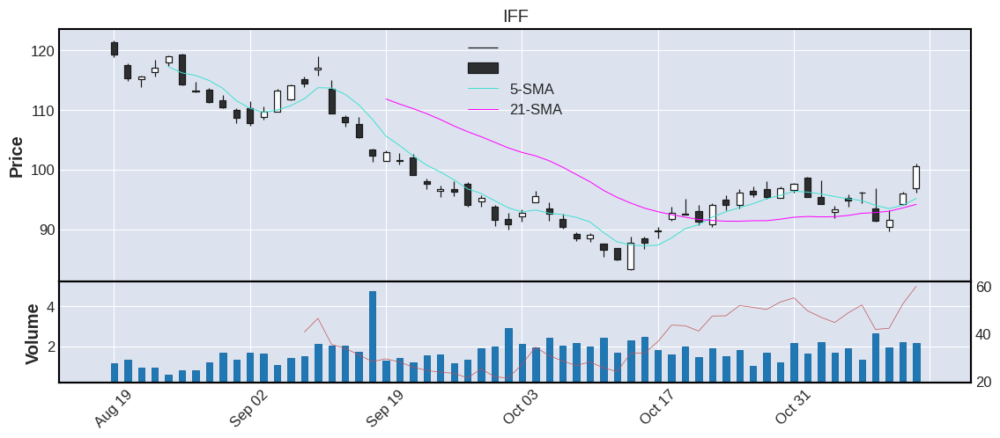



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
9     IP  36.63  66.69  5.18    3.61  4.24  1.08  2.95  Industrials  0.0  United States    large


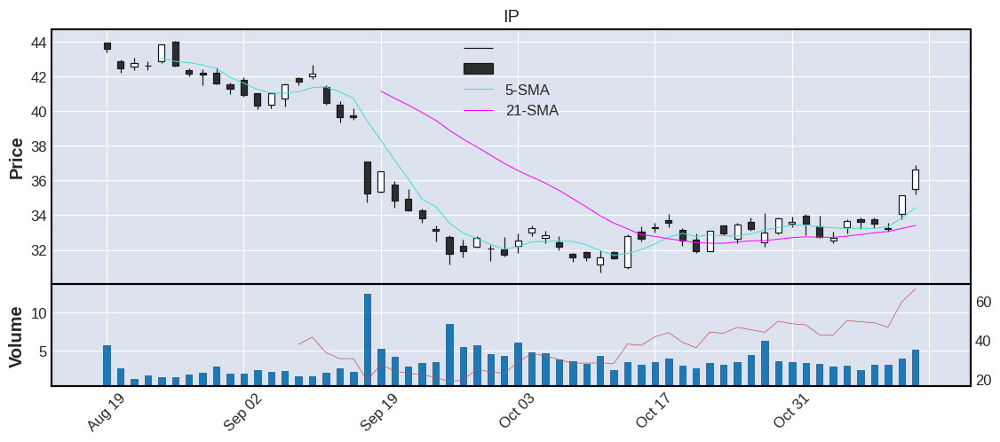



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
10    FOX  28.76  54.17  1.04    1.42  3.83  1.01  3.51  Industrials  0.0  United States    large


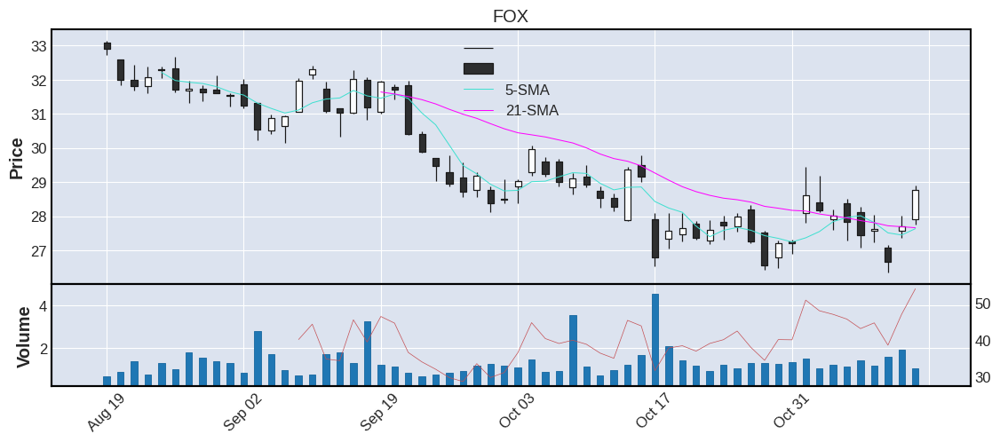



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
11   FOXA  30.52  53.01  2.83    3.37  3.67  1.08  3.54  Industrials  0.0  United States    large


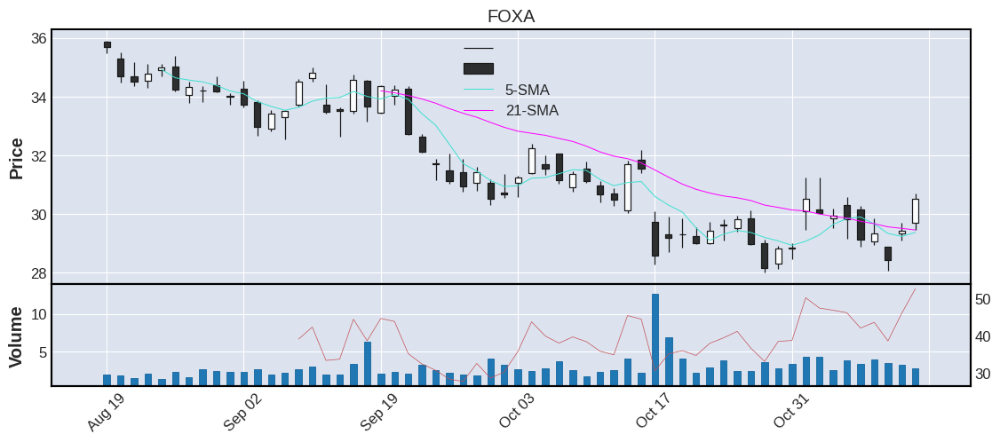



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
12   POOL  351.36  65.49  0.77    0.65  3.55  15.78  4.49  Industrials  1995.0  United States    large


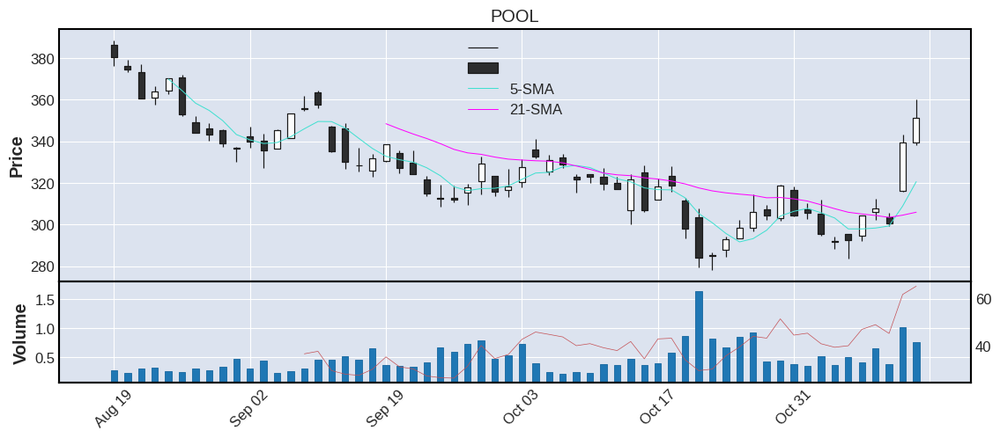



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO      COUNTRY CATEGORY
13    PNR  46.69  65.71  1.93    1.71  3.53  1.91  4.09  Industrials  0.0  Switzerland   medium


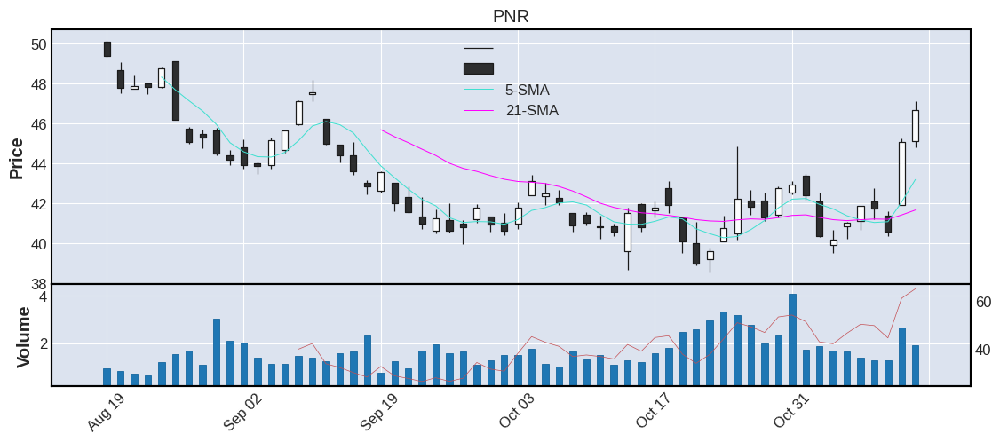



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
14    TMO  538.68  60.06  2.12    1.69  3.48  18.03  3.35  Industrials  0.0  United States    large


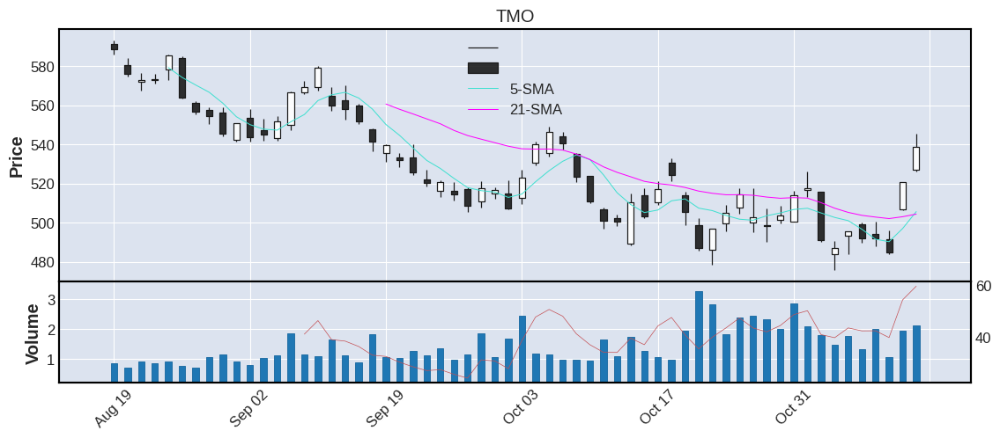



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
15    NSC  250.91  69.06  1.45     1.2  3.26  7.12  2.84  Industrials  0.0  United States    large


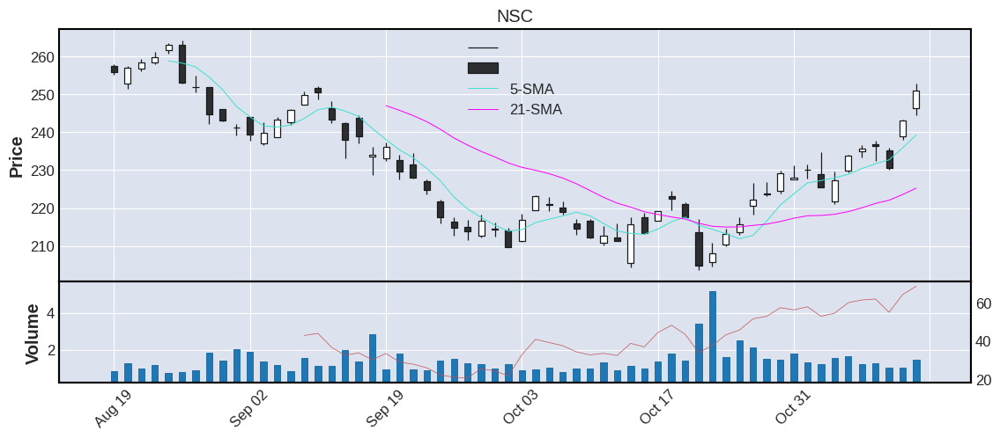



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
16    TER  96.31  71.42  1.7    1.93  3.19  3.73  3.87  Industrials  0.0  United States    large


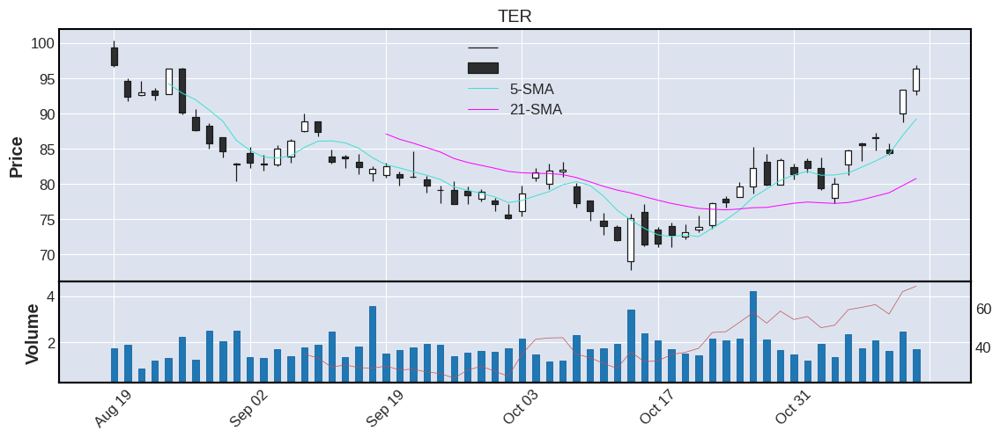



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
17    ROK  273.53  68.88  1.03    0.77  3.01  9.22  3.37  Industrials  0.0  United States    large


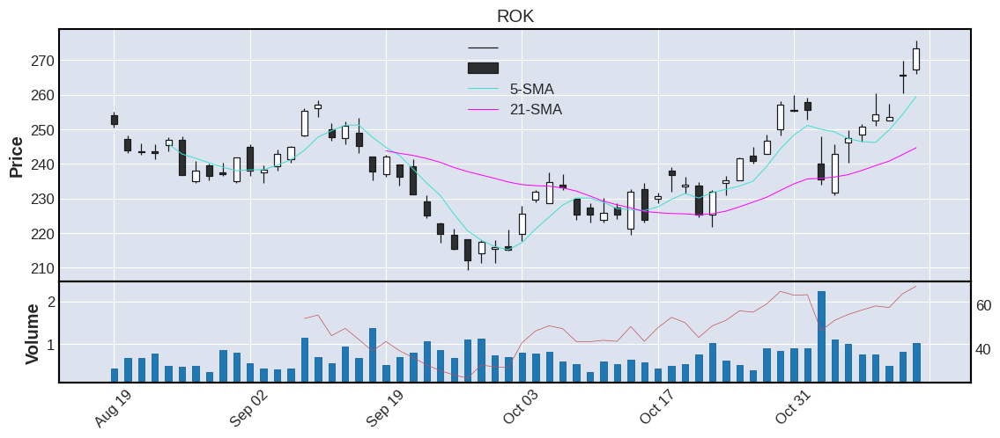



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
18    MMM  132.98  71.77  3.43    2.42  2.97  3.24  2.44  Industrials  0.0  United States    large


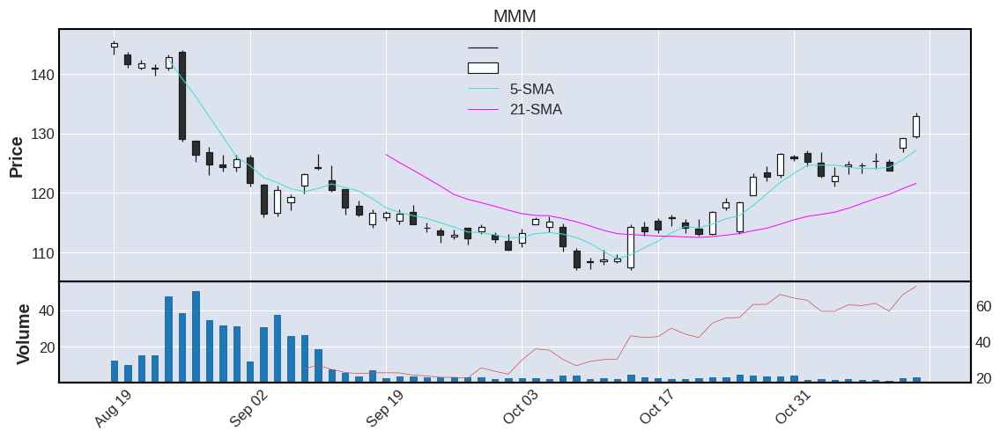



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
19   ODFL  314.11  69.01  1.25    1.17  2.77  12.94  4.12  Industrials  1991.0  United States    large


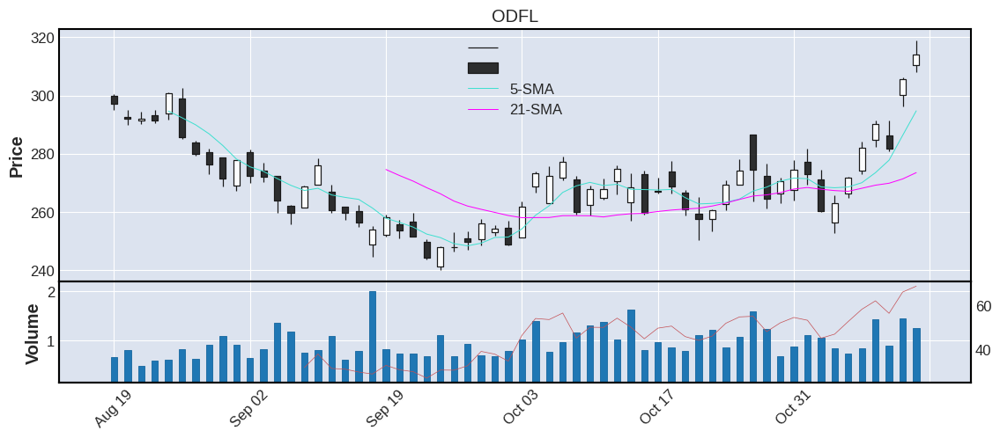



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO      COUNTRY CATEGORY
20   GRMN  93.76  69.02  0.93    0.78  2.68  2.55  2.72  Industrials  2000.0  Switzerland    large


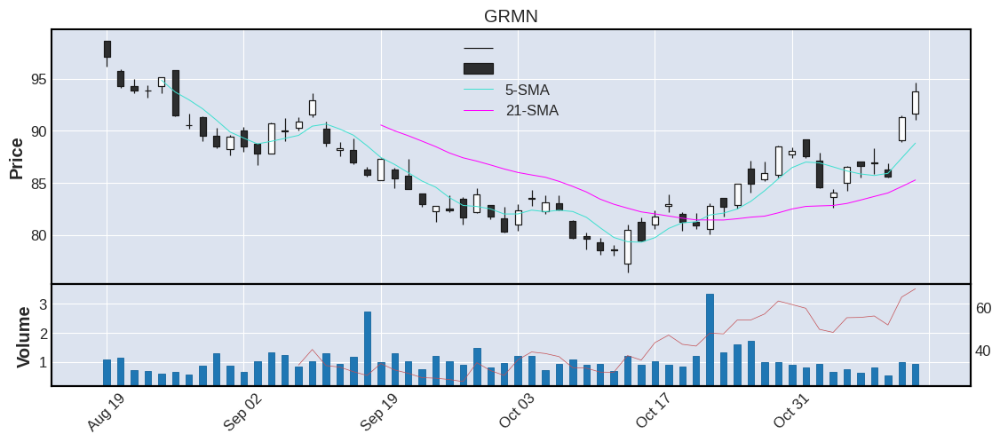



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
21     IR  55.31  70.14  6.68    4.17  2.65  1.76  3.18  Industrials  2017.0  United States    large


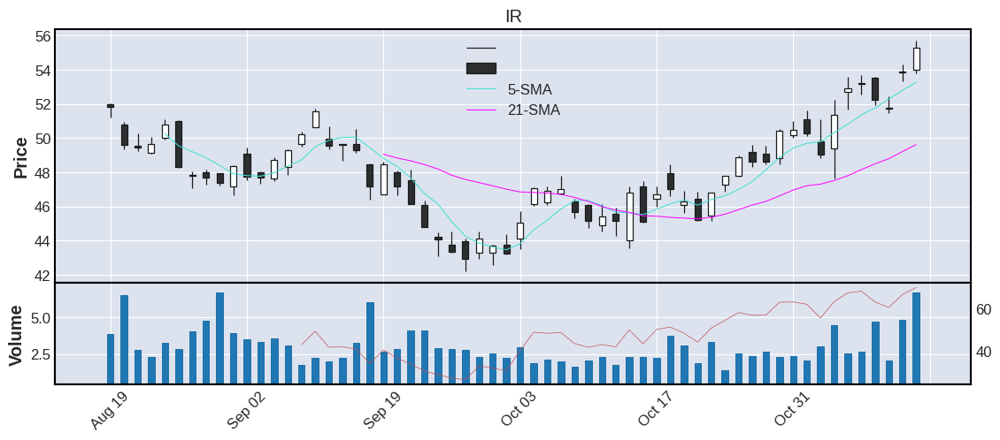



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
22    DOV  140.94  69.01  1.14    1.03  2.61  3.76  2.67  Industrials  0.0  United States    large


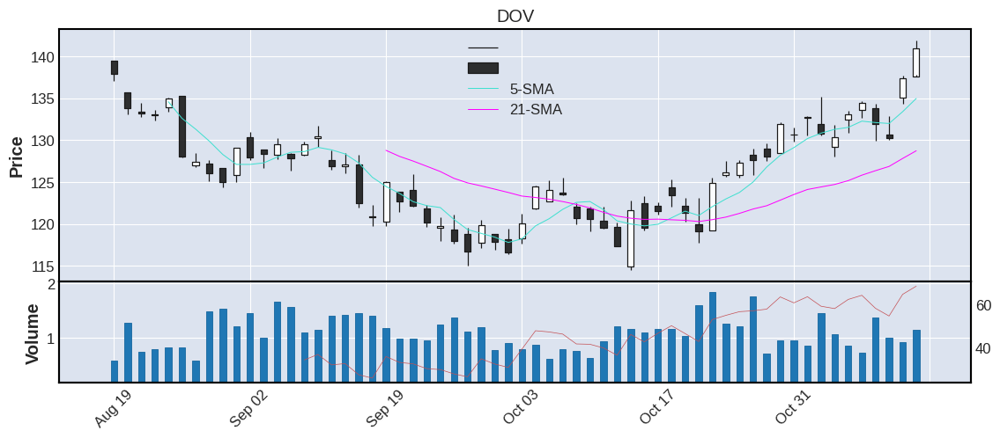



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
23    CMI  248.17  65.81  1.43    1.26  2.49  7.21  2.91  Industrials  0.0  United States    large


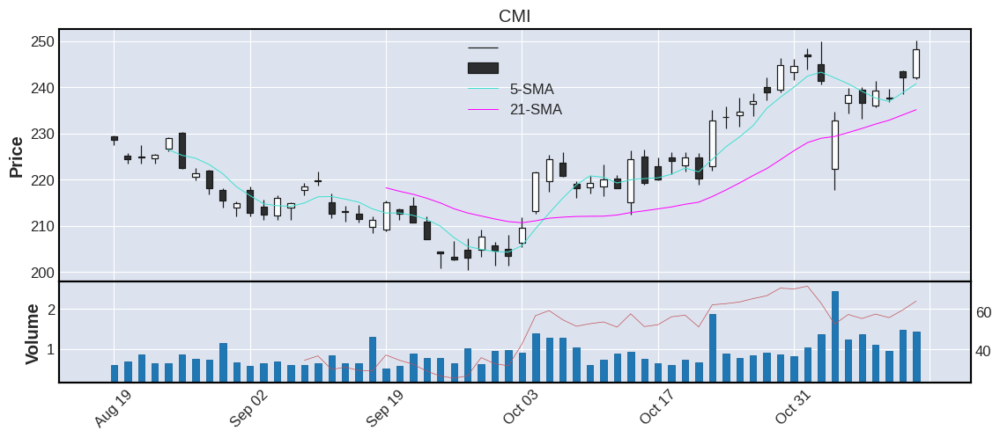



   TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
24    CSX  31.94  70.59  13.95   13.46  2.31  0.86  2.69  Industrials  0.0  United States    large


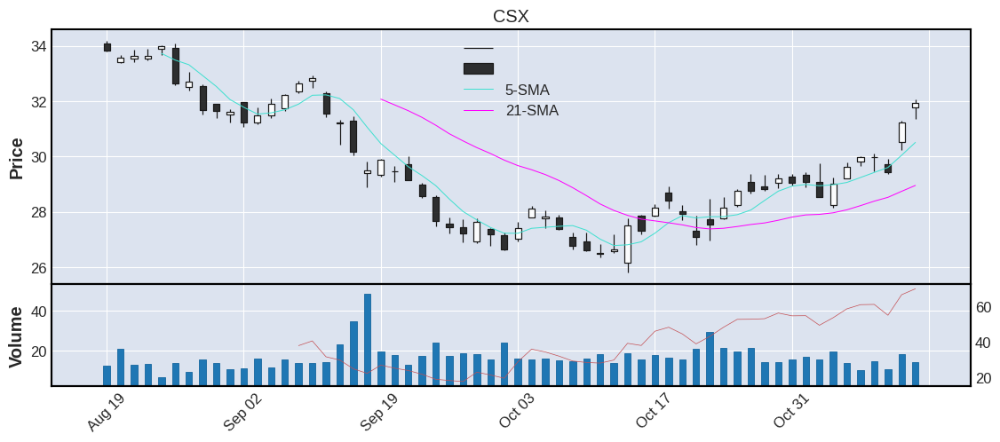



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
25   QRVO  96.78  66.9  1.09    1.45  2.22  3.83  3.96  Industrials  0.0  United States   medium


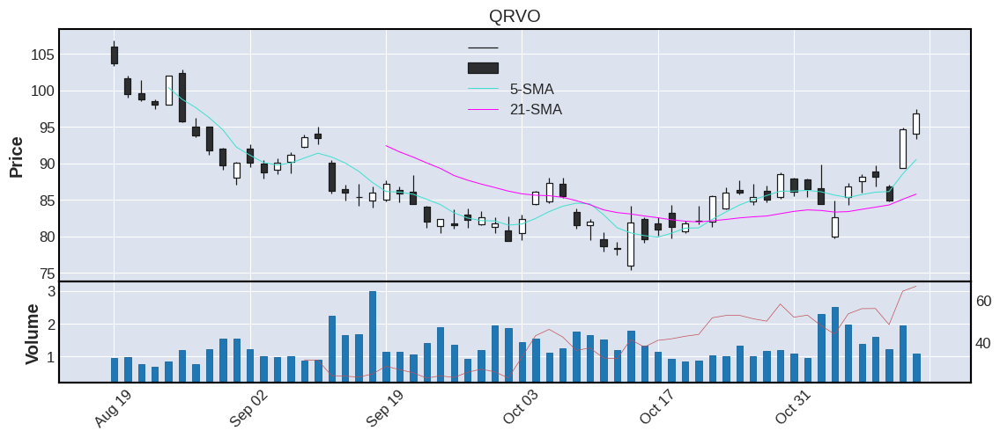



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
26    UNP  217.5  68.1  5.18    4.96  2.12  5.55  2.55  Industrials  0.0  United States    large


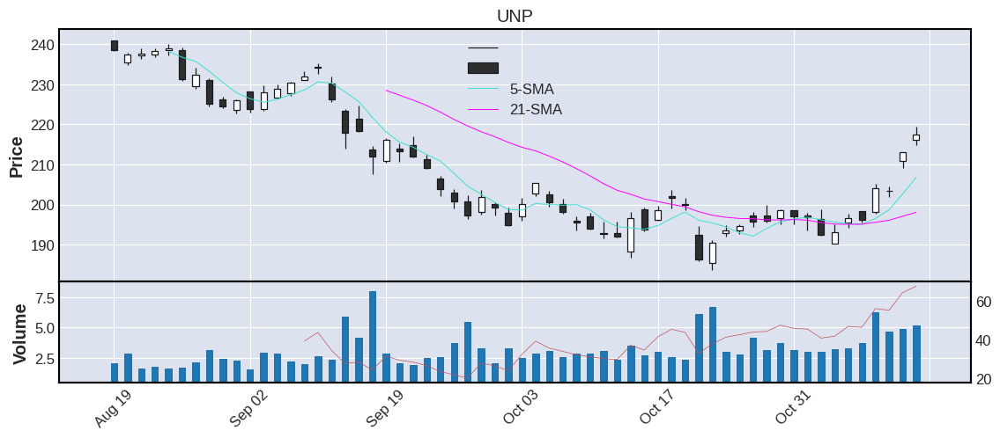



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
27    SEE  50.52  63.09  2.41     1.8  2.12  1.71  3.38  Industrials  0.0  United States   medium


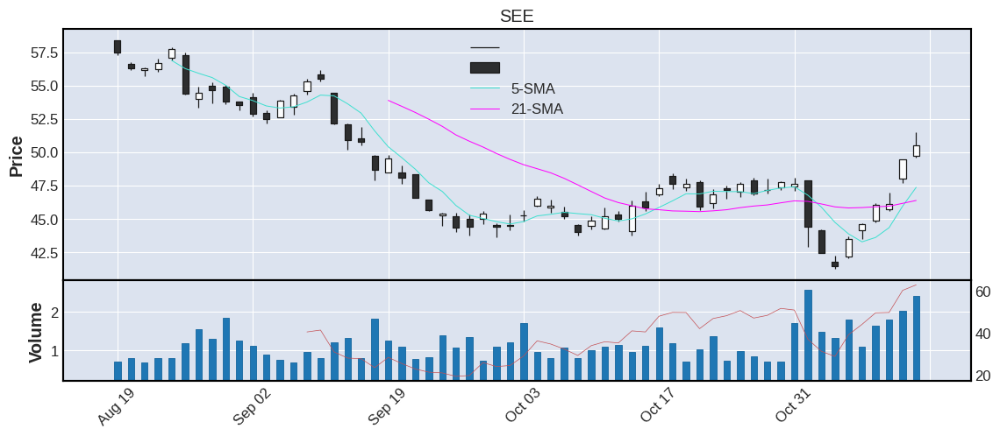



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
28    BIO  435.68  64.18  0.37    0.45  1.89  18.51  4.25  Industrials  1980.0  United States    large


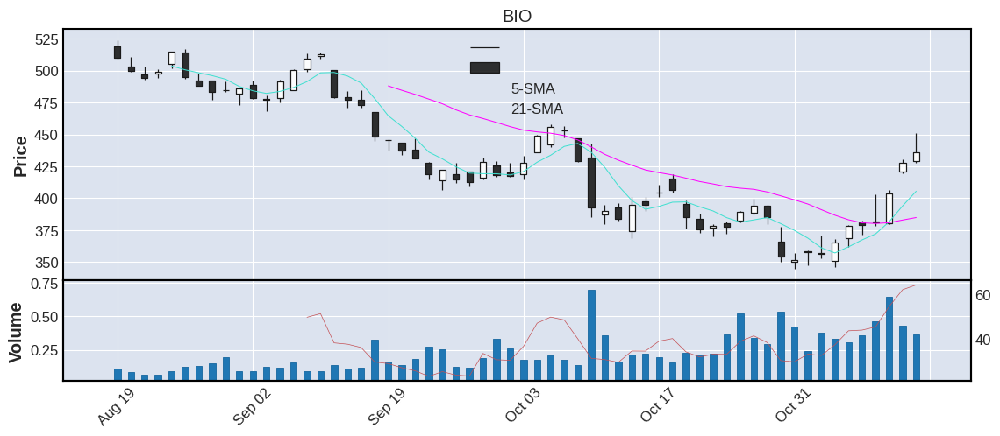



   TICKER    CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
29    MAS  51.1  62.1  2.72    2.39  1.83  2.05  4.01  Industrials  0.0  United States   medium


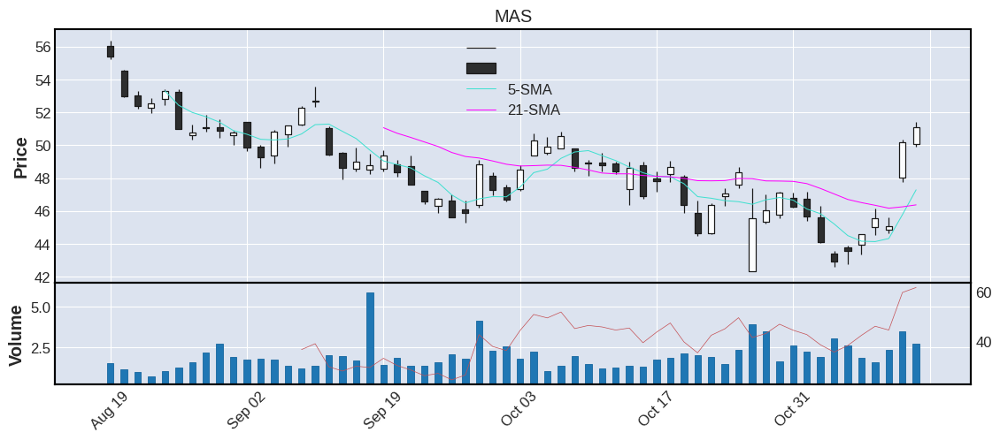



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
30    CAT  236.49  76.95  3.25    4.23  1.74  7.07  2.99  Industrials  0.0  United States    large


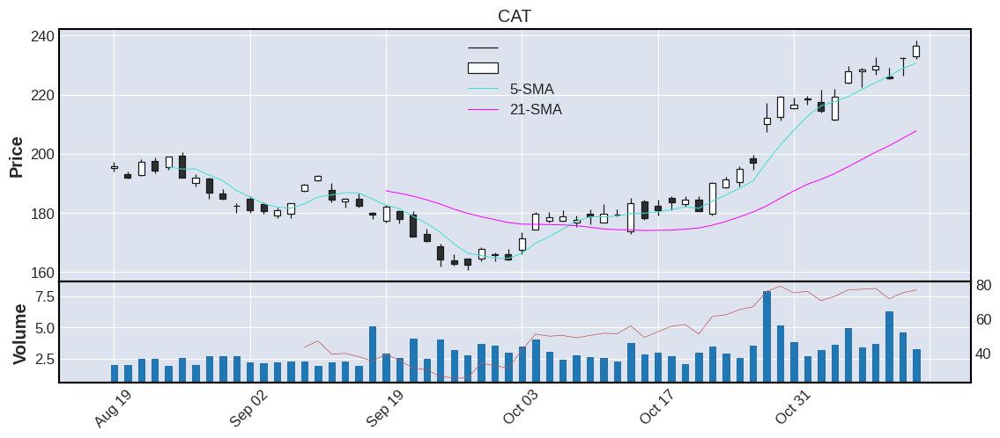



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
31     PH  308.57  67.8  0.82    0.92  1.73  9.25   3.0  Industrials  0.0  United States    large


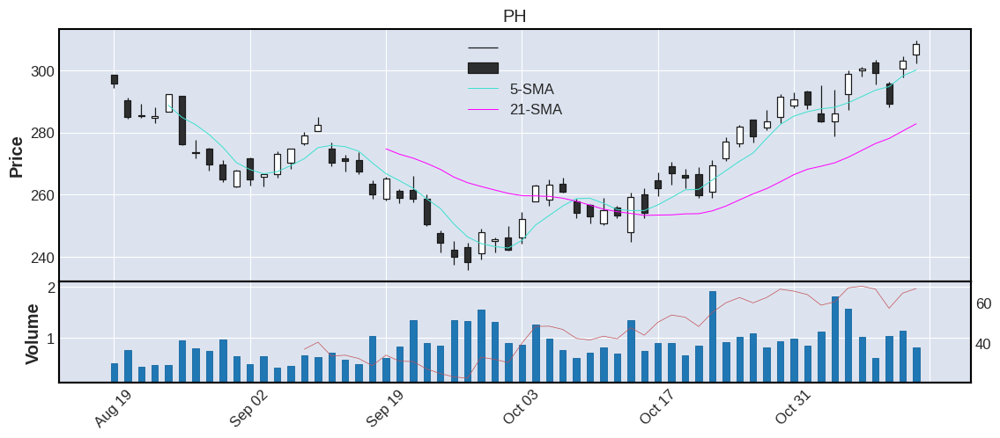



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
32   JBHT  185.4  64.86  0.99    0.77  1.61  6.46  3.48  Industrials  0.0  United States    large


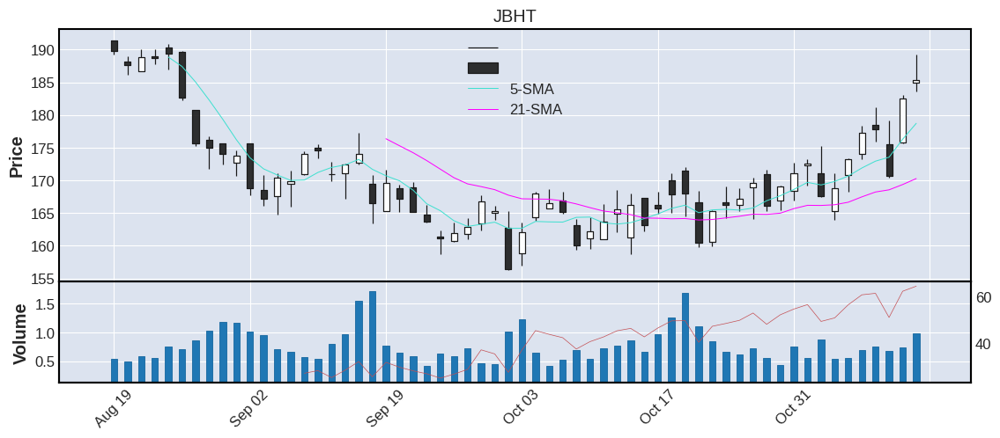



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
33    EMR  95.44  75.0  3.77    3.78  1.53  2.46  2.58  Industrials  0.0  United States    large


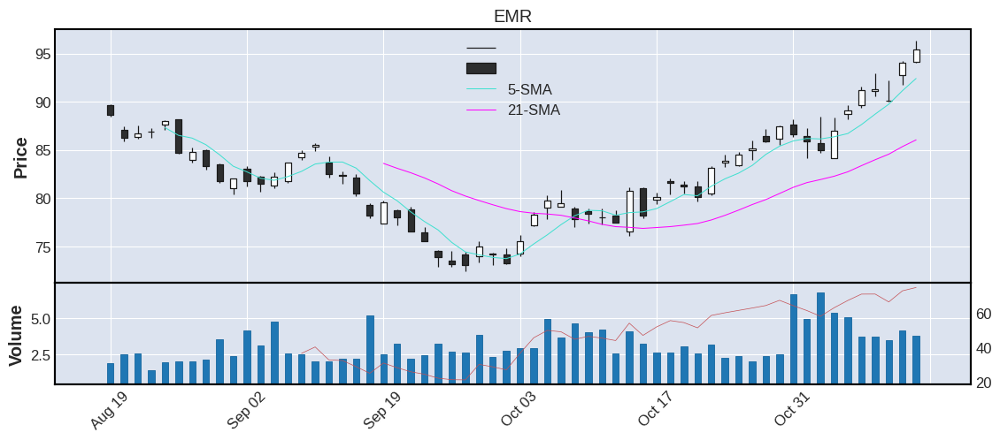



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
34    ALB  325.38  70.63  1.34    1.43  1.44  13.34   4.1  Industrials  0.0  United States    large


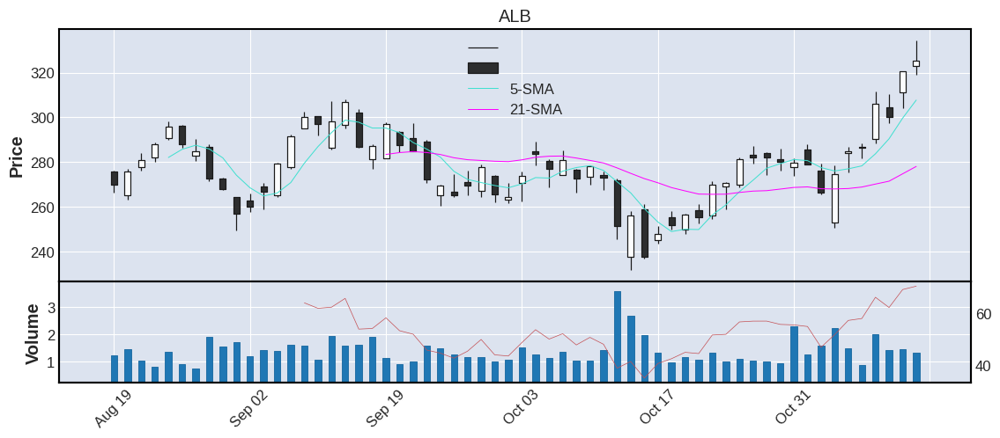



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
35      A  148.31  68.87  1.23    1.21  1.37  4.22  2.85  Industrials  1999.0  United States    large


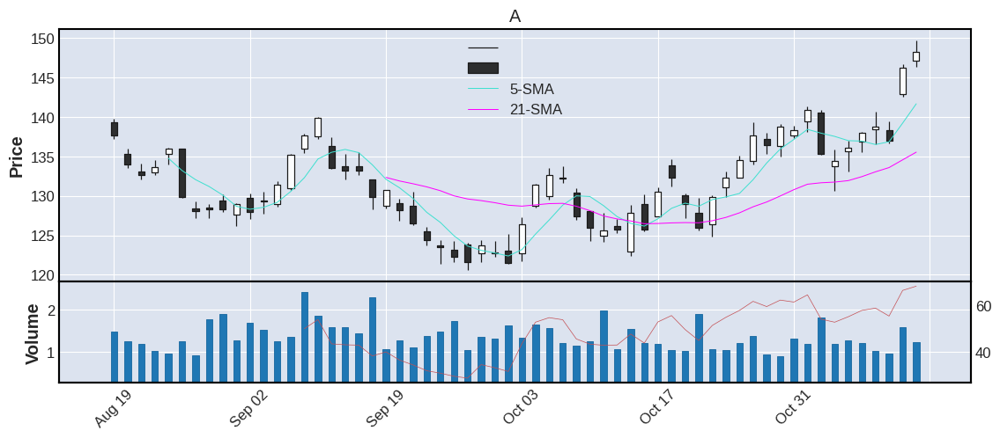



   TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
36    AOS  60.0  70.42  1.23    1.15  1.21  1.91  3.18  Industrials  0.0  United States   medium


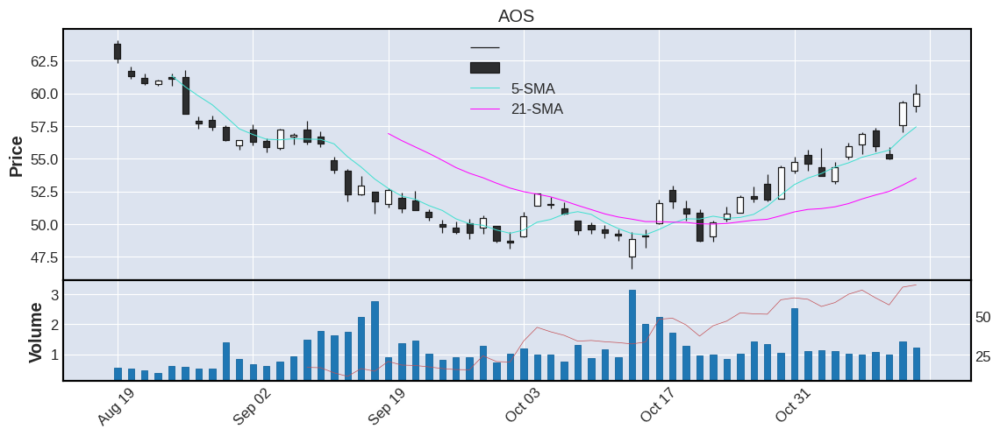



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
37    ITW  226.43  72.34  0.84    1.06  0.97  5.87  2.59  Industrials  0.0  United States    large


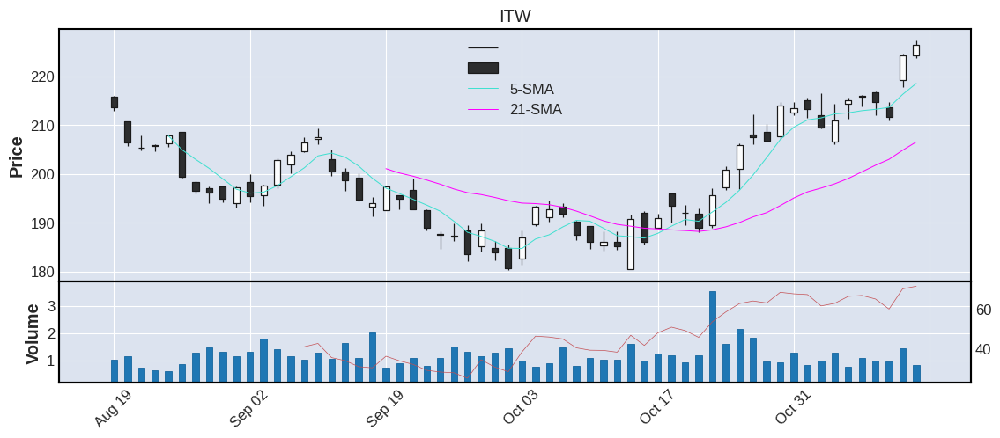



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
38    FTV  68.47  69.08  2.54    2.66  0.84  1.77  2.59  Industrials  2016.0     N-A    large


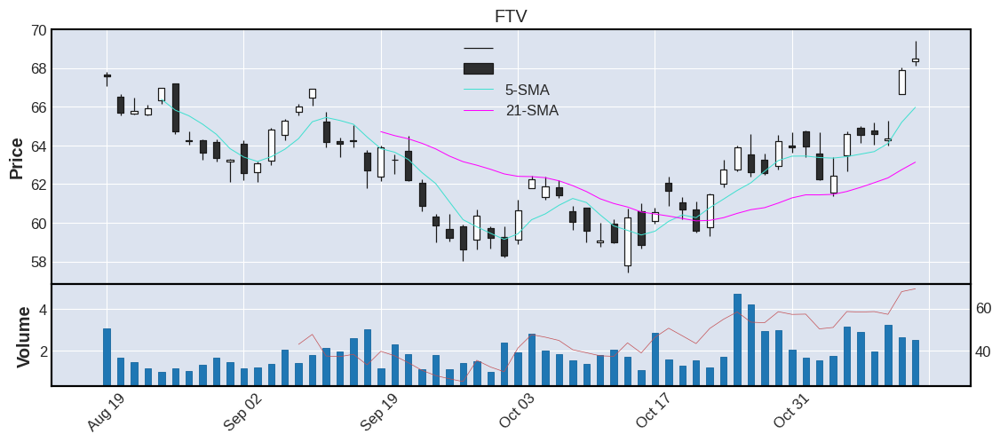



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
39    WAB  101.07  70.56  2.01    1.39  0.72  2.63   2.6  Industrials  0.0  United States    large


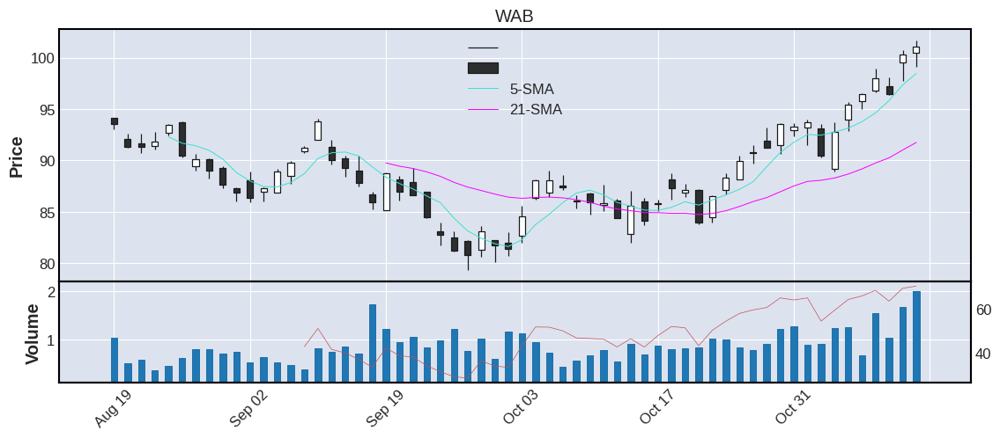



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
40   PCAR  102.62  74.03  2.31    2.61  0.7  2.57   2.5  Industrials  0.0  United States    large


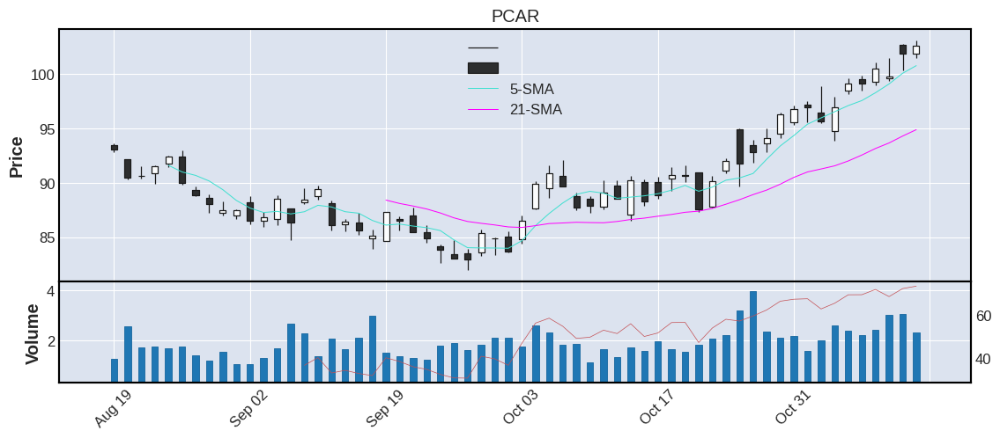



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
41   NDSN  236.55  65.83  0.22    0.22  0.58  5.33  2.25  Industrials  0.0  United States    large


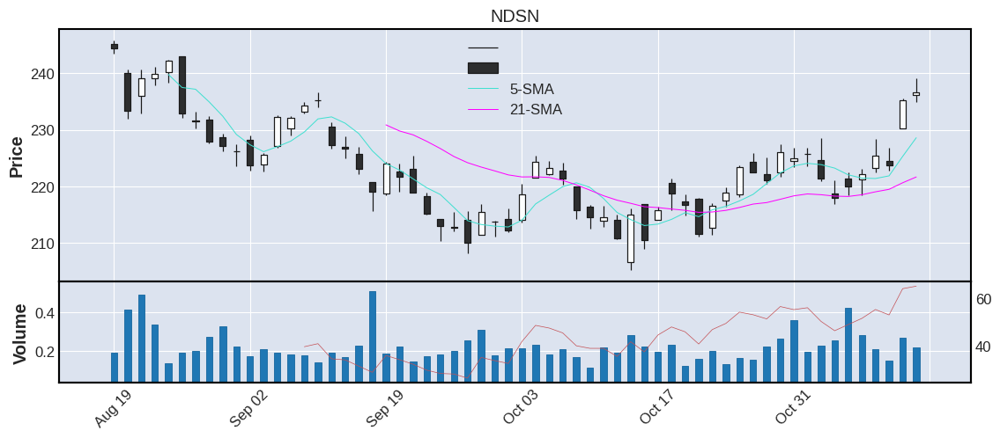



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
42    LIN  330.22  75.04  2.13    1.82  0.56  8.35  2.53  Industrials  2018.0     N-A    large


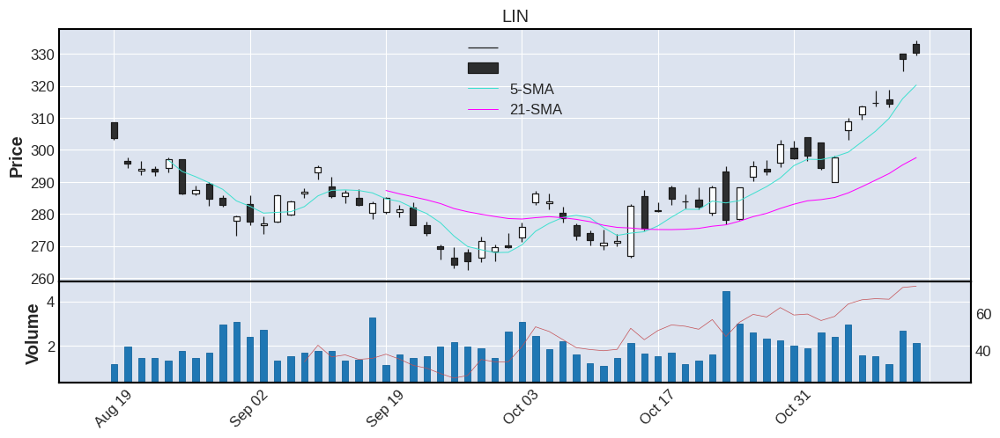



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
43   KEYS  172.18  57.64  1.02     1.0  0.27  5.04  2.93  Industrials  2014.0  United States    large


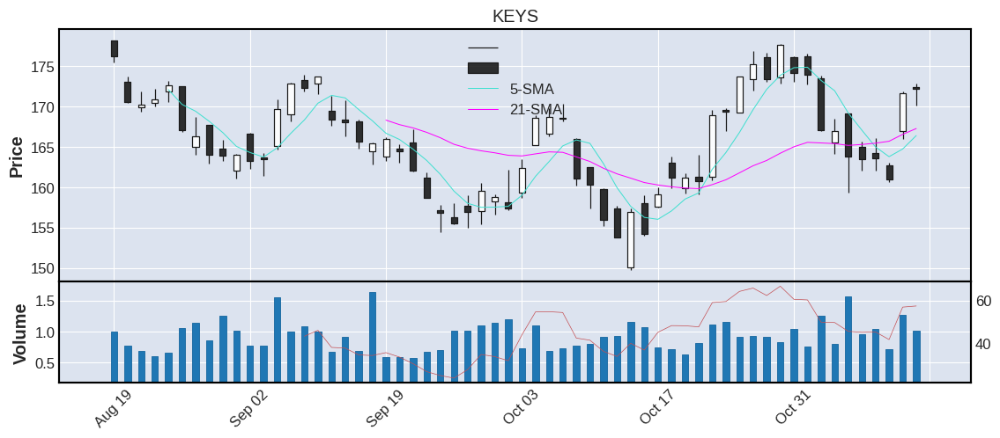



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
44      J  125.72  66.17  0.64    0.46  0.01  3.43  2.73  Industrials  2022.0     N-A    large


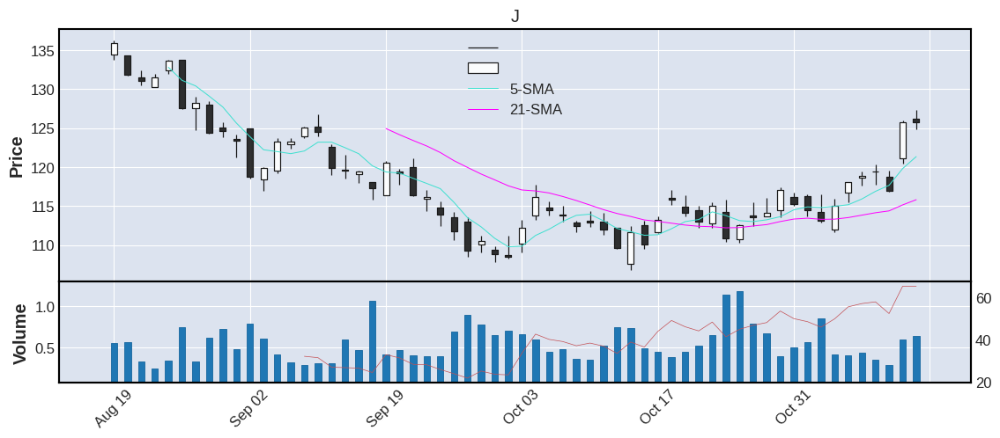



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
45    ROP  438.36  73.41  0.53    0.67 -0.02  11.05  2.52  Industrials  1992.0  United States    large


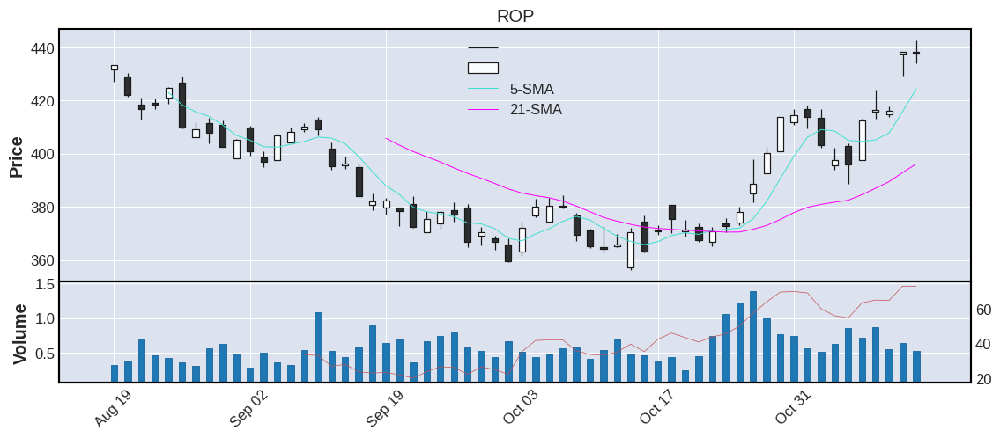



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
46     BA  177.49  77.07  8.87   10.33 -0.05  6.76  3.81  Industrials  0.0  United States    large


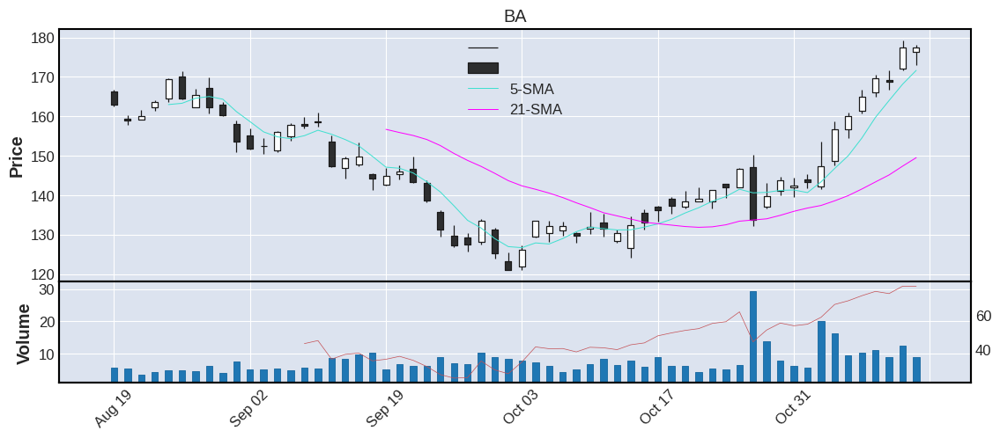



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
47    MLM  362.19  65.53  0.32    0.38 -0.18  11.81  3.26  Industrials  1994.0  United States    large


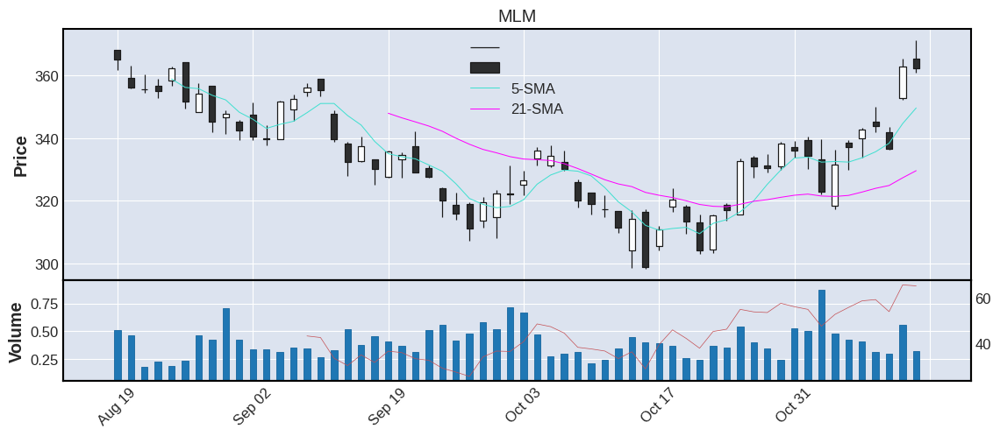



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
48    NUE  138.76  61.87  2.61    1.99 -0.19  5.59  4.03  Industrials  0.0  United States    large


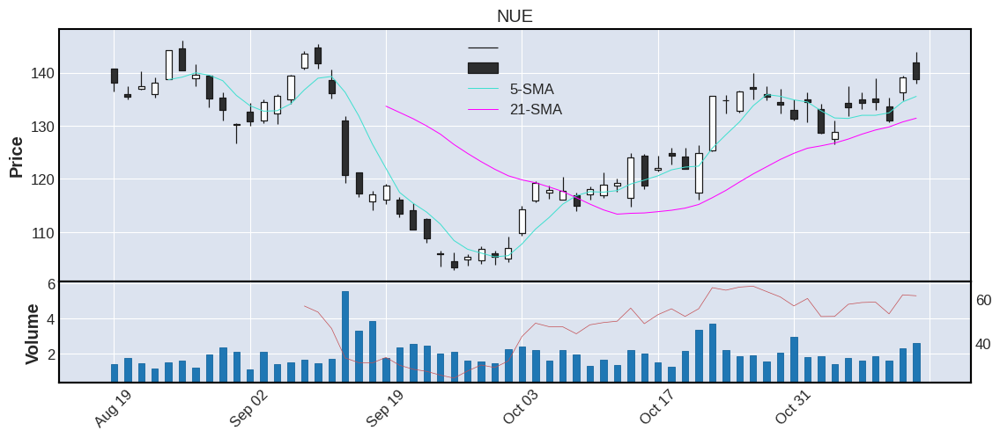



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO  COUNTRY CATEGORY
49    ETN  161.6  71.17  2.36    2.04 -0.33  4.25  2.63  Industrials  0.0  Ireland    large


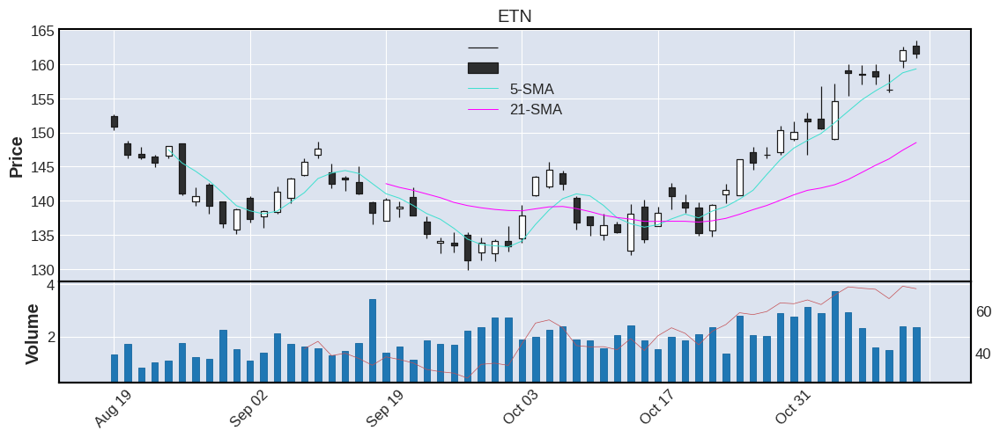



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
50    APD  288.46  72.24  0.96    1.18 -0.39  7.16  2.48  Industrials  0.0  United States    large


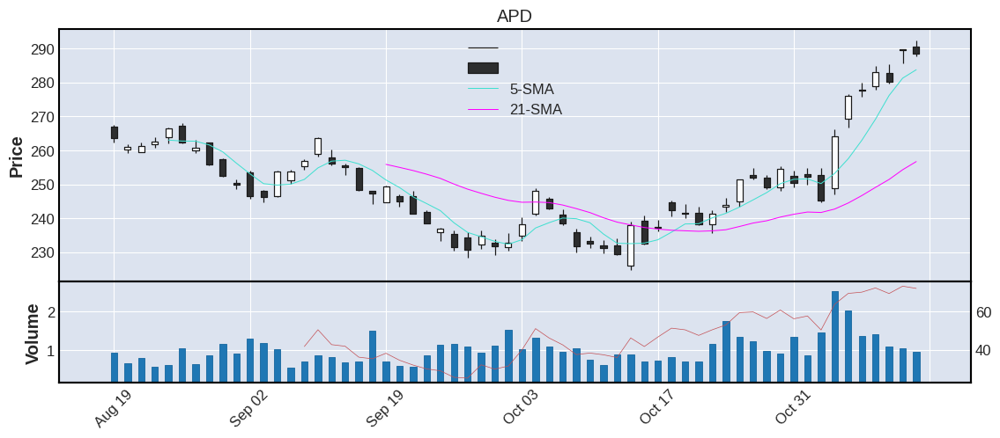



================================================== SECTOR 9: UTILITIES [ %CHG ] ================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
1     KMI   18.69  59.98  17.92   16.35  2.69  0.51  2.73  Utilities  2011.0  United States    large
2     OKE   64.65  68.57   2.70    2.51  1.97  1.64  2.54  Utilities     0.0  United States    large
3    TRGP   72.64  60.69   1.38    1.66  1.47  2.59  3.57  Utilities  2010.0  United States    large
4     WMB   34.08  63.10   4.98    6.12  1.37  0.80  2.35  Utilities     0.0  United States    large
5     NRG   45.40  59.76   2.92    3.87  0.69  1.46  3.22  Utilities     0.0  United States    large
6     EXC   39.11  55.15   7.49   10.15  0.28  1.09  2.79  Utilities     0.0  United States    large
7     NEE   83.31  63.74   4.66    6.29  0.13  2.49  2.99  Utilities     0.0  United States    large
8     PCG   14.76  53.16  19.05   15.97 -0.34  0.43  2.9

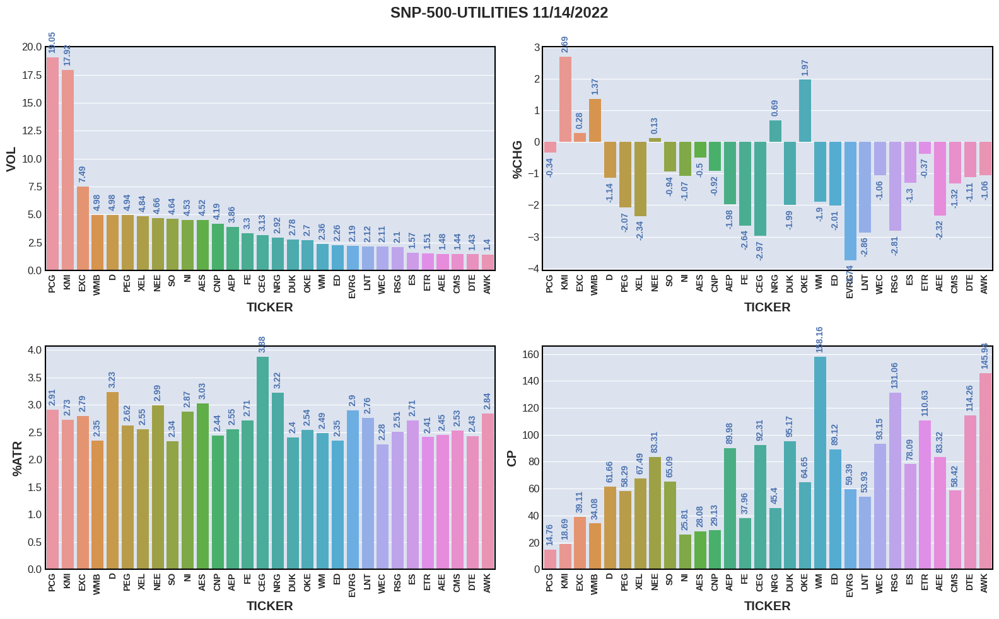

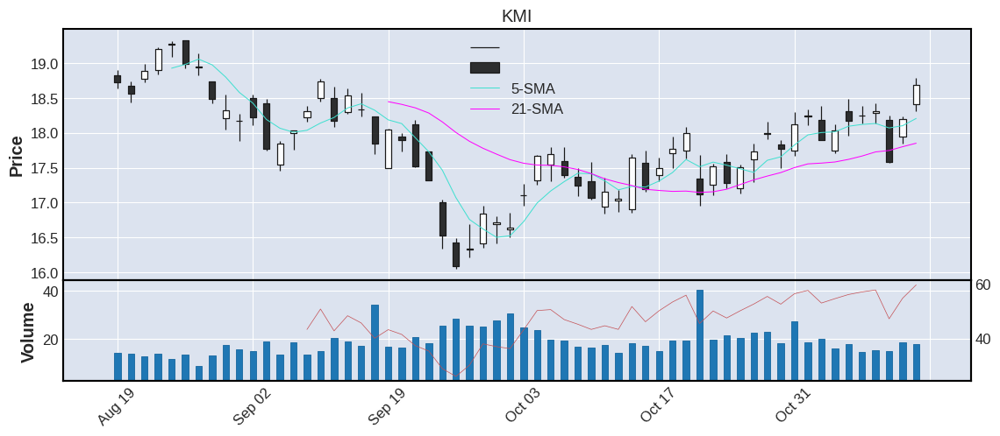



  TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
2    OKE  64.65  68.57  2.7    2.51  1.97  1.64  2.54  Utilities  0.0  United States    large


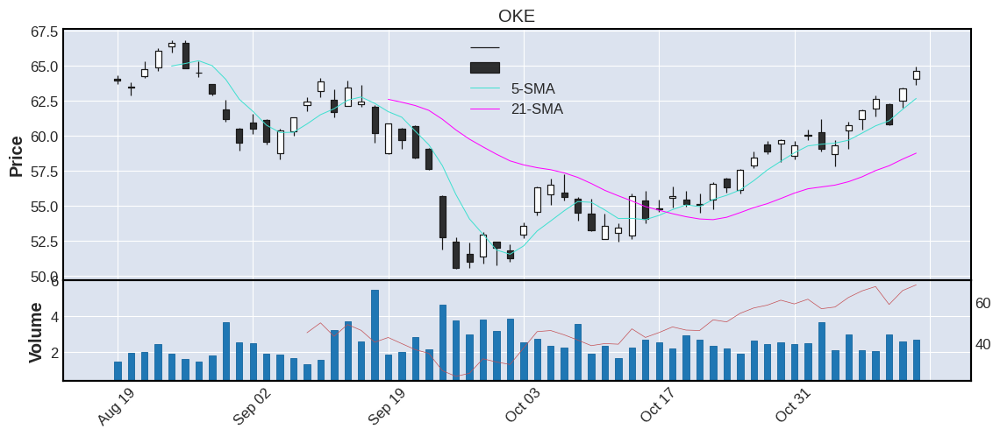



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
3   TRGP  72.64  60.69  1.38    1.66  1.47  2.59  3.57  Utilities  2010.0  United States    large


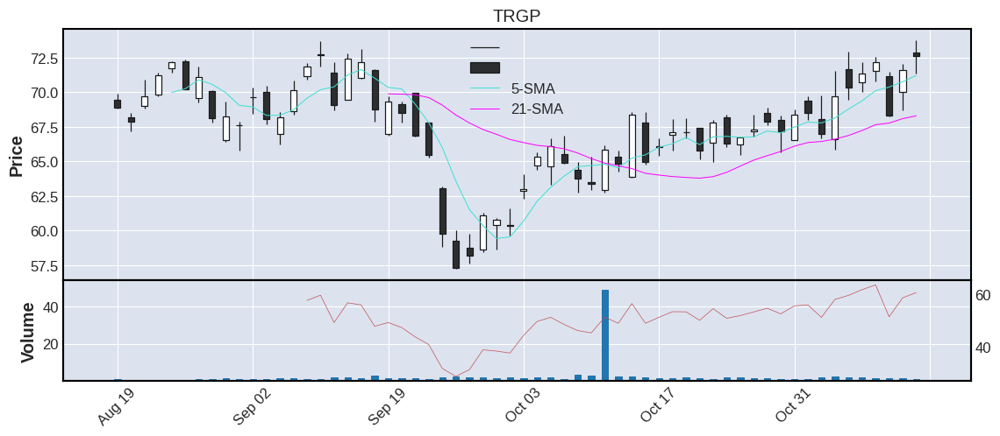



  TICKER     CP   RSI   VOL  AVGVOL  %CHG  ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
4    WMB  34.08  63.1  4.98    6.12  1.37  0.8  2.35  Utilities  0.0  United States    large


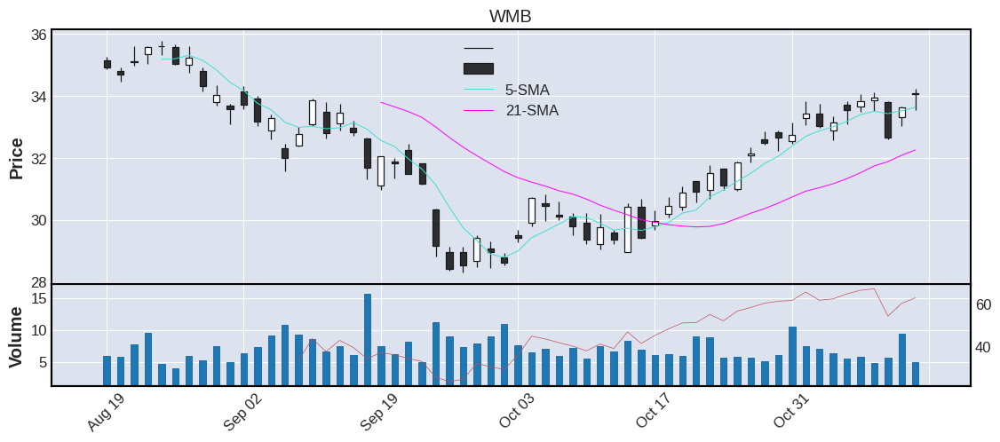



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
5    NRG  45.4  59.76  2.92    3.87  0.69  1.46  3.22  Utilities  0.0  United States    large


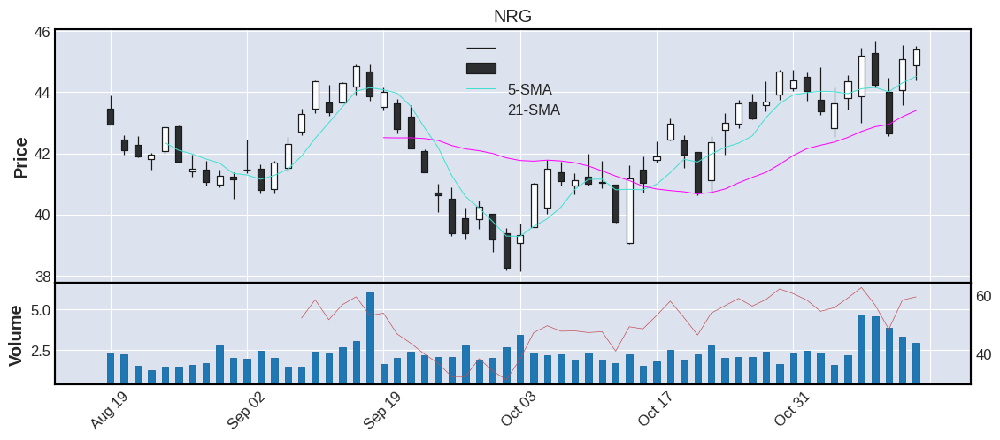



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
6    EXC  39.11  55.15  7.49   10.15  0.28  1.09  2.79  Utilities  0.0  United States    large


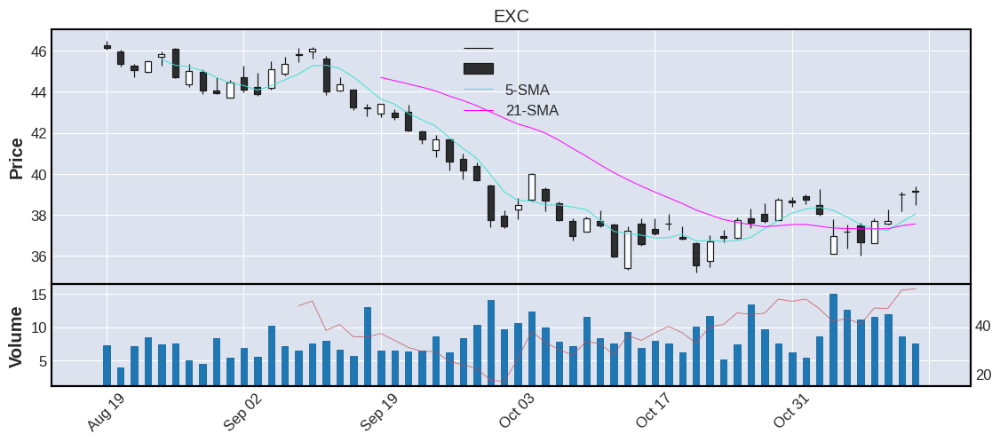



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
7    NEE  83.31  63.74  4.66    6.29  0.13  2.49  2.99  Utilities  0.0  United States    large


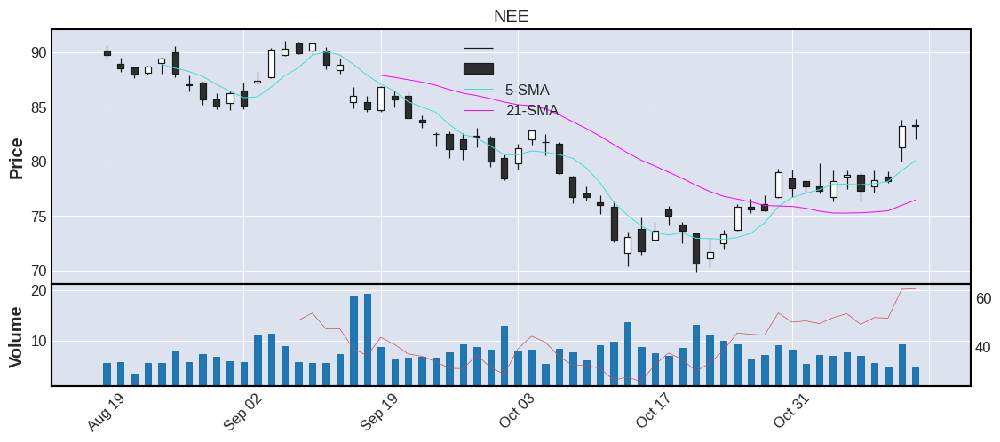



  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
8    PCG  14.76  53.16  19.05   15.97 -0.34  0.43  2.91  Utilities  0.0  United States    large


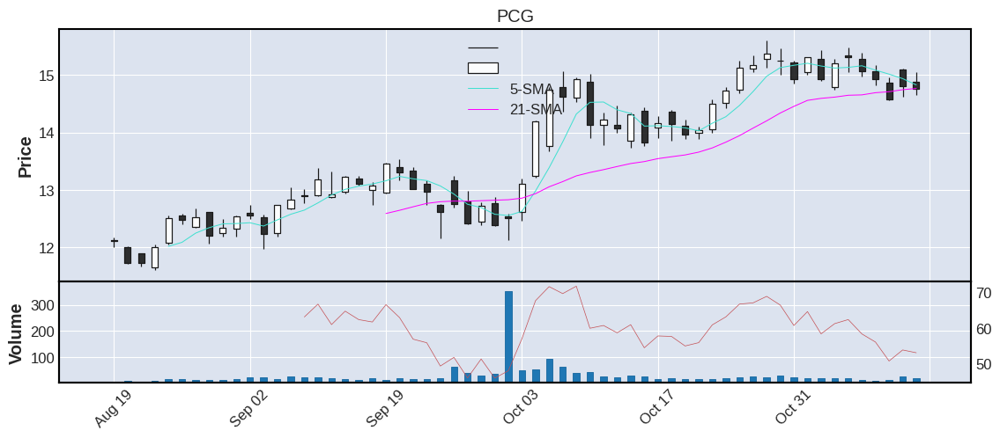



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
9    ETR  110.63  58.67  1.51    1.27 -0.37  2.67  2.41  Utilities  0.0  United States    large


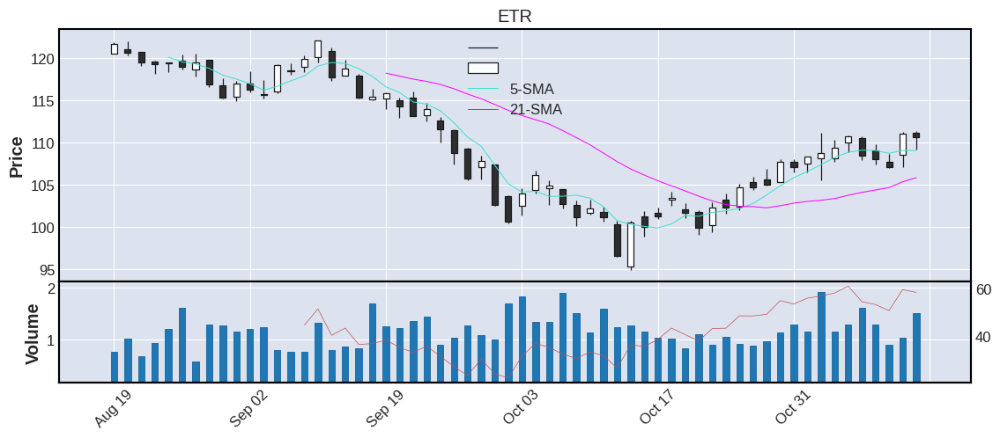



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
10    AES  28.08  67.21  4.52    4.94 -0.5  0.85  3.03  Utilities  0.0  United States    large


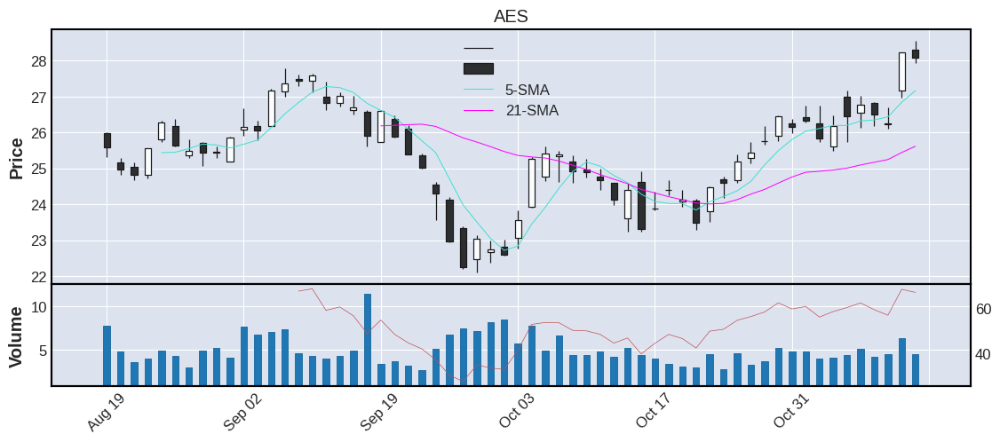



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
11    EIX  59.87  53.03  1.12    1.53 -0.7  1.57  2.62  Utilities  0.0  United States    large


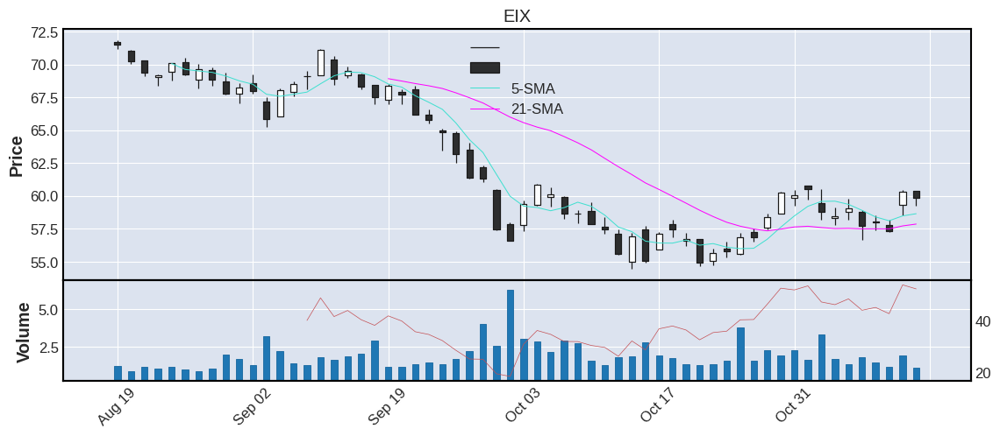



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
12    SRE  154.65  55.05  1.19    1.15 -0.76  3.71   2.4  Utilities  0.0  United States    large


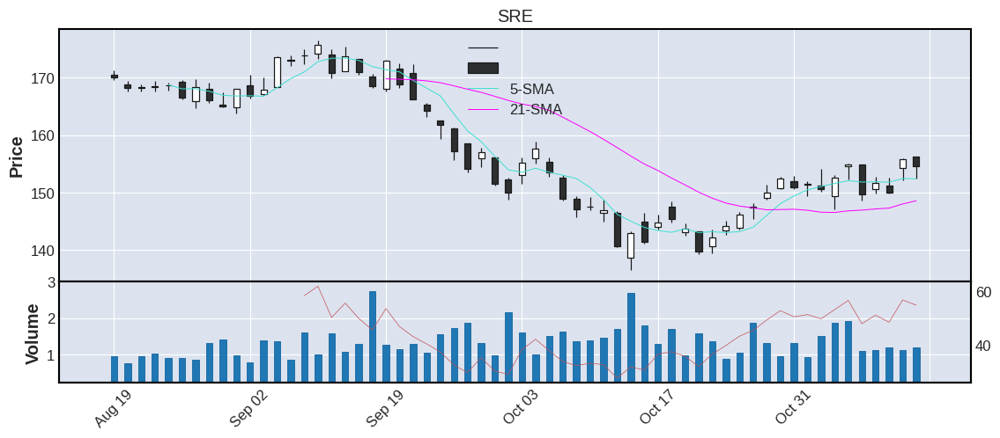



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
13    CNP  29.13  57.35  4.19    4.19 -0.92  0.71  2.44  Utilities  0.0  United States    large


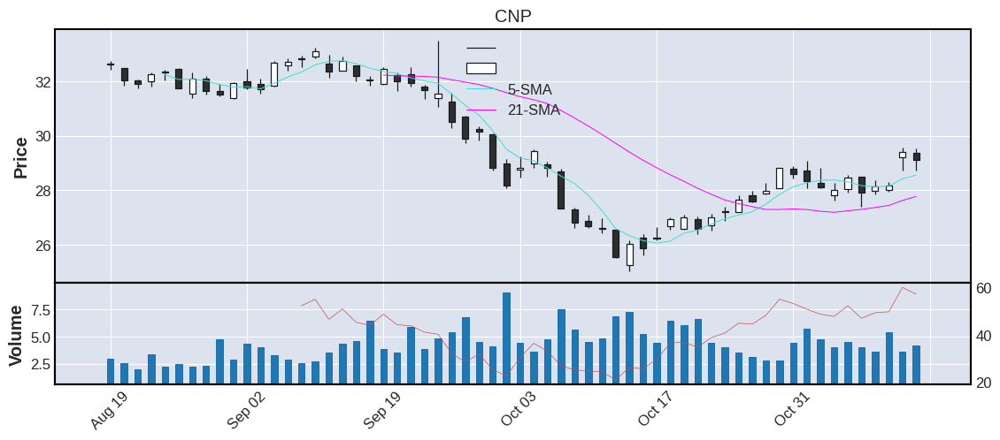



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
14     SO  65.09  46.14  4.64    4.31 -0.94  1.52  2.34  Utilities  0.0  United States    large


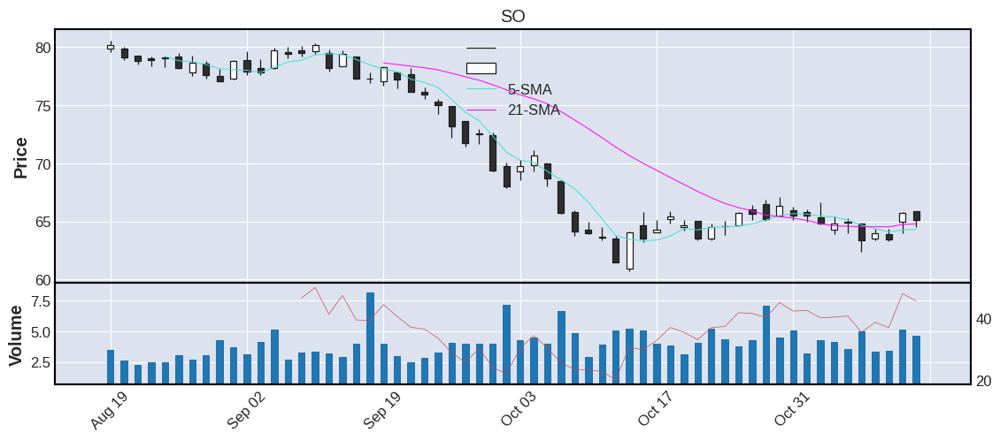



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
15    ATO  110.69  60.45  1.08    0.99 -0.99  2.83  2.56  Utilities  0.0  United States    large


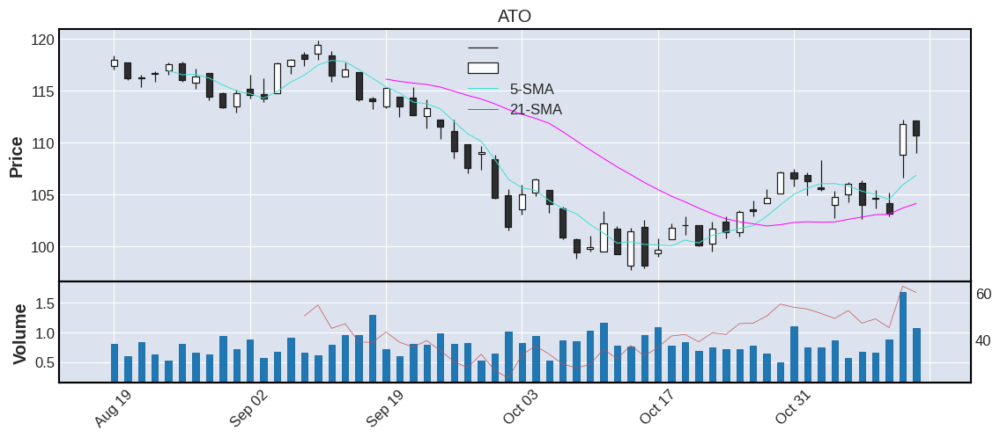



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
16    WEC  93.15  56.26  2.11    1.59 -1.06  2.12  2.28  Utilities  0.0  United States    large


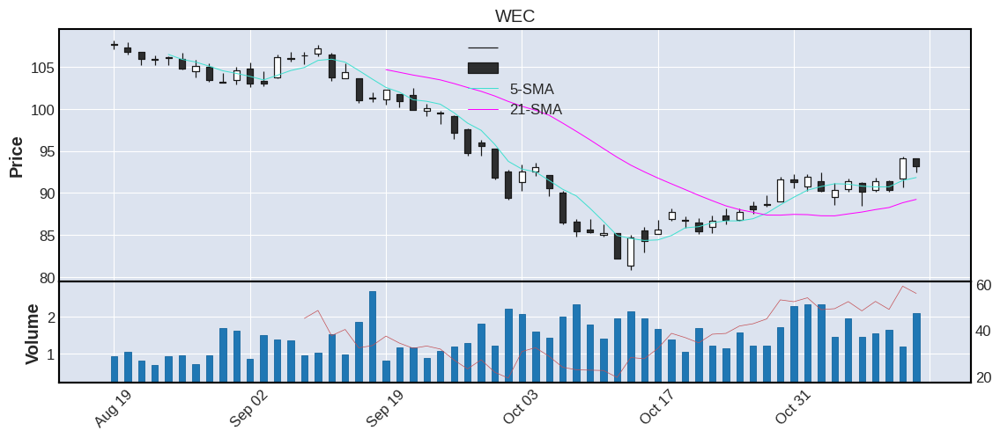



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
17    AWK  145.94  60.35  1.4    0.87 -1.06  4.15  2.84  Utilities  2008.0  United States    large


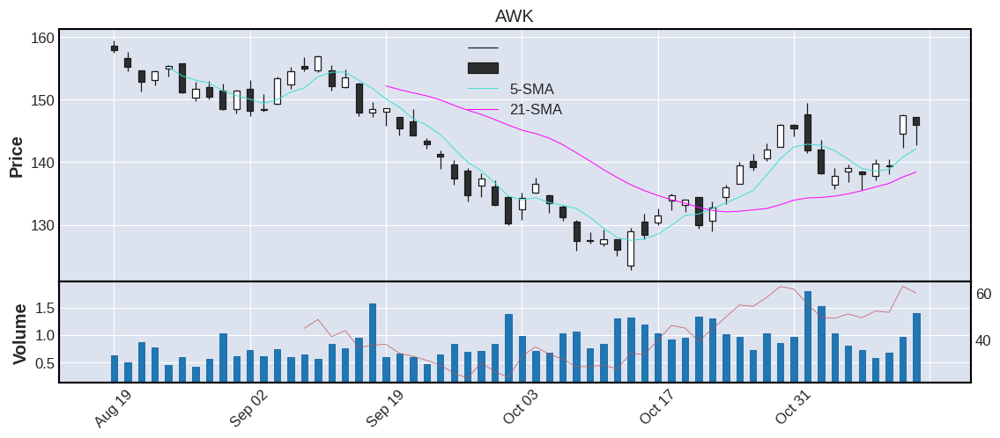



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
18     NI  25.81  51.26  4.53    7.15 -1.07  0.74  2.87  Utilities  0.0  United States    large


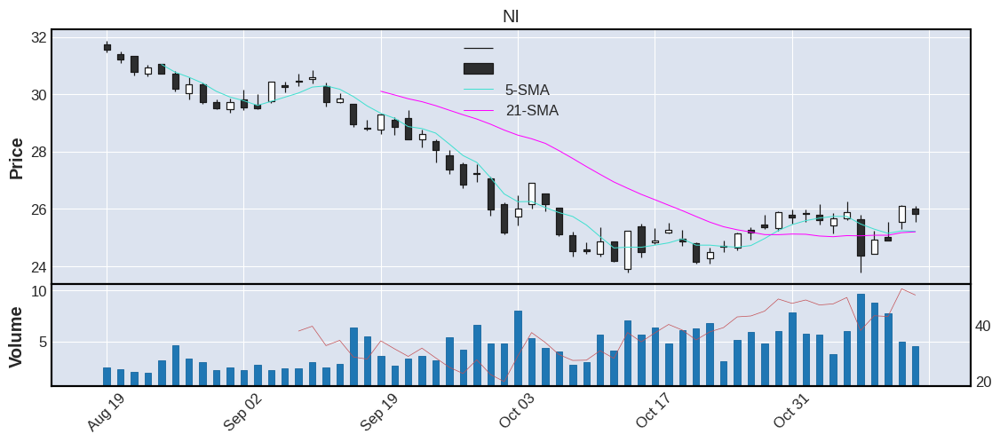



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
19    DTE  114.26  53.49  1.43    1.39 -1.11  2.78  2.43  Utilities  0.0  United States    large


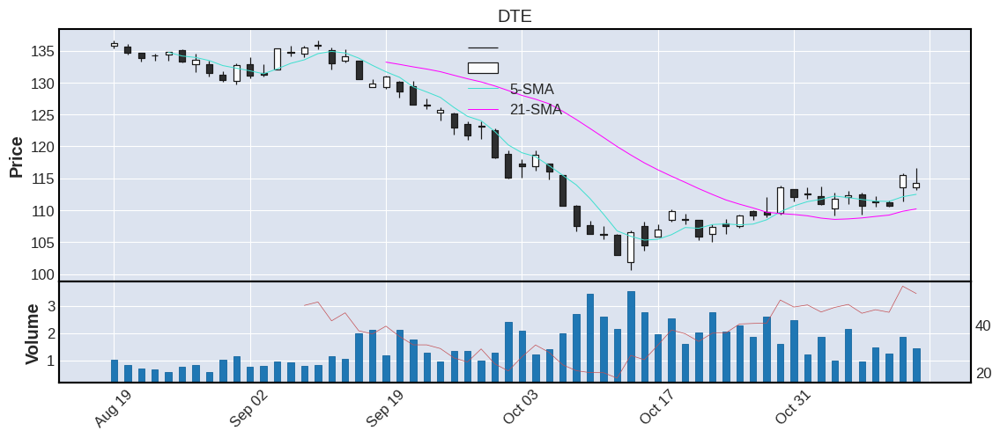



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
20      D  61.66  34.07  4.98   10.67 -1.14  1.99  3.23  Utilities  0.0  United States    large


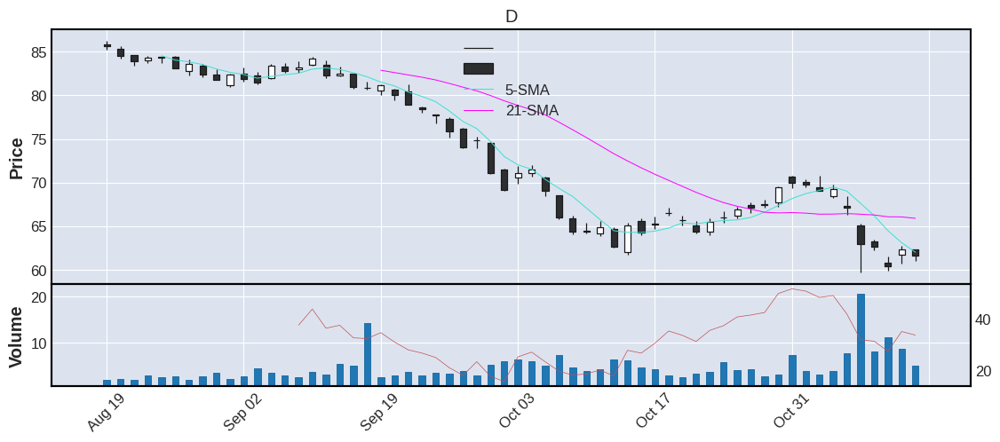



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
21     ES  78.09  53.05  1.57    1.69 -1.3  2.12  2.71  Utilities  0.0  United States    large


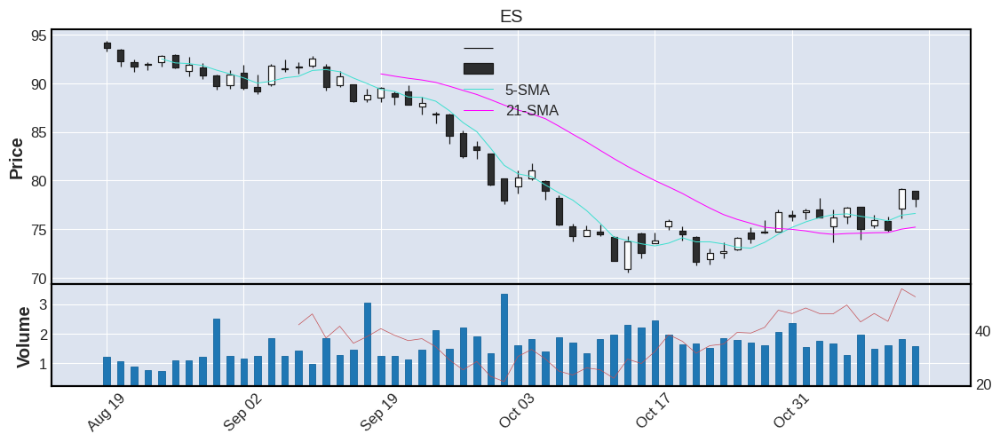



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
22    CMS  58.42  53.25  1.44    1.91 -1.32  1.48  2.53  Utilities  0.0  United States    large


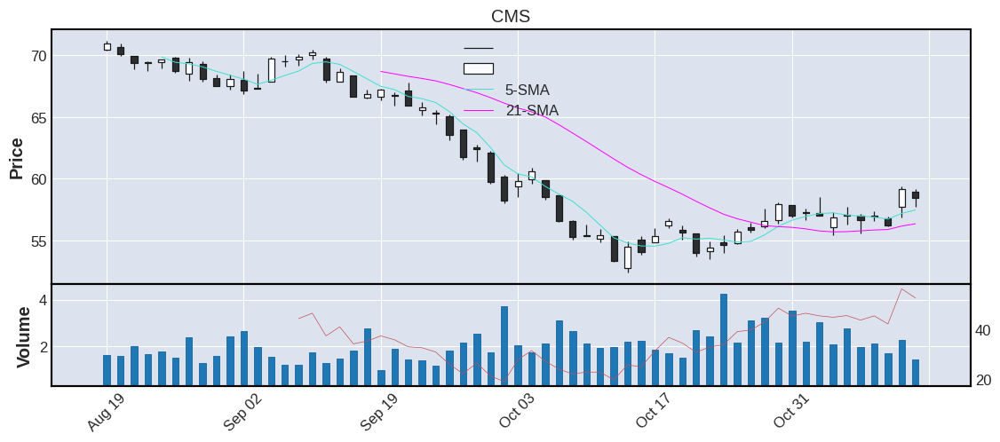



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
23    PNW  71.64  62.85  0.57    0.99 -1.32  1.83  2.55  Utilities  0.0  United States   medium


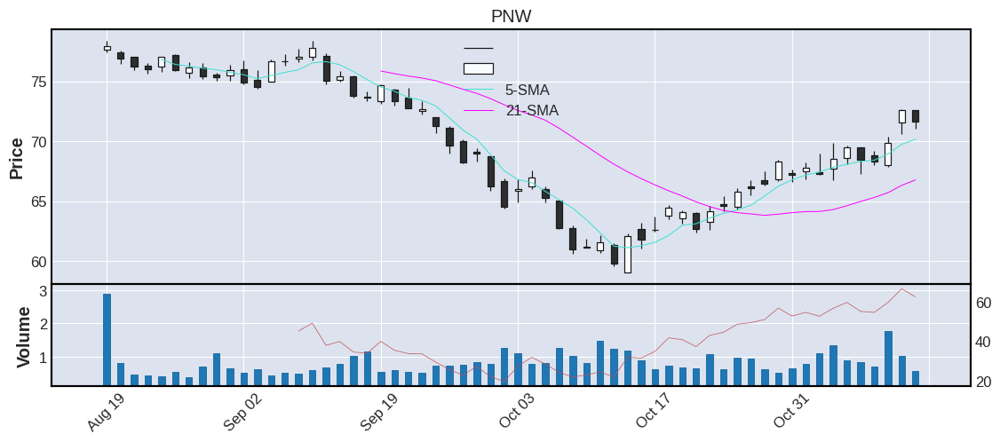



   TICKER      CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
24     WM  158.16  47.22  2.36    1.62 -1.9  3.94  2.49  Utilities  0.0  United States    large


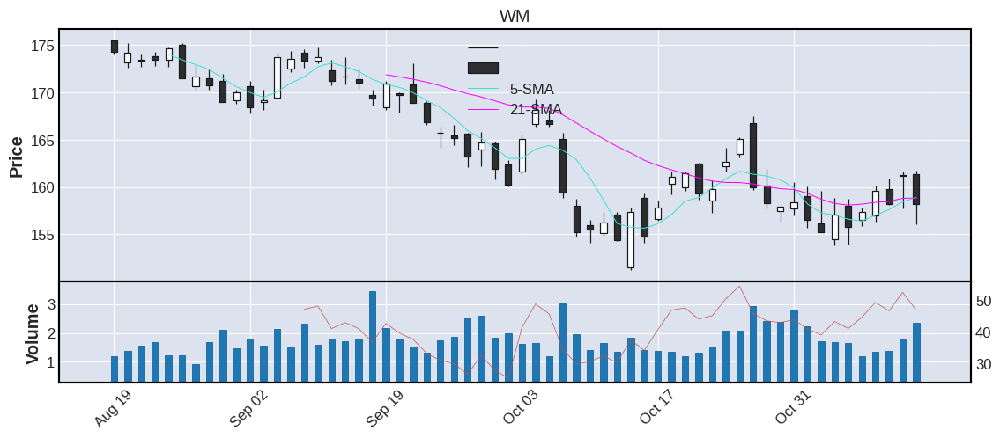



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
25    AEP  89.98  52.56  3.86    3.38 -1.98  2.29  2.55  Utilities  0.0  United States    large


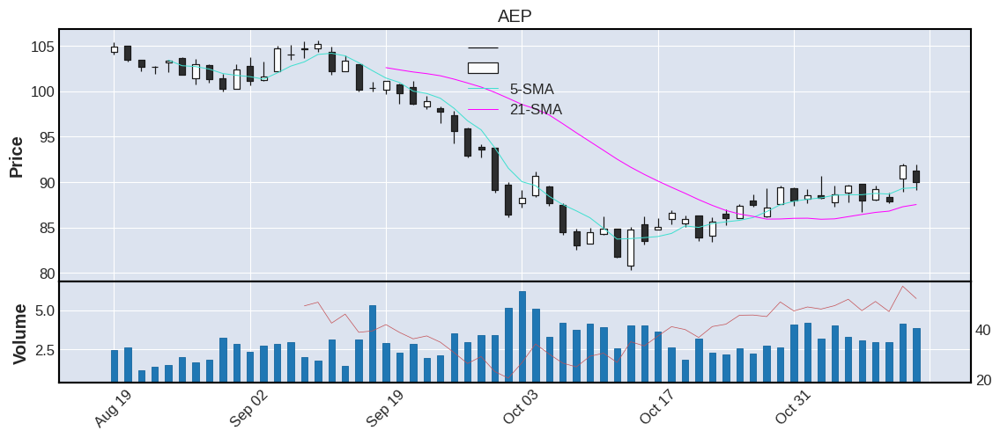



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
26    DUK  95.17  54.16  2.78     3.3 -1.99  2.28   2.4  Utilities  0.0  United States    large


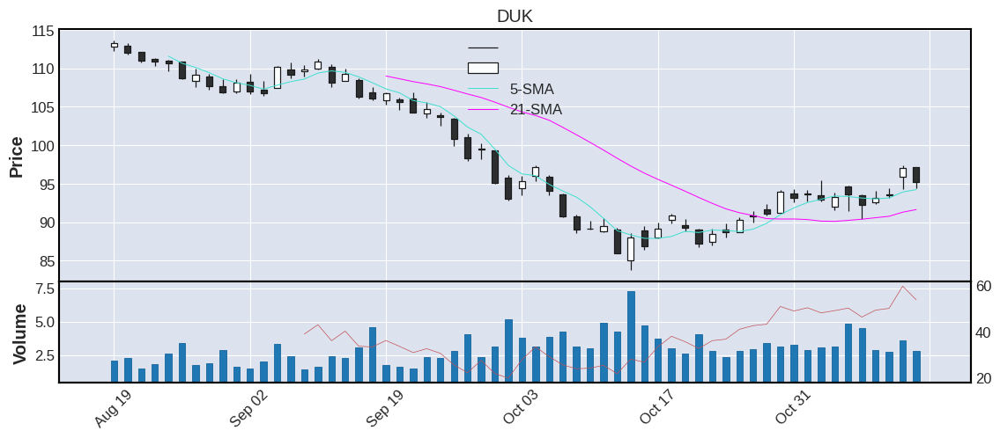



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
27     ED  89.12  53.52  2.26    1.69 -2.01  2.09  2.35  Utilities  0.0  United States    large


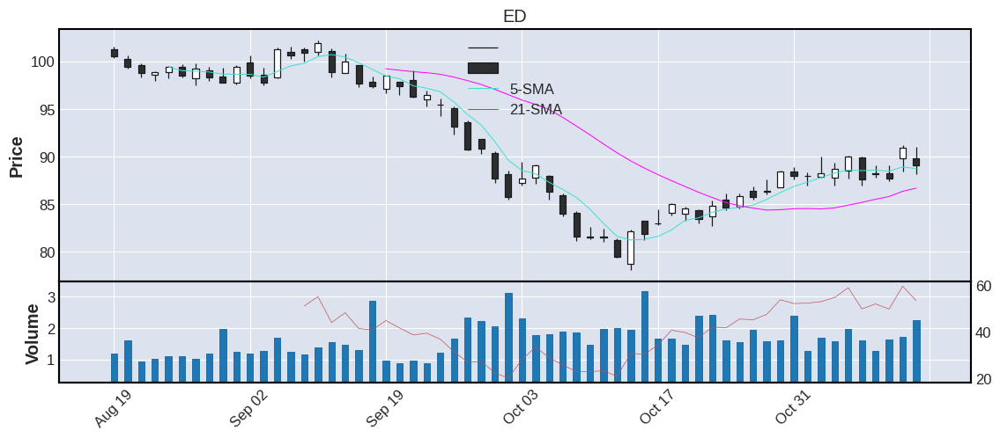



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
28    PEG  58.29  53.26  4.94    4.66 -2.07  1.53  2.62  Utilities  0.0  United States    large


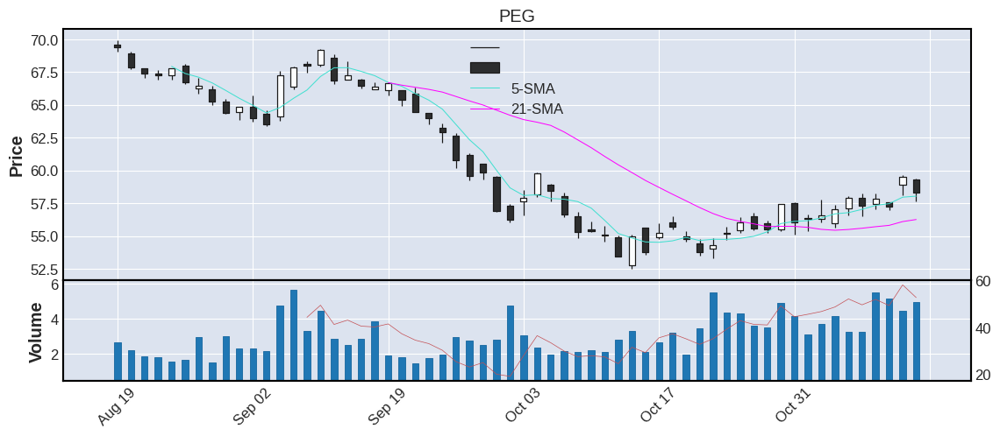



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
29    AEE  83.32  54.58  1.48    2.18 -2.32  2.04  2.45  Utilities  0.0  United States    large


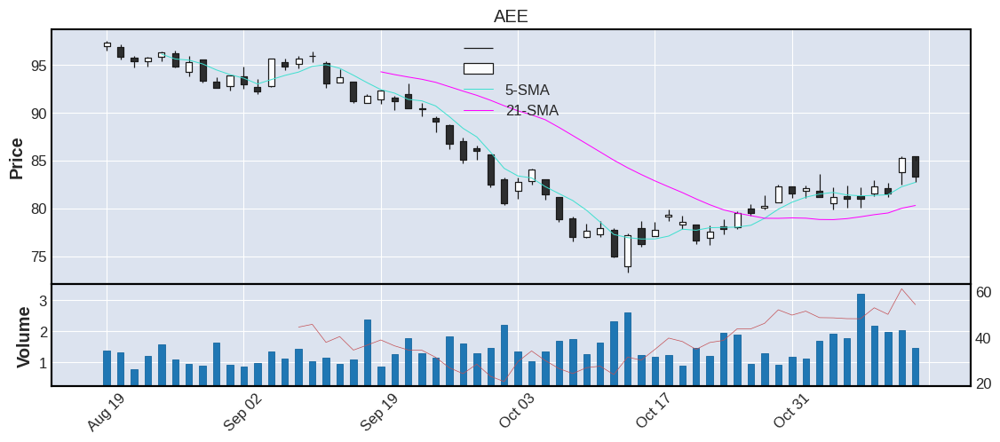



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
30    XEL  67.49  58.09  4.84    4.01 -2.34  1.72  2.55  Utilities  0.0  United States    large


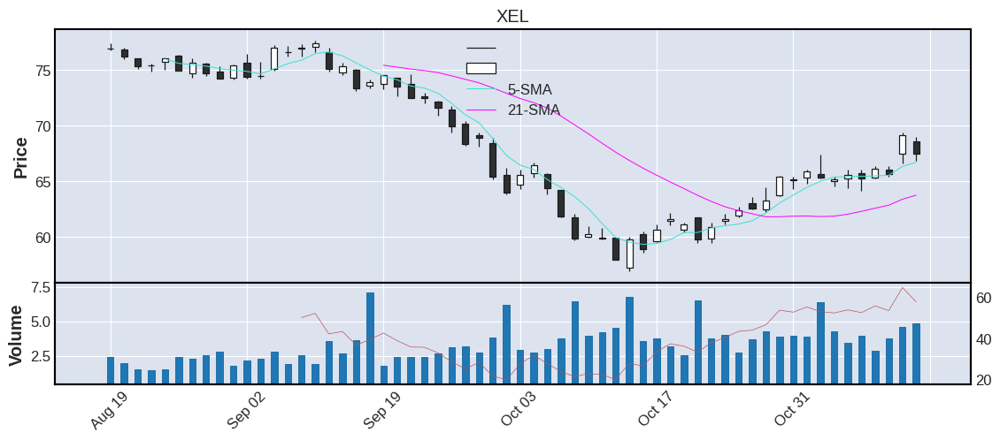



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
31     FE  37.96  50.95  3.3    3.25 -2.64  1.03  2.71  Utilities  0.0  United States    large


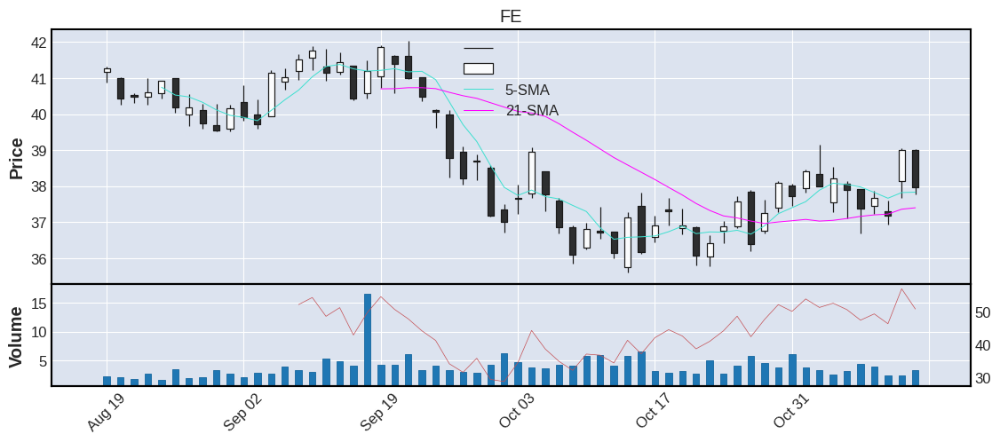



   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO        COUNTRY CATEGORY
32    RSG  131.06  44.57  2.1    1.38 -2.81  3.29  2.51  Utilities  1998.0  United States    large


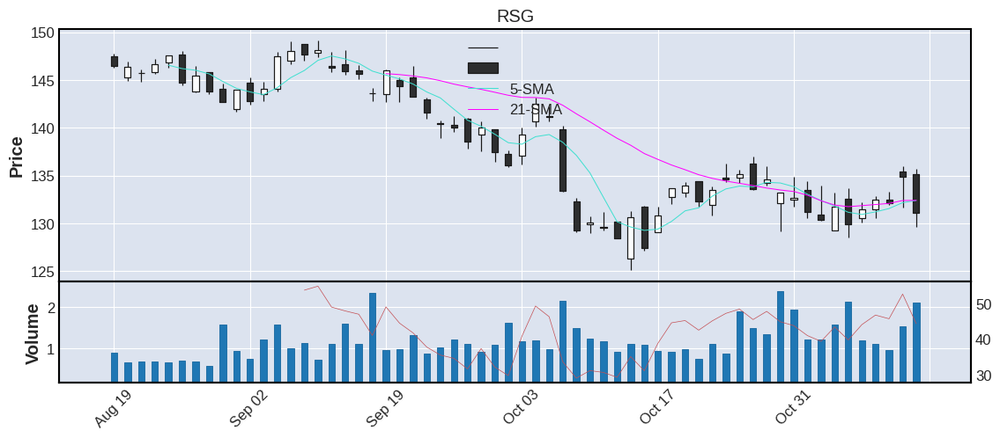



   TICKER     CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
33    LNT  53.93  54.4  2.12    2.46 -2.86  1.49  2.76  Utilities  0.0  United States    large


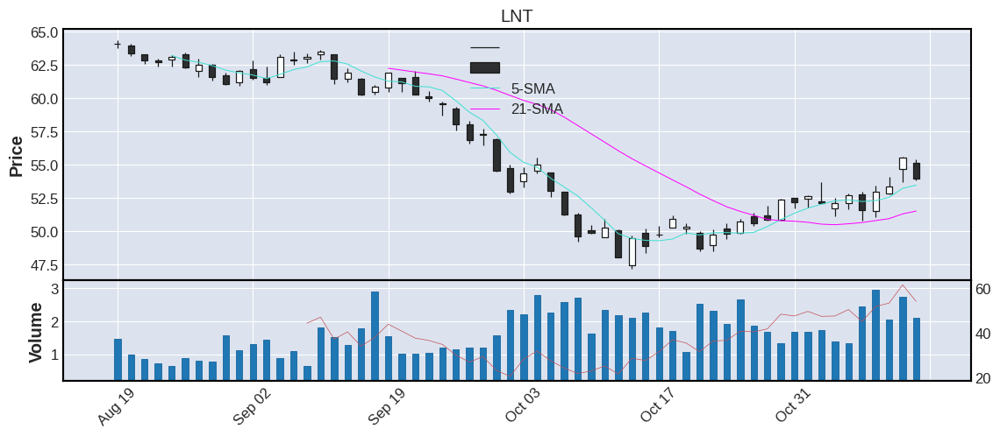



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR  IPO        COUNTRY CATEGORY
34    CEG  92.31  55.01  3.13    3.35 -2.97  3.58  3.88  Utilities  0.0  United States    large


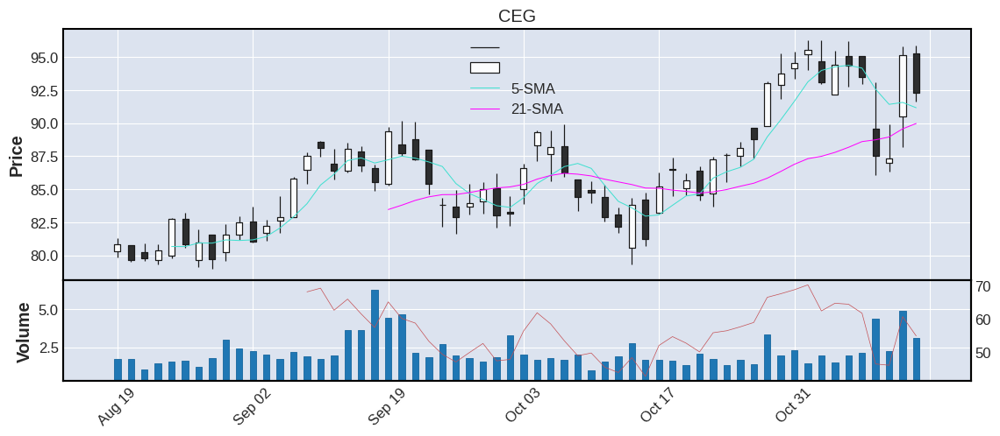



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR     SECTOR     IPO COUNTRY CATEGORY
35   EVRG  59.39  45.13  2.19    2.12 -3.74  1.72   2.9  Utilities  2018.0     N-A    large


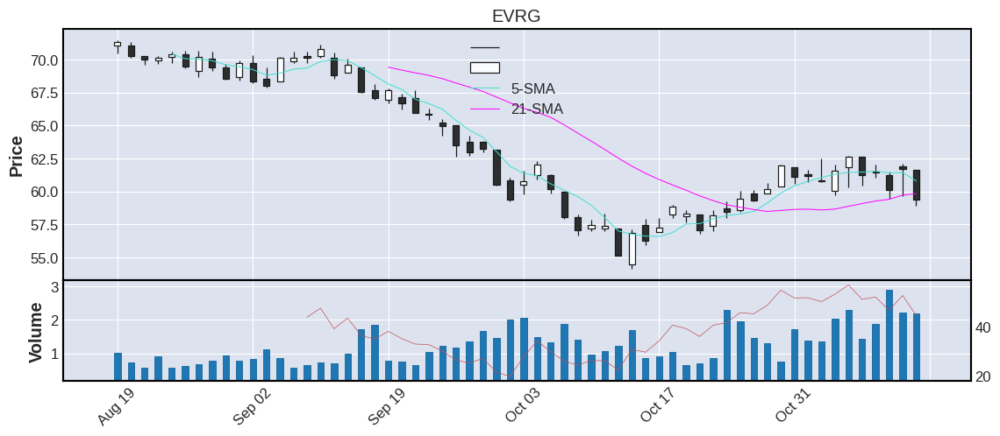



================================================== SECTOR 10: REAL_ESTATE [ %CHG ] ================================================== 

    TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
1     DLR  111.58  67.53  2.80    2.15  2.75   3.73  3.34  Real_Estate  2004.0  United States    large
2     VNO   25.77  64.96  3.78    3.77  2.71   1.07  4.15  Real_Estate     0.0  United States   medium
3     HST   18.56  59.71  6.25    7.29  2.37   0.65  3.50  Real_Estate     0.0  United States    large
4    WELL   71.58  71.48  3.01    3.88  2.17   2.28  3.19  Real_Estate     0.0  United States    large
5    EQIX  660.60  71.67  0.66    0.59  1.94  22.12  3.35  Real_Estate  2000.0  United States    large
6     CCI  140.47  58.21  2.72    2.52  1.31   4.40  3.13  Real_Estate     0.0  United States    large
7     AMT  223.26  64.28  1.92    2.03  1.07   7.51  3.36  Real_Estate     0.0  United States    large
8     VTR   45.31  68.19  2.25    3.1

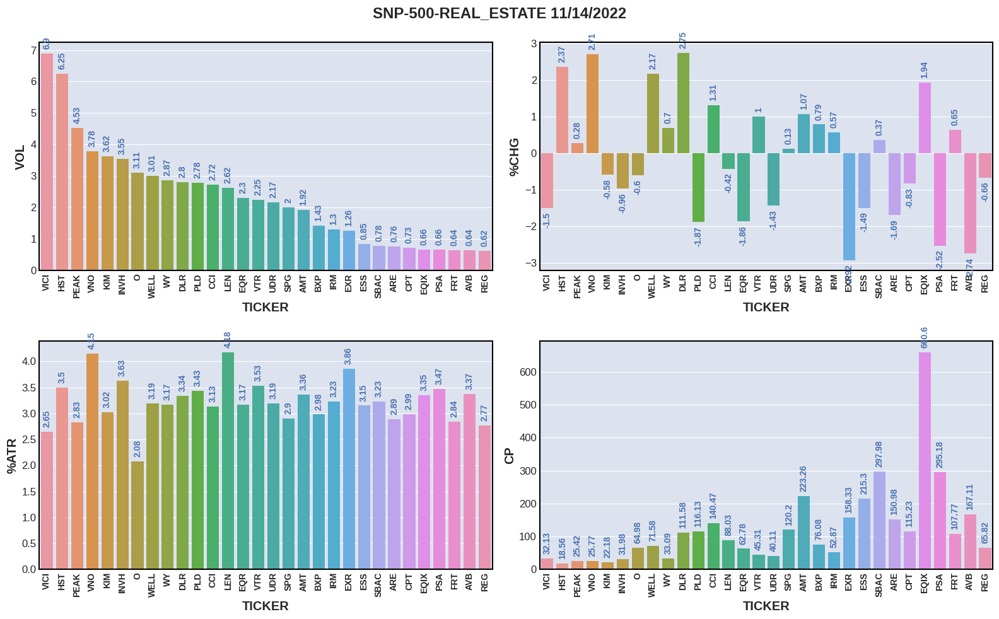

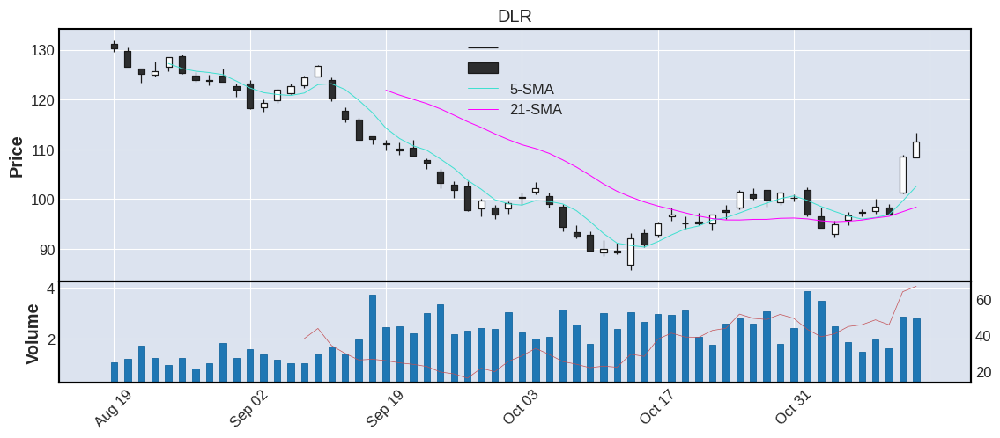



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
2    VNO  25.77  64.96  3.78    3.77  2.71  1.07  4.15  Real_Estate  0.0  United States   medium


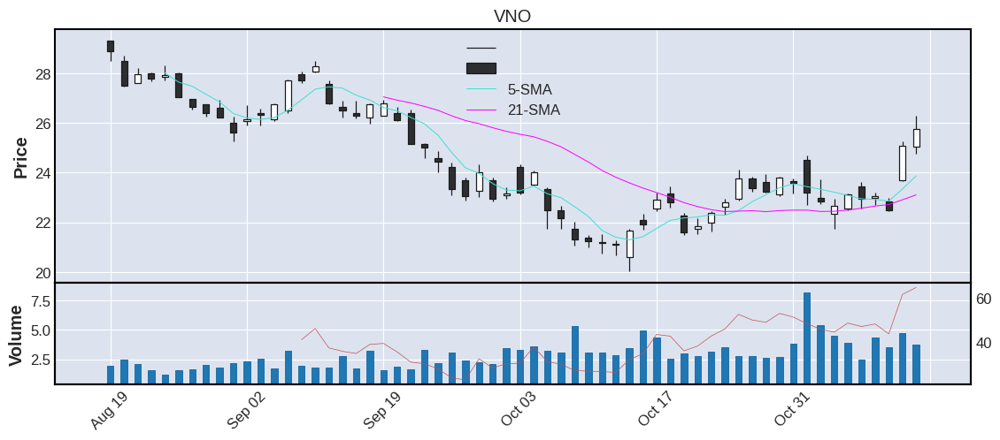



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
3    HST  18.56  59.71  6.25    7.29  2.37  0.65   3.5  Real_Estate  0.0  United States    large


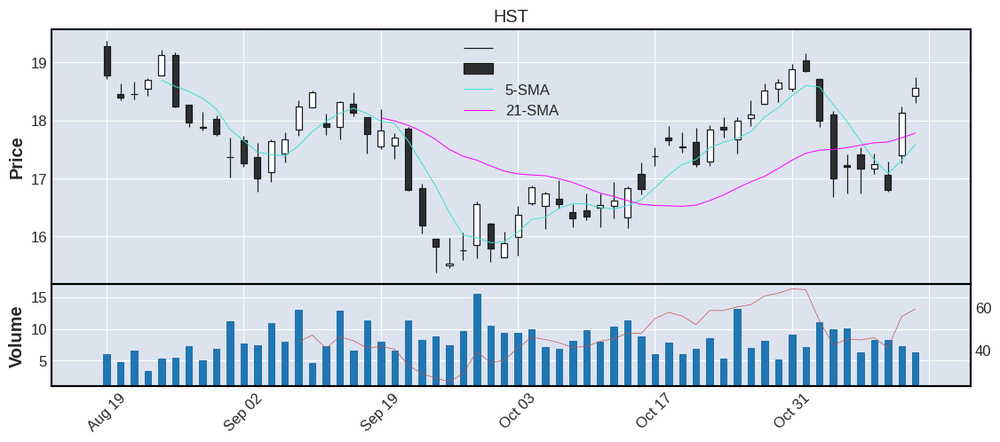



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
4   WELL  71.58  71.48  3.01    3.88  2.17  2.28  3.19  Real_Estate  0.0  United States    large


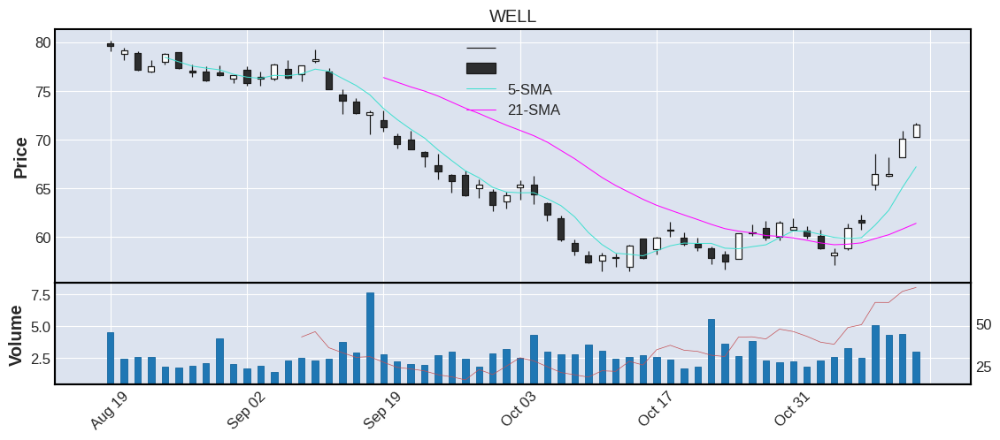



  TICKER     CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
5   EQIX  660.6  71.67  0.66    0.59  1.94  22.12  3.35  Real_Estate  2000.0  United States    large


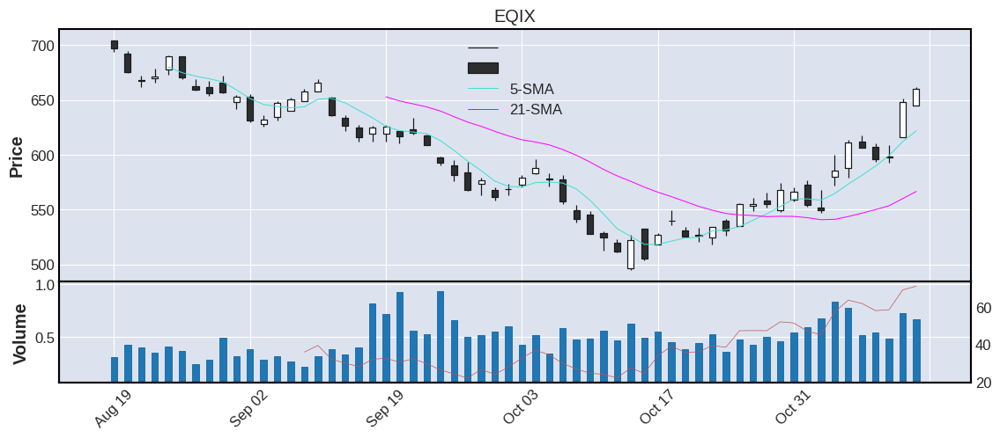



  TICKER      CP    RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
6    CCI  140.47  58.21  2.72    2.52  1.31  4.4  3.13  Real_Estate  0.0  United States    large


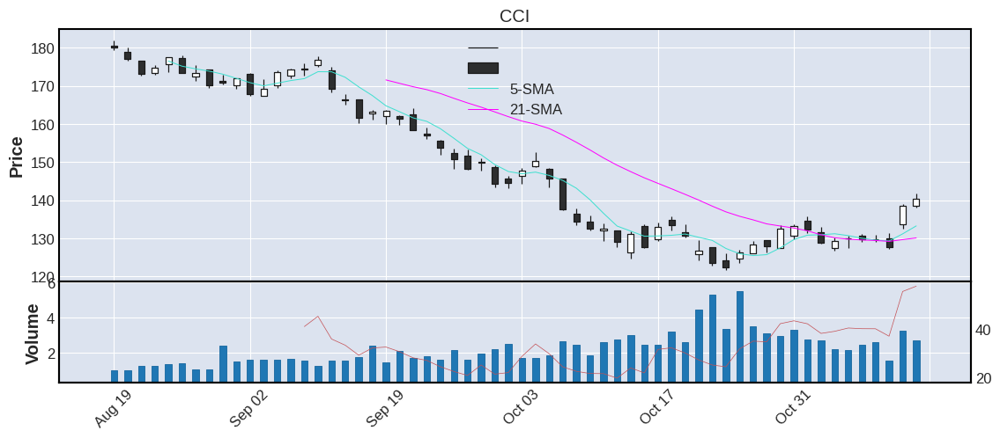



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
7    AMT  223.26  64.28  1.92    2.03  1.07  7.51  3.36  Real_Estate  0.0  United States    large


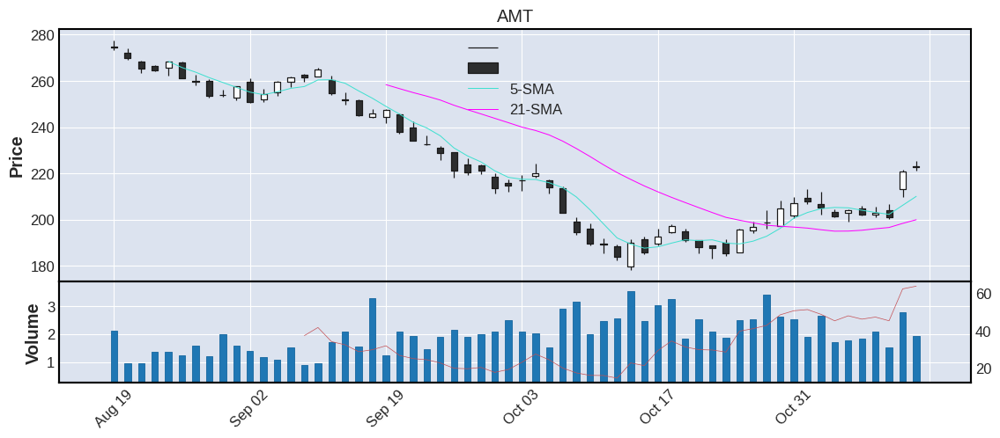



  TICKER     CP    RSI   VOL  AVGVOL %CHG  ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
8    VTR  45.31  68.19  2.25    3.18  1.0  1.6  3.53  Real_Estate  0.0  United States    large


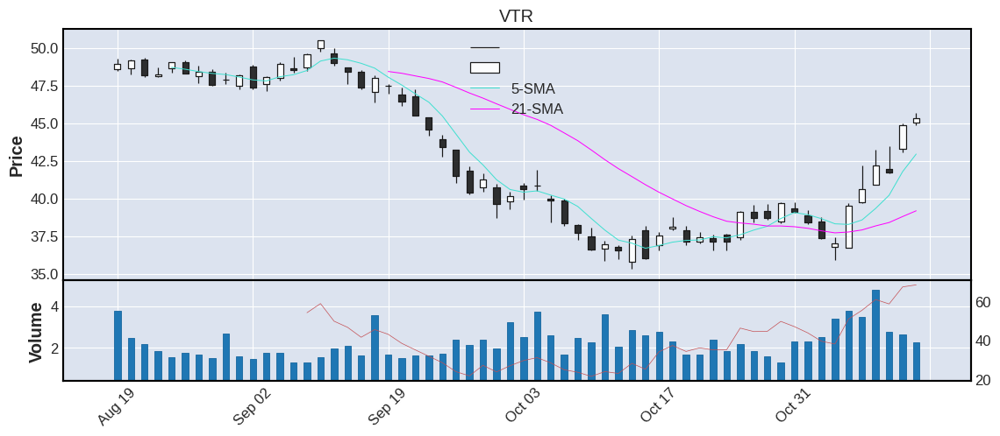



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
9    BXP  76.08  57.62  1.43    1.58  0.79  2.27  2.98  Real_Estate  1997.0  United States    large


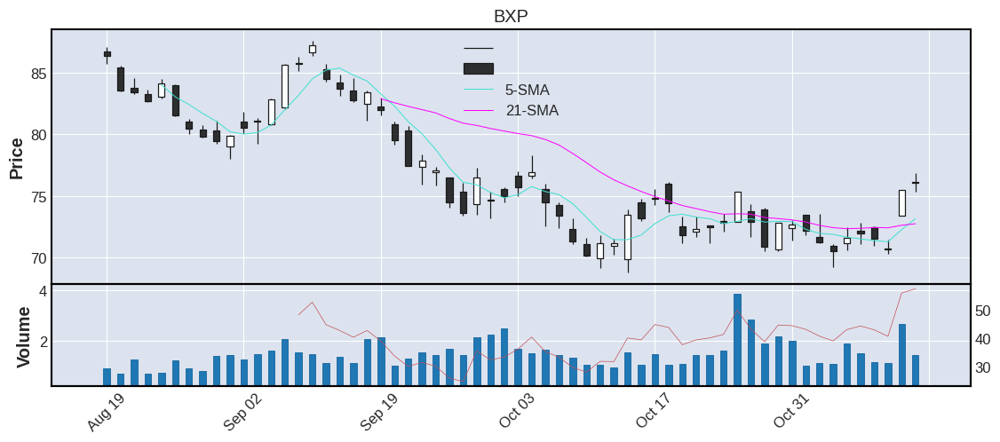



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
10     WY  33.09  64.85  2.87    3.24  0.7  1.05  3.17  Real_Estate  0.0  United States    large


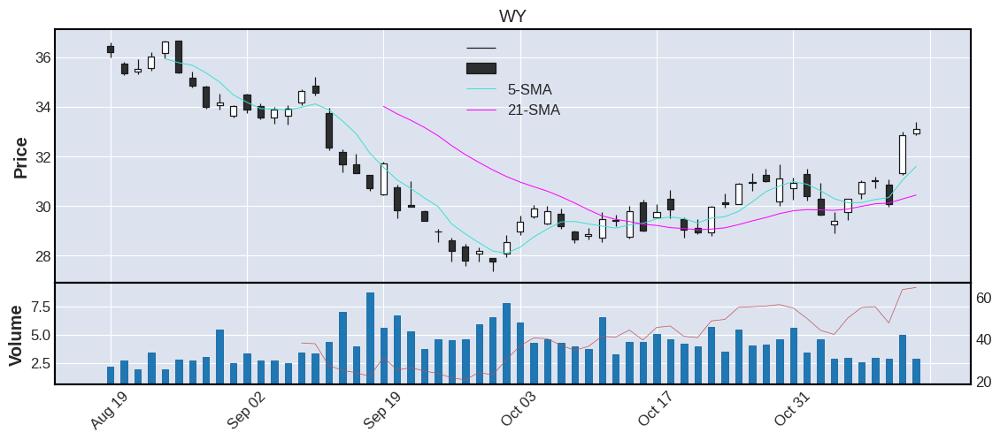



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
11    FRT  107.77  68.43  0.64    0.62  0.65  3.06  2.84  Real_Estate  0.0  United States   medium


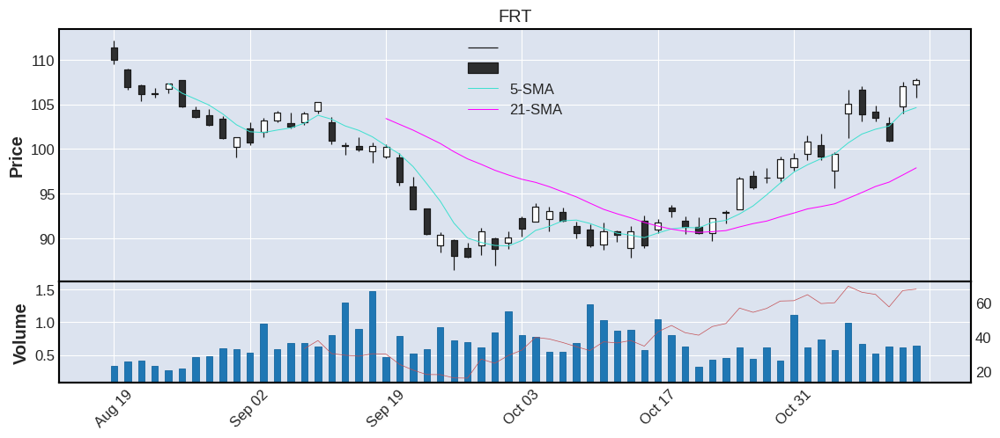



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
12    IRM  52.87  64.86  1.3    1.32  0.57  1.71  3.23  Real_Estate  0.0  United States    large


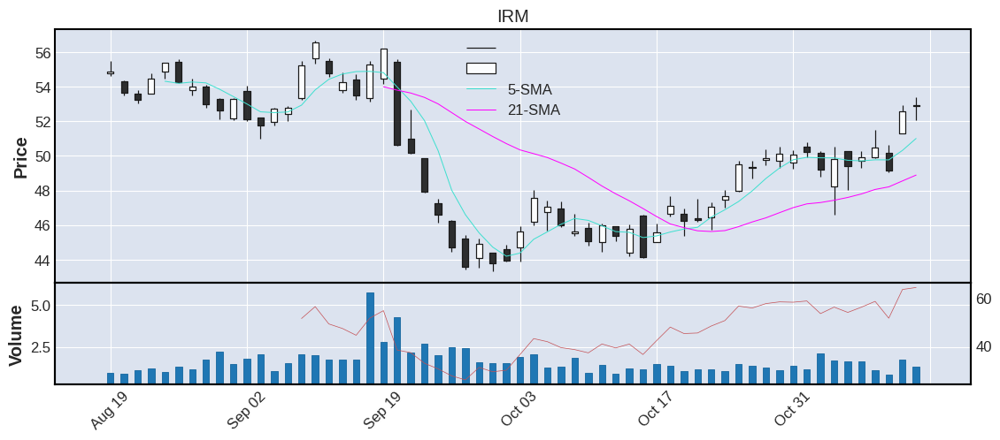



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
13   SBAC  297.98  66.27  0.78    0.86  0.37  9.61  3.23  Real_Estate  1999.0  United States    large


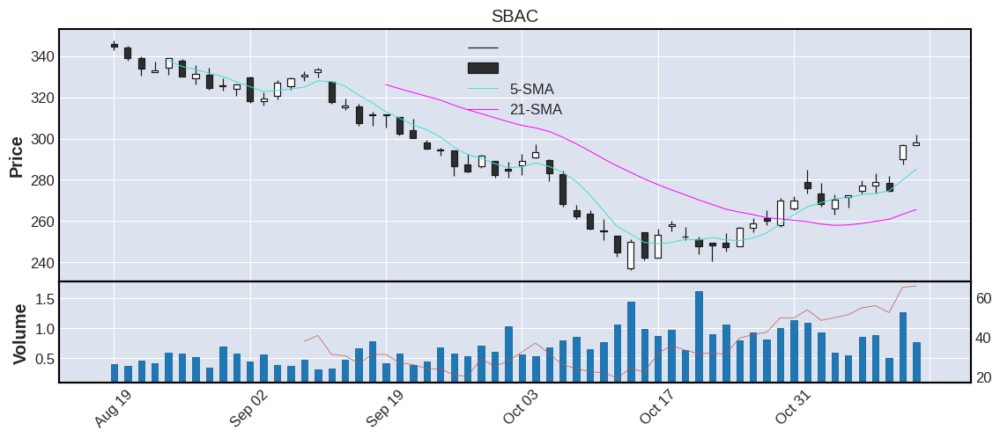



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
14   PEAK  25.42  67.52  4.53    4.03  0.28  0.72  2.83  Real_Estate  0.0  United States    large


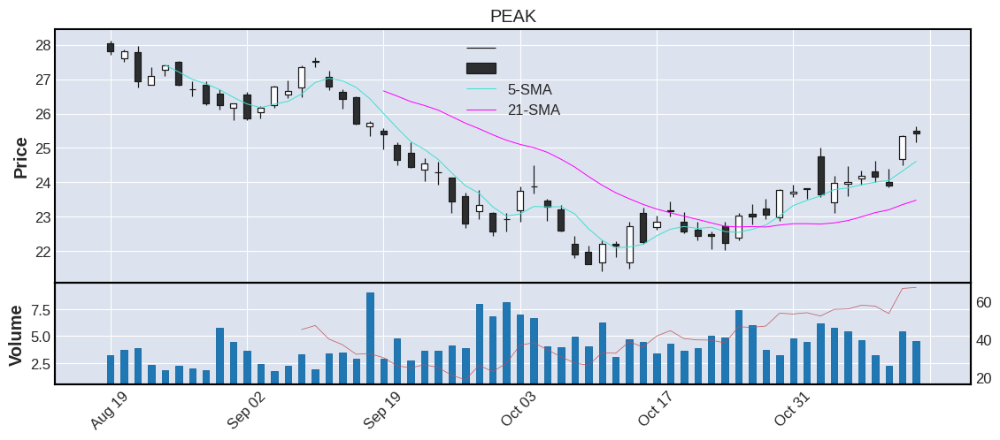



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
15    SPG  120.2  73.12  2.0    2.02  0.13  3.49   2.9  Real_Estate  0.0  United States    large


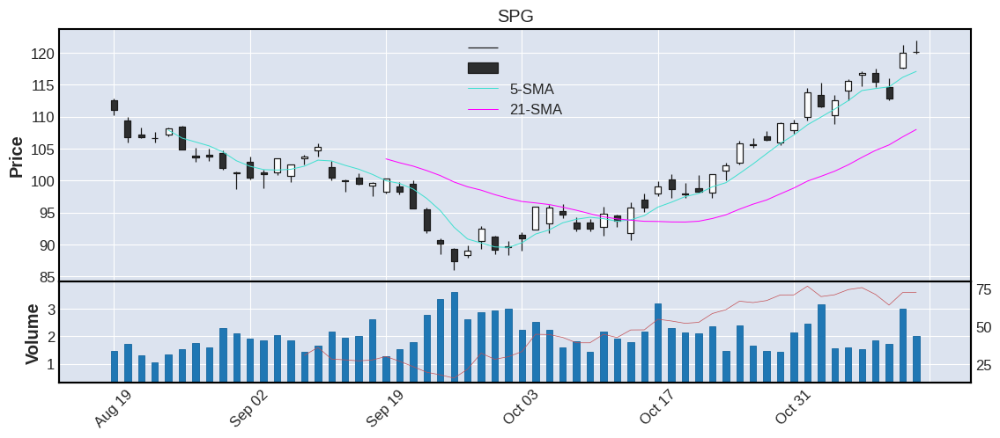



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
16    LEN  88.03  67.44  2.62    2.89 -0.42  3.68  4.18  Real_Estate  0.0  United States    large


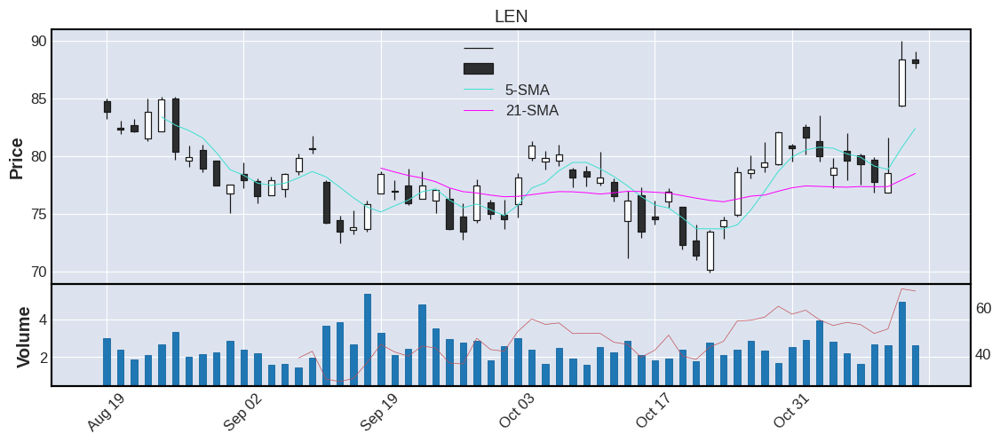



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
17    KIM  22.18  64.79  3.62    4.72 -0.58  0.67  3.02  Real_Estate  0.0  United States    large


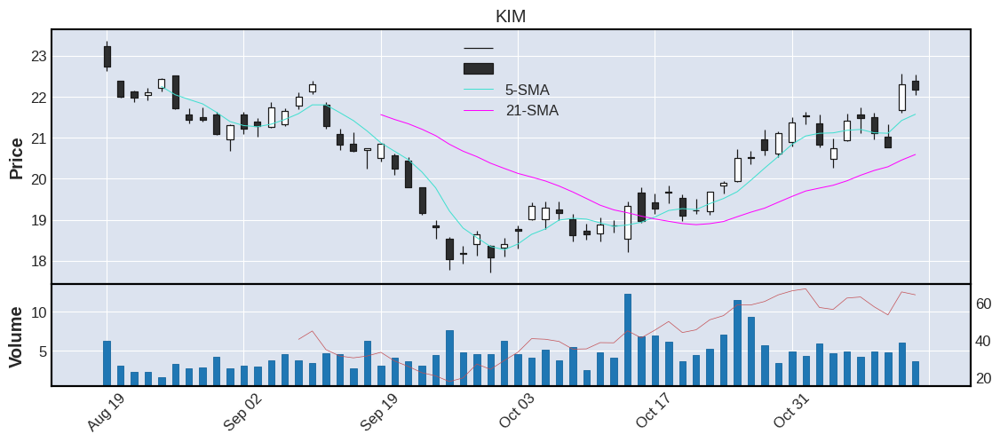



   TICKER     CP    RSI   VOL  AVGVOL %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
18      O  64.98  66.18  3.11    3.41 -0.6  1.35  2.08  Real_Estate  0.0  United States    large


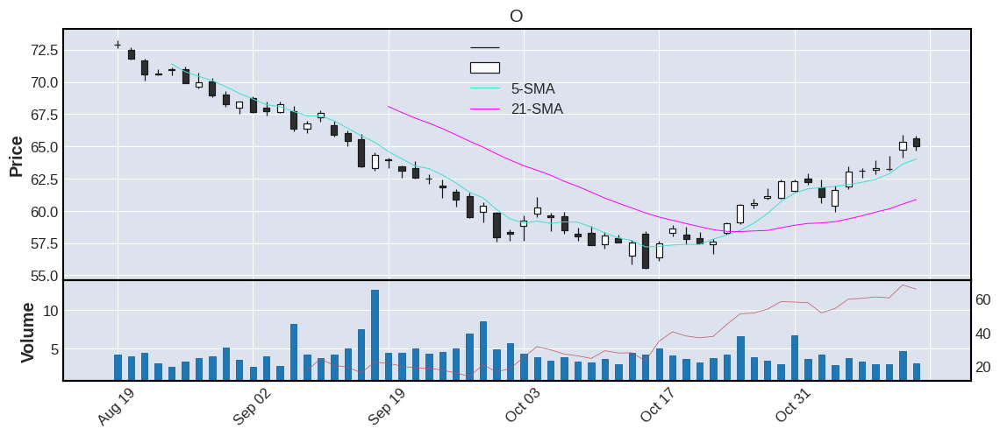



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
19    REG  65.82  69.75  0.62    0.85 -0.66  1.82  2.77  Real_Estate  1993.0  United States    large


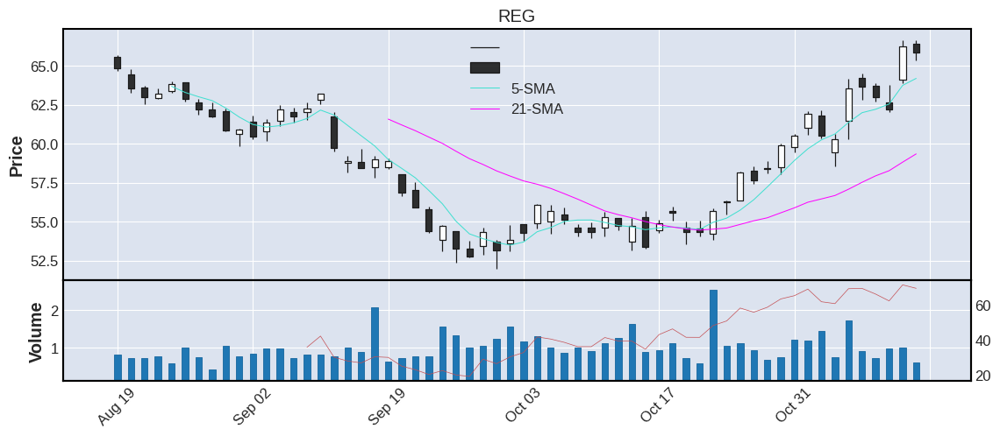



   TICKER      CP   RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
20    CPT  115.23  50.8  0.73    0.72 -0.83  3.44  2.99  Real_Estate  1993.0  United States    large


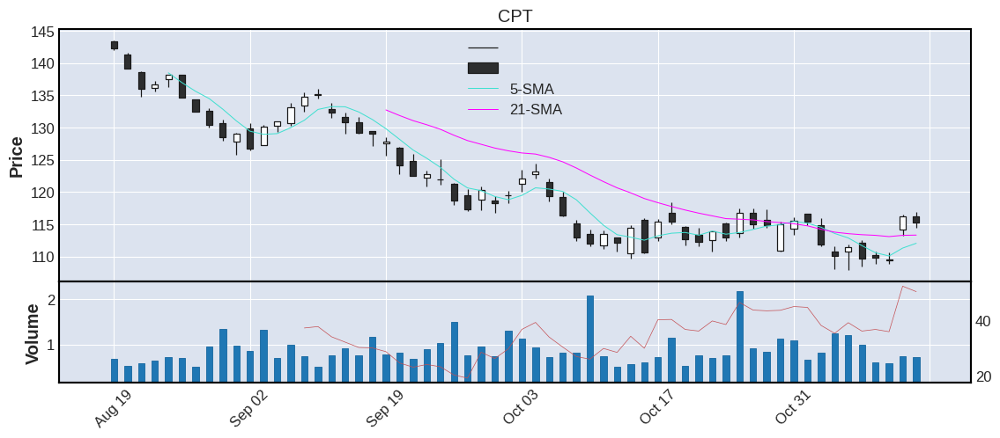



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
21   INVH  31.98  48.36  3.55    4.15 -0.96  1.16  3.63  Real_Estate  2017.0  United States    large


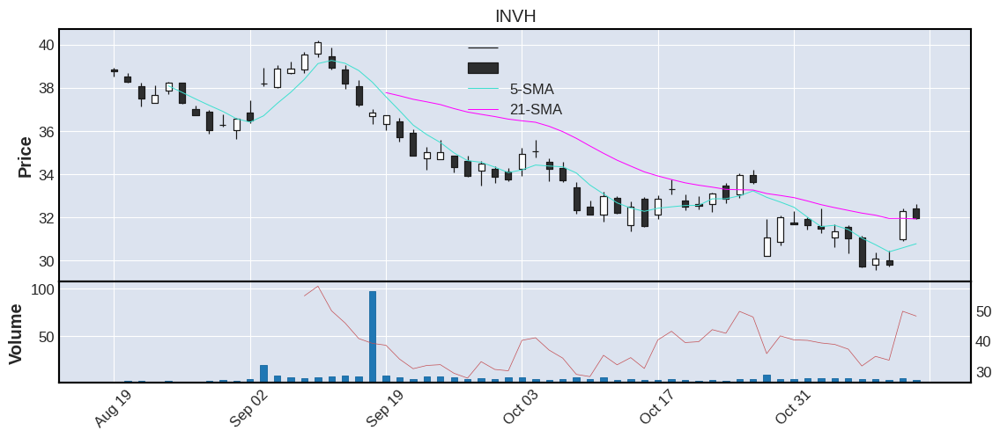



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
22    UDR  40.11  52.51  2.17    2.71 -1.43  1.28  3.19  Real_Estate  0.0  United States    large


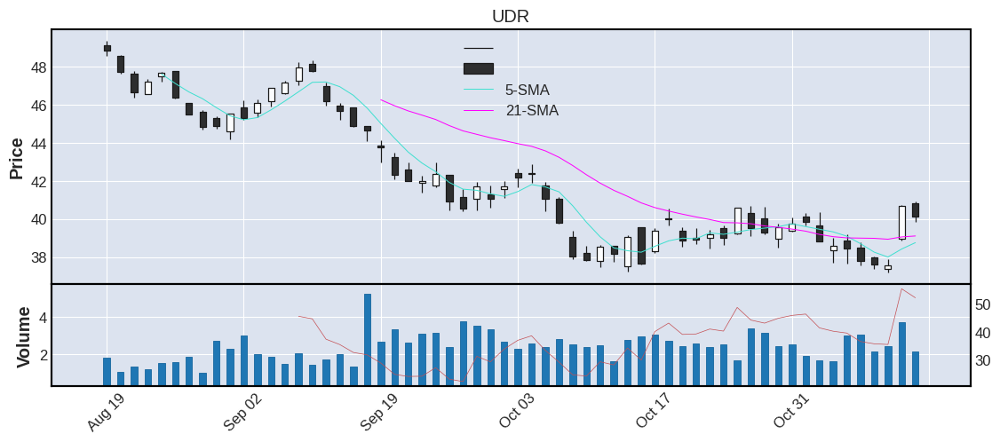



   TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
23    ESS  215.3  41.05  0.85    0.84 -1.49  6.79  3.15  Real_Estate  1994.0  United States    large


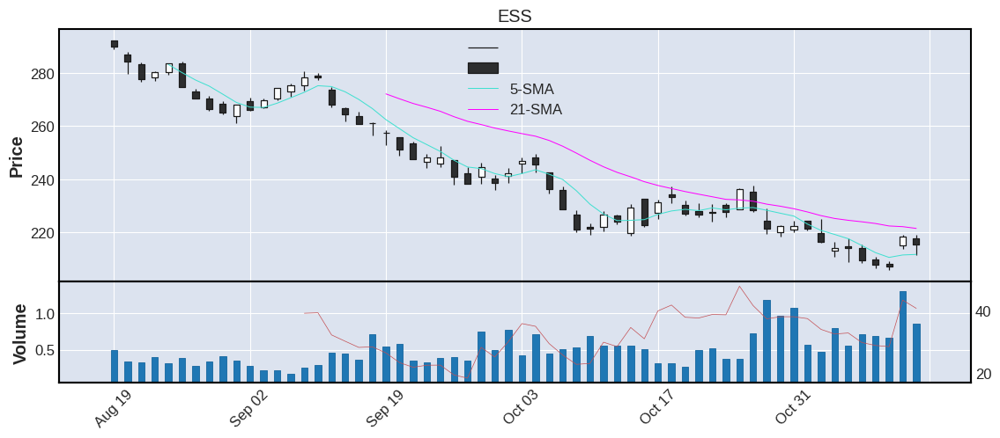



   TICKER     CP    RSI  VOL  AVGVOL %CHG   ATR  %ATR       SECTOR     IPO COUNTRY CATEGORY
24   VICI  32.13  55.21  6.9    7.13 -1.5  0.85  2.65  Real_Estate  2018.0     N-A    large


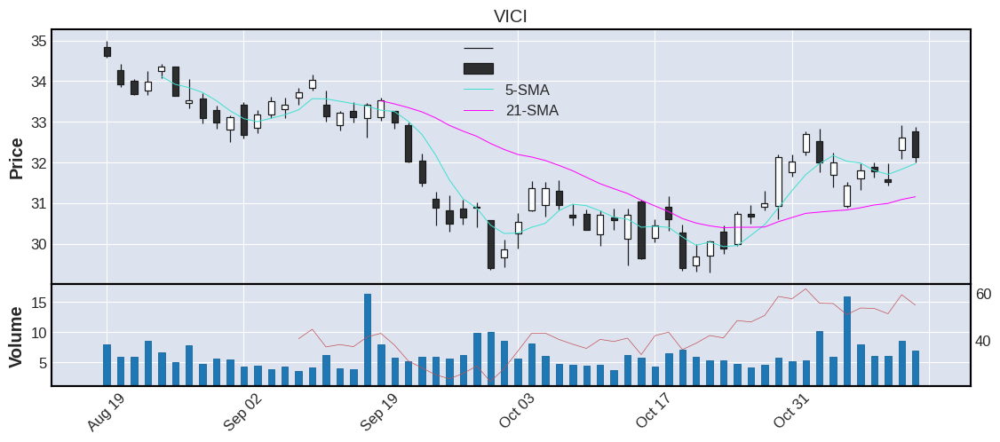



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
25    ARE  150.98  61.15  0.76    0.63 -1.69  4.36  2.89  Real_Estate  0.0  United States    large


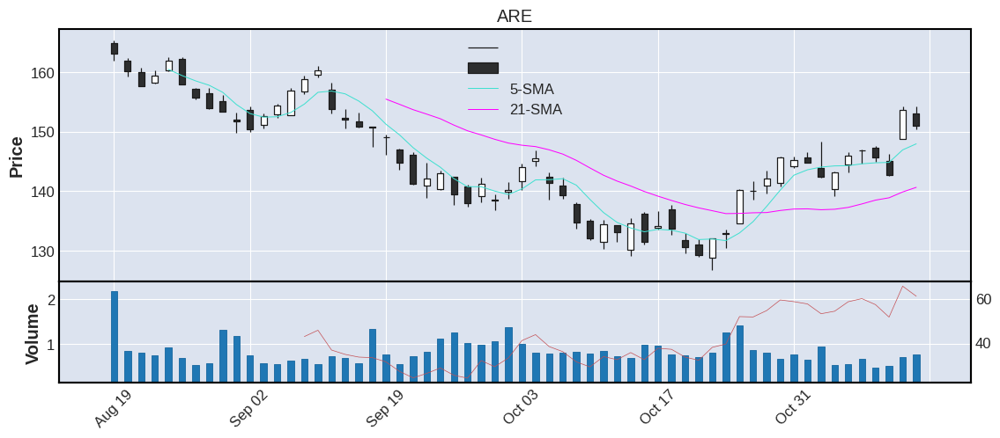



   TICKER     CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
26    EQR  62.78  47.31  2.3    2.12 -1.86  1.99  3.17  Real_Estate  0.0  United States    large


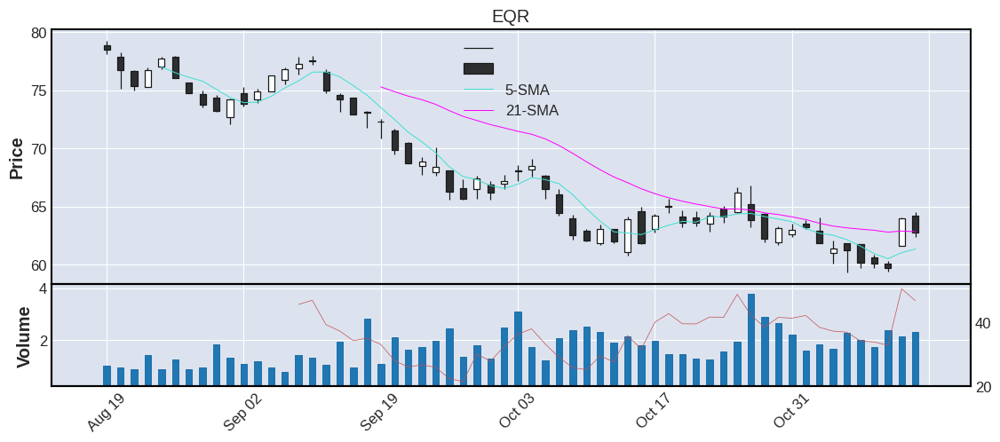



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
27    PLD  116.13  61.78  2.78    3.19 -1.87  3.98  3.43  Real_Estate  0.0  United States    large


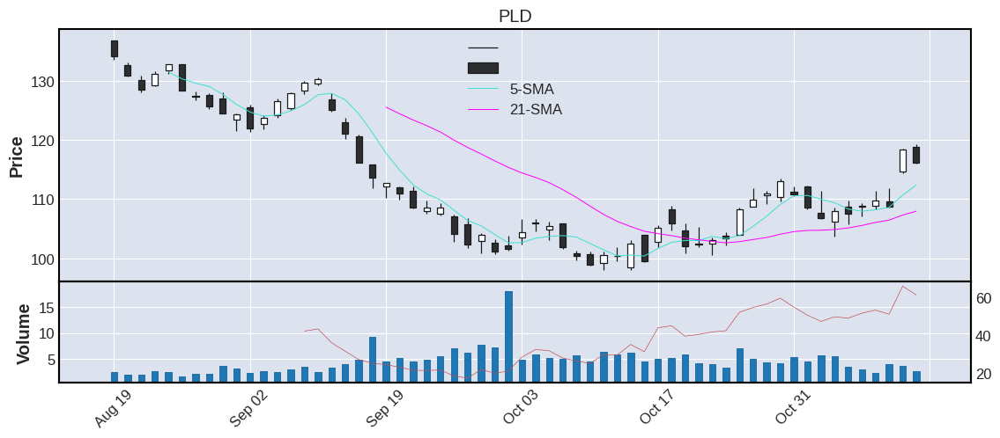



   TICKER      CP   RSI   VOL  AVGVOL  %CHG  ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
28    MAA  160.28  57.4  0.57    0.64 -2.17  4.7  2.93  Real_Estate  1994.0  United States    large


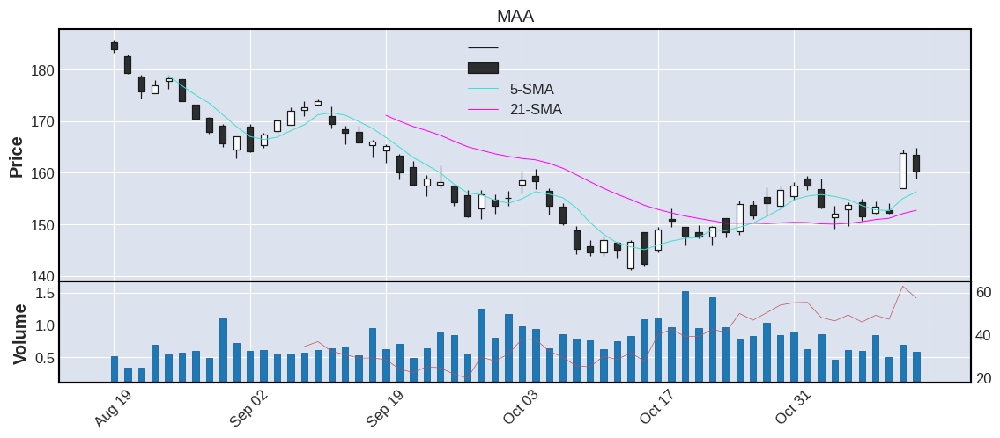



   TICKER      CP    RSI   VOL  AVGVOL  %CHG    ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
29    PSA  295.18  50.71  0.66    0.96 -2.52  10.23  3.47  Real_Estate  0.0  United States    large


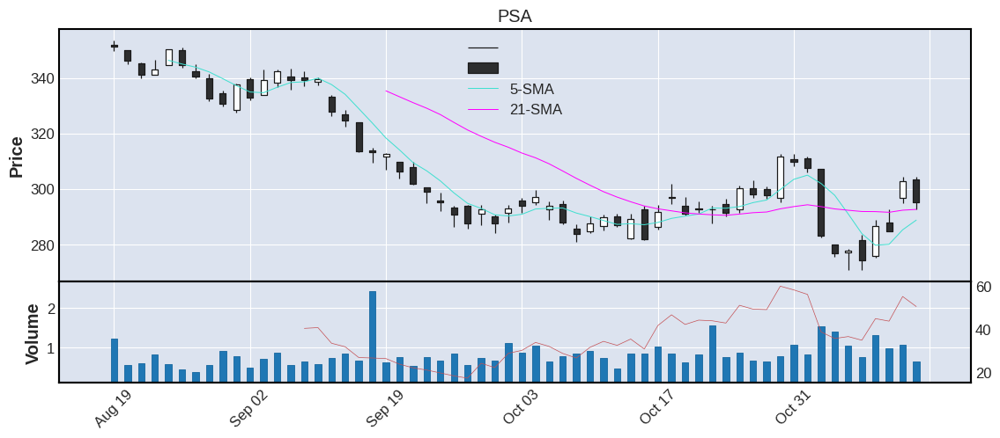



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR  IPO        COUNTRY CATEGORY
30    AVB  167.11  43.43  0.64     1.0 -2.74  5.63  3.37  Real_Estate  0.0  United States    large


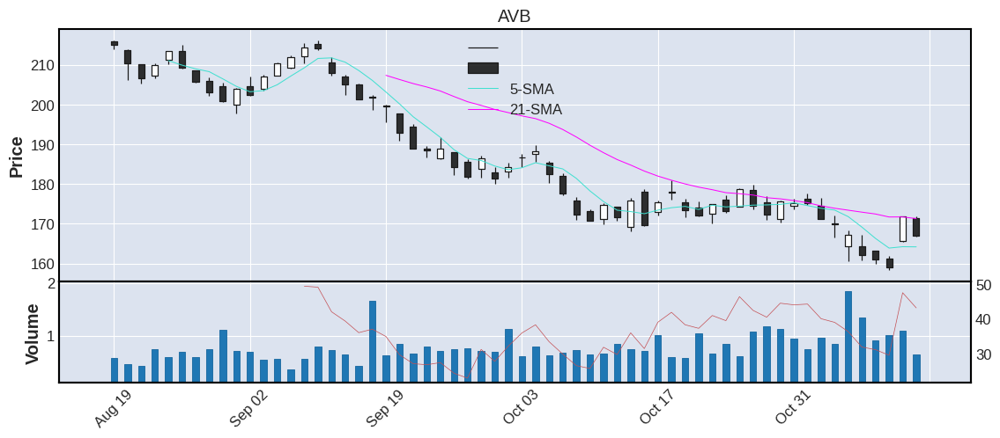



   TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR       SECTOR     IPO        COUNTRY CATEGORY
31    EXR  158.33  42.91  1.26    1.37 -2.92  6.11  3.86  Real_Estate  2004.0  United States    large


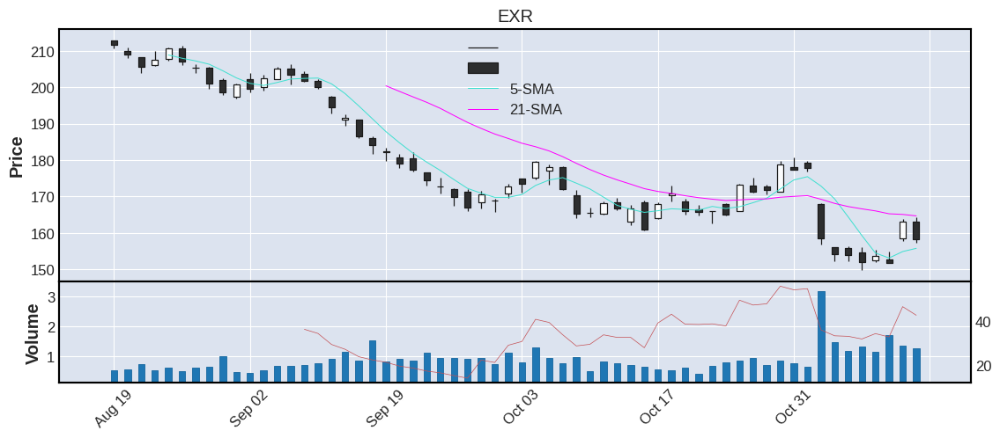



================================================== SECTOR 11: TELECOMMUNICATIONS [ %CHG ] ================================================== 

   TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR     IPO        COUNTRY CATEGORY
1    WBD   11.84  49.32  47.46   41.79  9.63  0.84  7.09  Telecommunications     0.0  United States    large
2    HPE   15.29  71.57  13.76   12.48  2.82  0.40  2.62  Telecommunications  2015.0  United States    large
3     VZ   38.30  54.70  20.54   19.65 -0.57  0.90  2.35  Telecommunications     0.0  United States    large
4   LUMN    6.34  40.16  27.00   28.59 -1.71  0.36  5.68  Telecommunications     0.0  United States   medium
5   CSCO   44.79  56.63  25.06   22.09 -1.91  1.12  2.50  Telecommunications  1990.0  United States    large
6   TMUS  146.19  53.99   7.04    5.35 -2.83  3.38  2.31  Telecommunications     0.0  United States    large


  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR  IPO        C

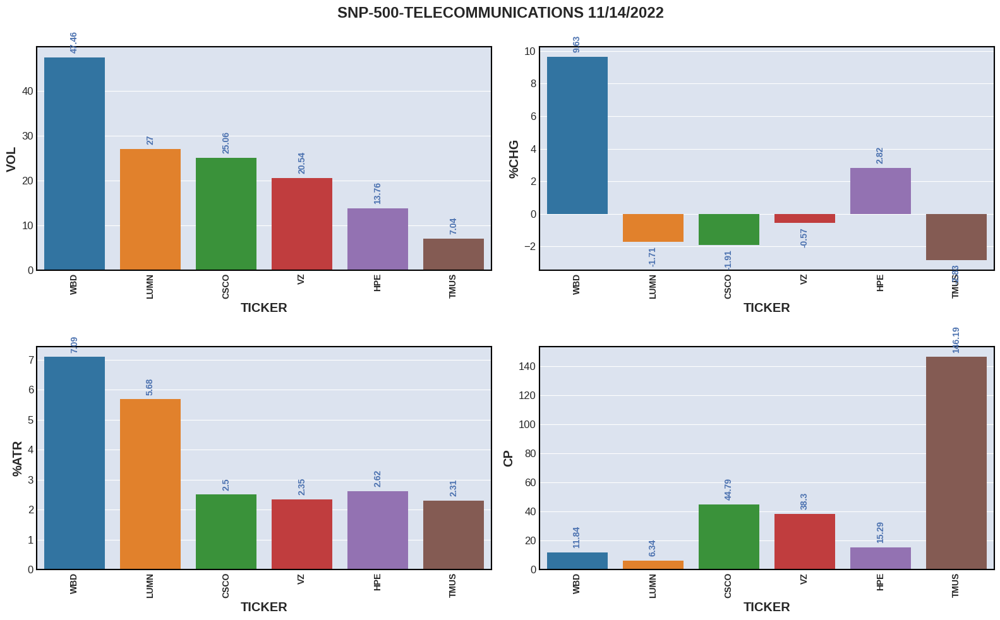

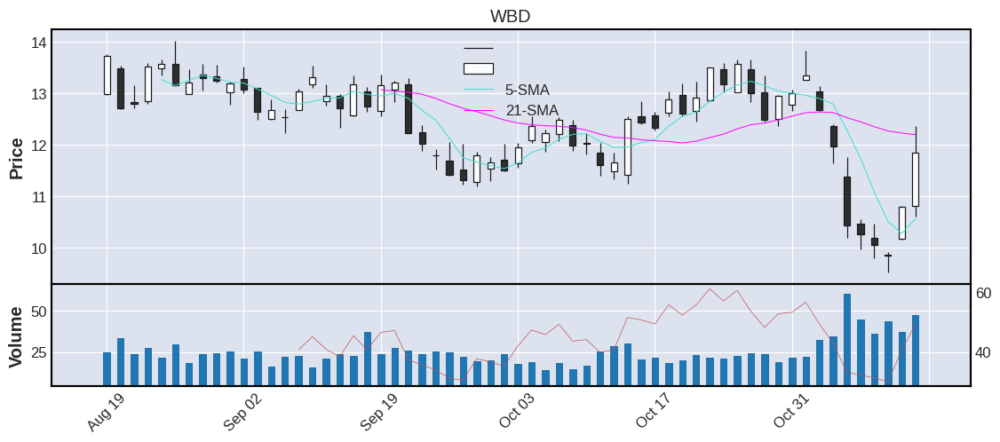



  TICKER     CP    RSI    VOL  AVGVOL  %CHG  ATR  %ATR              SECTOR     IPO        COUNTRY CATEGORY
2    HPE  15.29  71.57  13.76   12.48  2.82  0.4  2.62  Telecommunications  2015.0  United States    large


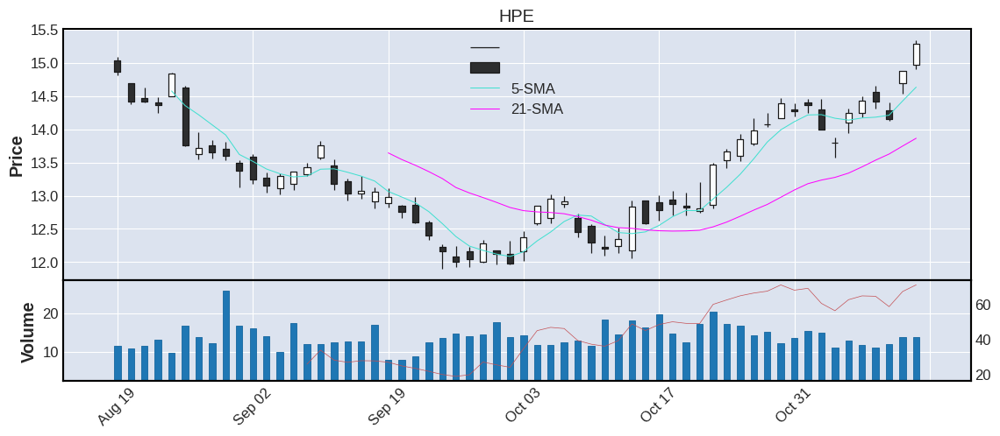



  TICKER    CP   RSI    VOL  AVGVOL  %CHG  ATR  %ATR              SECTOR  IPO        COUNTRY CATEGORY
3     VZ  38.3  54.7  20.54   19.65 -0.57  0.9  2.35  Telecommunications  0.0  United States    large


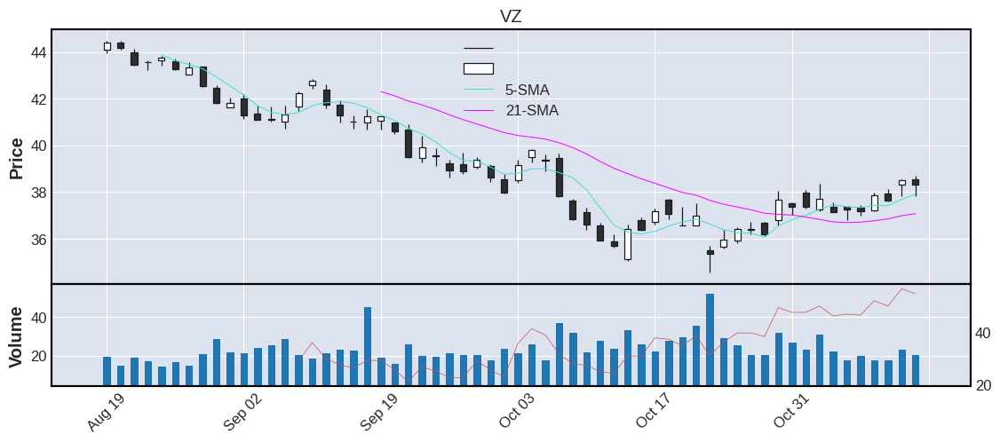



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR  IPO        COUNTRY CATEGORY
4   LUMN  6.34  40.16  27.0   28.59 -1.71  0.36  5.68  Telecommunications  0.0  United States   medium


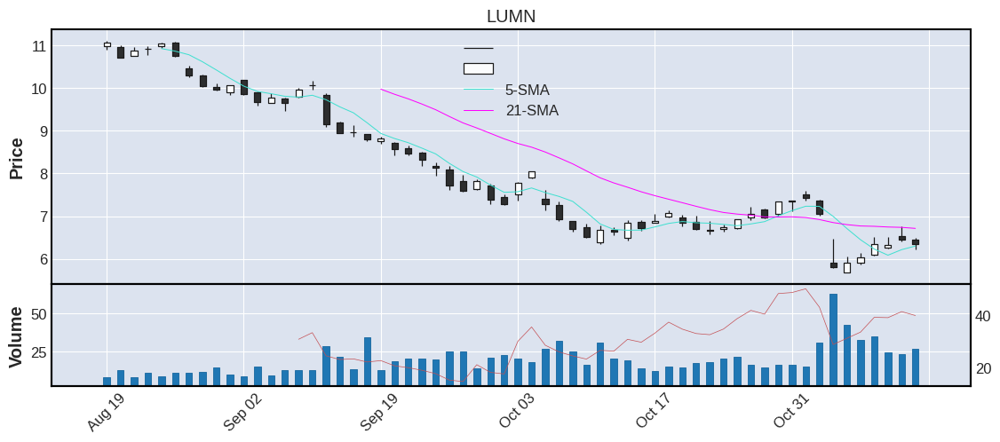



  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR     IPO        COUNTRY CATEGORY
5   CSCO  44.79  56.63  25.06   22.09 -1.91  1.12   2.5  Telecommunications  1990.0  United States    large


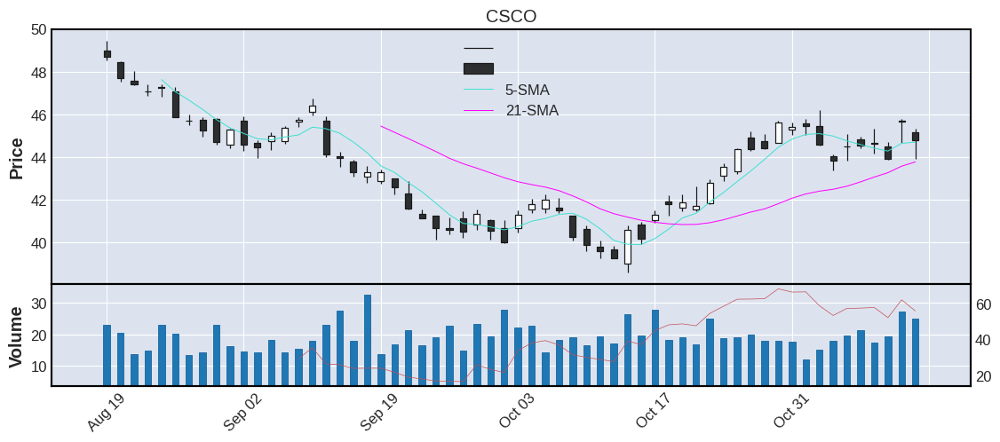



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR              SECTOR  IPO        COUNTRY CATEGORY
6   TMUS  146.19  53.99  7.04    5.35 -2.83  3.38  2.31  Telecommunications  0.0  United States    large


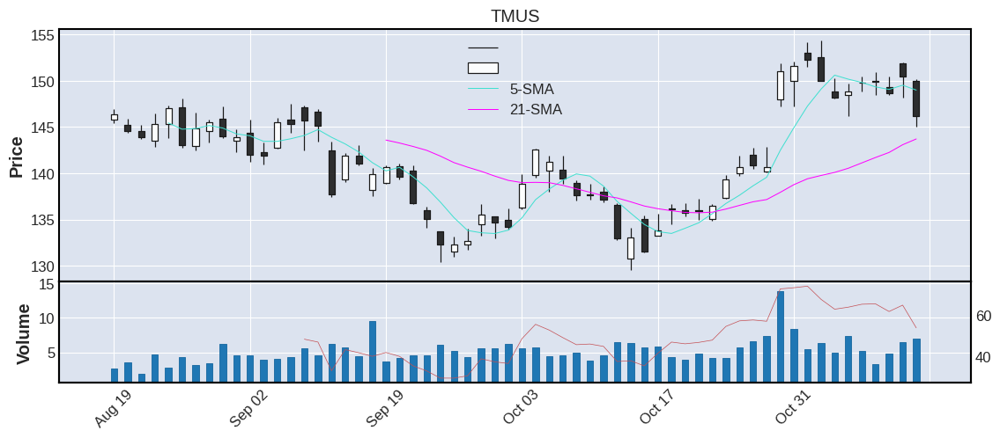



================================================== SECTOR 12: MISCELLANEOUS [ %CHG ] ================================================== 

   TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR         SECTOR  IPO        COUNTRY CATEGORY
1   BBWI   36.00  57.49  4.2    3.70  4.56  1.98  5.50  Miscellaneous  0.0  United States   medium
2    AVY  183.83  61.38  0.7    0.68  0.64  6.53  3.55  Miscellaneous  0.0  United States    large


  TICKER    CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR         SECTOR  IPO        COUNTRY CATEGORY
1   BBWI  36.0  57.49  4.2     3.7  4.56  1.98   5.5  Miscellaneous  0.0  United States   medium


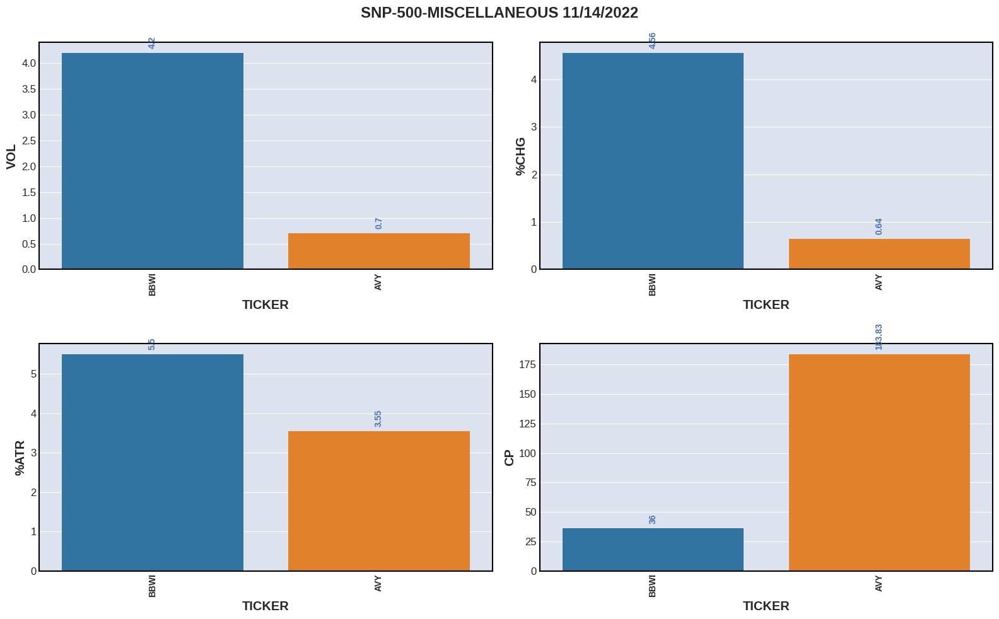

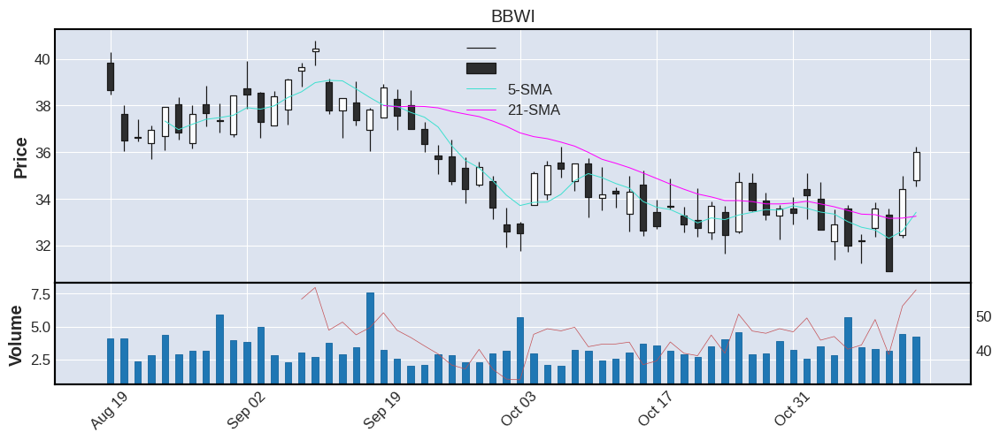



  TICKER      CP    RSI  VOL  AVGVOL  %CHG   ATR  %ATR         SECTOR  IPO        COUNTRY CATEGORY
2    AVY  183.83  61.38  0.7    0.68  0.64  6.53  3.55  Miscellaneous  0.0  United States    large


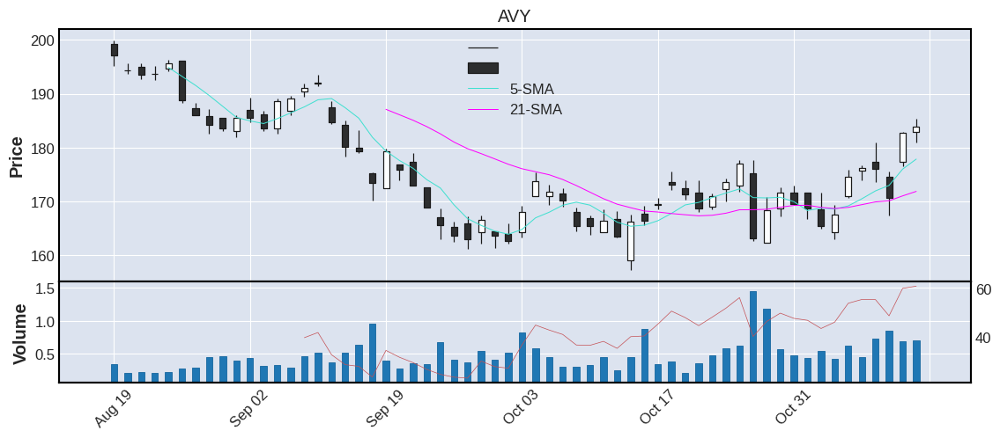



================================================== SECTOR 13: BASIC_MATERIALS [ %CHG ] ================================================== 

   TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR     IPO        COUNTRY CATEGORY
1    FCX   38.04  67.45  22.05   17.64  3.51  1.98  5.21  Basic_Materials     0.0  United States    large
2    PKG  129.47  65.44   0.76    0.98  3.51  3.68  2.84  Basic_Materials  2000.0  United States    large
3    NEM   46.53  63.36   6.81    9.11  0.26  1.72  3.70  Basic_Materials     0.0  United States    large
4   FAST   51.80  64.92   2.77    3.01 -0.13  1.38  2.66  Basic_Materials  1987.0  United States    large


  TICKER     CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR  IPO        COUNTRY CATEGORY
1    FCX  38.04  67.45  22.05   17.64  3.51  1.98  5.21  Basic_Materials  0.0  United States    large


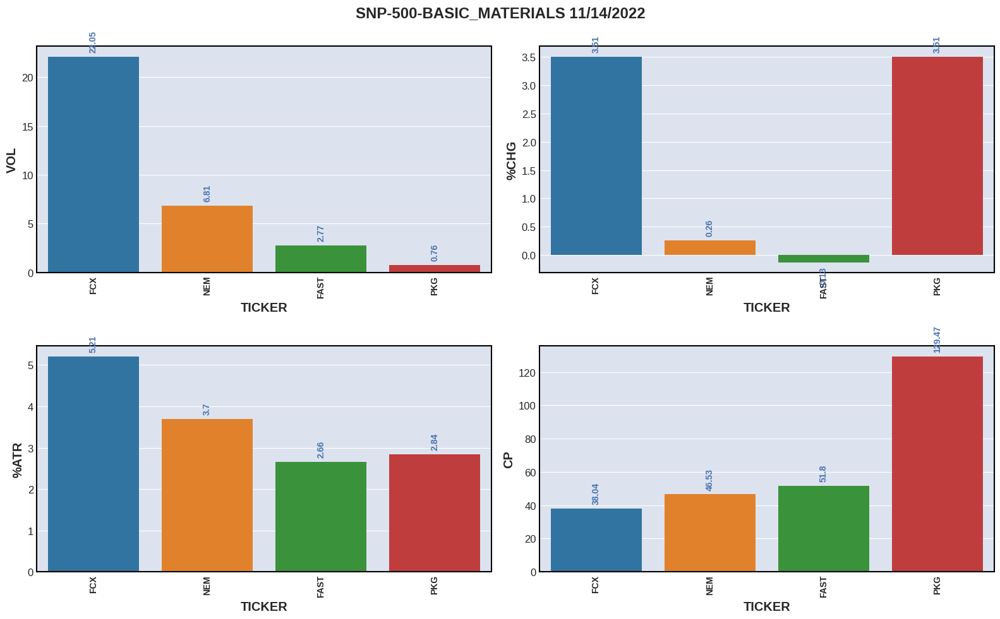

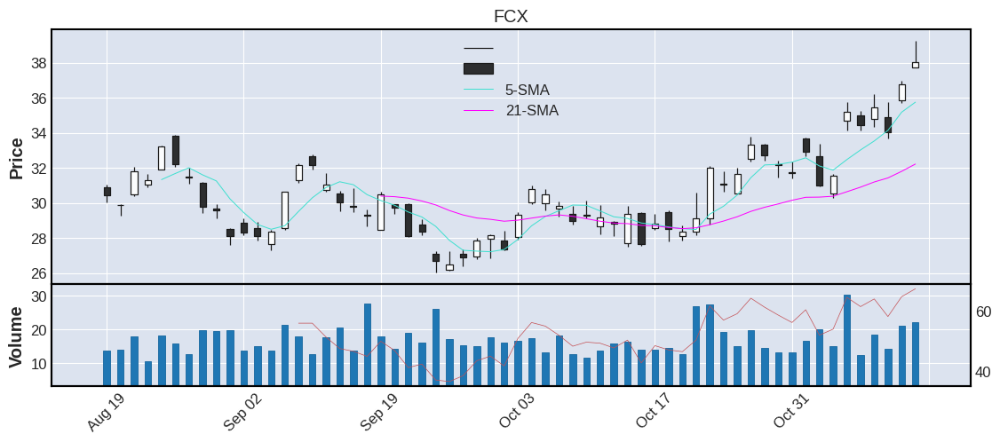



  TICKER      CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR     IPO        COUNTRY CATEGORY
2    PKG  129.47  65.44  0.76    0.98  3.51  3.68  2.84  Basic_Materials  2000.0  United States    large


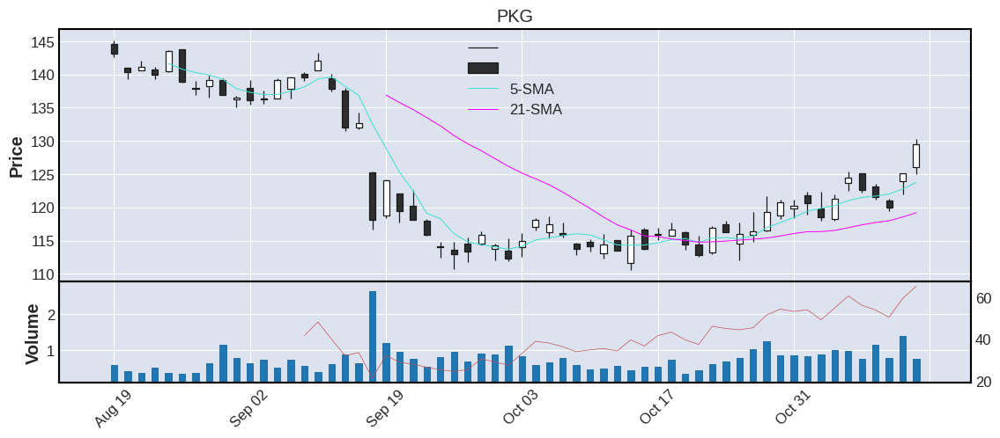



  TICKER     CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR  IPO        COUNTRY CATEGORY
3    NEM  46.53  63.36  6.81    9.11  0.26  1.72   3.7  Basic_Materials  0.0  United States    large


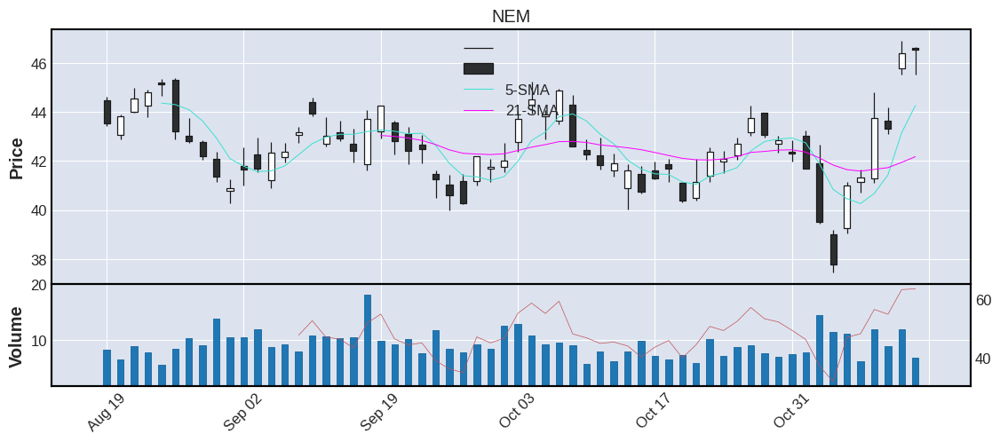



  TICKER    CP    RSI   VOL  AVGVOL  %CHG   ATR  %ATR           SECTOR     IPO        COUNTRY CATEGORY
4   FAST  51.8  64.92  2.77    3.01 -0.13  1.38  2.66  Basic_Materials  1987.0  United States    large


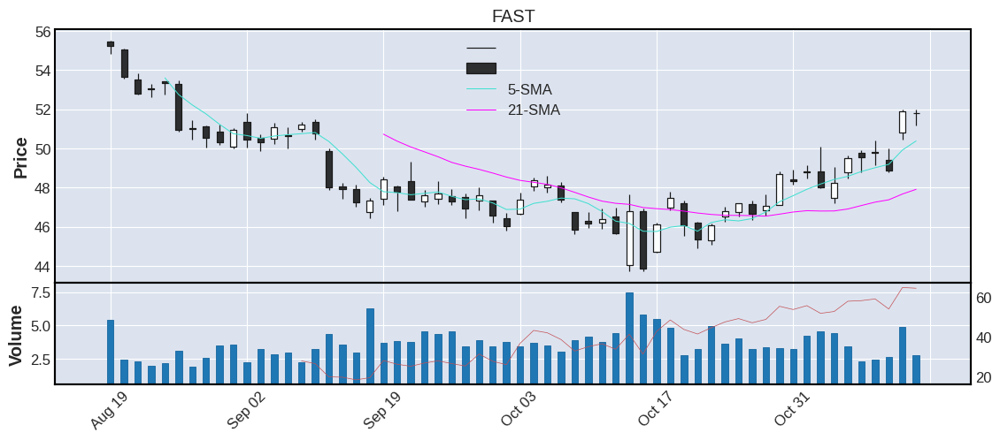

In [30]:
#%%script false --no-raise-error
#ignore_category=['nano','micro']
fmt=25*'=='
#fmt1=35*'**'
choose='%CHG'
how=False
plot=True
show_number=50

for c,country in enumerate(countries):
    if c!=0:continue
    #df_usa=df[(df.COUNTRY==country )]
    df_usa=df[df['TICKER'].isin(snp)].copy()
    #df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
    
    sectors=list(df.SECTOR.unique())
    #print(f"sectors: {sectors}")
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors,start=1):
        #print(f"sector: {sector}");
        temp_df=df_usa[df_usa['SECTOR']==sector].copy();#print(f"\n\n{temp_df.head(10).to_string()}")
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
#         temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
#         temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

#         temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR {s}: {sector.upper()} [ { choose } ] {fmt} \n\n {temp_df.to_string()}")
        compare_bars(temp_df,title="snp-500-"+sector)

        if plot:
            tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
            for c,i in enumerate(tick):
                print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')

# IPO



************************************************** COUNTRY: UNITED STATES ************************************************** 




================================================== SECTOR 1: TECHNOLOGY (IPO)================================================== 

    TICKER     CP    RSI    VOL  AVGVOL   %CHG   ATR  %ATR      SECTOR           INDUSTRY     IPO        COUNTRY CATEGORY
1    CRDO  14.91  67.20   1.04    0.84   3.83  0.68  4.56  Technology     Semiconductors  2022.0  United States   medium
2    FRSH  14.73  59.15   1.54    1.38   4.39  1.04  7.06  Technology       EDP Services  2021.0  United States   medium
3    MTTR   3.77  57.40  21.60    7.88  24.42  0.31  8.22  Technology  Computer Software  2021.0  United States    small
4       S  19.05  41.76   6.23    5.79   7.02  1.67  8.77  Technology       EDP Services  2021.0  United States   medium
5    CFLT  24.38  52.09   6.22    4.91  14.89  2.26  9.27  Technology       EDP Services  2021.0  United States   medium
6     APP  

/tmp/ipykernel_10045/1090017688.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]




================================================== SECTOR 2: HEALTH_CARE (IPO)================================================== 

    TICKER     CP    RSI    VOL  AVGVOL   %CHG   ATR   %ATR       SECTOR                                                       INDUSTRY     IPO        COUNTRY CATEGORY
1    VTYX  26.52  42.13   0.71    0.64   1.03  2.36   8.90  Health_Care                    Medicinal Chemicals and Botanical Products   2021.0  United States    small
2    SANA   6.02  56.48   1.25    1.18  14.02  0.50   8.31  Health_Care                    Medicinal Chemicals and Botanical Products   2021.0  United States    small
3     BVS   3.32  27.31   0.46    1.66   2.47  0.84  25.30  Health_Care   Biotechnology: Electromedical & Electrotherapeutic Apparatus  2021.0  United States    small
4    CRBU  10.38  58.82   0.46    0.49   3.08  0.66   6.36  Health_Care                    Medicinal Chemicals and Botanical Products   2021.0  United States    small
5    CTKB  14.65  50.11   0.38 

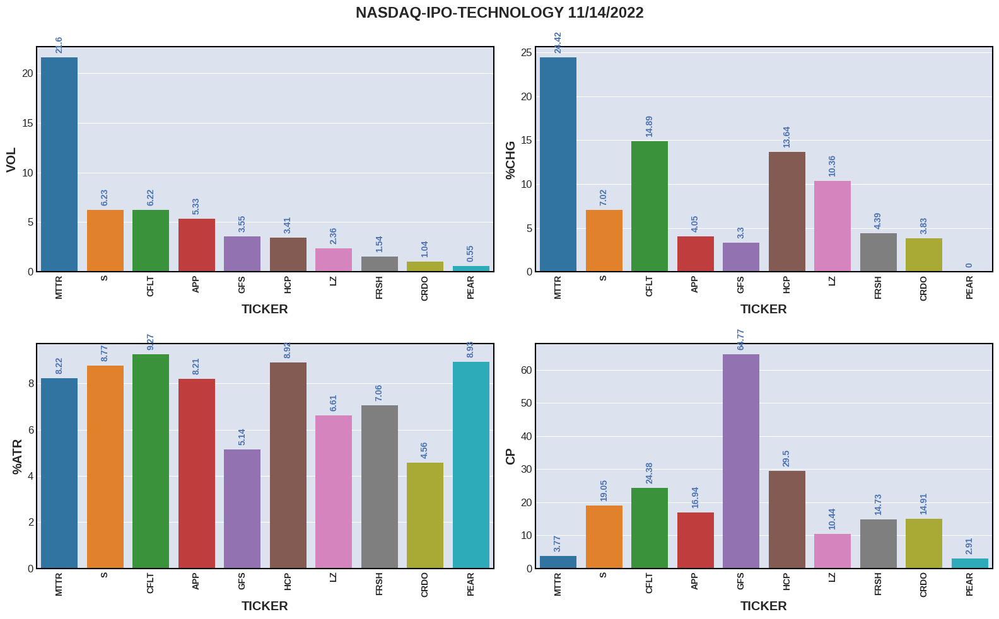

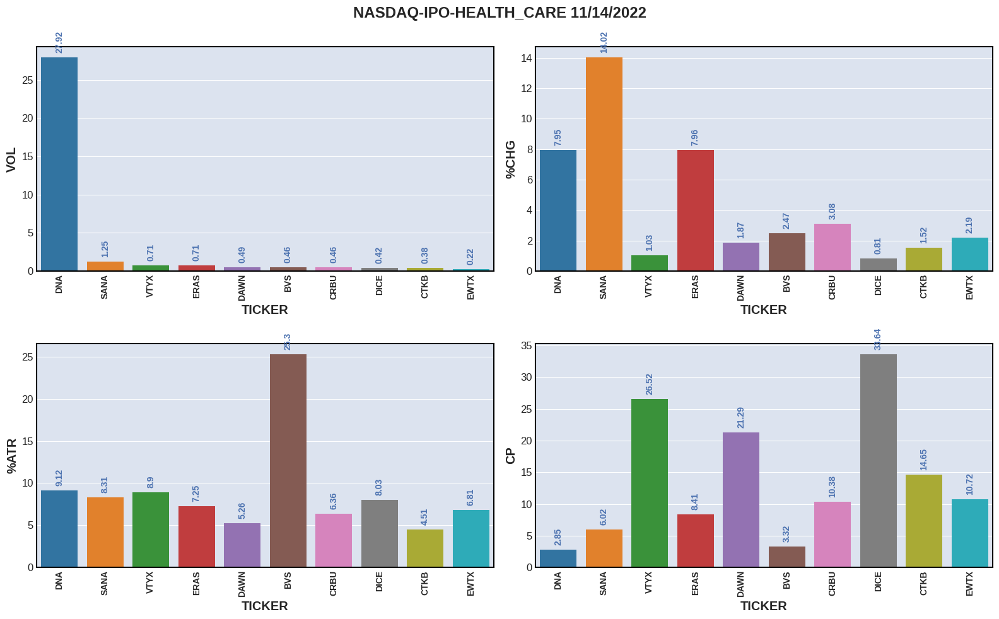

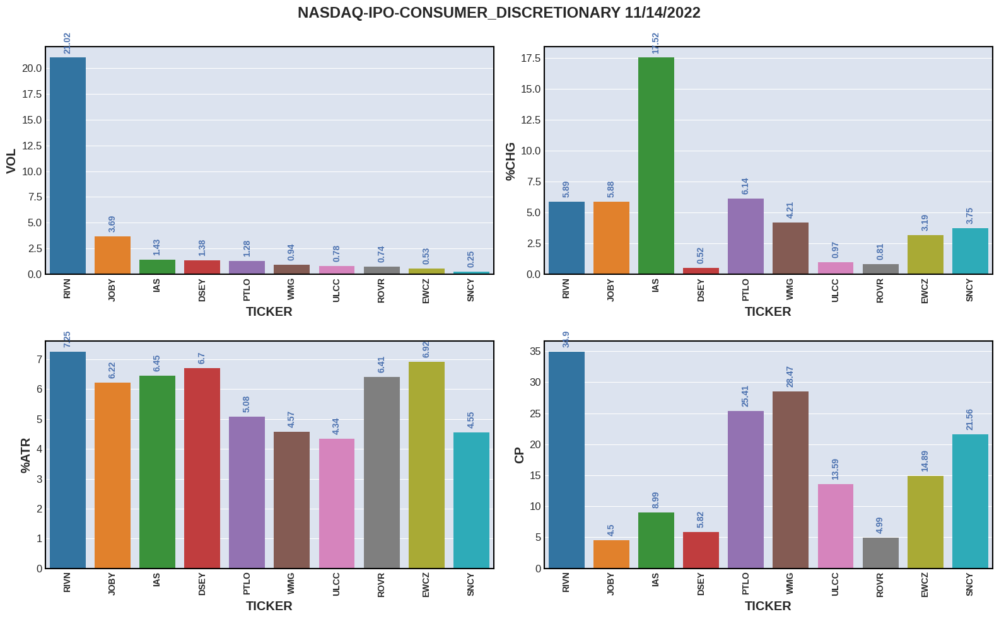

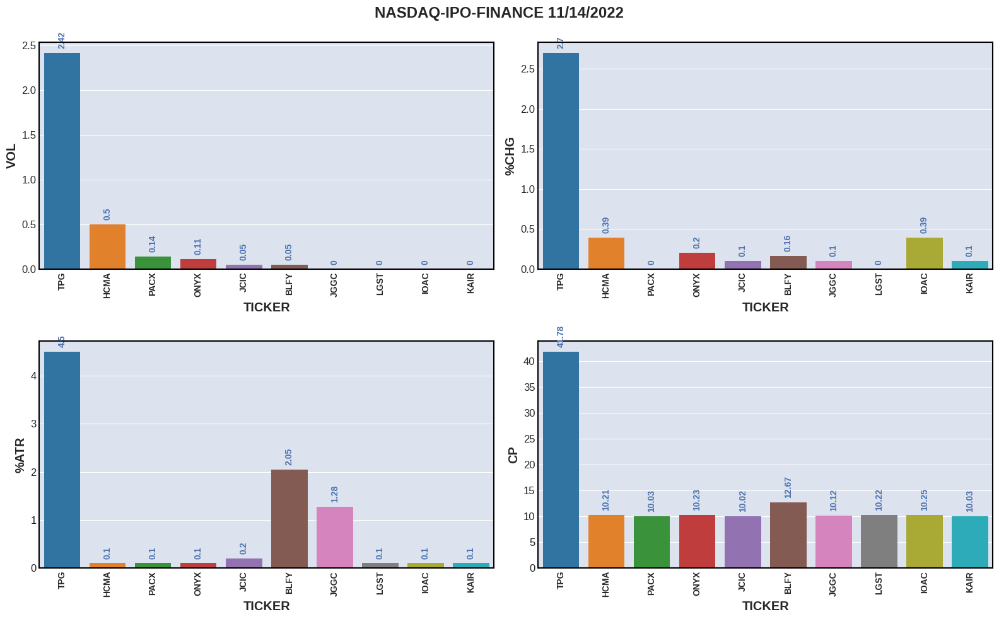

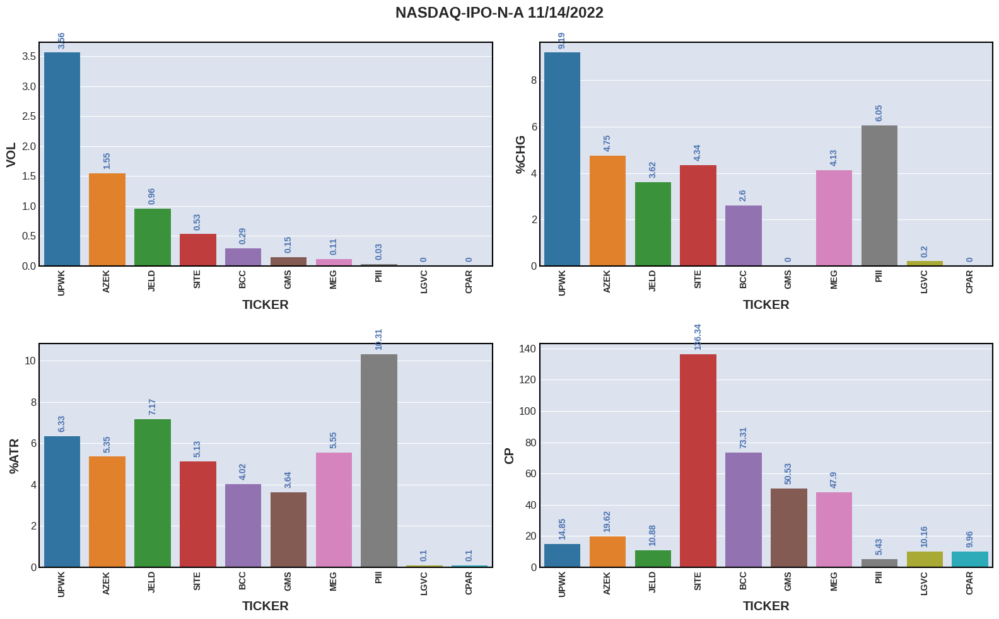

...

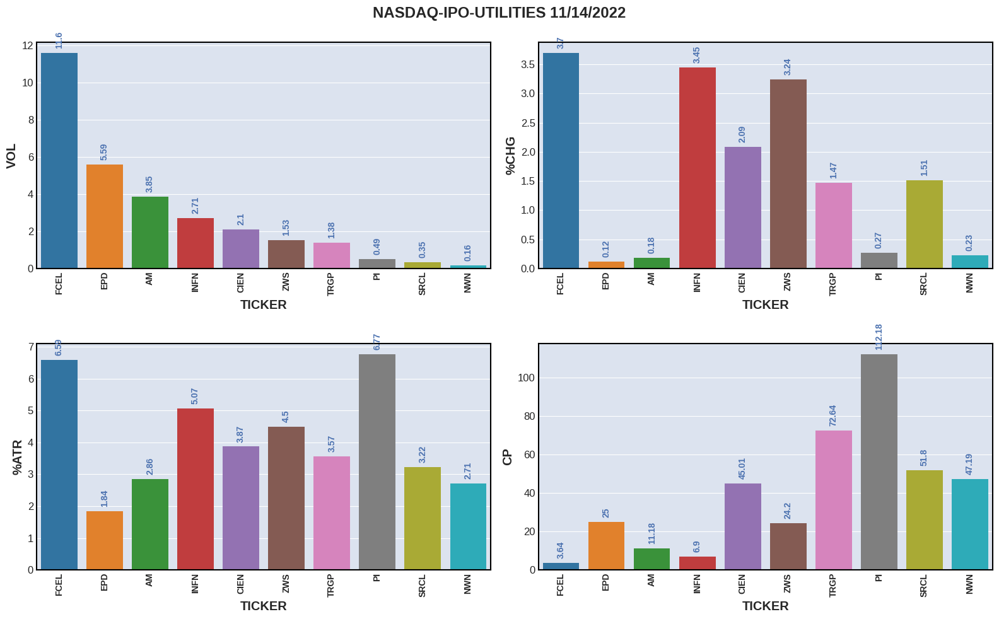

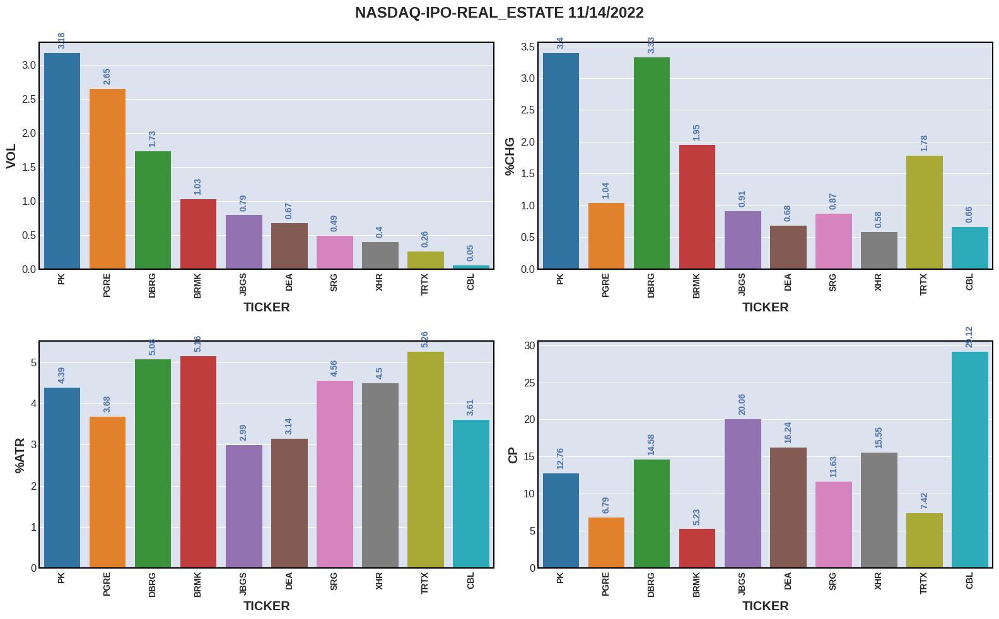

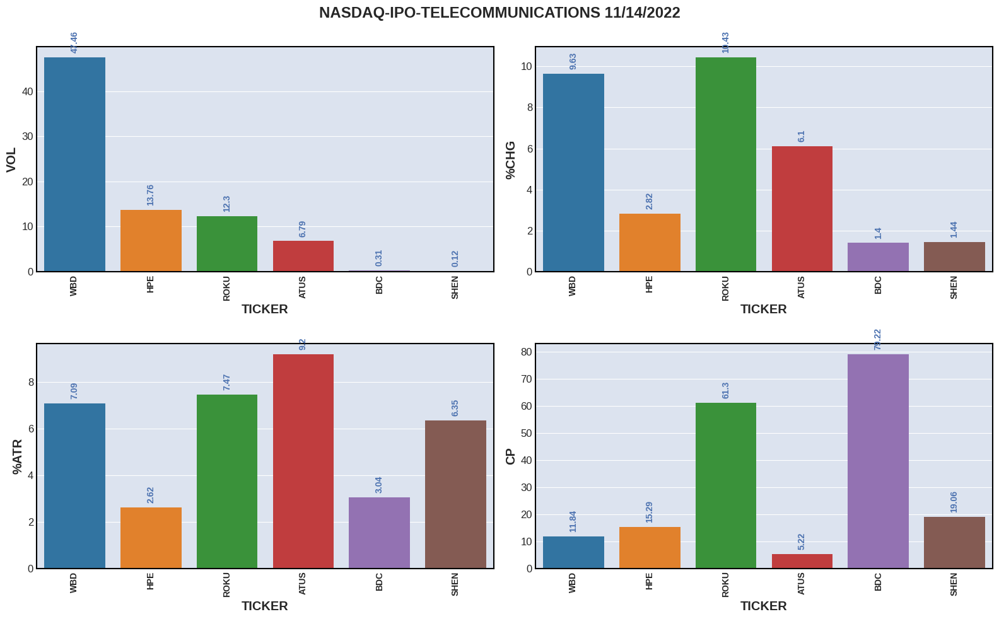

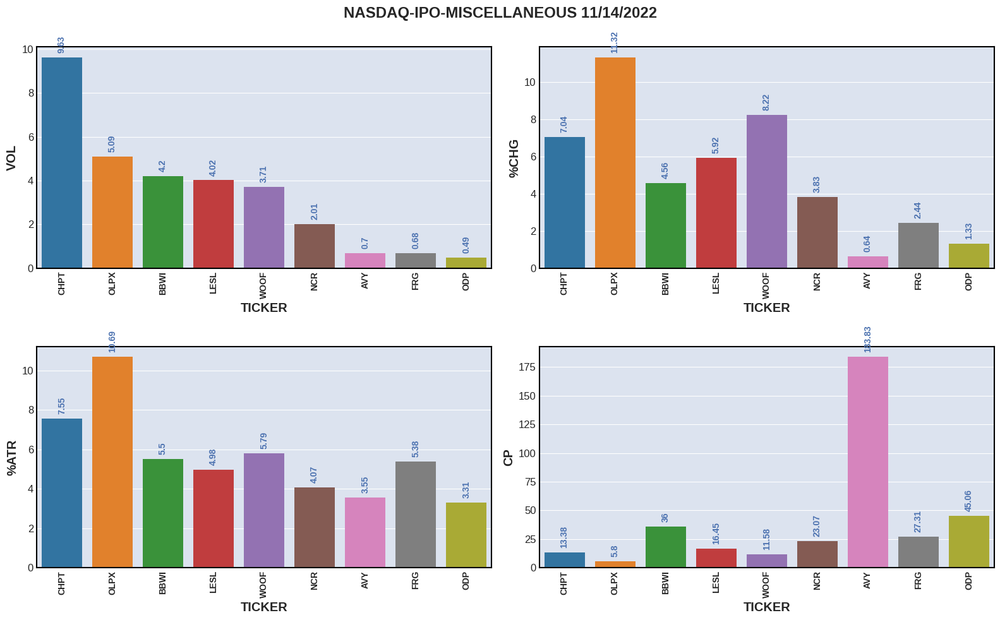

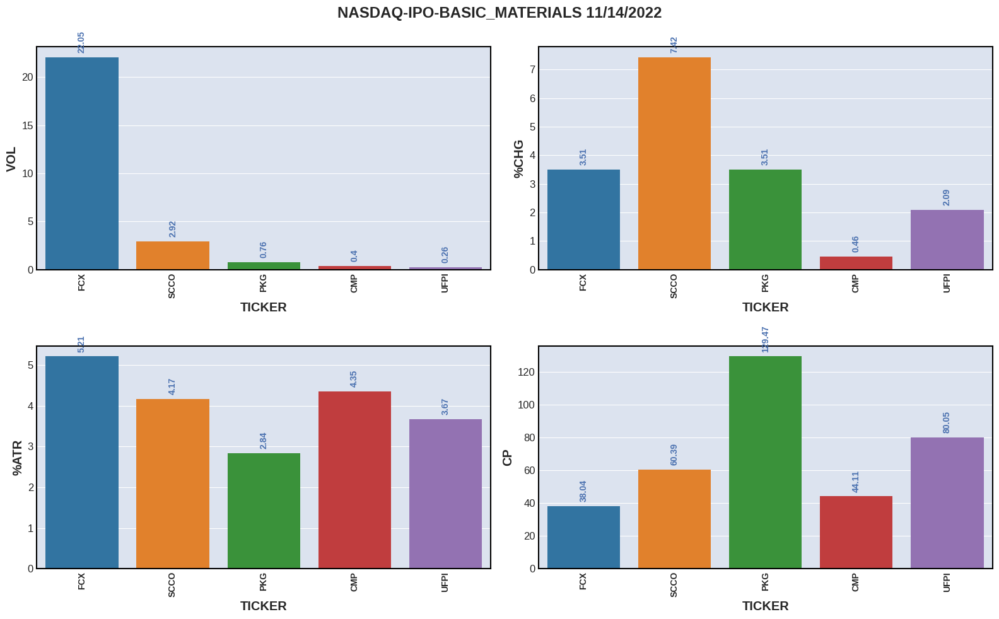

In [31]:
#%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=25*'=='
fmt1=25*'**'
choose='IPO'
how=False
plot=False
show_number=10

for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {str(country).upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors,start=1):
        temp_df=df_usa[df_usa.SECTOR==sector]
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR {s}: {sector.upper()} ({ choose }){fmt} \n\n {temp_df.to_string()}")
        #compare_bars(temp_df,sector)
        compare_bars(temp_df,title="nasdaq-ipo-"+sector)
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        if plot:
            for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
                print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

# CP



************************************************** COUNTRY: UNITED STATES ************************************************** 




================================================== SECTOR:1 TECHNOLOGY (CP)================================================== 

    TICKER     CP    RSI    VOL  AVGVOL   %CHG   ATR   %ATR      SECTOR                                  INDUSTRY     IPO        COUNTRY CATEGORY
1    SMFR   1.02  54.03   0.70    0.67   9.09  0.11  10.78  Technology  Computer Software & Peripheral Equipment  2020.0  United States    small
2    NUTX   1.16  58.38   5.97    2.24   37.6  0.13  11.21  Technology  Computer Software & Peripheral Equipment     0.0  United States    small
3     AUR   1.80  40.28   3.39    3.12   2.86  0.16   8.89  Technology                              EDP Services  2021.0  United States   medium
4    ANGI   2.42  52.30   1.34    2.16   5.68  0.18   7.44  Technology                              EDP Services     0.0  United States    small
5    CYXT   2.

/tmp/ipykernel_10045/684526863.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]




================================================== SECTOR:2 HEALTH_CARE (CP)================================================== 

    TICKER    CP    RSI    VOL  AVGVOL   %CHG   ATR   %ATR       SECTOR                                                       INDUSTRY     IPO        COUNTRY CATEGORY
1    SENS  1.24  51.53   6.02    4.48    6.9  0.10   8.06  Health_Care   Biotechnology: Electromedical & Electrotherapeutic Apparatus     0.0  United States    small
2    CLOV  1.53  48.35  10.73   12.41   9.29  0.12   7.84  Health_Care                                           Medical Specialities     0.0  United States    small
3    OCGN  1.77  52.69   5.68    6.29   3.51  0.14   7.91  Health_Care                     Biotechnology: Pharmaceutical Preparations  2014.0  United States    small
4    SRNE  1.83  62.56  12.06    9.17  12.96  0.14   7.65  Health_Care        Biotechnology: Commercial Physical & Biological Resarch     0.0  United States    small
5    PGEN  1.84  53.30   1.09    0.80 

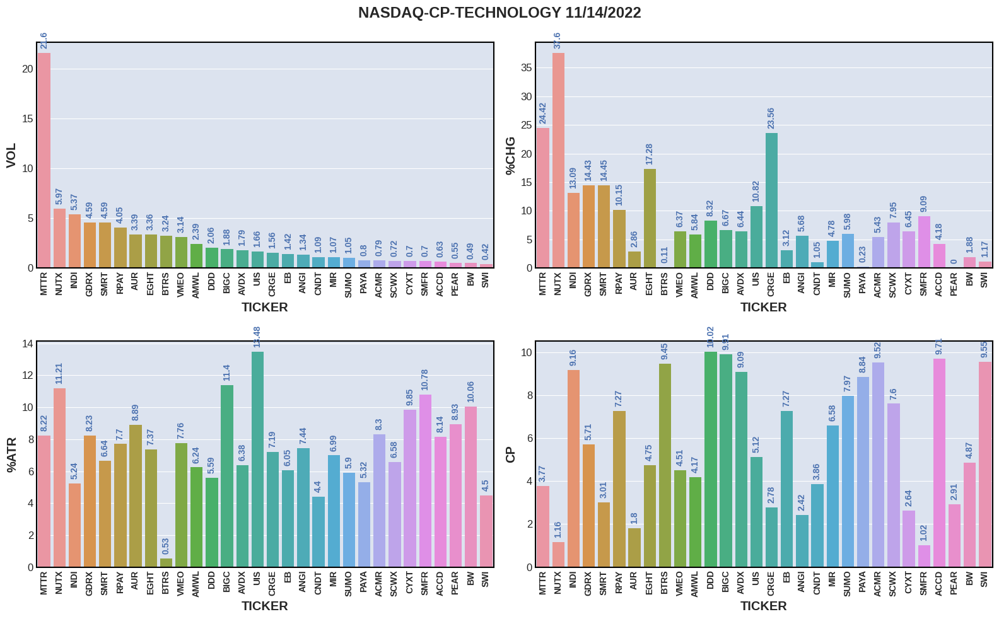

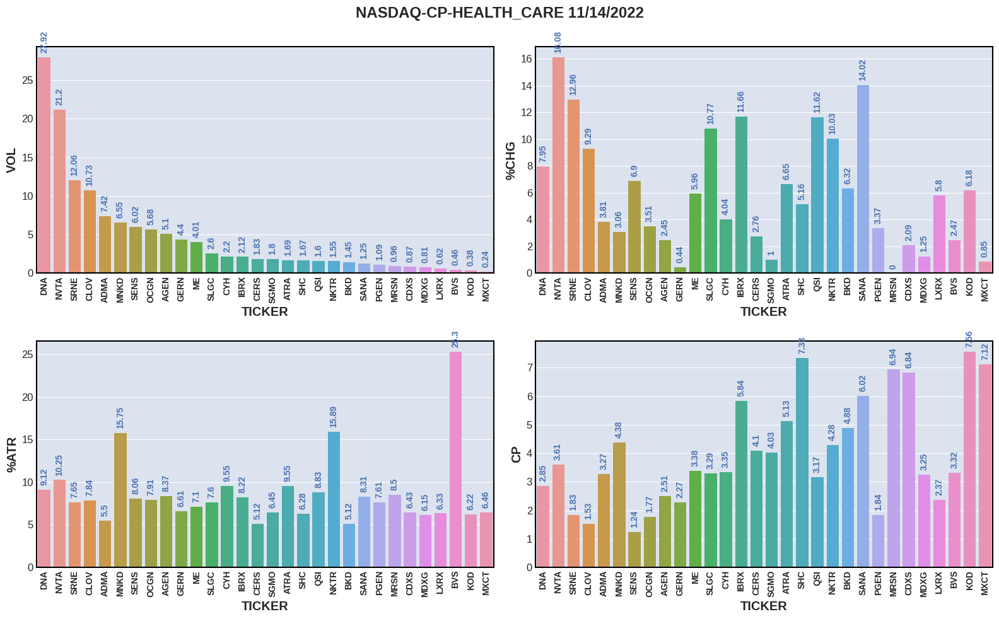

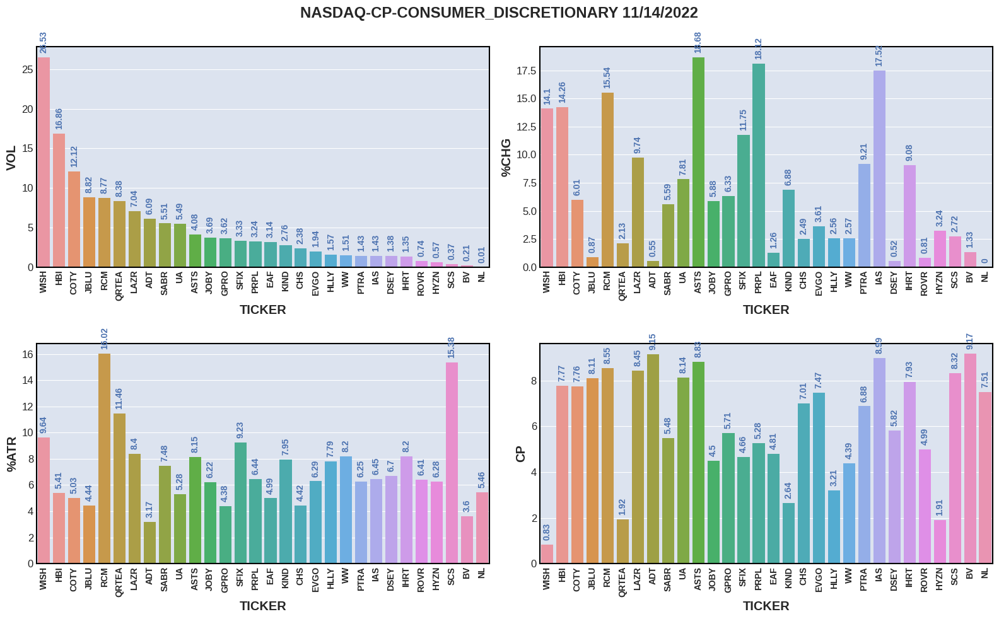

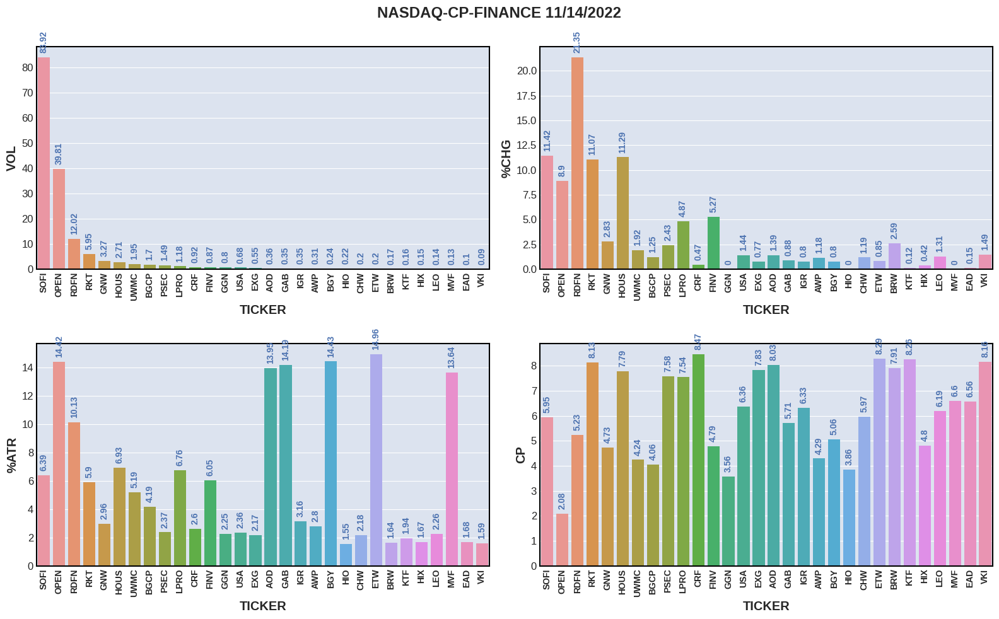

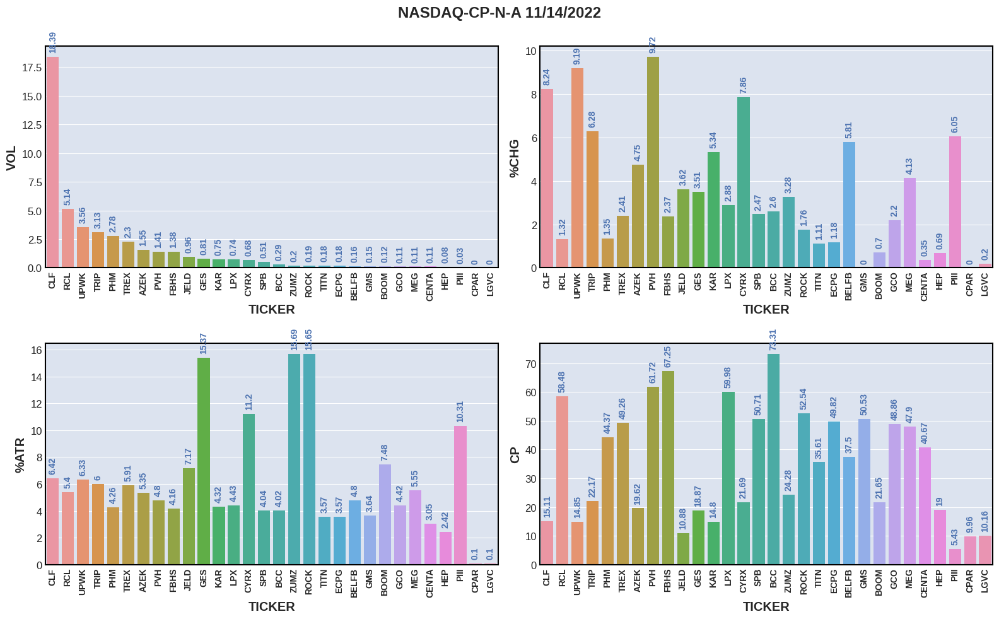

...

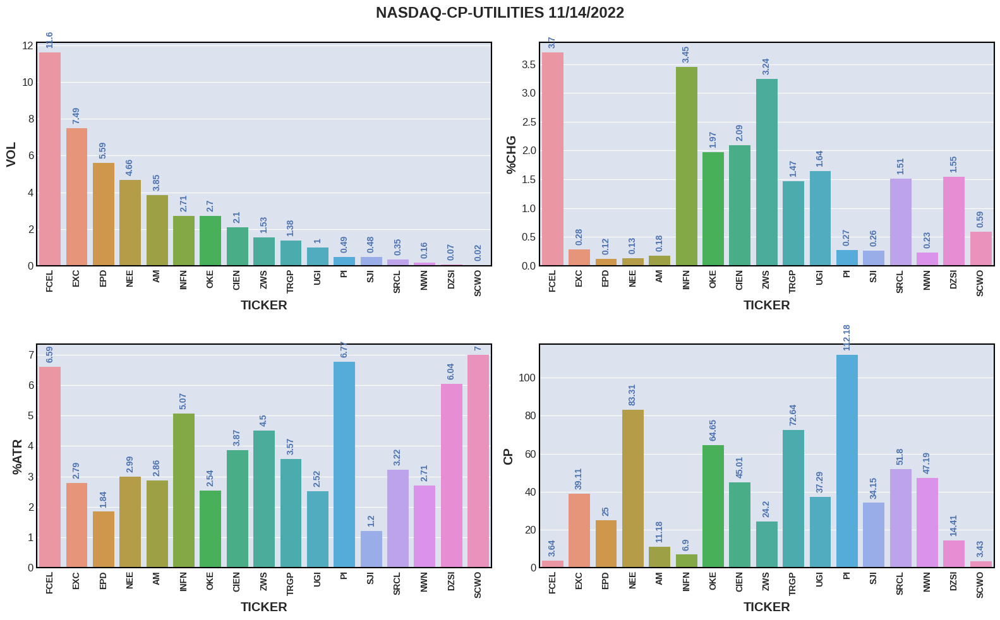

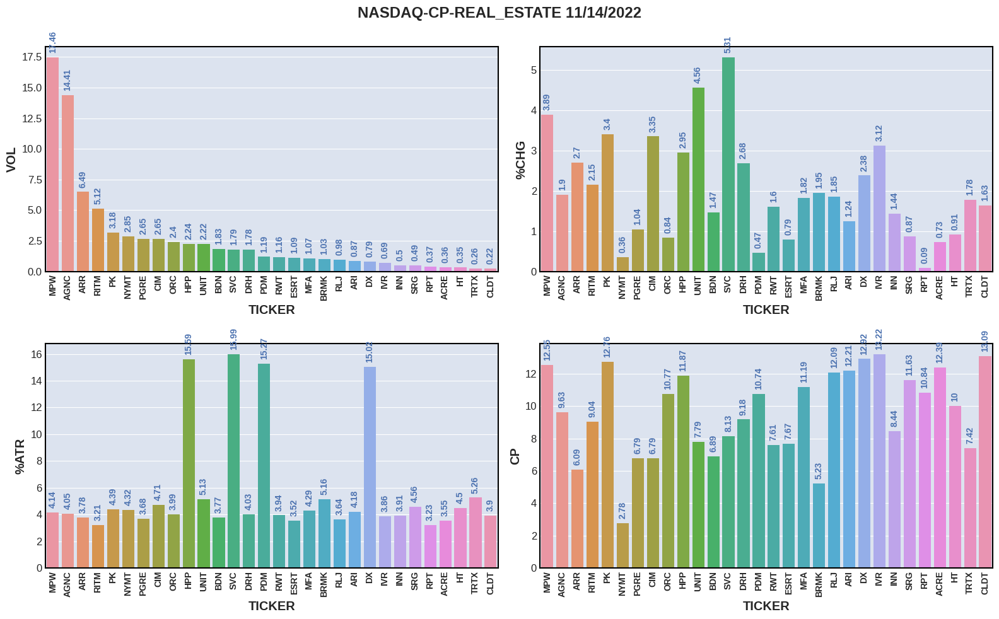

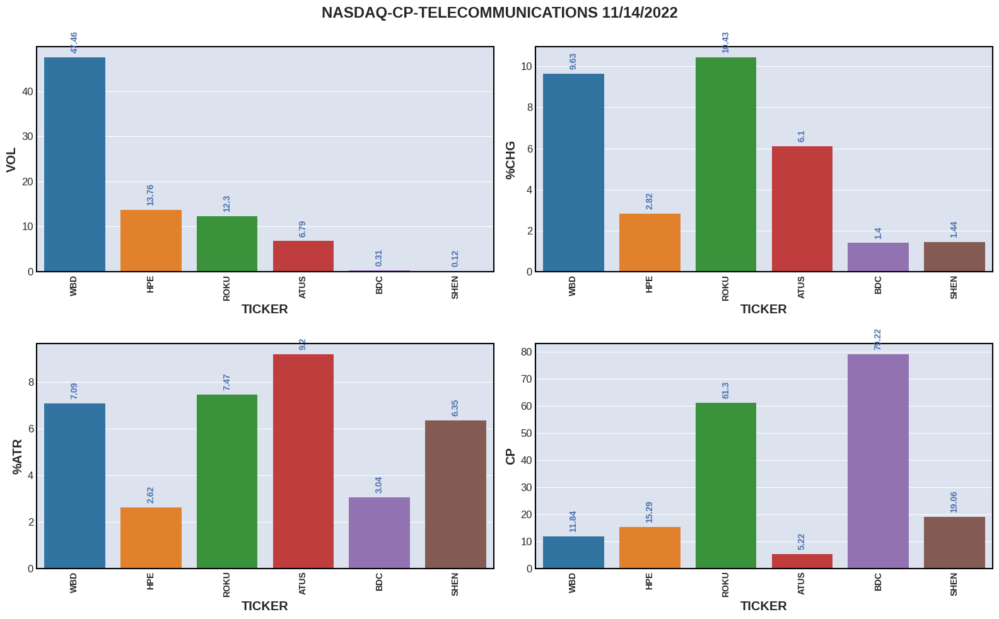

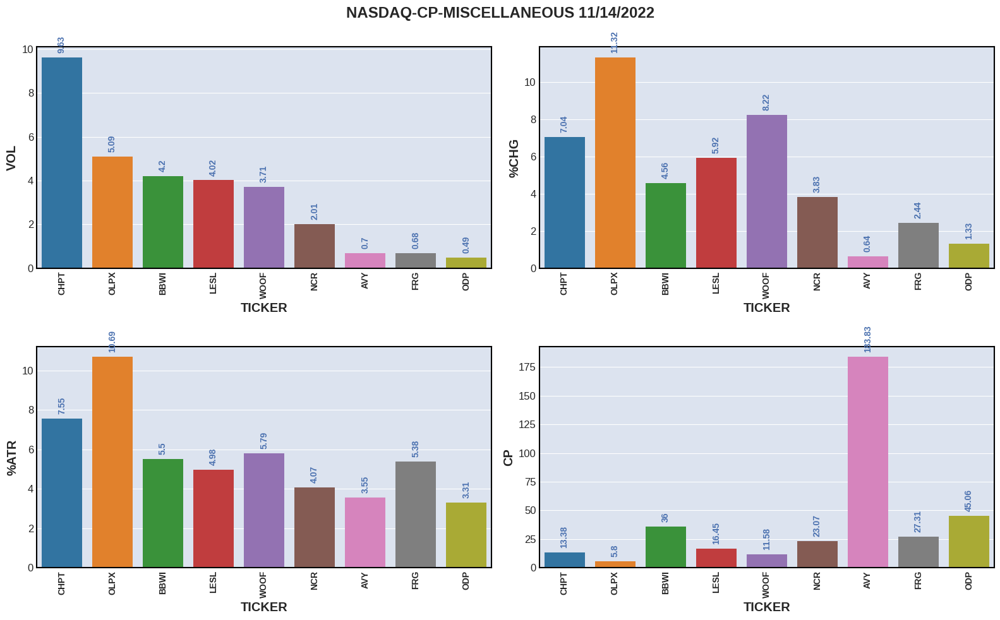

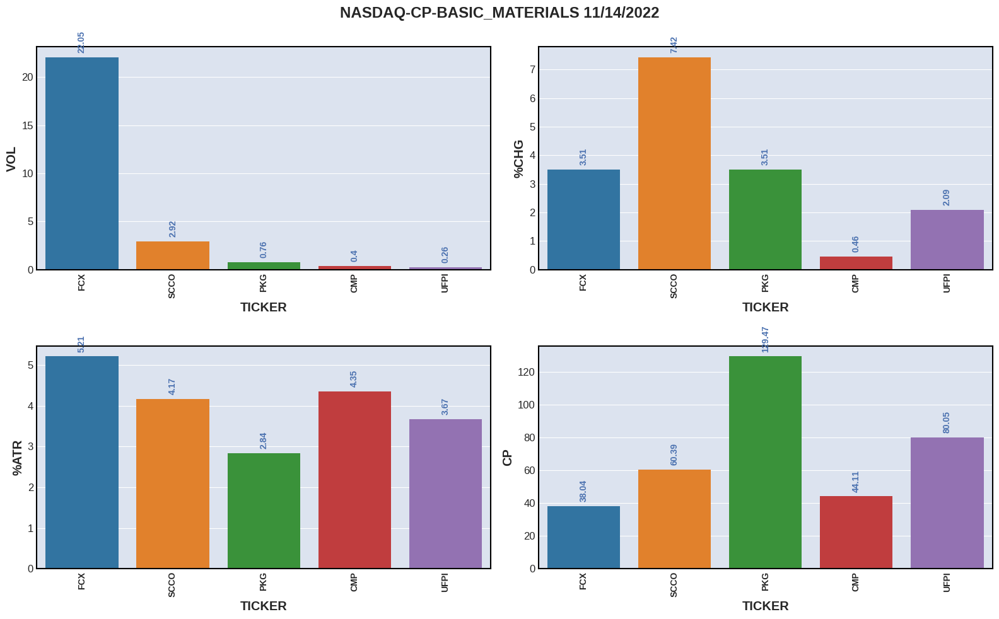

In [32]:
#%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=25*'=='
fmt1=25*'**'
choose='CP'
how=True
plot=False
show_number=30

for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors,start=1):
        temp_df=df_usa[df_usa.SECTOR==sector]
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR:{s} {sector.upper()} ({ choose }){fmt} \n\n {temp_df.to_string()}")
        #compare_bars(temp_df,title="snp-500-"+sector)
        compare_bars(temp_df,title="nasdaq-cp-"+sector)
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

# ALL NASDAQ BEST

In [33]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=32*'=='
fmt1=35*'**'
choose=['VOL','%CHG','%ATR','IPO','CP']
how=False
show_number=2 #how many to show
plot=True
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors):
        temp_df=df_usa[df_usa.SECTOR==sector].copy() #this line prints only limited output
        if temp_df.empty:continue
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        temp_df=reset_index(temp_df)[columns_selected]
        for c,cho in enumerate(choose,start=1):
            print(f"\n\n{c}: {sector.upper()} => {cho}\n")
            if cho=='CP':how=True
            temp_df=temp_df.sort_values(by=cho,ascending=how).head(show_number)
            how=False
            if cho=='%CHG':temp_df1
            temp_df=reset_index(temp_df)
            
            print(f"\n\n{fmt} SECTOR:{s+1} {sector.upper()} ({ cho }) {fmt} \n\n {temp_df.to_string()}")
            tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
            if (plot and (c==5)):
                for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
 

In [34]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=32*'=='
fmt1=35*'**'
choose=['VOL','%CHG','%ATR','IPO','CP']
how=False
show_number=2 #how many to show
plot=True
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors):
        temp_df=df_usa[df_usa.SECTOR==sector].copy() #this line prints only limited output
        if temp_df.empty:continue
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        temp_df=reset_index(temp_df)[columns_selected]
        for c,cho in enumerate(choose,start=1):
            print(f"\n\n{c}: {sector.upper()} => {cho}\n")
            if cho=='CP':how=True
            temp_df=temp_df.sort_values(by=cho,ascending=how).head(show_number)
            how=False
            if cho=='%CHG':temp_df1
            temp_df=reset_index(temp_df)
            
            print(f"\n\n{fmt} SECTOR:{s+1} {sector.upper()} ({ cho }) {fmt} \n\n {temp_df.to_string()}")
            tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
            if (plot and (c==5)):
                for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
 

In [35]:
#%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
choose='VOL'
how=False
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for s,sector in enumerate(sectors):
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR:{s+1} {sector.upper()} ({ choose }) {fmt} \n\n {temp_df.to_string()}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        if plot:
            for c,i in enumerate(tick):print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
 



********************************************************************** COUNTRY: UNITED STATES ********************************************************************** 




====================================================================== SECTOR:1 TECHNOLOGY (VOL) ====================================================================== 

    TICKER      CP    RSI     VOL  AVGVOL   %CHG   ATR   %ATR      SECTOR                           INDUSTRY     IPO        COUNTRY CATEGORY
1     AMD   72.37  64.78  111.57   84.23    5.7  3.75   5.18  Technology                     Semiconductors     0.0  United States    large
2    AAPL  149.70  54.56   93.63   92.14   1.93  5.83   3.89  Technology             Computer Manufacturing  1980.0  United States     mega
3    NVDA  163.27  70.60   64.35   56.08   3.66  8.09   4.95  Technology                     Semiconductors  1999.0  United States     mega
4    META  113.02  48.48   59.83   76.45   1.03  7.49   6.63  Technology  Internet and Informatio

/tmp/ipykernel_10045/1753057763.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]




====================================================================== SECTOR:6 ENERGY (VOL) ====================================================================== 

    TICKER      CP    RSI    VOL  AVGVOL  %CHG   ATR  %ATR  SECTOR                  INDUSTRY     IPO        COUNTRY CATEGORY
1     SWN    6.99  52.94  30.37   30.05  1.16  0.44  6.29  Energy      Oil & Gas Production     0.0  United States   medium
2     OXY   74.33  57.70  20.65   19.51  5.46  2.93  3.94  Energy      Oil & Gas Production     0.0  United States    large
3     XOM  113.95  65.56  20.24   18.12  3.12  2.90  2.54  Energy      Oil & Gas Production     0.0  United States     mega
4    TELL    2.96  53.92  14.89   12.16  5.34  0.20  6.76  Energy      Oil & Gas Production     0.0  United States    small
5    CTRA   28.45  45.89  14.00   14.83  3.34  1.19  4.18  Energy      Oil & Gas Production     0.0  United States    large
6     MRO   32.88  64.70  11.54   13.03  4.05  1.25  3.80  Energy      Oil & Gas Produc

# HIGHEST +   %CHANGE

In [36]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
cor=10*'=='
choose='%CHG'
how=False
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df_sector.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for sector in sectors:
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR: {sector.upper()} ( {choose} ){fmt} \n\n {temp_df.to_string()}")
        print(f"\n{fmt}{fmt}{cor}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

# HIGHEST -VE %CHANGE

In [37]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
choose='%CHG'
how=True
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df_sector.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for sector in sectors:
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR: {sector.upper()} (-{ choose }) {fmt} \n\n {temp_df.to_string()}");#print(f"\n{fmt}{fmt}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

In [38]:
%%script false --no-raise-error
ignore_category=['nano','micro']
fmt=35*'=='
fmt1=35*'**'
choose='%ATR'
how=False
show_number=10 #how many to show
plot=False
for c,country in enumerate(countries):
    if c!=0:continue
    print(f"\n\n{fmt1} COUNTRY: {country.upper()} {fmt1} \n\n")
    df_usa=df[(df.COUNTRY==country )]
    df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
    #df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
    df_usa=reset_index(df_usa)
    root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
    sectors=list(df_sector.SECTOR.unique())
    columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
    
    for sector in sectors:
        temp_df=df_usa[df_usa.SECTOR==sector] #this line prints only limited output
        if temp_df.empty:continue
        temp_df=reset_index(temp_df)[columns_selected]
        temp_df=temp_df.sort_values(by=choose,ascending=how).head(show_number)
        temp_df=reset_index(temp_df)
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))

        temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
        print(f"\n\n{fmt} SECTOR: {sector.upper()} ({ choose }) {fmt} \n\n {temp_df.to_string()}")
        tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
        for c,i in enumerate(tick):
            #file=root.format(cat[c],i)
            #print(f"file: {file}")
            
            if plot:print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}");plot_with_mpl(root.format(cat[c]),i,sty='default')
    # df_usa.shape
    # df_usa.head()
    # df_usa.columns

In [39]:
%%script false --no-raise-error
country='United States'
ignore_category=['nano']

df_usa=df[(df.COUNTRY==country )]
df_usa=df_usa[~df.CATEGORY.isin(ignore_category)]
df_usa=df_usa.query('HH & HL & HC')#.sort_values(by=choose,ascending=False)
df_usa=reset_index(df_usa)
df_usa.shape
df_usa.head()
df_usa.columns

In [40]:
#print by sector
%%script false --no-raise-error
%matplotlib inline
root='/home/thakur/test/{}'
#sectors=list(df.SECTOR.unique())
sectors=list(df_sector.SECTOR.unique())
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR','%ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
fmt=35*'=='
choose='CP'
how=True
for sector in sectors:
    temp_df=df_usa[df_usa.SECTOR==sector]
    if temp_df.empty:continue
    temp_df=reset_index(temp_df)[columns_selected]
   
    temp_df=temp_df.sort_values(by=choose,ascending=how)
    temp_df=reset_index(temp_df)
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
    
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
    print(f"\n\n{fmt} SECTOR: {sector.upper()} {fmt} \n\n {temp_df.to_string()}")
    tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
    for c,i in enumerate(tick):
        #file=root.format(cat[c],i)
        #print(f"file: {file}")
        print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}")
        plot_with_mpl(root.format(cat[c]),i,sty='default')
        
        #print(f"tick: {i} {cat[c]}\n")

UsageError: Line magic function `%%script` not found.


In [ ]:
#print by sector
%%script false --no-raise-error
%matplotlib inline
root='/home/thakur/test/{}'
sectors=list(df.SECTOR.unique())
columns_selected=['TICKER', 'CP', 'RSI',
       'VOL', 'AVGVOL', '%CHG', 'ATR',
       'SECTOR', 'INDUSTRY', 'IPO', 'COUNTRY', 'CATEGORY']
fmt=35*'=='
choose='CP'
how=True
for sector in sectors:
    temp_df=df_usa[df_usa.SECTOR==sector]
    if temp_df.empty:continue
    temp_df=reset_index(temp_df)[columns_selected]
   
    temp_df=temp_df.sort_values(by=choose,ascending=how)
    temp_df=reset_index(temp_df)
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Computer Software: Prepackaged Software','Computer Software'))
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.replace('Radio And Television Broadcasting And Communications Equipment','Communications Equipment'))
    
    temp_df['INDUSTRY']=temp_df['INDUSTRY'].apply(lambda x:x.lstrip('Retail: '))
    print(f"\n\n{fmt} SECTOR: {sector.upper()} {fmt} \n\n {temp_df.to_string()}")
    tick=temp_df['TICKER'].to_list();cat=temp_df['CATEGORY'].to_list()
    for c,i in enumerate(tick):
        #file=root.format(cat[c],i)
        #print(f"file: {file}")
        print(f"\n\n{temp_df[temp_df['TICKER']==i].to_string()}")
        plot_with_mpl(root.format(cat[c]),i,sty='default')
        
        #print(f"tick: {i} {cat[c]}\n")

In [ ]:
#file location
file='/home/thakur/stock_information/nasdaq_all.csv'


In [ ]:
df.columns #name of columns

In [ ]:
%%script false --no-raise-error
df=pd.read_csv(file) #read the file in dataframe
df.fillna('N/A',inplace=True)
df['Market Cap']=df['Market Cap'].apply(lambda x:round(x*10**-6,2))
df['% Change']=df['% Change'].apply(lambda x:x.strip('%')).astype(float)
df['Last Sale']=df['Last Sale'].apply(lambda x:x.lstrip('$')).astype(float).round(2)
df['Name']=df['Name'].apply(lambda x: x.replace('Common Stock',''))
df['Name']=df['Name'].apply(lambda x: x.replace('Class A',''))

df.head()

In [ ]:
df.shape #shape of the dataframe

In [ ]:
#countries present
countries=list(df['Country'].unique())

In [ ]:

countries

In [ ]:
df['Country'].value_counts()

In [ ]:
#select a country 
country='India'
df_name='df_'+country
df_name=df[df.Country==country]

df_name=reset_index(df_name)
df_name

choose='% Change'
df_name=df_name.sort_values(by=choose,ascending=False)
df_name=reset_index(df_name)
df_name.dtypes

In [ ]:
#select a country 
%%script false --no-raise-error
choose='% Change'
for country in countries:
    #df_name='df_'+country
    df_name=df[df.Country==country]
    df_name=reset_index(df_name)
    #df_name
    df_name=df_name.sort_values(by=choose,ascending=False)
    df_name=reset_index(df_name)
    print(f"COUNTRY: {country}\n {df_name.head()}")
    #df_name.dtypes

In [ ]:
df_name.head(25)

In [ ]:
df_name.tail(25)[::-1]